
## Avant de commencer le TP, 
- vérifiez que vous êtes sur un environnement GPU et python 3 : 
  
  Éxecution -> Modifier le type d'éxecution -> Type d'éxecution = python2, Accélerateur matériel = GPU

- Fichier -> Sauvegarder une copie dans mon drive

In [ ]:
!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git

Cloning into 'deep-learning-polytech-tp6-7'...
remote: Enumerating objects: 22, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 22 (delta 3), reused 7 (delta 1), pack-reused 8
Unpacking objects: 100% (22/22), done.


In [ ]:
cd deep-learning-polytech-tp6-7

/content/deep-learning-polytech-tp6-7


In [ ]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from tme6 import *

PRINT_INTERVAL = 200
PATH="datasets"

In [ ]:
class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting datasets/MNIST/raw/train-images-idx3-ubyte.gz to datasets/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting datasets/MNIST/raw/train-labels-idx1-ubyte.gz to datasets/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting datasets/MNIST/raw/t10k-images-idx3-ubyte.gz to datasets/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting datasets/MNIST/raw/t10k-labels-idx1-ubyte.gz to datasets/MNIST/raw

=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


[TRAIN Batch 000/469]	Time 0.246s (0.246s)	Loss 2.3043 (2.3043)	Prec@1   9.4 (  9.4)	Prec@5  53.1 ( 53.1)


<Figure size 432x288 with 0 Axes>

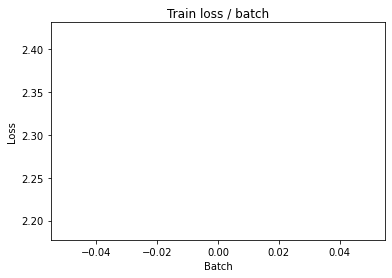

[TRAIN Batch 200/469]	Time 0.030s (0.021s)	Loss 0.3767 (1.2203)	Prec@1  89.8 ( 65.6)	Prec@5 100.0 ( 91.3)


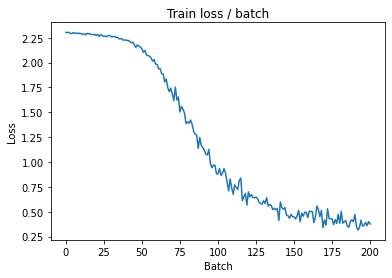

[TRAIN Batch 400/469]	Time 0.021s (0.020s)	Loss 0.2315 (0.7427)	Prec@1  93.8 ( 79.0)	Prec@5  99.2 ( 95.5)


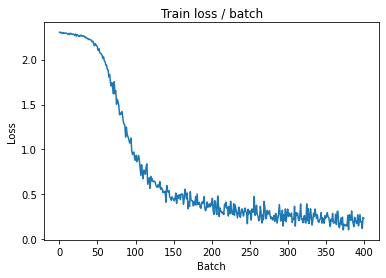


===============> Total time 9s	Avg loss 0.6613	Avg Prec@1 81.29 %	Avg Prec@5 96.11 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.1087 (0.1087)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1521	Avg Prec@1 95.46 %	Avg Prec@5 99.91 %



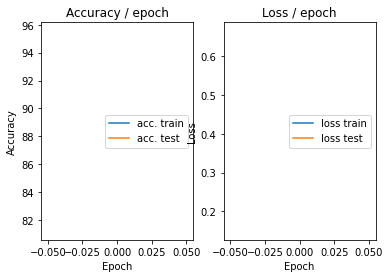

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.165s (0.165s)	Loss 0.1634 (0.1634)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


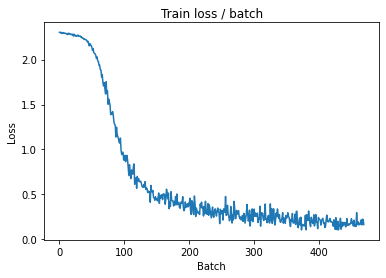

[TRAIN Batch 200/469]	Time 0.029s (0.019s)	Loss 0.1456 (0.1406)	Prec@1  96.1 ( 96.0)	Prec@5  99.2 ( 99.9)


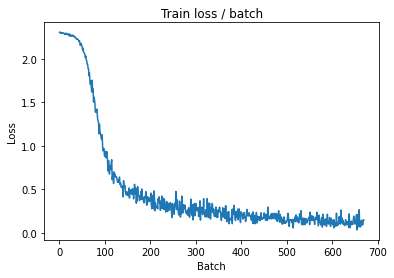

[TRAIN Batch 400/469]	Time 0.028s (0.019s)	Loss 0.0737 (0.1257)	Prec@1  97.7 ( 96.4)	Prec@5 100.0 ( 99.9)


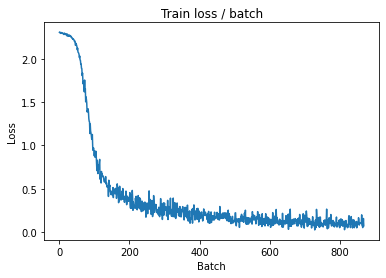


===============> Total time 9s	Avg loss 0.1218	Avg Prec@1 96.49 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0355 (0.0355)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0820	Avg Prec@1 97.59 %	Avg Prec@5 99.99 %



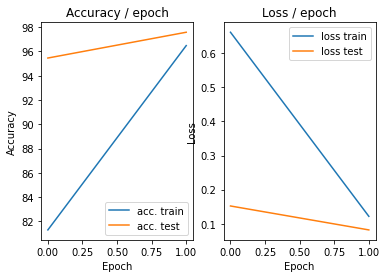

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.157s (0.157s)	Loss 0.1024 (0.1024)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


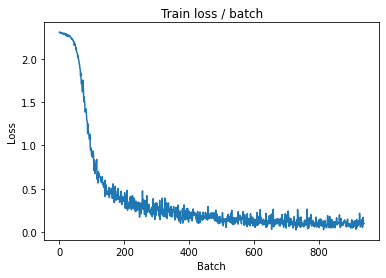

[TRAIN Batch 200/469]	Time 0.028s (0.019s)	Loss 0.1036 (0.0872)	Prec@1  96.9 ( 97.4)	Prec@5 100.0 ( 99.9)


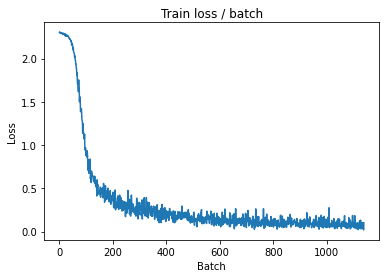

[TRAIN Batch 400/469]	Time 0.005s (0.019s)	Loss 0.0921 (0.0806)	Prec@1  96.1 ( 97.6)	Prec@5 100.0 ( 99.9)


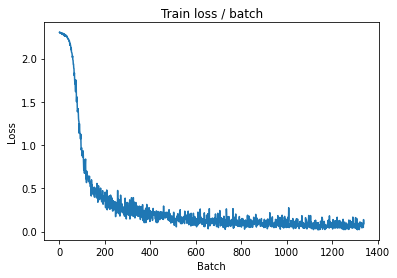


===============> Total time 9s	Avg loss 0.0806	Avg Prec@1 97.64 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.0298 (0.0298)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0628	Avg Prec@1 98.04 %	Avg Prec@5 99.97 %



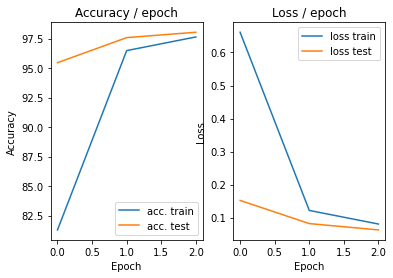

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.148s (0.148s)	Loss 0.0696 (0.0696)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


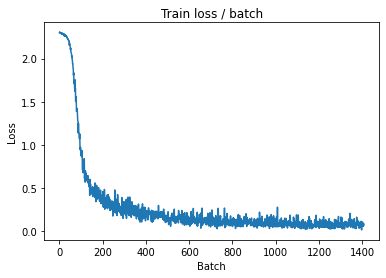

[TRAIN Batch 200/469]	Time 0.030s (0.020s)	Loss 0.0874 (0.0661)	Prec@1  95.3 ( 98.0)	Prec@5 100.0 (100.0)


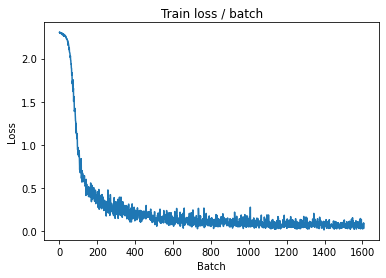

[TRAIN Batch 400/469]	Time 0.009s (0.020s)	Loss 0.0135 (0.0639)	Prec@1 100.0 ( 98.1)	Prec@5 100.0 (100.0)


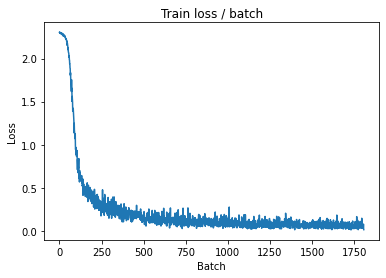


===============> Total time 9s	Avg loss 0.0633	Avg Prec@1 98.08 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0182 (0.0182)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0498	Avg Prec@1 98.38 %	Avg Prec@5 99.99 %



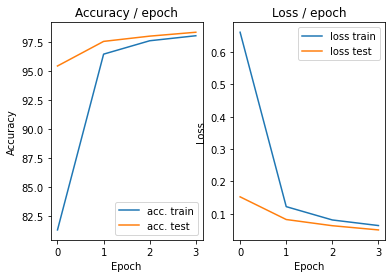

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.173s (0.173s)	Loss 0.0588 (0.0588)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


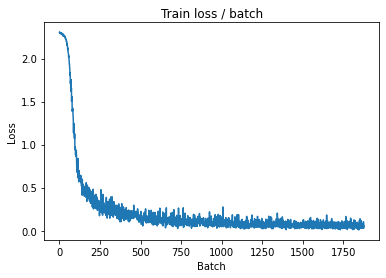

[TRAIN Batch 200/469]	Time 0.016s (0.022s)	Loss 0.0555 (0.0540)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


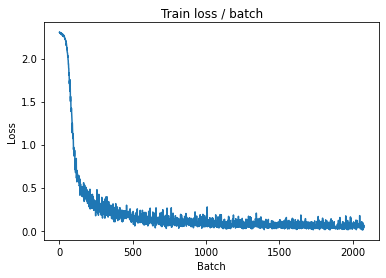

[TRAIN Batch 400/469]	Time 0.025s (0.021s)	Loss 0.0447 (0.0532)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


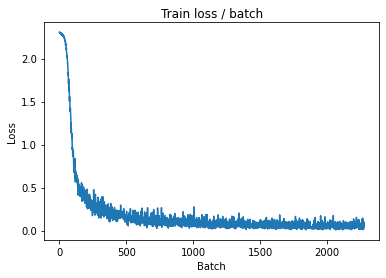


===============> Total time 9s	Avg loss 0.0531	Avg Prec@1 98.39 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.0219 (0.0219)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0481	Avg Prec@1 98.45 %	Avg Prec@5 99.99 %



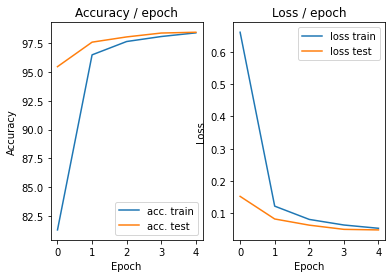

=== EPOCH 6 =====

[TRAIN Batch 000/469]	Time 0.174s (0.174s)	Loss 0.0265 (0.0265)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


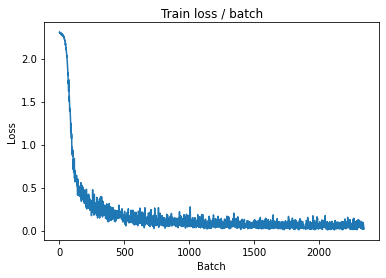

[TRAIN Batch 200/469]	Time 0.014s (0.019s)	Loss 0.0527 (0.0463)	Prec@1  99.2 ( 98.6)	Prec@5 100.0 (100.0)


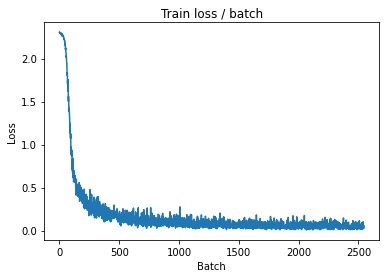

[TRAIN Batch 400/469]	Time 0.028s (0.019s)	Loss 0.0213 (0.0456)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)


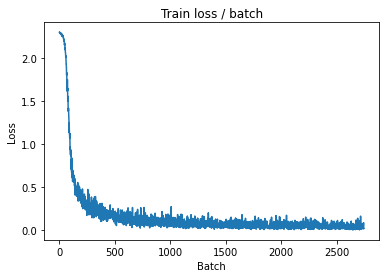


===============> Total time 8s	Avg loss 0.0455	Avg Prec@1 98.65 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.0145 (0.0145)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0392	Avg Prec@1 98.64 %	Avg Prec@5 99.99 %



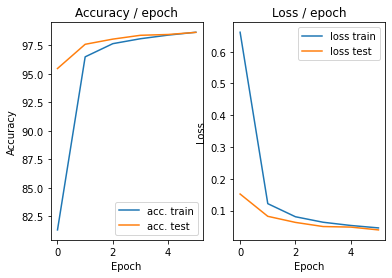

=== EPOCH 7 =====

[TRAIN Batch 000/469]	Time 0.184s (0.184s)	Loss 0.0405 (0.0405)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


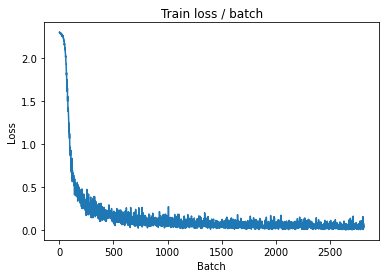

[TRAIN Batch 200/469]	Time 0.035s (0.020s)	Loss 0.0182 (0.0396)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


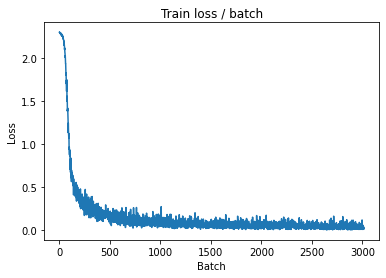

[TRAIN Batch 400/469]	Time 0.006s (0.020s)	Loss 0.0190 (0.0405)	Prec@1 100.0 ( 98.8)	Prec@5 100.0 (100.0)


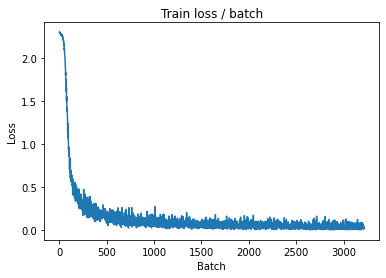


===============> Total time 9s	Avg loss 0.0402	Avg Prec@1 98.81 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0157 (0.0157)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0392	Avg Prec@1 98.59 %	Avg Prec@5 99.99 %



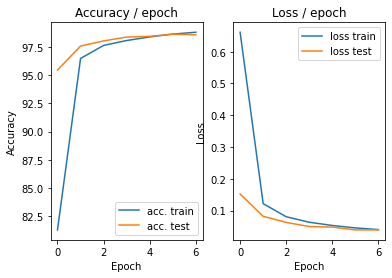

=== EPOCH 8 =====

[TRAIN Batch 000/469]	Time 0.152s (0.152s)	Loss 0.0279 (0.0279)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


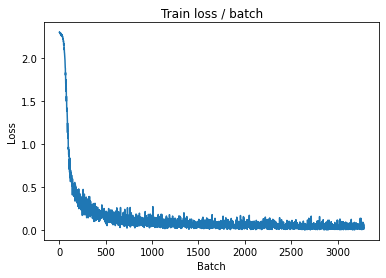

[TRAIN Batch 200/469]	Time 0.035s (0.020s)	Loss 0.0090 (0.0346)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


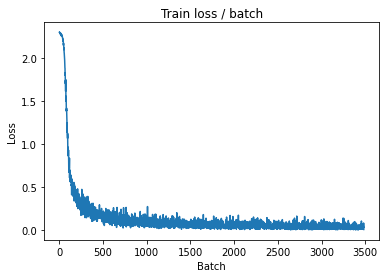

[TRAIN Batch 400/469]	Time 0.028s (0.020s)	Loss 0.0151 (0.0357)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


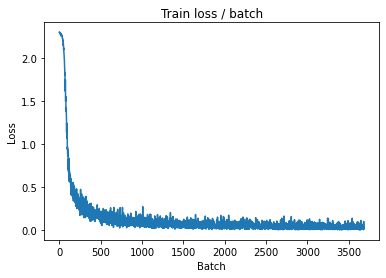


===============> Total time 9s	Avg loss 0.0356	Avg Prec@1 98.91 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.0256 (0.0256)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0345	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %



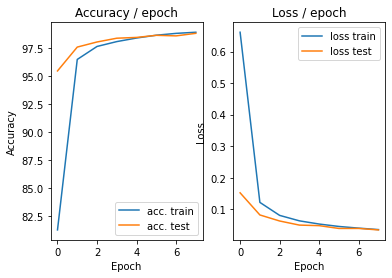

=== EPOCH 9 =====

[TRAIN Batch 000/469]	Time 0.181s (0.181s)	Loss 0.0191 (0.0191)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


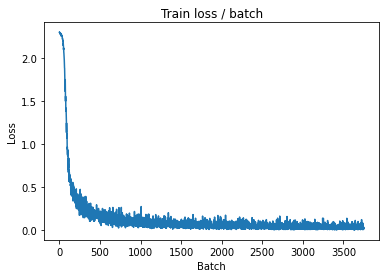

[TRAIN Batch 200/469]	Time 0.006s (0.020s)	Loss 0.0234 (0.0311)	Prec@1  99.2 ( 99.1)	Prec@5 100.0 (100.0)


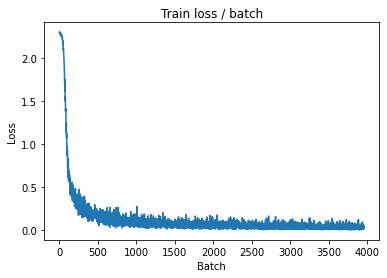

[TRAIN Batch 400/469]	Time 0.028s (0.020s)	Loss 0.0293 (0.0321)	Prec@1  99.2 ( 99.1)	Prec@5 100.0 (100.0)


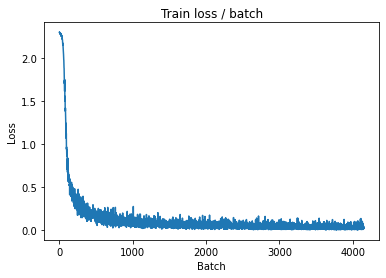


===============> Total time 9s	Avg loss 0.0319	Avg Prec@1 99.08 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.0208 (0.0208)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0374	Avg Prec@1 98.69 %	Avg Prec@5 99.99 %



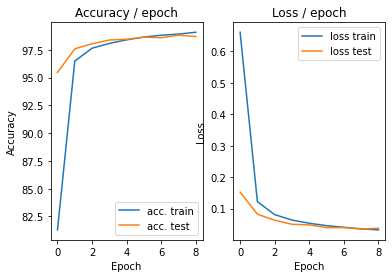

=== EPOCH 10 =====

[TRAIN Batch 000/469]	Time 0.161s (0.161s)	Loss 0.0218 (0.0218)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


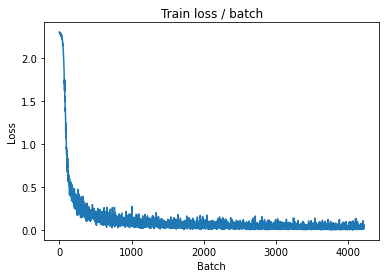

[TRAIN Batch 200/469]	Time 0.029s (0.020s)	Loss 0.0170 (0.0292)	Prec@1  99.2 ( 99.1)	Prec@5 100.0 (100.0)


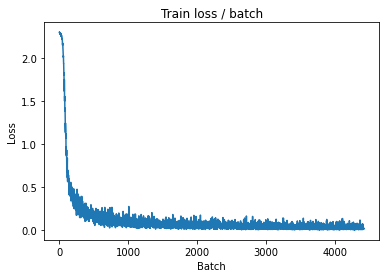

[TRAIN Batch 400/469]	Time 0.005s (0.020s)	Loss 0.0148 (0.0287)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


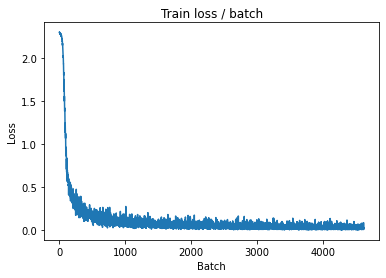


===============> Total time 9s	Avg loss 0.0287	Avg Prec@1 99.14 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.0172 (0.0172)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0331	Avg Prec@1 98.83 %	Avg Prec@5 100.00 %



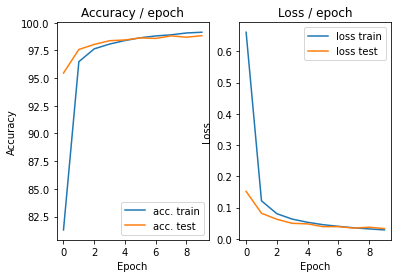

=== EPOCH 11 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0279 (0.0279)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


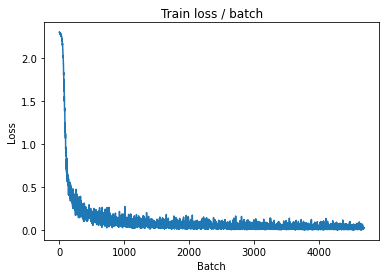

[TRAIN Batch 200/469]	Time 0.006s (0.020s)	Loss 0.0076 (0.0258)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


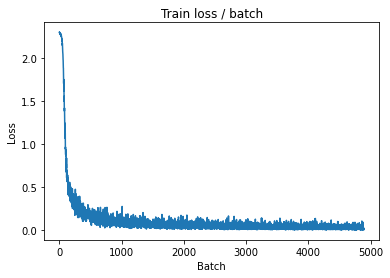

[TRAIN Batch 400/469]	Time 0.025s (0.020s)	Loss 0.0268 (0.0263)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


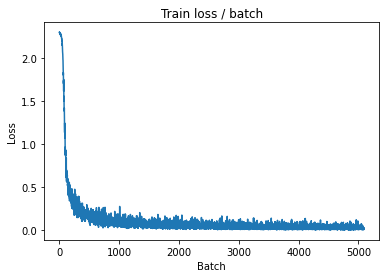


===============> Total time 9s	Avg loss 0.0261	Avg Prec@1 99.24 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.0157 (0.0157)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0304	Avg Prec@1 99.07 %	Avg Prec@5 100.00 %



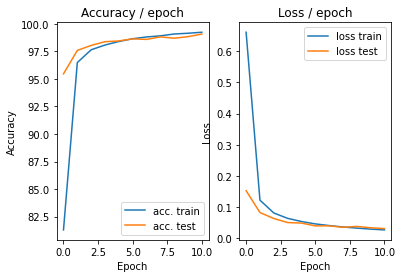

=== EPOCH 12 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0636 (0.0636)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


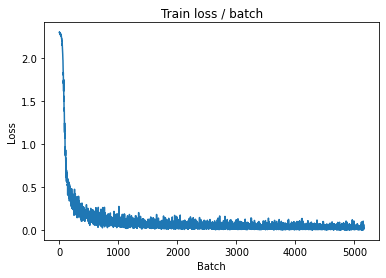

[TRAIN Batch 200/469]	Time 0.019s (0.021s)	Loss 0.0318 (0.0247)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


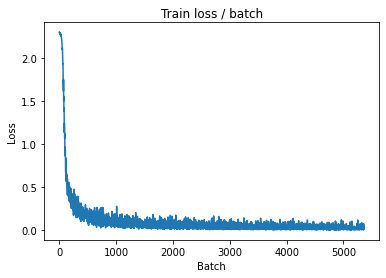

[TRAIN Batch 400/469]	Time 0.033s (0.020s)	Loss 0.0180 (0.0236)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


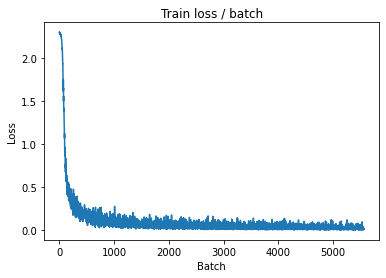


===============> Total time 9s	Avg loss 0.0241	Avg Prec@1 99.28 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.0170 (0.0170)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0308	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



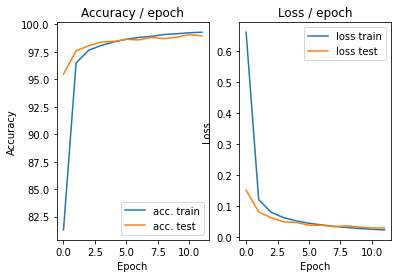

=== EPOCH 13 =====

[TRAIN Batch 000/469]	Time 0.170s (0.170s)	Loss 0.0091 (0.0091)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


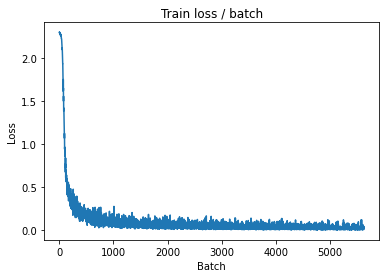

[TRAIN Batch 200/469]	Time 0.037s (0.020s)	Loss 0.0430 (0.0204)	Prec@1  98.4 ( 99.5)	Prec@5 100.0 (100.0)


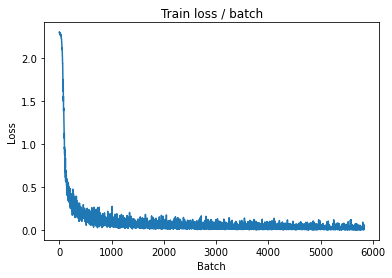

[TRAIN Batch 400/469]	Time 0.034s (0.020s)	Loss 0.0110 (0.0214)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


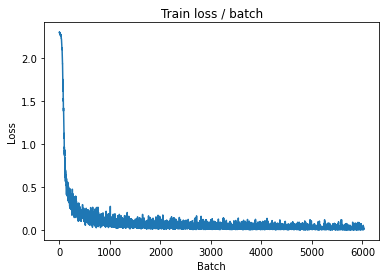


===============> Total time 9s	Avg loss 0.0218	Avg Prec@1 99.39 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.0252 (0.0252)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0318	Avg Prec@1 98.86 %	Avg Prec@5 100.00 %



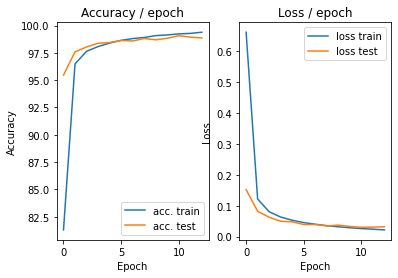

=== EPOCH 14 =====

[TRAIN Batch 000/469]	Time 0.177s (0.177s)	Loss 0.0044 (0.0044)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


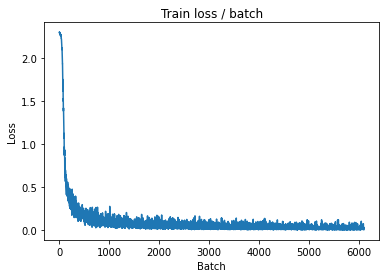

[TRAIN Batch 200/469]	Time 0.022s (0.020s)	Loss 0.0350 (0.0199)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


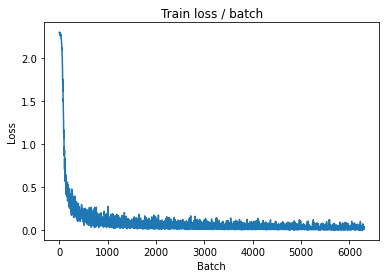

[TRAIN Batch 400/469]	Time 0.008s (0.019s)	Loss 0.0052 (0.0192)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


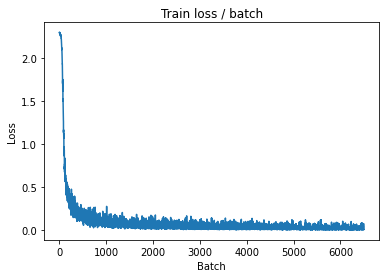


===============> Total time 9s	Avg loss 0.0196	Avg Prec@1 99.47 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.0223 (0.0223)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0315	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



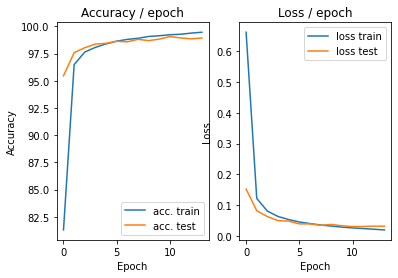

=== EPOCH 15 =====

[TRAIN Batch 000/469]	Time 0.170s (0.170s)	Loss 0.0120 (0.0120)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


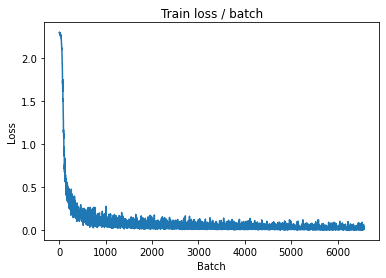

[TRAIN Batch 200/469]	Time 0.011s (0.020s)	Loss 0.0087 (0.0188)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


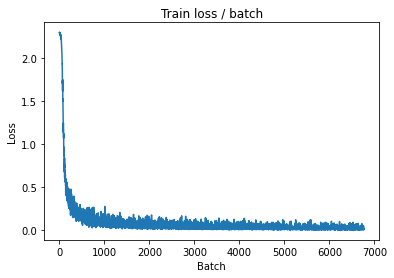

[TRAIN Batch 400/469]	Time 0.014s (0.020s)	Loss 0.0034 (0.0180)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


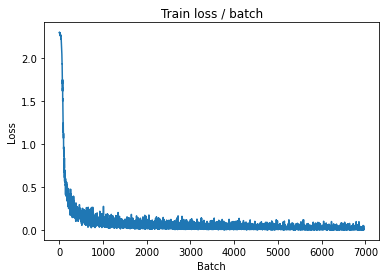


===============> Total time 9s	Avg loss 0.0183	Avg Prec@1 99.50 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.0179 (0.0179)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0320	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %



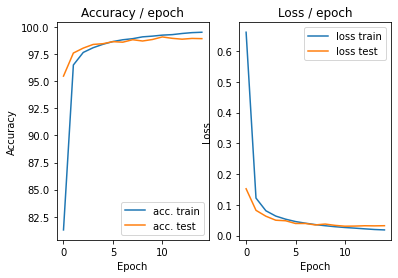

=== EPOCH 16 =====

[TRAIN Batch 000/469]	Time 0.171s (0.171s)	Loss 0.0061 (0.0061)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


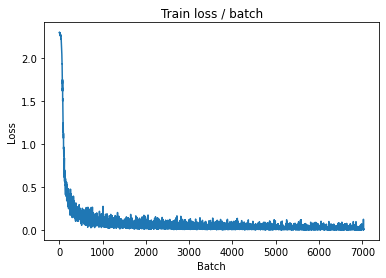

[TRAIN Batch 200/469]	Time 0.031s (0.020s)	Loss 0.0079 (0.0175)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


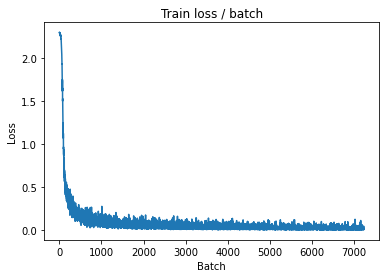

[TRAIN Batch 400/469]	Time 0.019s (0.020s)	Loss 0.0323 (0.0171)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


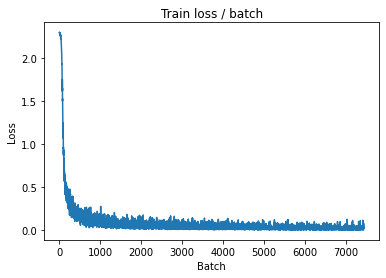


===============> Total time 9s	Avg loss 0.0167	Avg Prec@1 99.56 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.0157 (0.0157)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0299	Avg Prec@1 99.01 %	Avg Prec@5 100.00 %



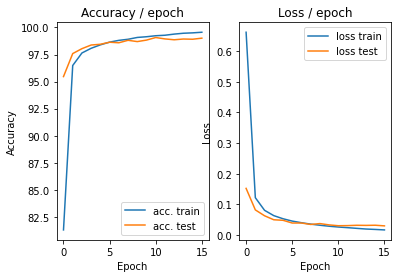

=== EPOCH 17 =====

[TRAIN Batch 000/469]	Time 0.169s (0.169s)	Loss 0.0244 (0.0244)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


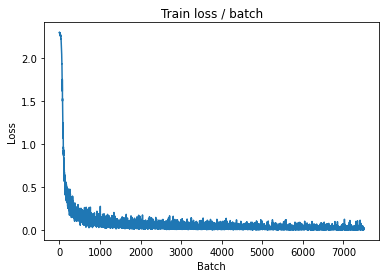

[TRAIN Batch 200/469]	Time 0.019s (0.020s)	Loss 0.0023 (0.0146)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


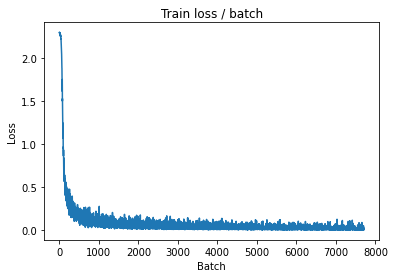

[TRAIN Batch 400/469]	Time 0.033s (0.020s)	Loss 0.0096 (0.0147)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


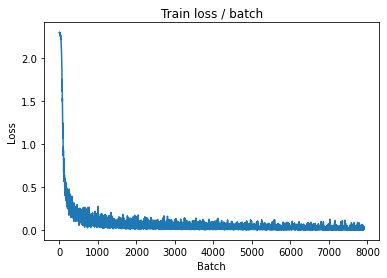


===============> Total time 9s	Avg loss 0.0150	Avg Prec@1 99.61 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.0221 (0.0221)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0314	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %



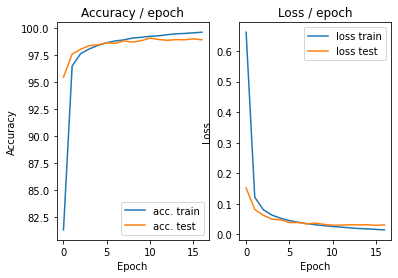

=== EPOCH 18 =====

[TRAIN Batch 000/469]	Time 0.178s (0.178s)	Loss 0.0234 (0.0234)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


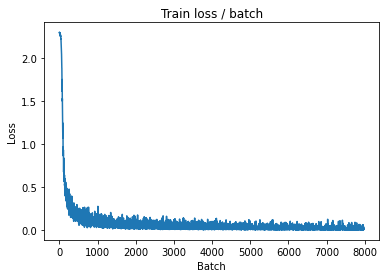

[TRAIN Batch 200/469]	Time 0.004s (0.022s)	Loss 0.0109 (0.0136)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


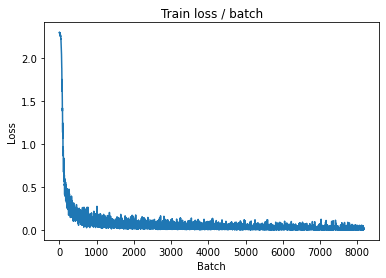

[TRAIN Batch 400/469]	Time 0.005s (0.021s)	Loss 0.0076 (0.0132)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


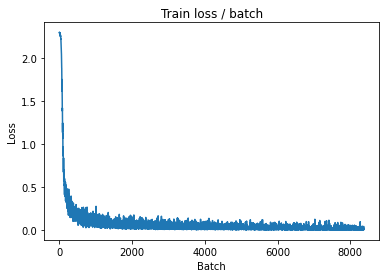


===============> Total time 9s	Avg loss 0.0135	Avg Prec@1 99.68 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.0292 (0.0292)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0308	Avg Prec@1 99.00 %	Avg Prec@5 100.00 %



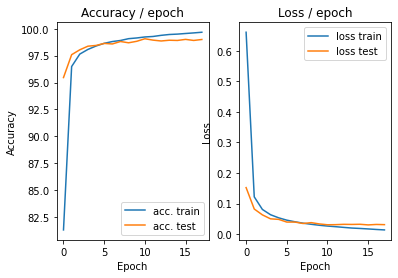

=== EPOCH 19 =====

[TRAIN Batch 000/469]	Time 0.205s (0.205s)	Loss 0.0166 (0.0166)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


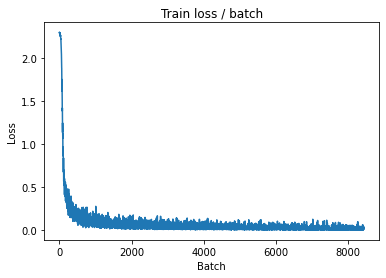

[TRAIN Batch 200/469]	Time 0.018s (0.019s)	Loss 0.0051 (0.0115)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


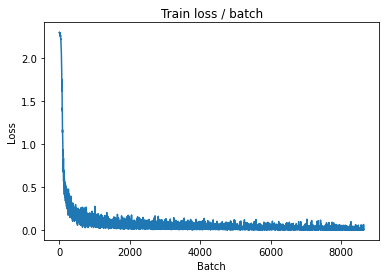

[TRAIN Batch 400/469]	Time 0.030s (0.019s)	Loss 0.0194 (0.0121)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


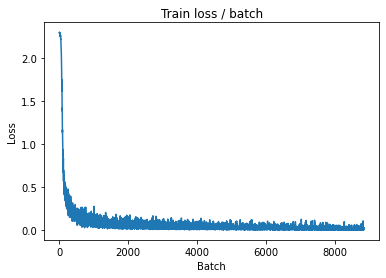


===============> Total time 9s	Avg loss 0.0127	Avg Prec@1 99.70 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.0263 (0.0263)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0301	Avg Prec@1 99.03 %	Avg Prec@5 100.00 %



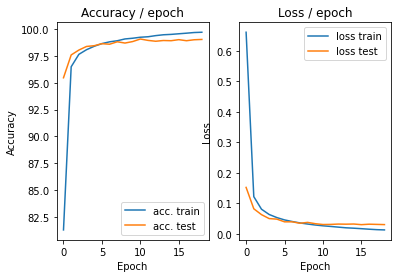

=== EPOCH 20 =====

[TRAIN Batch 000/469]	Time 0.172s (0.172s)	Loss 0.0037 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


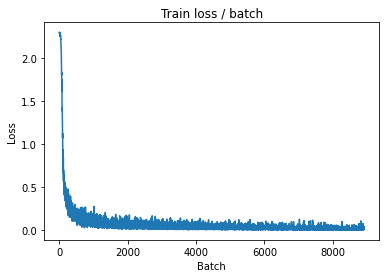

[TRAIN Batch 200/469]	Time 0.010s (0.021s)	Loss 0.0140 (0.0114)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


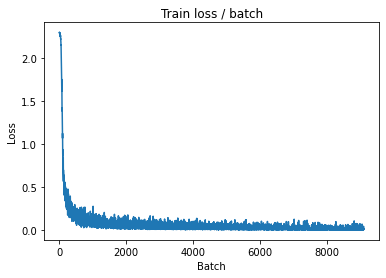

[TRAIN Batch 400/469]	Time 0.025s (0.021s)	Loss 0.0135 (0.0119)	Prec@1  99.2 ( 99.7)	Prec@5 100.0 (100.0)


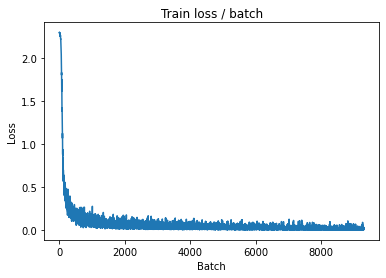


===============> Total time 9s	Avg loss 0.0117	Avg Prec@1 99.73 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0302 (0.0302)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0309	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



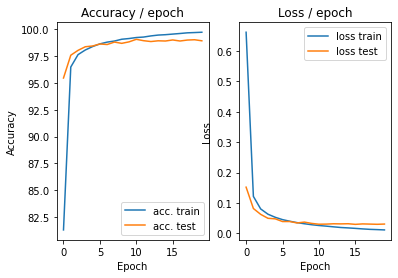

=== EPOCH 21 =====

[TRAIN Batch 000/469]	Time 0.168s (0.168s)	Loss 0.0173 (0.0173)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


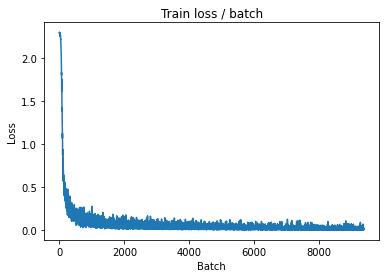

[TRAIN Batch 200/469]	Time 0.015s (0.020s)	Loss 0.0084 (0.0099)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


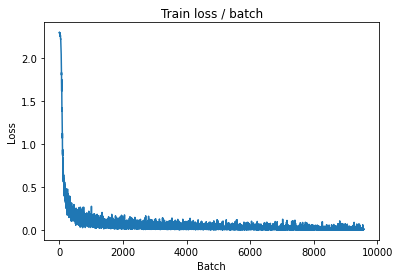

[TRAIN Batch 400/469]	Time 0.028s (0.020s)	Loss 0.0136 (0.0108)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


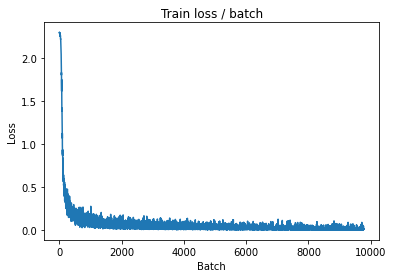


===============> Total time 9s	Avg loss 0.0106	Avg Prec@1 99.77 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.0302 (0.0302)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0302	Avg Prec@1 98.99 %	Avg Prec@5 100.00 %



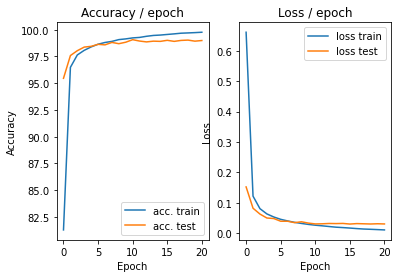

=== EPOCH 22 =====

[TRAIN Batch 000/469]	Time 0.168s (0.168s)	Loss 0.0033 (0.0033)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


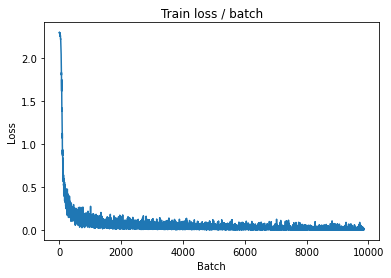

[TRAIN Batch 200/469]	Time 0.025s (0.020s)	Loss 0.0036 (0.0086)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


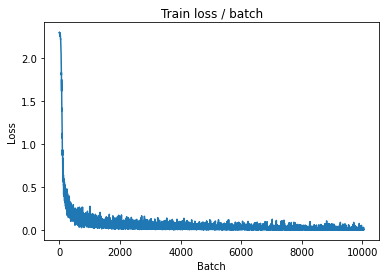

[TRAIN Batch 400/469]	Time 0.005s (0.020s)	Loss 0.0154 (0.0092)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


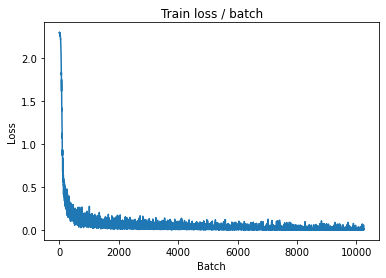


===============> Total time 9s	Avg loss 0.0097	Avg Prec@1 99.78 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.0542 (0.0542)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0312	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



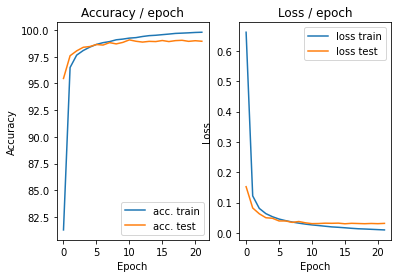

=== EPOCH 23 =====

[TRAIN Batch 000/469]	Time 0.173s (0.173s)	Loss 0.0107 (0.0107)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


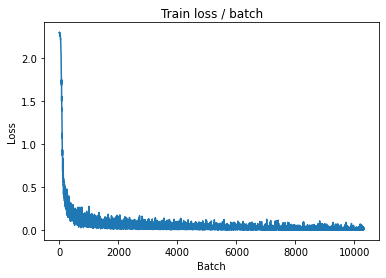

[TRAIN Batch 200/469]	Time 0.007s (0.020s)	Loss 0.0094 (0.0081)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


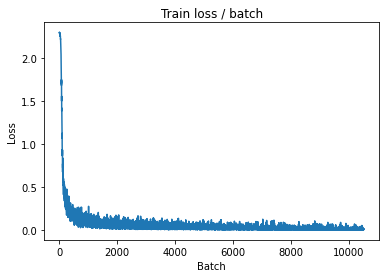

[TRAIN Batch 400/469]	Time 0.029s (0.020s)	Loss 0.0079 (0.0087)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


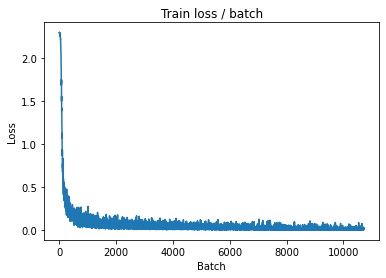


===============> Total time 9s	Avg loss 0.0087	Avg Prec@1 99.83 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.0411 (0.0411)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0293	Avg Prec@1 99.04 %	Avg Prec@5 100.00 %



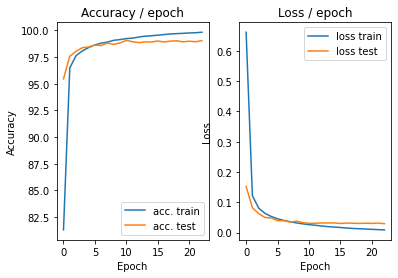

=== EPOCH 24 =====

[TRAIN Batch 000/469]	Time 0.188s (0.188s)	Loss 0.0019 (0.0019)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


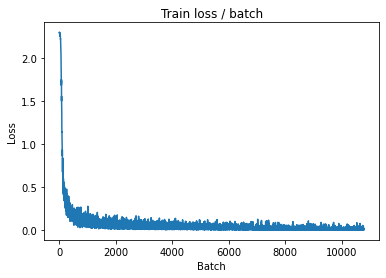

[TRAIN Batch 200/469]	Time 0.029s (0.020s)	Loss 0.0028 (0.0077)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


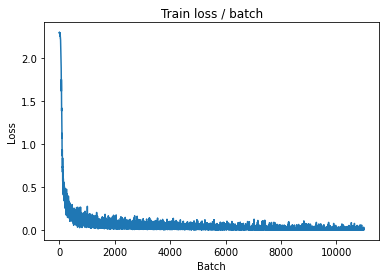

[TRAIN Batch 400/469]	Time 0.033s (0.019s)	Loss 0.0113 (0.0078)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


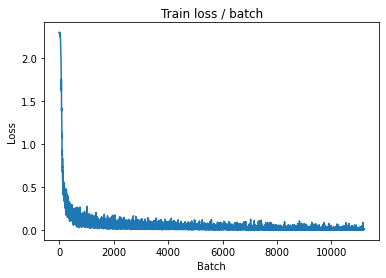


===============> Total time 9s	Avg loss 0.0079	Avg Prec@1 99.85 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.0235 (0.0235)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0339	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %



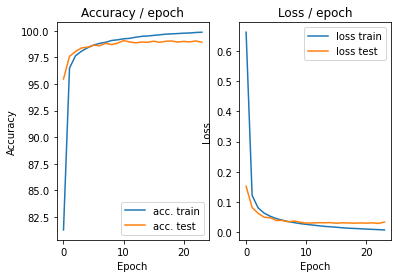

=== EPOCH 25 =====

[TRAIN Batch 000/469]	Time 0.185s (0.185s)	Loss 0.0037 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


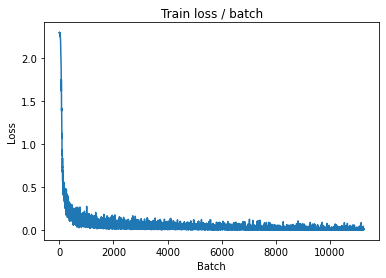

[TRAIN Batch 200/469]	Time 0.010s (0.020s)	Loss 0.0028 (0.0068)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


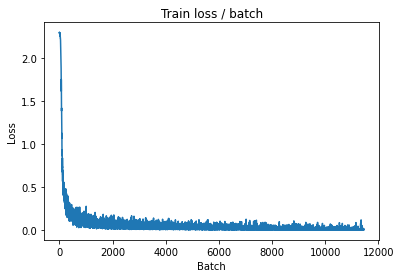

[TRAIN Batch 400/469]	Time 0.010s (0.019s)	Loss 0.0140 (0.0077)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


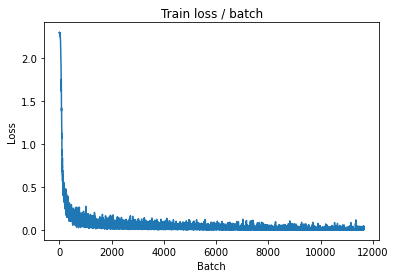


===============> Total time 9s	Avg loss 0.0077	Avg Prec@1 99.86 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.0283 (0.0283)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0297	Avg Prec@1 99.00 %	Avg Prec@5 100.00 %



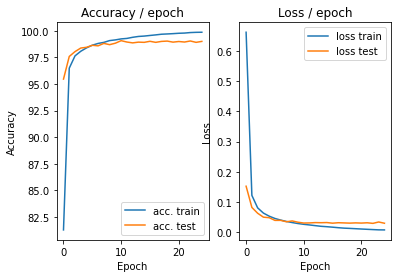

=== EPOCH 26 =====

[TRAIN Batch 000/469]	Time 0.173s (0.173s)	Loss 0.0036 (0.0036)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


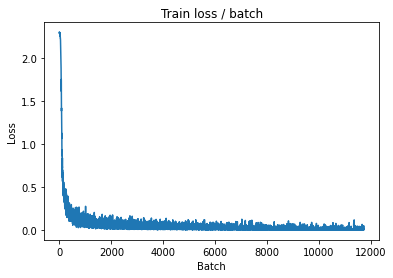

[TRAIN Batch 200/469]	Time 0.005s (0.020s)	Loss 0.0097 (0.0064)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


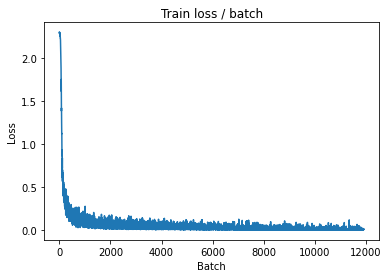

[TRAIN Batch 400/469]	Time 0.011s (0.019s)	Loss 0.0141 (0.0067)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


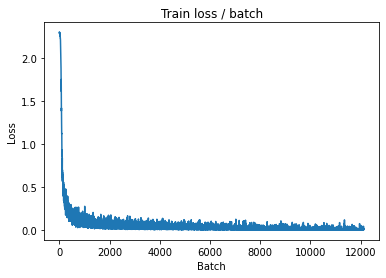


===============> Total time 9s	Avg loss 0.0068	Avg Prec@1 99.90 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.0343 (0.0343)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0305	Avg Prec@1 99.01 %	Avg Prec@5 100.00 %



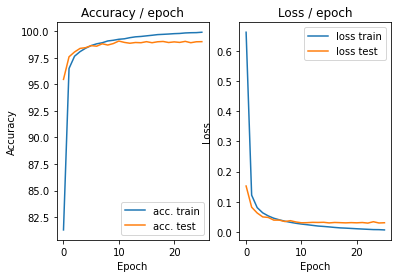

=== EPOCH 27 =====

[TRAIN Batch 000/469]	Time 0.177s (0.177s)	Loss 0.0049 (0.0049)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


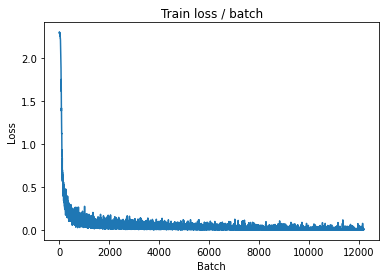

[TRAIN Batch 200/469]	Time 0.023s (0.021s)	Loss 0.0079 (0.0058)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


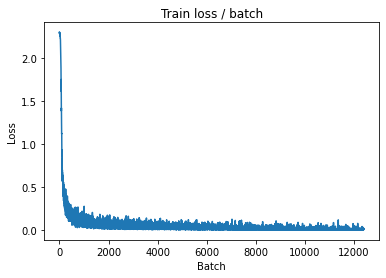

[TRAIN Batch 400/469]	Time 0.010s (0.020s)	Loss 0.0071 (0.0061)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


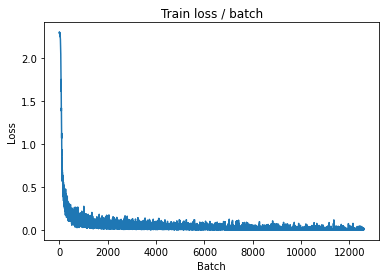


===============> Total time 9s	Avg loss 0.0064	Avg Prec@1 99.90 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0306 (0.0306)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0369	Avg Prec@1 98.82 %	Avg Prec@5 100.00 %



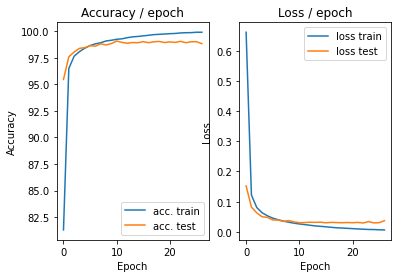

=== EPOCH 28 =====

[TRAIN Batch 000/469]	Time 0.174s (0.174s)	Loss 0.0104 (0.0104)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


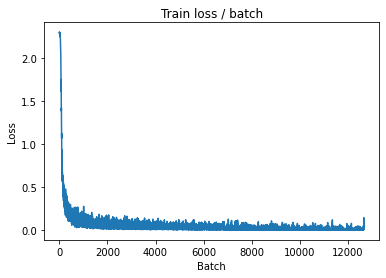

[TRAIN Batch 200/469]	Time 0.005s (0.020s)	Loss 0.0056 (0.0060)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


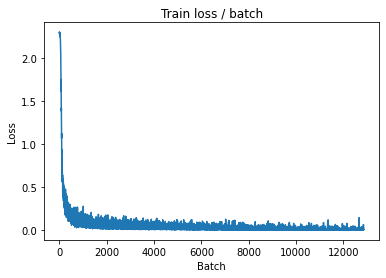

[TRAIN Batch 400/469]	Time 0.006s (0.020s)	Loss 0.0086 (0.0061)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


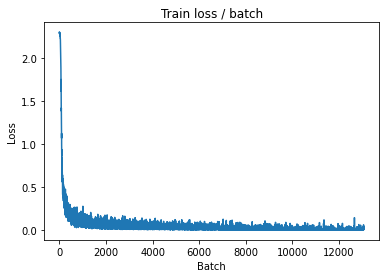


===============> Total time 9s	Avg loss 0.0059	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.0264 (0.0264)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0301	Avg Prec@1 99.05 %	Avg Prec@5 100.00 %



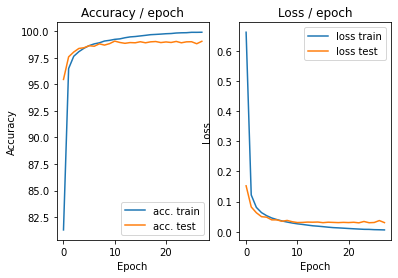

=== EPOCH 29 =====

[TRAIN Batch 000/469]	Time 0.187s (0.187s)	Loss 0.0066 (0.0066)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


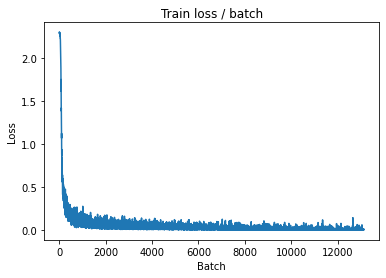

[TRAIN Batch 200/469]	Time 0.005s (0.019s)	Loss 0.0146 (0.0049)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


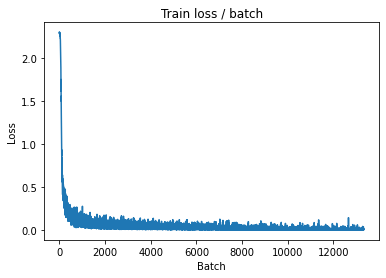

[TRAIN Batch 400/469]	Time 0.026s (0.019s)	Loss 0.0017 (0.0052)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


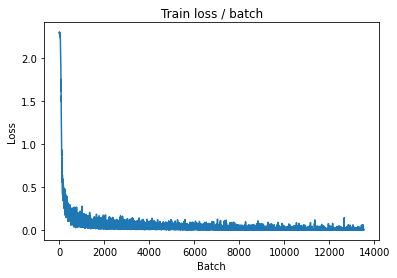


===============> Total time 9s	Avg loss 0.0055	Avg Prec@1 99.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.0417 (0.0417)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0321	Avg Prec@1 99.03 %	Avg Prec@5 100.00 %



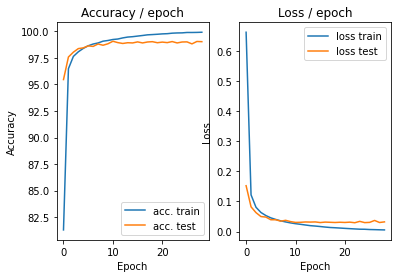

=== EPOCH 30 =====

[TRAIN Batch 000/469]	Time 0.187s (0.187s)	Loss 0.0071 (0.0071)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


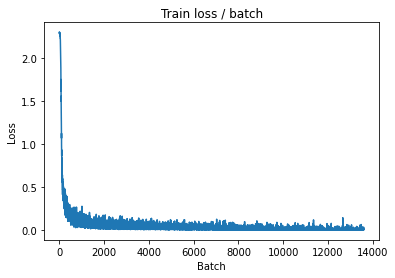

[TRAIN Batch 200/469]	Time 0.006s (0.020s)	Loss 0.0018 (0.0048)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


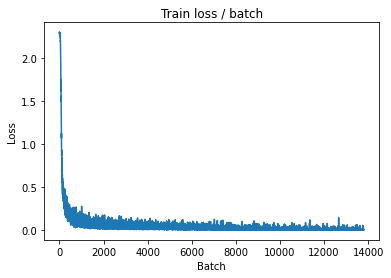

[TRAIN Batch 400/469]	Time 0.005s (0.020s)	Loss 0.0026 (0.0051)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


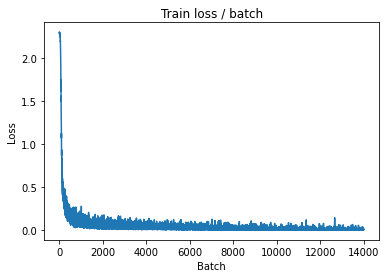


===============> Total time 9s	Avg loss 0.0051	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.0332 (0.0332)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0397	Avg Prec@1 98.76 %	Avg Prec@5 100.00 %



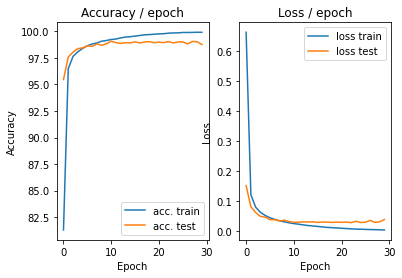

=== EPOCH 31 =====

[TRAIN Batch 000/469]	Time 0.183s (0.183s)	Loss 0.0279 (0.0279)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


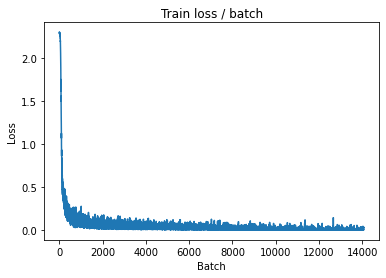

[TRAIN Batch 200/469]	Time 0.006s (0.021s)	Loss 0.0029 (0.0045)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


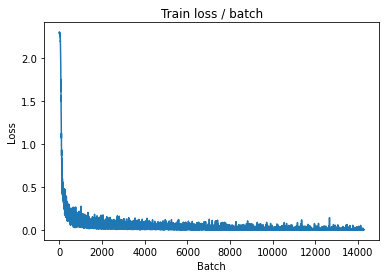

[TRAIN Batch 400/469]	Time 0.005s (0.020s)	Loss 0.0036 (0.0048)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


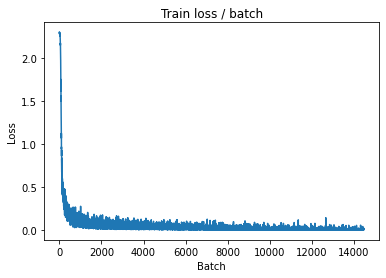


===============> Total time 9s	Avg loss 0.0048	Avg Prec@1 99.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.0376 (0.0376)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0315	Avg Prec@1 98.96 %	Avg Prec@5 100.00 %



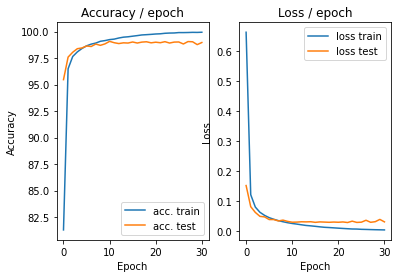

=== EPOCH 32 =====

[TRAIN Batch 000/469]	Time 0.176s (0.176s)	Loss 0.0017 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


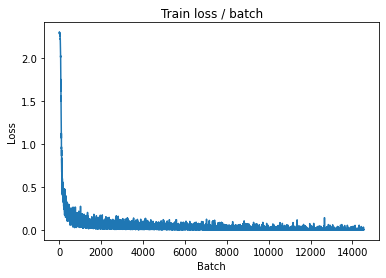

[TRAIN Batch 200/469]	Time 0.035s (0.021s)	Loss 0.0025 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


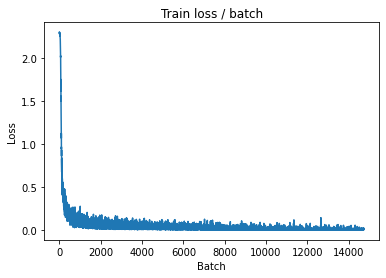

[TRAIN Batch 400/469]	Time 0.032s (0.020s)	Loss 0.0050 (0.0046)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


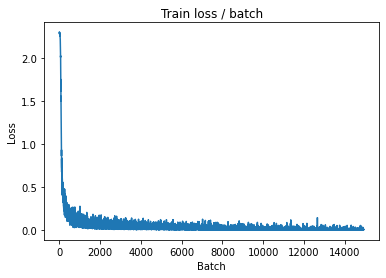


===============> Total time 9s	Avg loss 0.0044	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.0269 (0.0269)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0318	Avg Prec@1 99.00 %	Avg Prec@5 100.00 %



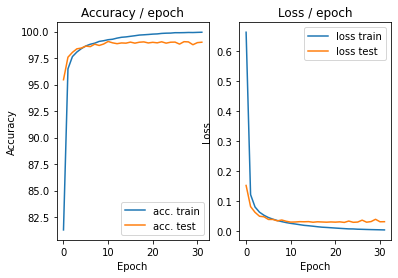

=== EPOCH 33 =====

[TRAIN Batch 000/469]	Time 0.196s (0.196s)	Loss 0.0044 (0.0044)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


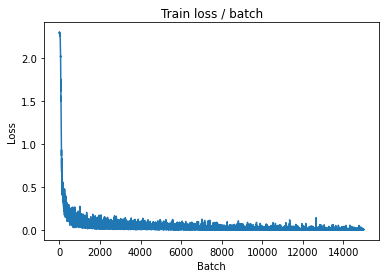

[TRAIN Batch 200/469]	Time 0.011s (0.019s)	Loss 0.0009 (0.0045)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


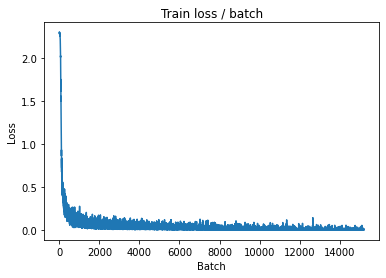

[TRAIN Batch 400/469]	Time 0.005s (0.019s)	Loss 0.0022 (0.0042)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


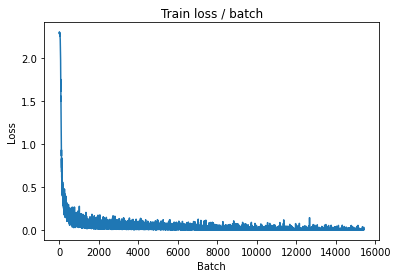


===============> Total time 9s	Avg loss 0.0040	Avg Prec@1 99.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.0394 (0.0394)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0322	Avg Prec@1 99.01 %	Avg Prec@5 100.00 %



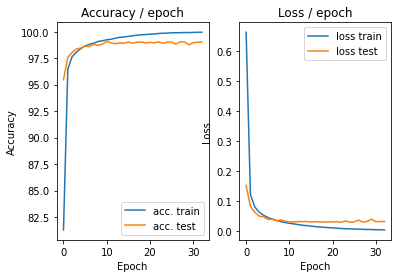

=== EPOCH 34 =====

[TRAIN Batch 000/469]	Time 0.185s (0.185s)	Loss 0.0011 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


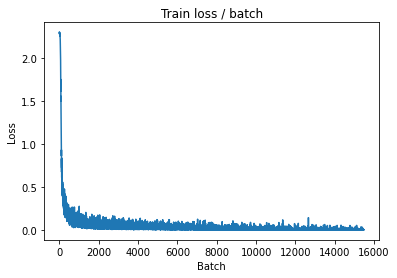

[TRAIN Batch 200/469]	Time 0.015s (0.020s)	Loss 0.0050 (0.0040)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


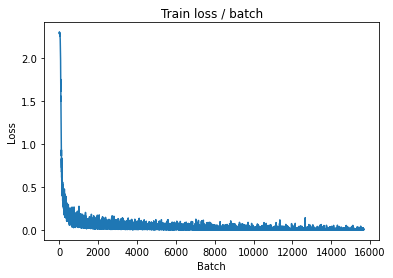

[TRAIN Batch 400/469]	Time 0.009s (0.020s)	Loss 0.0018 (0.0039)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


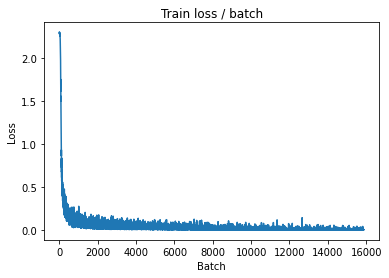


===============> Total time 9s	Avg loss 0.0038	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.0387 (0.0387)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0319	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %



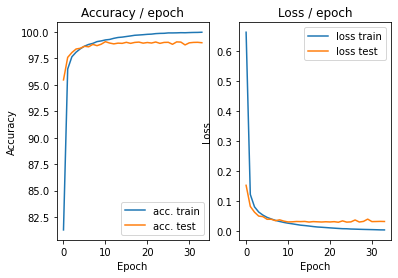

=== EPOCH 35 =====

[TRAIN Batch 000/469]	Time 0.199s (0.199s)	Loss 0.0024 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


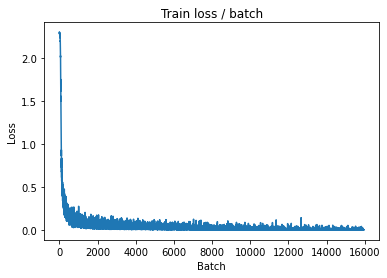

[TRAIN Batch 200/469]	Time 0.006s (0.020s)	Loss 0.0026 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


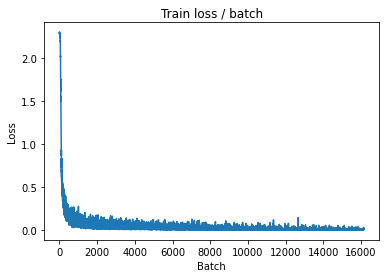

[TRAIN Batch 400/469]	Time 0.026s (0.019s)	Loss 0.0055 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


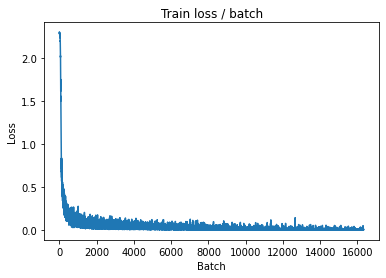


===============> Total time 9s	Avg loss 0.0036	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.0280 (0.0280)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0331	Avg Prec@1 98.99 %	Avg Prec@5 100.00 %



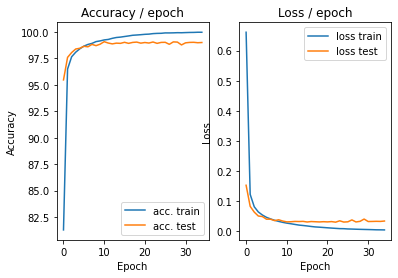

=== EPOCH 36 =====

[TRAIN Batch 000/469]	Time 0.197s (0.197s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


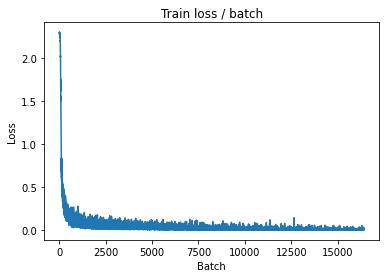

[TRAIN Batch 200/469]	Time 0.005s (0.020s)	Loss 0.0008 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


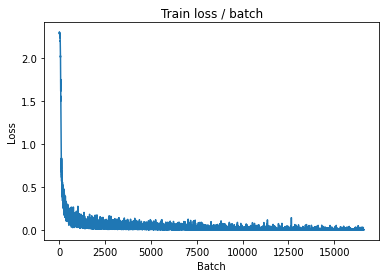

[TRAIN Batch 400/469]	Time 0.008s (0.019s)	Loss 0.0073 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


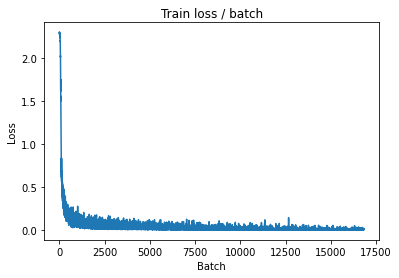


===============> Total time 9s	Avg loss 0.0034	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.0398 (0.0398)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0319	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



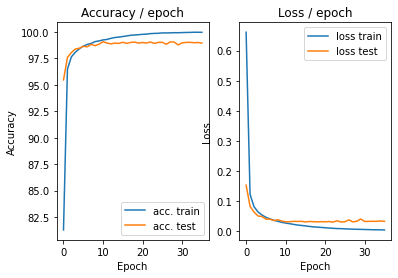

=== EPOCH 37 =====

[TRAIN Batch 000/469]	Time 0.191s (0.191s)	Loss 0.0028 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


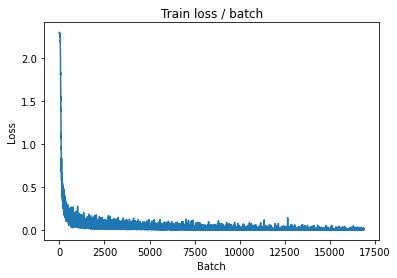

[TRAIN Batch 200/469]	Time 0.025s (0.020s)	Loss 0.0029 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


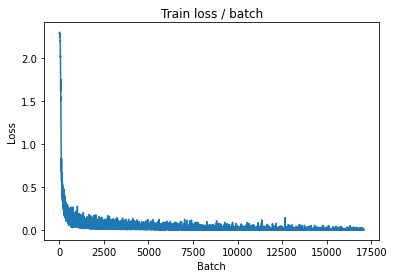

[TRAIN Batch 400/469]	Time 0.025s (0.020s)	Loss 0.0010 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


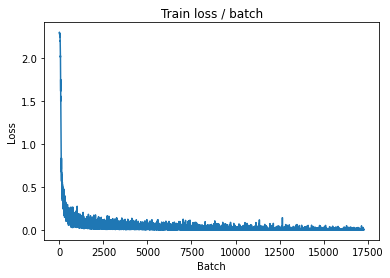


===============> Total time 9s	Avg loss 0.0031	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.0346 (0.0346)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0325	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



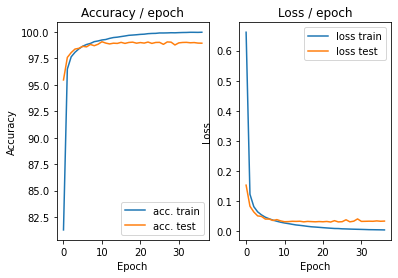

=== EPOCH 38 =====

[TRAIN Batch 000/469]	Time 0.186s (0.186s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


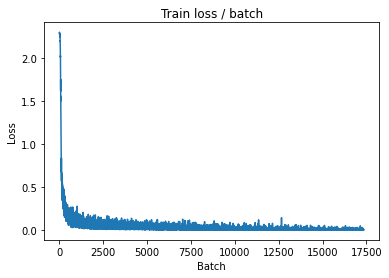

[TRAIN Batch 200/469]	Time 0.020s (0.019s)	Loss 0.0045 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


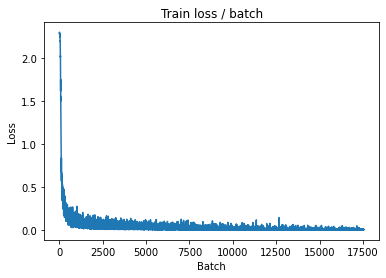

[TRAIN Batch 400/469]	Time 0.032s (0.019s)	Loss 0.0037 (0.0029)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


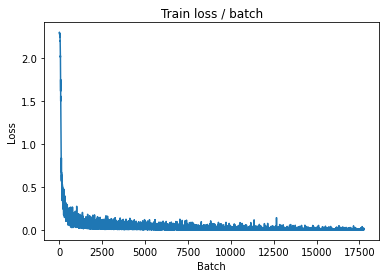


===============> Total time 9s	Avg loss 0.0029	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.0409 (0.0409)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0325	Avg Prec@1 98.96 %	Avg Prec@5 100.00 %



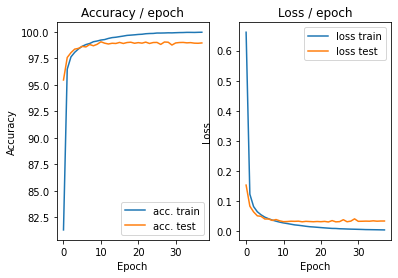

=== EPOCH 39 =====

[TRAIN Batch 000/469]	Time 0.211s (0.211s)	Loss 0.0031 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


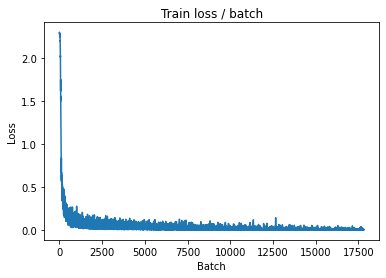

[TRAIN Batch 200/469]	Time 0.023s (0.020s)	Loss 0.0018 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


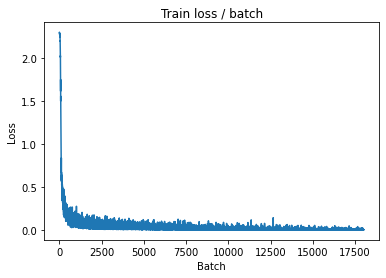

[TRAIN Batch 400/469]	Time 0.005s (0.019s)	Loss 0.0005 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


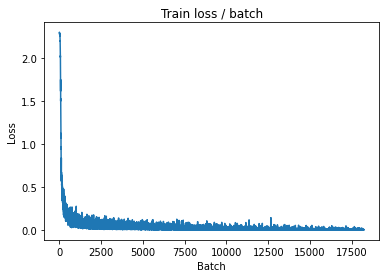


===============> Total time 9s	Avg loss 0.0028	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.0377 (0.0377)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0326	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %



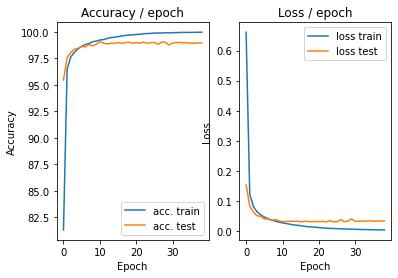

=== EPOCH 40 =====

[TRAIN Batch 000/469]	Time 0.222s (0.222s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


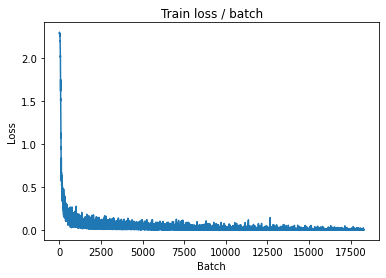

[TRAIN Batch 200/469]	Time 0.032s (0.020s)	Loss 0.0025 (0.0026)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


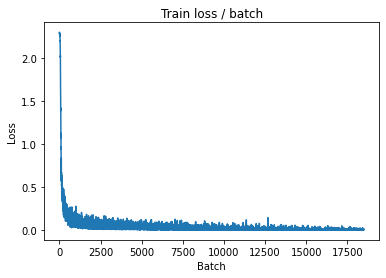

[TRAIN Batch 400/469]	Time 0.030s (0.020s)	Loss 0.0002 (0.0025)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


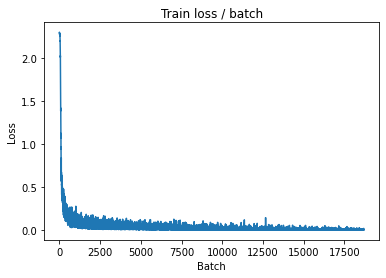


===============> Total time 9s	Avg loss 0.0025	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.0323 (0.0323)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0326	Avg Prec@1 98.99 %	Avg Prec@5 100.00 %



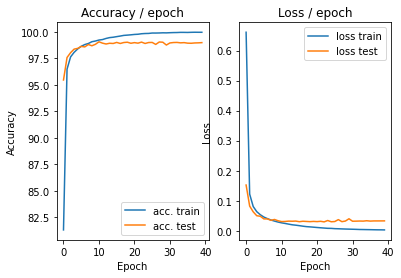

In [ ]:
main(128, 0.1, 40, cuda=True)

Partie2 CIFAR10

In [ ]:
class ConvNetCIFAR(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetCIFAR, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2), #conv1
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool1
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), #conv2
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool2
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), #conv3
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool3
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000), #fc4
            nn.ReLU(),
            nn.Linear(1000, 10), #fc5
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetCIFAR()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 4.949s (4.949s)	Loss 2.3020 (2.3020)	Prec@1   9.4 (  9.4)	Prec@5  50.8 ( 50.8)


<Figure size 432x288 with 0 Axes>

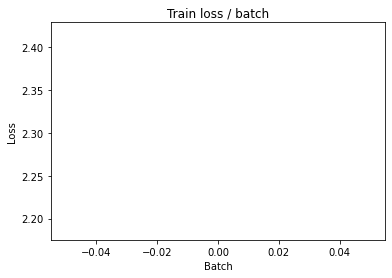

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 2.1345 (2.2283)	Prec@1  24.2 ( 17.3)	Prec@5  70.3 ( 64.2)


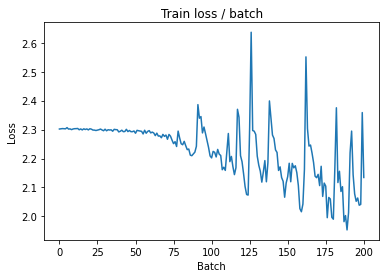


===============> Total time 14s	Avg loss 2.1097	Avg Prec@1 22.67 %	Avg Prec@5 71.47 %

[EVAL Batch 000/079]	Time 2.116s (2.116s)	Loss 1.9574 (1.9574)	Prec@1  26.6 ( 26.6)	Prec@5  79.7 ( 79.7)

===============> Total time 2s	Avg loss 2.0050	Avg Prec@1 29.86 %	Avg Prec@5 78.56 %



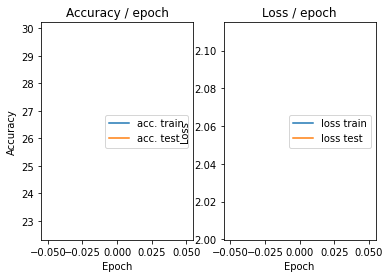

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 3.784s (3.784s)	Loss 2.1536 (2.1536)	Prec@1  22.7 ( 22.7)	Prec@5  74.2 ( 74.2)


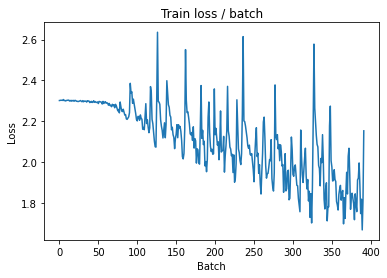

[TRAIN Batch 200/391]	Time 0.020s (0.039s)	Loss 1.6291 (1.7268)	Prec@1  40.6 ( 37.5)	Prec@5  88.3 ( 87.7)


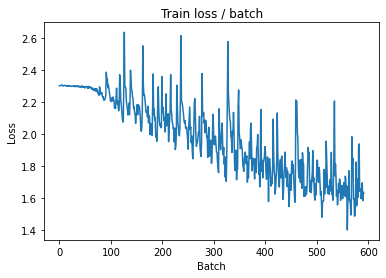


===============> Total time 11s	Avg loss 1.6493	Avg Prec@1 40.41 %	Avg Prec@5 89.00 %

[EVAL Batch 000/079]	Time 2.116s (2.116s)	Loss 1.4841 (1.4841)	Prec@1  49.2 ( 49.2)	Prec@5  86.7 ( 86.7)

===============> Total time 2s	Avg loss 1.4918	Avg Prec@1 45.34 %	Avg Prec@5 91.69 %



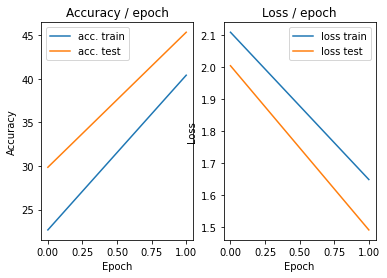

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 3.778s (3.778s)	Loss 1.3685 (1.3685)	Prec@1  43.8 ( 43.8)	Prec@5  91.4 ( 91.4)


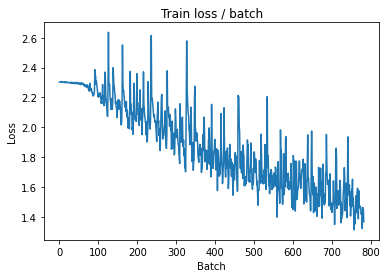

[TRAIN Batch 200/391]	Time 0.023s (0.039s)	Loss 1.4263 (1.4500)	Prec@1  53.1 ( 47.7)	Prec@5  91.4 ( 92.1)


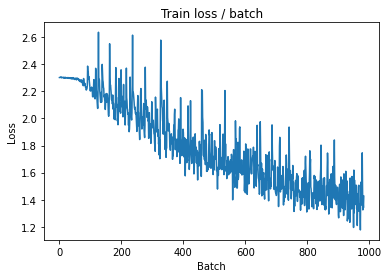


===============> Total time 11s	Avg loss 1.4064	Avg Prec@1 49.40 %	Avg Prec@5 92.74 %

[EVAL Batch 000/079]	Time 2.299s (2.299s)	Loss 1.2699 (1.2699)	Prec@1  55.5 ( 55.5)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.3546	Avg Prec@1 51.51 %	Avg Prec@5 93.50 %



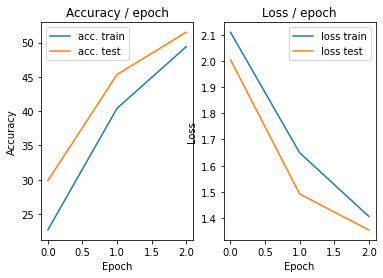

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 4.148s (4.148s)	Loss 1.2838 (1.2838)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


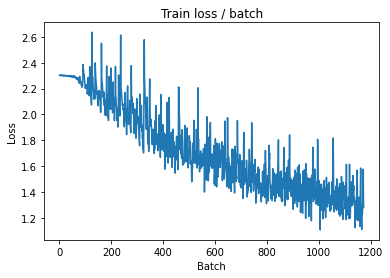

[TRAIN Batch 200/391]	Time 0.027s (0.047s)	Loss 1.3397 (1.2698)	Prec@1  50.8 ( 55.0)	Prec@5  89.8 ( 94.3)


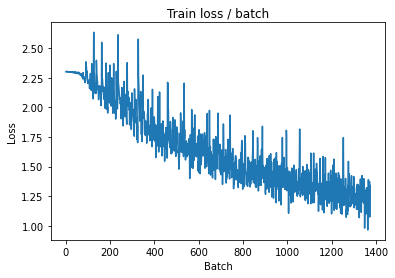


===============> Total time 14s	Avg loss 1.2415	Avg Prec@1 55.87 %	Avg Prec@5 94.66 %

[EVAL Batch 000/079]	Time 2.583s (2.583s)	Loss 1.0290 (1.0290)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.1983	Avg Prec@1 57.41 %	Avg Prec@5 95.30 %



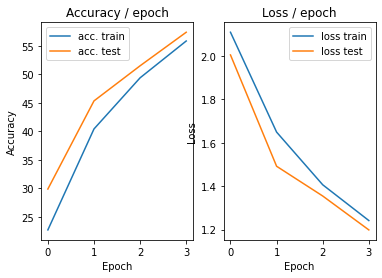

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 3.923s (3.923s)	Loss 1.2306 (1.2306)	Prec@1  55.5 ( 55.5)	Prec@5  96.9 ( 96.9)


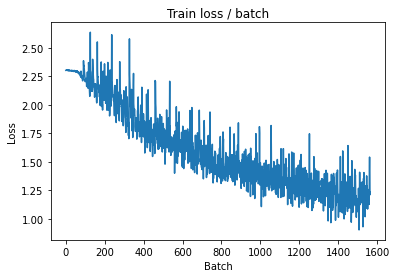

[TRAIN Batch 200/391]	Time 0.025s (0.041s)	Loss 1.0738 (1.1146)	Prec@1  69.5 ( 60.7)	Prec@5  94.5 ( 96.0)


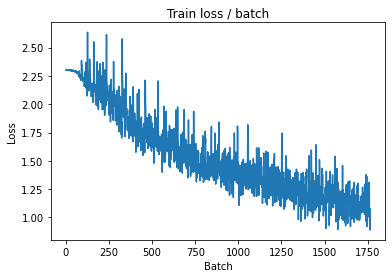


===============> Total time 12s	Avg loss 1.1091	Avg Prec@1 60.64 %	Avg Prec@5 96.00 %

[EVAL Batch 000/079]	Time 2.149s (2.149s)	Loss 1.0447 (1.0447)	Prec@1  64.1 ( 64.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.2350	Avg Prec@1 56.62 %	Avg Prec@5 95.52 %



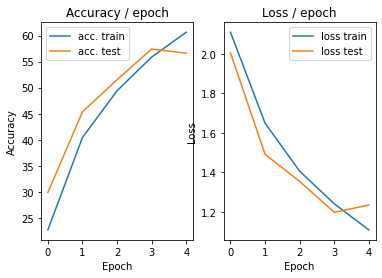

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 3.706s (3.706s)	Loss 1.2558 (1.2558)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


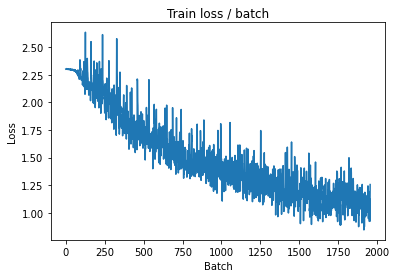

[TRAIN Batch 200/391]	Time 0.012s (0.033s)	Loss 1.1034 (0.9943)	Prec@1  57.0 ( 64.5)	Prec@5  97.7 ( 97.0)


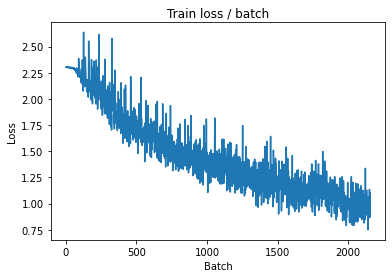


===============> Total time 9s	Avg loss 0.9922	Avg Prec@1 64.88 %	Avg Prec@5 96.84 %

[EVAL Batch 000/079]	Time 2.015s (2.015s)	Loss 0.9186 (0.9186)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0007	Avg Prec@1 65.03 %	Avg Prec@5 96.70 %



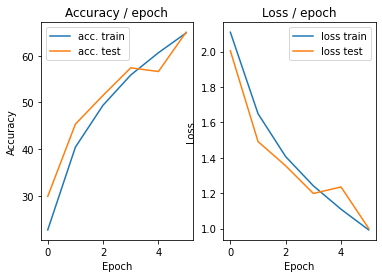

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 3.833s (3.833s)	Loss 0.9317 (0.9317)	Prec@1  64.8 ( 64.8)	Prec@5  98.4 ( 98.4)


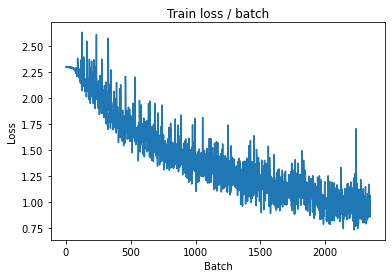

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.8895 (0.8727)	Prec@1  71.1 ( 69.6)	Prec@5  96.1 ( 97.6)


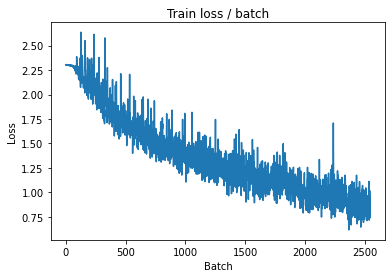


===============> Total time 10s	Avg loss 0.8791	Avg Prec@1 69.22 %	Avg Prec@5 97.56 %

[EVAL Batch 000/079]	Time 2.172s (2.172s)	Loss 0.9430 (0.9430)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9825	Avg Prec@1 65.63 %	Avg Prec@5 96.79 %



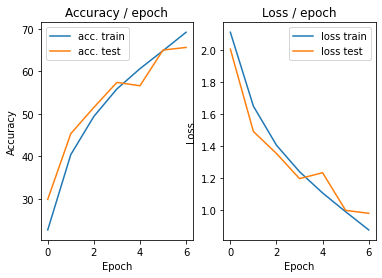

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 4.310s (4.310s)	Loss 0.7521 (0.7521)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)


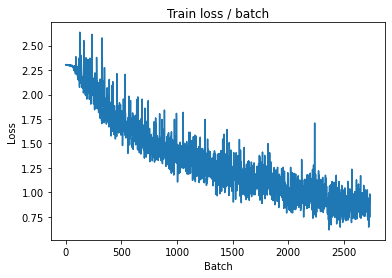

[TRAIN Batch 200/391]	Time 0.015s (0.036s)	Loss 0.9121 (0.7841)	Prec@1  72.7 ( 72.3)	Prec@5  96.9 ( 98.1)


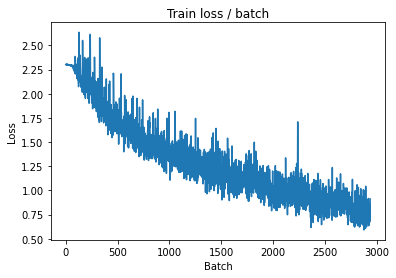


===============> Total time 10s	Avg loss 0.7838	Avg Prec@1 72.41 %	Avg Prec@5 98.12 %

[EVAL Batch 000/079]	Time 2.142s (2.142s)	Loss 0.8425 (0.8425)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9585	Avg Prec@1 67.00 %	Avg Prec@5 97.09 %



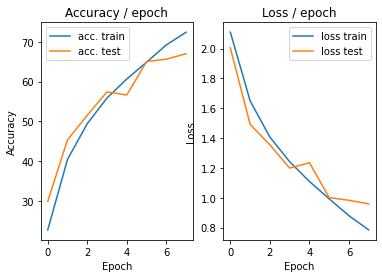

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 3.763s (3.763s)	Loss 0.6582 (0.6582)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


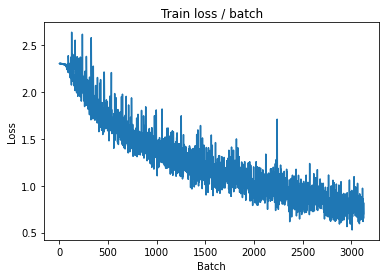

[TRAIN Batch 200/391]	Time 0.029s (0.044s)	Loss 0.6069 (0.6709)	Prec@1  81.2 ( 76.4)	Prec@5  96.9 ( 98.7)


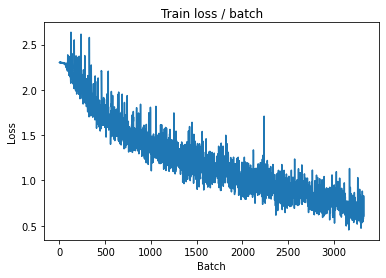


===============> Total time 13s	Avg loss 0.6803	Avg Prec@1 76.13 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 2.159s (2.159s)	Loss 0.9092 (0.9092)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9698	Avg Prec@1 66.75 %	Avg Prec@5 97.04 %



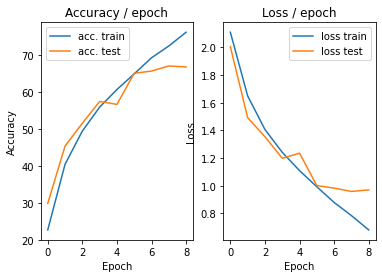

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 3.774s (3.774s)	Loss 0.6324 (0.6324)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)


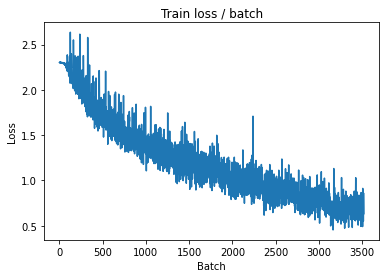

[TRAIN Batch 200/391]	Time 0.024s (0.045s)	Loss 0.5866 (0.5888)	Prec@1  83.6 ( 79.5)	Prec@5  99.2 ( 99.1)


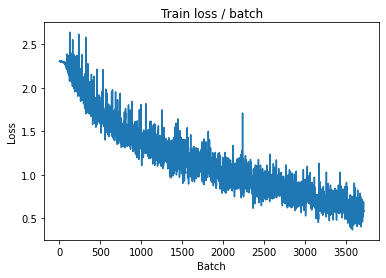


===============> Total time 14s	Avg loss 0.5938	Avg Prec@1 79.13 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 2.142s (2.142s)	Loss 1.1747 (1.1747)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0576	Avg Prec@1 65.01 %	Avg Prec@5 96.69 %



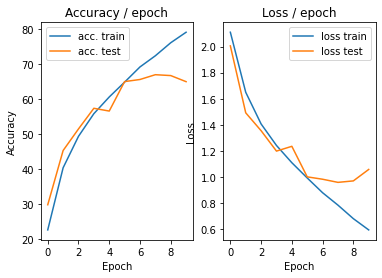

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 4.043s (4.043s)	Loss 0.5270 (0.5270)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


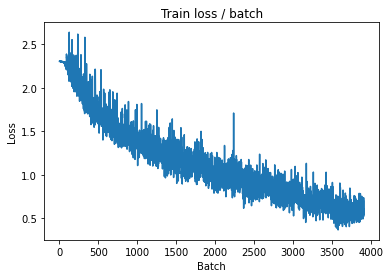

[TRAIN Batch 200/391]	Time 0.026s (0.046s)	Loss 0.5152 (0.4707)	Prec@1  78.9 ( 83.6)	Prec@5  99.2 ( 99.4)


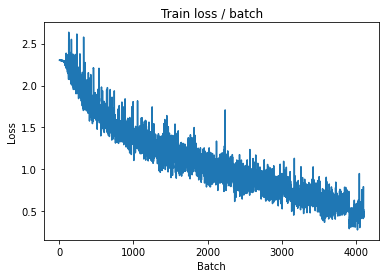


===============> Total time 14s	Avg loss 0.4903	Avg Prec@1 82.91 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 2.130s (2.130s)	Loss 0.9702 (0.9702)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9969	Avg Prec@1 68.51 %	Avg Prec@5 97.12 %



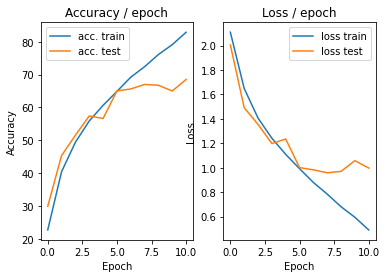

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 3.923s (3.923s)	Loss 0.3915 (0.3915)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


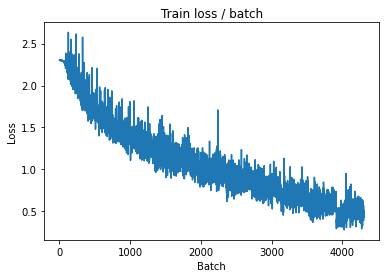

[TRAIN Batch 200/391]	Time 0.016s (0.039s)	Loss 0.3888 (0.3820)	Prec@1  85.9 ( 86.6)	Prec@5 100.0 ( 99.8)


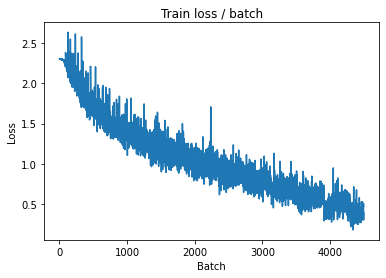


===============> Total time 11s	Avg loss 0.4014	Avg Prec@1 85.80 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 2.202s (2.202s)	Loss 1.0359 (1.0359)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.0147	Avg Prec@1 69.04 %	Avg Prec@5 97.20 %



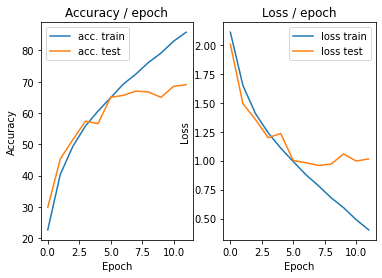

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 3.866s (3.866s)	Loss 0.2354 (0.2354)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


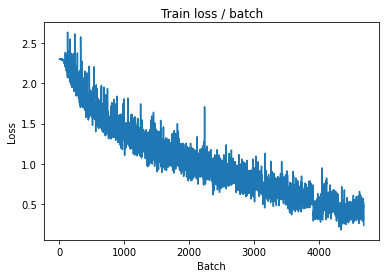

[TRAIN Batch 200/391]	Time 0.013s (0.036s)	Loss 0.3101 (0.2920)	Prec@1  88.3 ( 89.8)	Prec@5 100.0 ( 99.9)


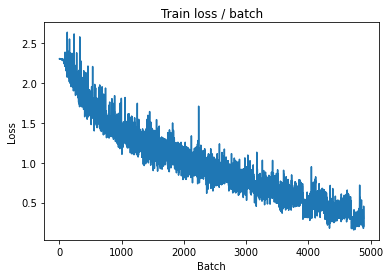


===============> Total time 11s	Avg loss 0.3125	Avg Prec@1 88.98 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 2.206s (2.206s)	Loss 1.2927 (1.2927)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.1371	Avg Prec@1 67.84 %	Avg Prec@5 96.75 %



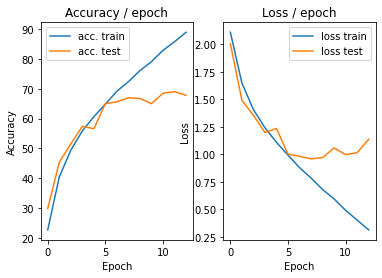

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 4.612s (4.612s)	Loss 0.2270 (0.2270)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


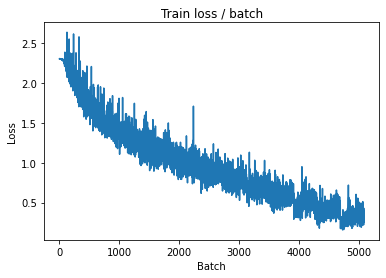

[TRAIN Batch 200/391]	Time 0.015s (0.046s)	Loss 0.2066 (0.2005)	Prec@1  91.4 ( 93.4)	Prec@5 100.0 ( 99.9)


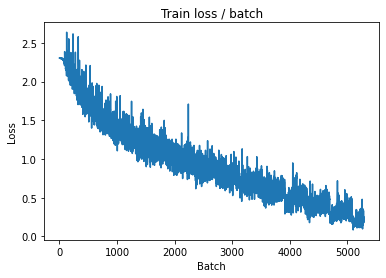


===============> Total time 13s	Avg loss 0.2328	Avg Prec@1 92.06 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 2.803s (2.803s)	Loss 1.2683 (1.2683)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2445	Avg Prec@1 66.80 %	Avg Prec@5 96.59 %



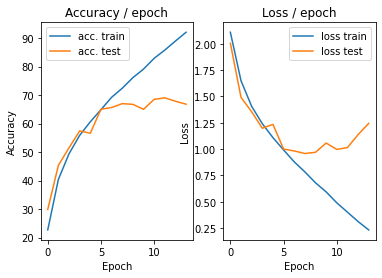

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 4.057s (4.057s)	Loss 0.1998 (0.1998)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


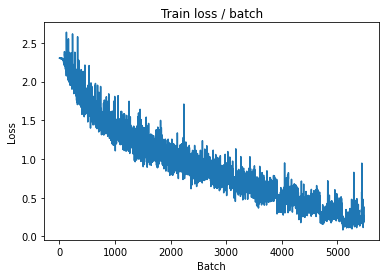

[TRAIN Batch 200/391]	Time 0.025s (0.044s)	Loss 0.1825 (0.1486)	Prec@1  92.2 ( 95.2)	Prec@5 100.0 (100.0)


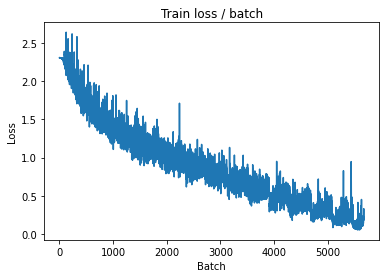


===============> Total time 13s	Avg loss 0.1649	Avg Prec@1 94.49 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 2.665s (2.665s)	Loss 1.4880 (1.4880)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.3364	Avg Prec@1 69.00 %	Avg Prec@5 96.74 %



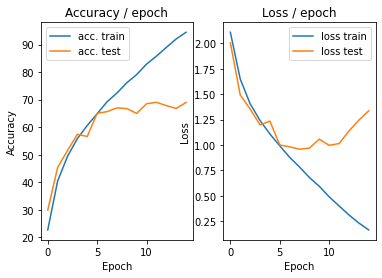

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 4.454s (4.454s)	Loss 0.1105 (0.1105)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


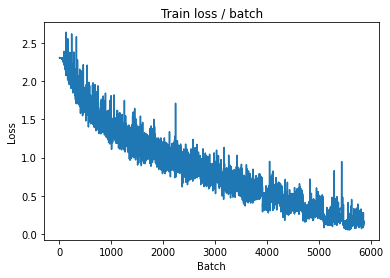

[TRAIN Batch 200/391]	Time 0.022s (0.042s)	Loss 0.2091 (0.0909)	Prec@1  93.8 ( 97.1)	Prec@5 100.0 (100.0)


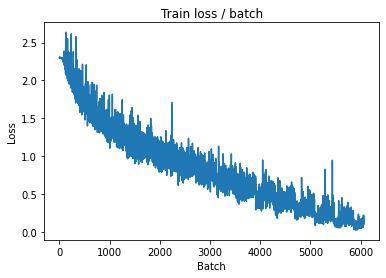


===============> Total time 11s	Avg loss 0.1211	Avg Prec@1 95.99 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 2.050s (2.050s)	Loss 1.7843 (1.7843)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.8942	Avg Prec@1 63.36 %	Avg Prec@5 95.66 %



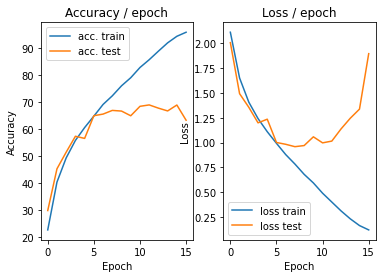

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 3.939s (3.939s)	Loss 0.6410 (0.6410)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


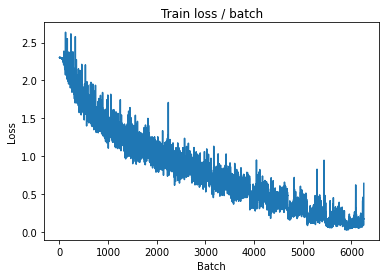

[TRAIN Batch 200/391]	Time 0.016s (0.035s)	Loss 0.1118 (0.0667)	Prec@1  98.4 ( 98.1)	Prec@5 100.0 (100.0)


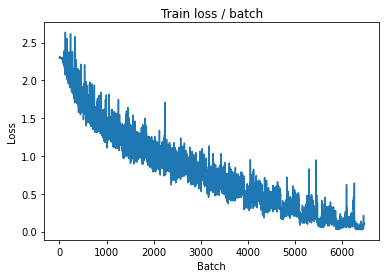


===============> Total time 10s	Avg loss 0.0817	Avg Prec@1 97.44 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 2.364s (2.364s)	Loss 1.6530 (1.6530)	Prec@1  60.9 ( 60.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.4885	Avg Prec@1 69.75 %	Avg Prec@5 96.99 %



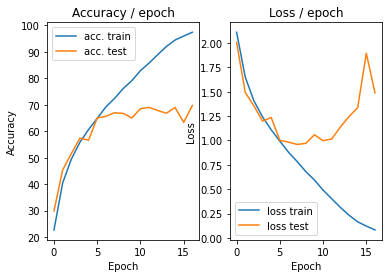

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 4.743s (4.743s)	Loss 0.0286 (0.0286)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


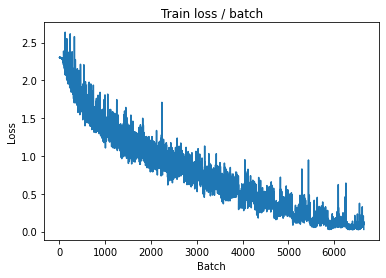

[TRAIN Batch 200/391]	Time 0.030s (0.048s)	Loss 0.1137 (0.1325)	Prec@1  96.1 ( 96.6)	Prec@5 100.0 ( 99.8)


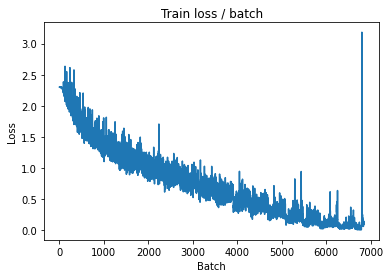


===============> Total time 14s	Avg loss 0.1088	Avg Prec@1 96.99 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 2.204s (2.204s)	Loss 2.0215 (2.0215)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5504	Avg Prec@1 70.23 %	Avg Prec@5 96.85 %



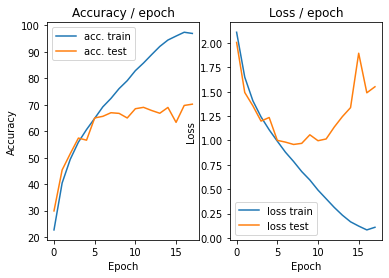

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 4.465s (4.465s)	Loss 0.0466 (0.0466)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


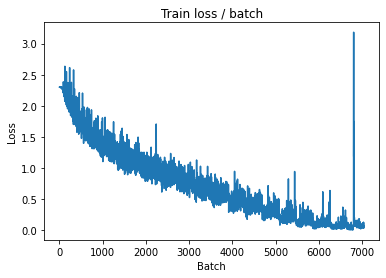

[TRAIN Batch 200/391]	Time 0.011s (0.045s)	Loss 0.0325 (0.0271)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


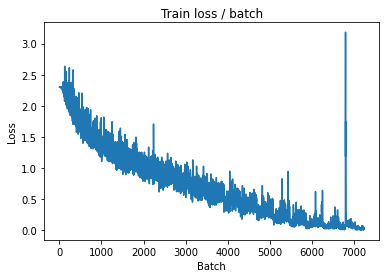


===============> Total time 12s	Avg loss 0.0278	Avg Prec@1 99.29 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.470s (2.470s)	Loss 2.0960 (2.0960)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.7397	Avg Prec@1 70.02 %	Avg Prec@5 97.11 %



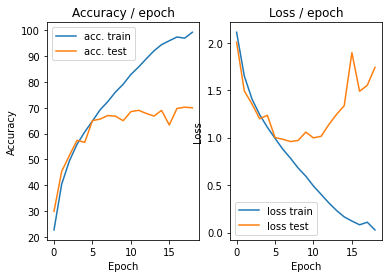

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 5.216s (5.216s)	Loss 0.0232 (0.0232)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


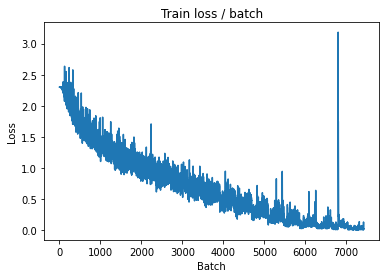

[TRAIN Batch 200/391]	Time 0.018s (0.042s)	Loss 0.0172 (0.0133)	Prec@1  99.2 ( 99.7)	Prec@5 100.0 (100.0)


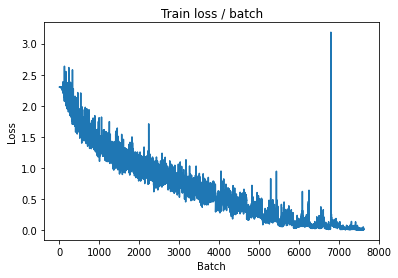


===============> Total time 11s	Avg loss 0.0123	Avg Prec@1 99.72 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.497s (2.497s)	Loss 2.1015 (2.1015)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.8457	Avg Prec@1 71.33 %	Avg Prec@5 97.15 %



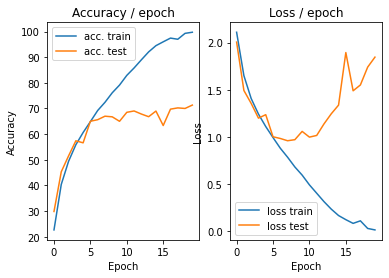

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 4.480s (4.480s)	Loss 0.0101 (0.0101)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


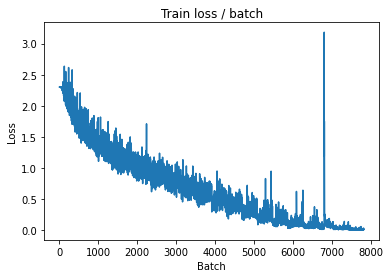

[TRAIN Batch 200/391]	Time 0.014s (0.043s)	Loss 0.0035 (0.0054)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


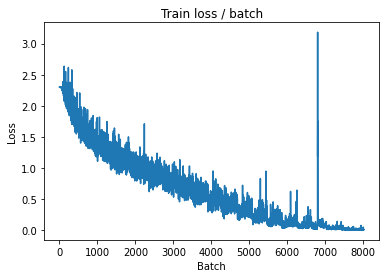


===============> Total time 12s	Avg loss 0.0048	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.124s (2.124s)	Loss 2.2033 (2.2033)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.8845	Avg Prec@1 71.70 %	Avg Prec@5 97.14 %



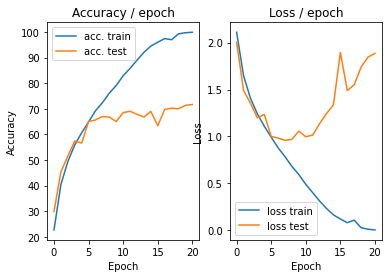

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 4.068s (4.068s)	Loss 0.0024 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


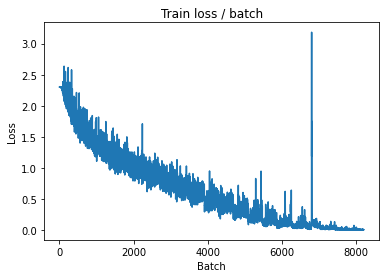

[TRAIN Batch 200/391]	Time 0.016s (0.037s)	Loss 0.0014 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


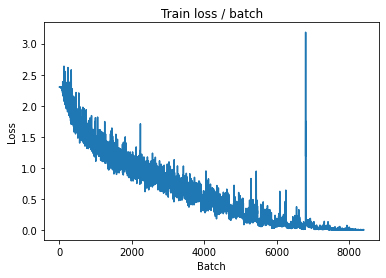


===============> Total time 10s	Avg loss 0.0013	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.593s (2.593s)	Loss 2.3452 (2.3452)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.9826	Avg Prec@1 71.75 %	Avg Prec@5 97.24 %



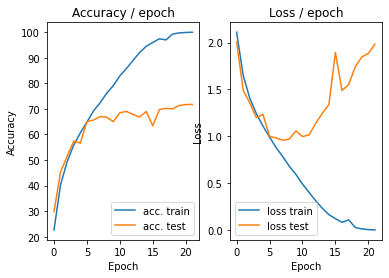

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 3.999s (3.999s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


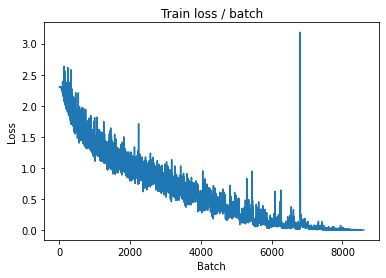

[TRAIN Batch 200/391]	Time 0.027s (0.040s)	Loss 0.0004 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


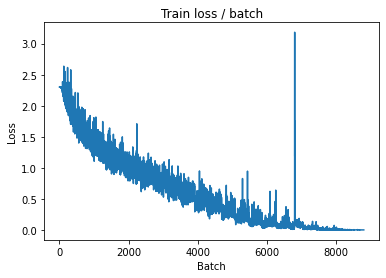


===============> Total time 12s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.496s (2.496s)	Loss 2.4419 (2.4419)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.0399	Avg Prec@1 71.66 %	Avg Prec@5 97.33 %



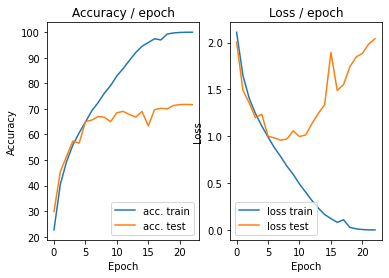

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 3.937s (3.937s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


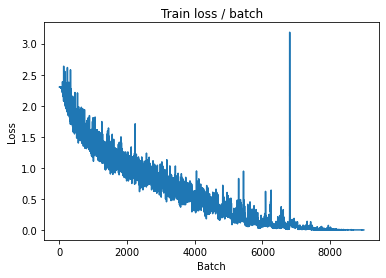

[TRAIN Batch 200/391]	Time 0.018s (0.040s)	Loss 0.0004 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


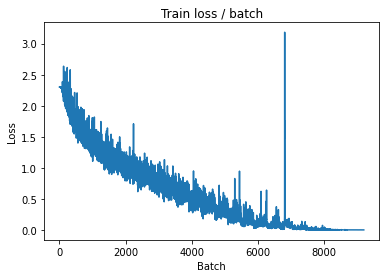


===============> Total time 11s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.289s (2.289s)	Loss 2.4822 (2.4822)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.0807	Avg Prec@1 71.78 %	Avg Prec@5 97.41 %



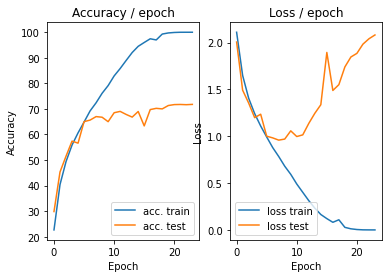

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 4.032s (4.032s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


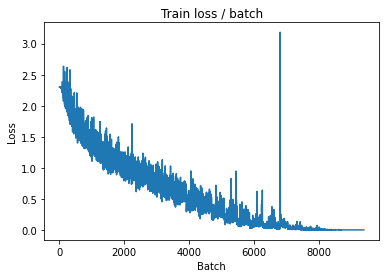

[TRAIN Batch 200/391]	Time 0.016s (0.037s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


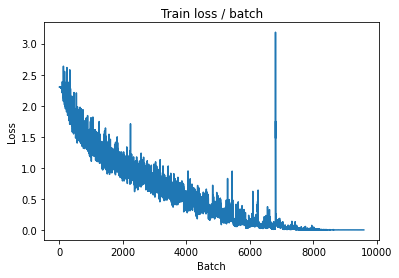


===============> Total time 11s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.455s (2.455s)	Loss 2.5279 (2.5279)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.1175	Avg Prec@1 71.73 %	Avg Prec@5 97.39 %



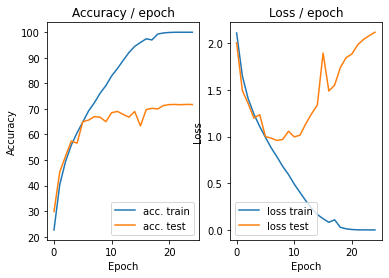

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 4.050s (4.050s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


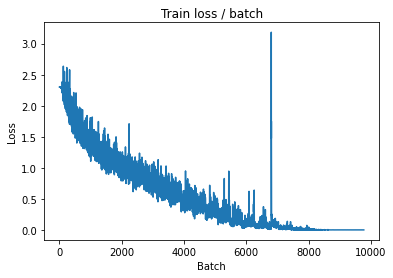

[TRAIN Batch 200/391]	Time 0.025s (0.043s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


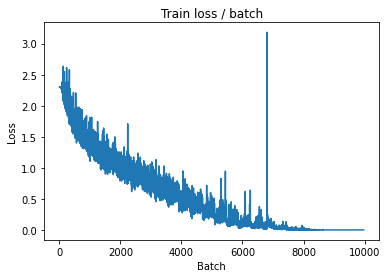


===============> Total time 13s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.373s (2.373s)	Loss 2.5621 (2.5621)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.1487	Avg Prec@1 71.67 %	Avg Prec@5 97.41 %



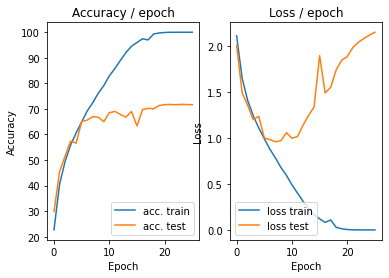

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 4.064s (4.064s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


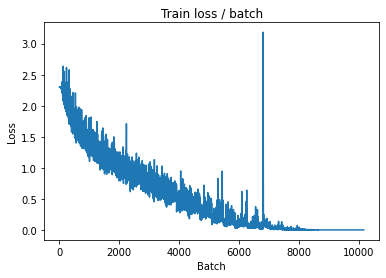

[TRAIN Batch 200/391]	Time 0.020s (0.046s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


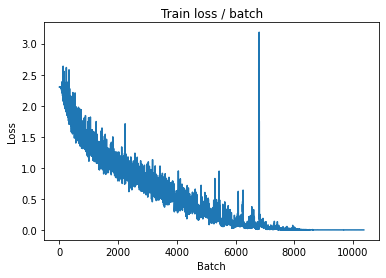


===============> Total time 13s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.230s (2.230s)	Loss 2.6031 (2.6031)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.1734	Avg Prec@1 71.62 %	Avg Prec@5 97.41 %



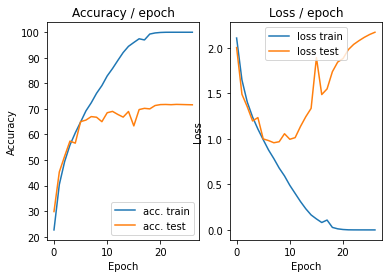

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 4.260s (4.260s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


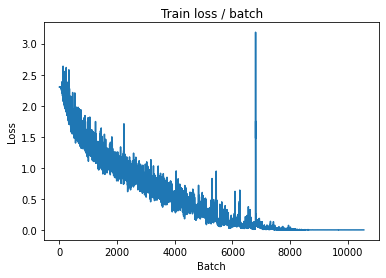

[TRAIN Batch 200/391]	Time 0.021s (0.041s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


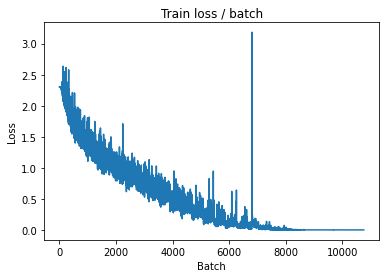


===============> Total time 11s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.165s (2.165s)	Loss 2.6221 (2.6221)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.1975	Avg Prec@1 71.60 %	Avg Prec@5 97.36 %



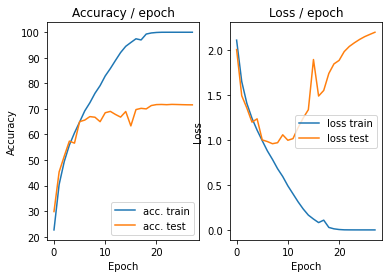

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 3.933s (3.933s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


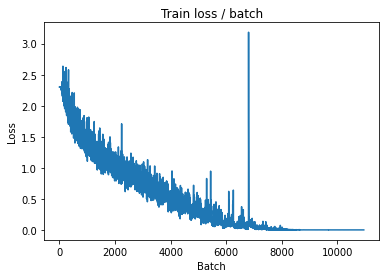

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.0003 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


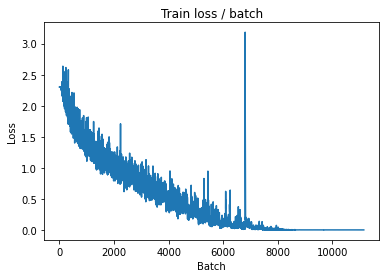


===============> Total time 10s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.229s (2.229s)	Loss 2.6472 (2.6472)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.2194	Avg Prec@1 71.68 %	Avg Prec@5 97.36 %



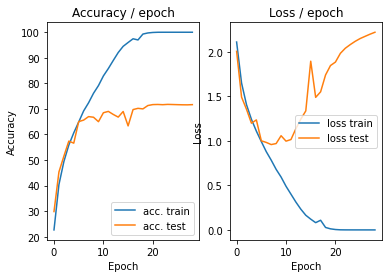

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 4.209s (4.209s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


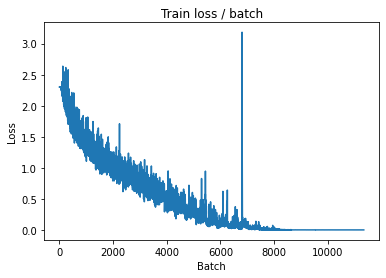

[TRAIN Batch 200/391]	Time 0.027s (0.048s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


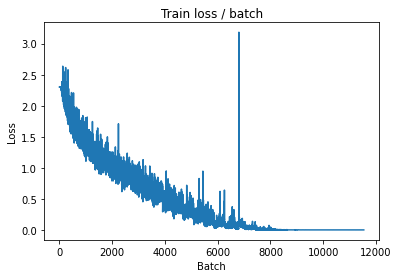


===============> Total time 14s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.173s (2.173s)	Loss 2.6612 (2.6612)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.2386	Avg Prec@1 71.67 %	Avg Prec@5 97.38 %



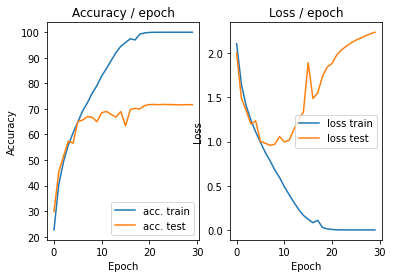

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 4.307s (4.307s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


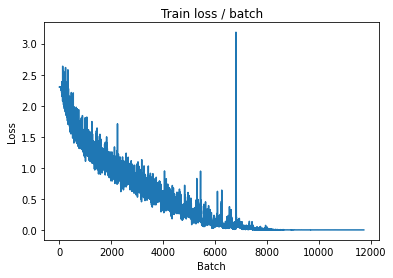

[TRAIN Batch 200/391]	Time 0.014s (0.038s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


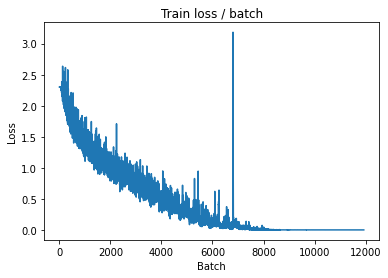


===============> Total time 10s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.329s (2.329s)	Loss 2.6830 (2.6830)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.2564	Avg Prec@1 71.64 %	Avg Prec@5 97.38 %



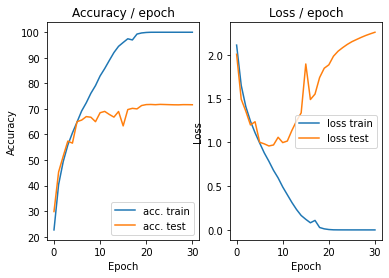

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 4.133s (4.133s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


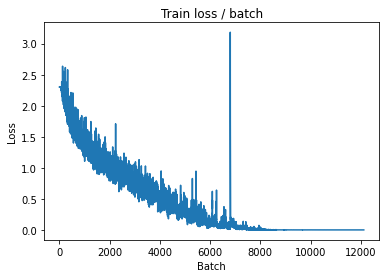

[TRAIN Batch 200/391]	Time 0.020s (0.041s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


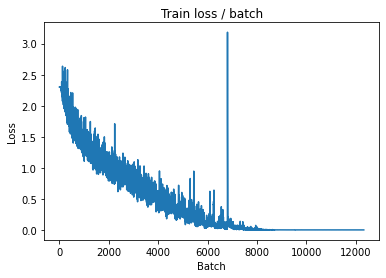


===============> Total time 12s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.124s (2.124s)	Loss 2.7046 (2.7046)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2742	Avg Prec@1 71.65 %	Avg Prec@5 97.34 %



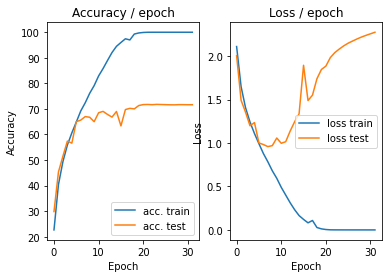

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 4.548s (4.548s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


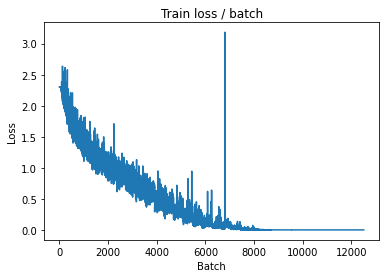

[TRAIN Batch 200/391]	Time 0.017s (0.040s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


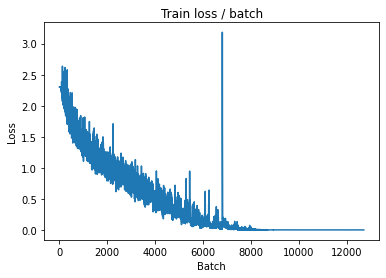


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.174s (2.174s)	Loss 2.7258 (2.7258)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2881	Avg Prec@1 71.61 %	Avg Prec@5 97.37 %



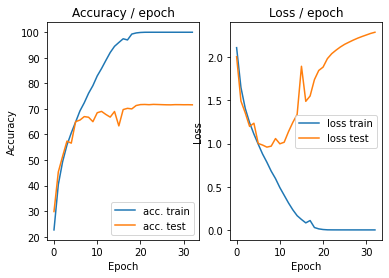

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 3.695s (3.695s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


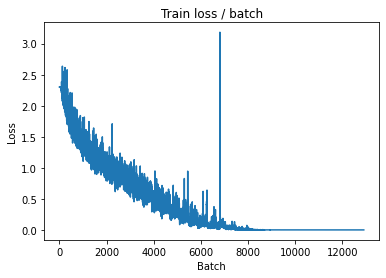

[TRAIN Batch 200/391]	Time 0.016s (0.035s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


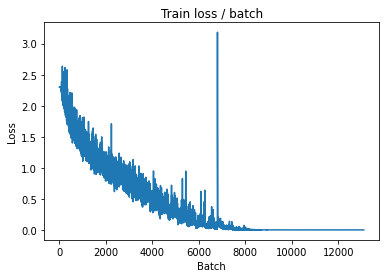


===============> Total time 10s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.067s (2.067s)	Loss 2.7393 (2.7393)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3036	Avg Prec@1 71.63 %	Avg Prec@5 97.33 %



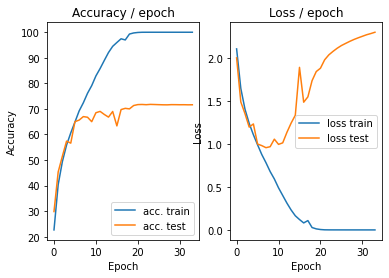

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 3.695s (3.695s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


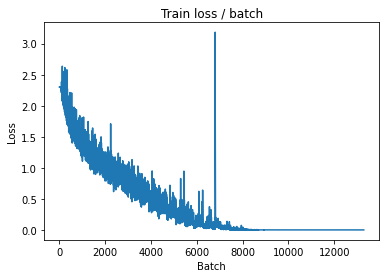

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


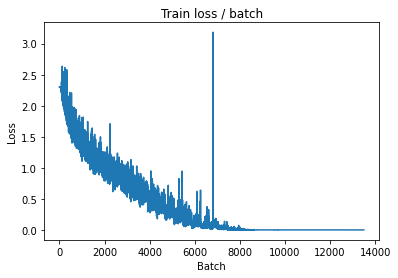


===============> Total time 10s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.053s (2.053s)	Loss 2.7508 (2.7508)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3161	Avg Prec@1 71.74 %	Avg Prec@5 97.34 %



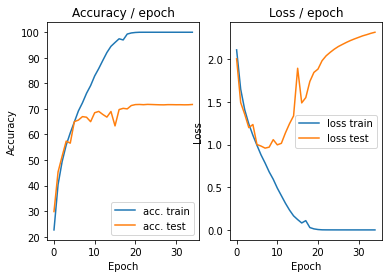

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 3.772s (3.772s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


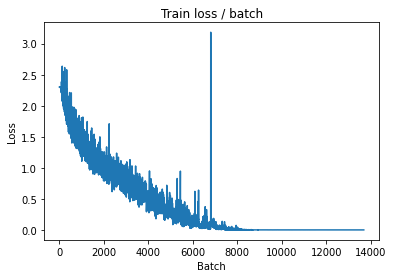

[TRAIN Batch 200/391]	Time 0.018s (0.035s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


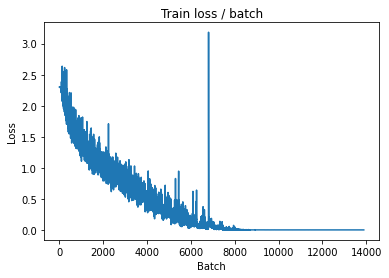


===============> Total time 10s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.166s (2.166s)	Loss 2.7707 (2.7707)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3298	Avg Prec@1 71.67 %	Avg Prec@5 97.33 %



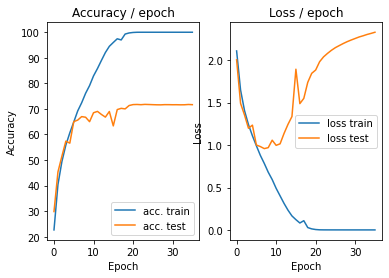

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 3.709s (3.709s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


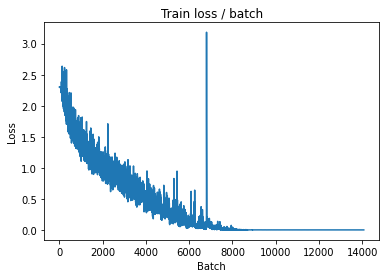

[TRAIN Batch 200/391]	Time 0.016s (0.035s)	Loss 0.0003 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


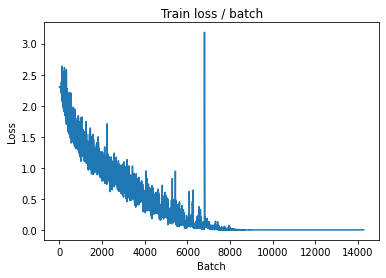


===============> Total time 10s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.380s (2.380s)	Loss 2.7818 (2.7818)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.3392	Avg Prec@1 71.73 %	Avg Prec@5 97.32 %



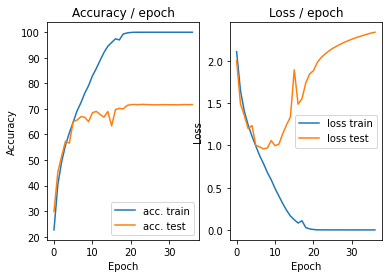

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 4.596s (4.596s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


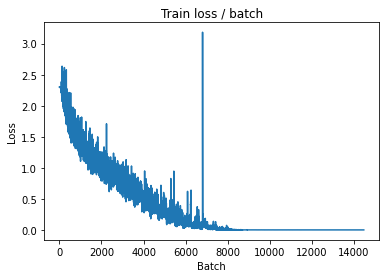

[TRAIN Batch 200/391]	Time 0.016s (0.039s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


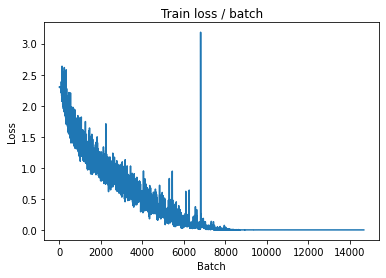


===============> Total time 10s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.188s (2.188s)	Loss 2.7994 (2.7994)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.3533	Avg Prec@1 71.68 %	Avg Prec@5 97.32 %



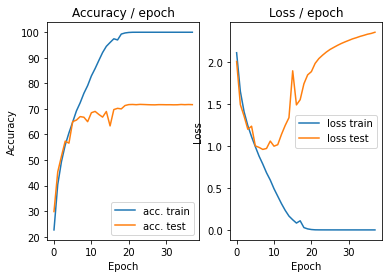

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 4.538s (4.538s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


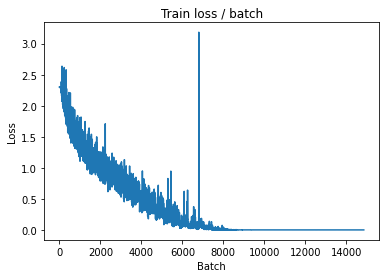

[TRAIN Batch 200/391]	Time 0.029s (0.041s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


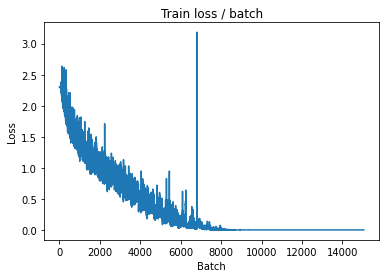


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.430s (2.430s)	Loss 2.8047 (2.8047)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.3638	Avg Prec@1 71.73 %	Avg Prec@5 97.33 %



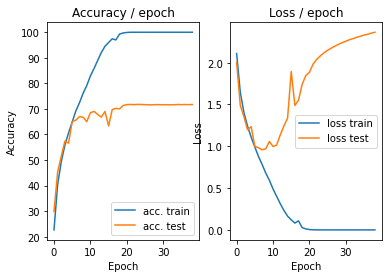

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 4.023s (4.023s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


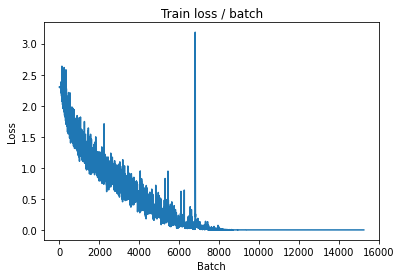

[TRAIN Batch 200/391]	Time 0.025s (0.045s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


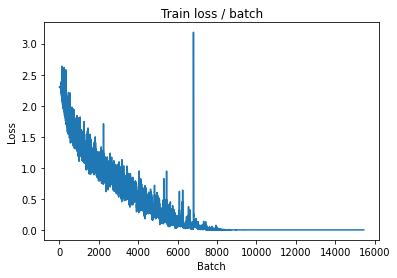


===============> Total time 12s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 2.184s (2.184s)	Loss 2.8171 (2.8171)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 2.3746	Avg Prec@1 71.69 %	Avg Prec@5 97.35 %



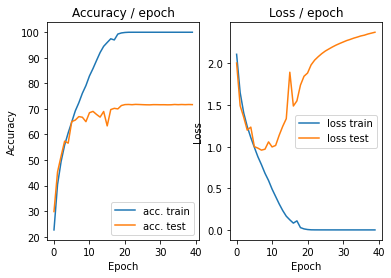

In [ ]:
main(128, 0.1, 40, cuda=True)

Partie 3.1 Normalisation des exemples

In [ ]:
class ConvNetNormal(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetNormal, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    normalize = transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetNormal()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.444s (0.444s)	Loss 2.3034 (2.3034)	Prec@1   4.7 (  4.7)	Prec@5  50.8 ( 50.8)


<Figure size 432x288 with 0 Axes>

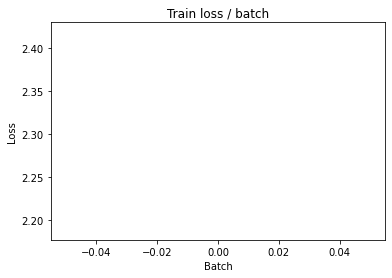

[TRAIN Batch 200/391]	Time 0.056s (0.040s)	Loss 1.5760 (1.9101)	Prec@1  46.1 ( 29.8)	Prec@5  93.0 ( 80.5)


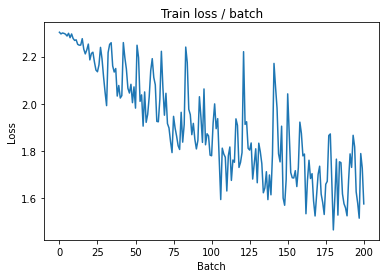


===============> Total time 15s	Avg loss 1.7098	Avg Prec@1 37.65 %	Avg Prec@5 86.00 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.4672 (1.4672)	Prec@1  46.9 ( 46.9)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.5707	Avg Prec@1 44.75 %	Avg Prec@5 89.52 %



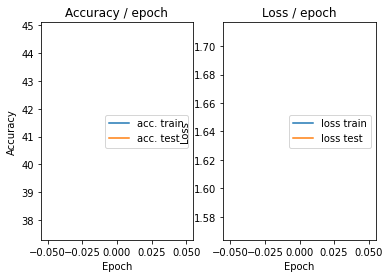

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 1.5831 (1.5831)	Prec@1  46.9 ( 46.9)	Prec@5  89.8 ( 89.8)


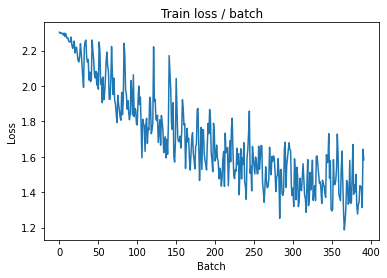

[TRAIN Batch 200/391]	Time 0.021s (0.037s)	Loss 1.3353 (1.3247)	Prec@1  49.2 ( 52.9)	Prec@5  94.5 ( 94.1)


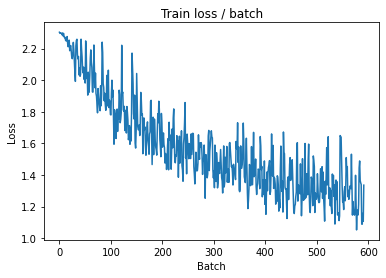


===============> Total time 14s	Avg loss 1.2621	Avg Prec@1 55.06 %	Avg Prec@5 94.69 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.1827 (1.1827)	Prec@1  58.6 ( 58.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1959	Avg Prec@1 56.84 %	Avg Prec@5 95.59 %



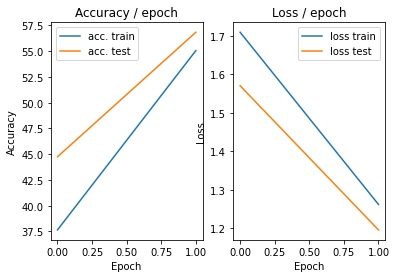

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 1.2616 (1.2616)	Prec@1  59.4 ( 59.4)	Prec@5  92.2 ( 92.2)


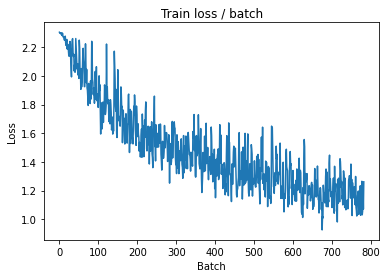

[TRAIN Batch 200/391]	Time 0.022s (0.038s)	Loss 1.0191 (1.0651)	Prec@1  66.4 ( 62.6)	Prec@5  96.9 ( 96.3)


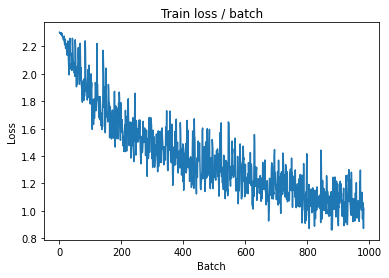


===============> Total time 14s	Avg loss 1.0334	Avg Prec@1 63.75 %	Avg Prec@5 96.59 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9150 (0.9150)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0169	Avg Prec@1 63.98 %	Avg Prec@5 96.63 %



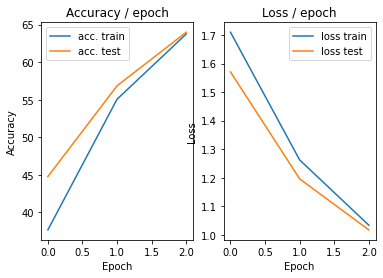

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.9763 (0.9763)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


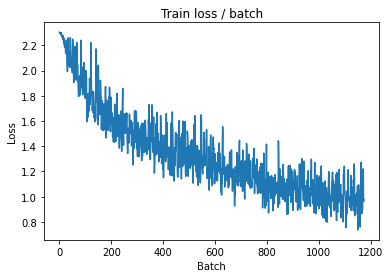

[TRAIN Batch 200/391]	Time 0.047s (0.039s)	Loss 0.9592 (0.8682)	Prec@1  66.4 ( 69.7)	Prec@5  95.3 ( 97.7)


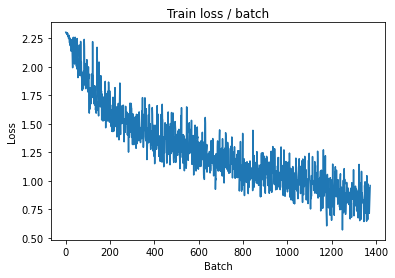


===============> Total time 15s	Avg loss 0.8576	Avg Prec@1 70.06 %	Avg Prec@5 97.83 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.8488 (0.8488)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9490	Avg Prec@1 67.45 %	Avg Prec@5 96.64 %



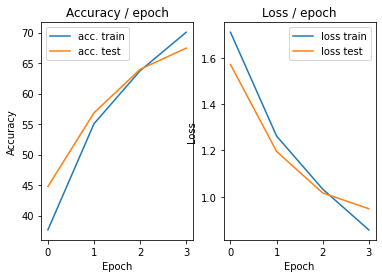

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.8385 (0.8385)	Prec@1  68.8 ( 68.8)	Prec@5  99.2 ( 99.2)


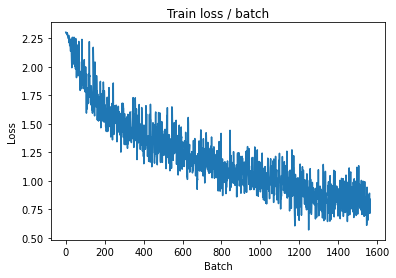

[TRAIN Batch 200/391]	Time 0.044s (0.038s)	Loss 0.6964 (0.7305)	Prec@1  75.0 ( 74.3)	Prec@5  98.4 ( 98.5)


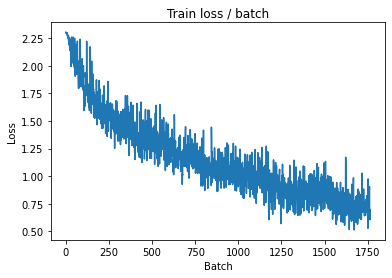


===============> Total time 14s	Avg loss 0.7221	Avg Prec@1 74.70 %	Avg Prec@5 98.52 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.9971 (0.9971)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9142	Avg Prec@1 68.95 %	Avg Prec@5 97.22 %



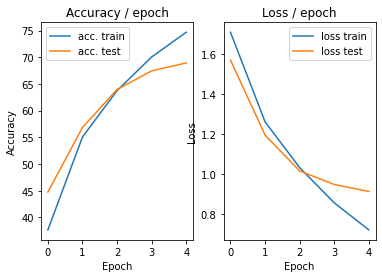

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.7269 (0.7269)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


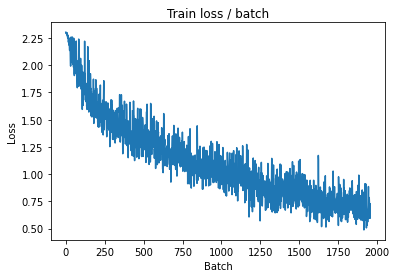

[TRAIN Batch 200/391]	Time 0.016s (0.038s)	Loss 0.6194 (0.5992)	Prec@1  78.1 ( 79.1)	Prec@5  98.4 ( 99.0)


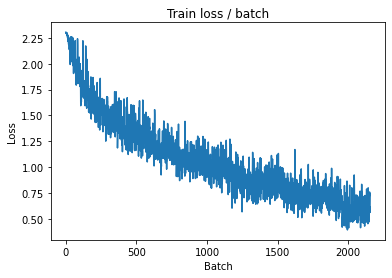


===============> Total time 14s	Avg loss 0.5975	Avg Prec@1 79.17 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.7861 (0.7861)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9163	Avg Prec@1 69.68 %	Avg Prec@5 97.31 %



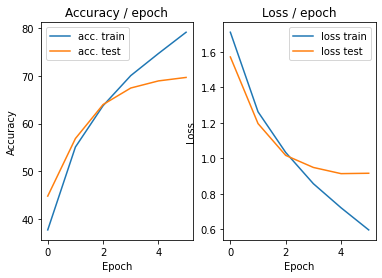

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.4146 (0.4146)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


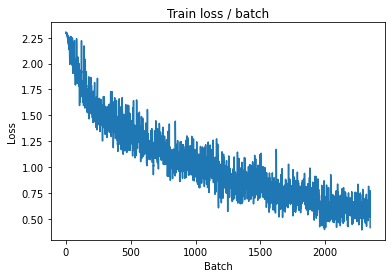

[TRAIN Batch 200/391]	Time 0.021s (0.037s)	Loss 0.5265 (0.4791)	Prec@1  81.2 ( 83.4)	Prec@5  99.2 ( 99.5)


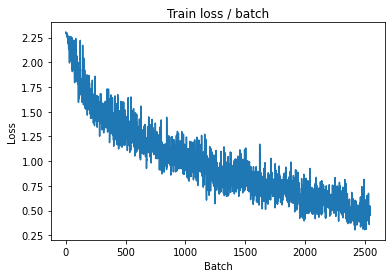


===============> Total time 14s	Avg loss 0.4903	Avg Prec@1 82.77 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.8862 (0.8862)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0381	Avg Prec@1 67.56 %	Avg Prec@5 97.39 %



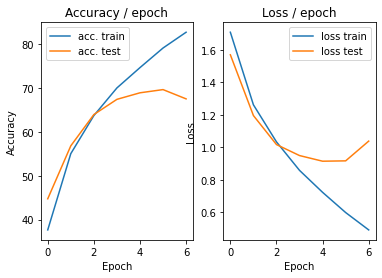

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.5024 (0.5024)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


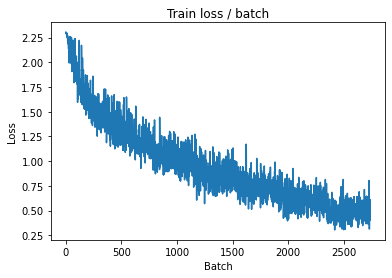

[TRAIN Batch 200/391]	Time 0.018s (0.037s)	Loss 0.3720 (0.3643)	Prec@1  87.5 ( 87.1)	Prec@5 100.0 ( 99.8)


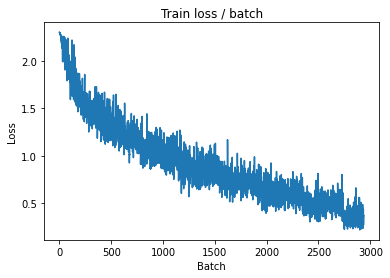


===============> Total time 14s	Avg loss 0.3831	Avg Prec@1 86.53 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.8645 (0.8645)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9209	Avg Prec@1 71.91 %	Avg Prec@5 97.62 %



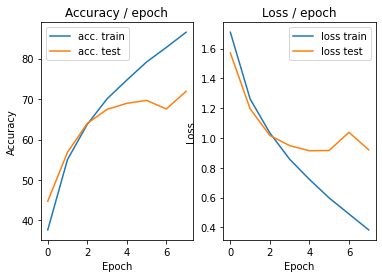

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.2991 (0.2991)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


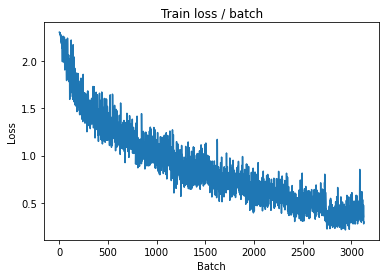

[TRAIN Batch 200/391]	Time 0.061s (0.038s)	Loss 0.2071 (0.2645)	Prec@1  92.2 ( 91.0)	Prec@5 100.0 ( 99.8)


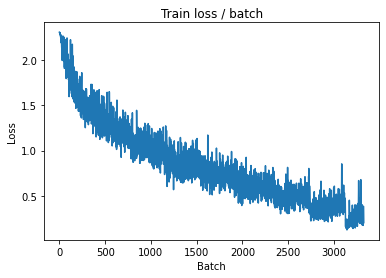


===============> Total time 14s	Avg loss 0.2880	Avg Prec@1 89.96 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.9381 (0.9381)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9860	Avg Prec@1 72.20 %	Avg Prec@5 97.65 %



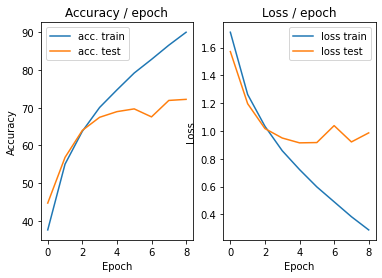

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.2048 (0.2048)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


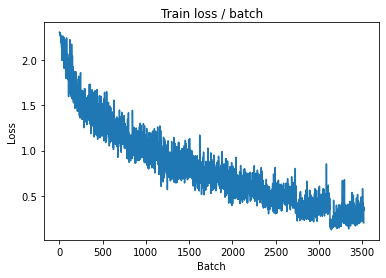

[TRAIN Batch 200/391]	Time 0.025s (0.039s)	Loss 0.1686 (0.1722)	Prec@1  92.2 ( 94.1)	Prec@5 100.0 (100.0)


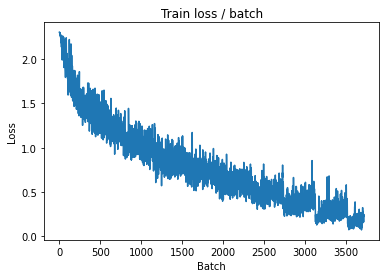


===============> Total time 14s	Avg loss 0.1949	Avg Prec@1 93.25 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.6522 (1.6522)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.3703	Avg Prec@1 68.23 %	Avg Prec@5 96.87 %



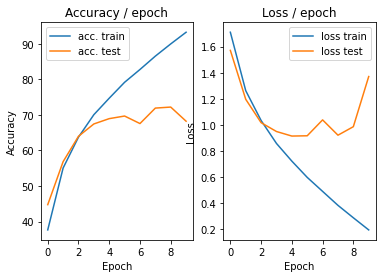

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.3019 (0.3019)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


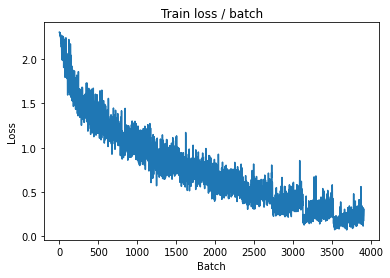

[TRAIN Batch 200/391]	Time 0.024s (0.037s)	Loss 0.1910 (0.1328)	Prec@1  93.8 ( 95.7)	Prec@5 100.0 (100.0)


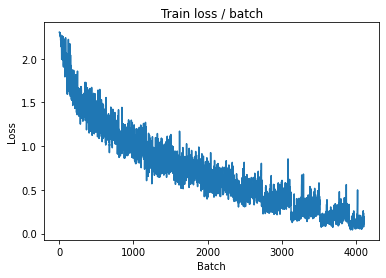


===============> Total time 14s	Avg loss 0.1494	Avg Prec@1 94.91 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.2002 (1.2002)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1972	Avg Prec@1 72.58 %	Avg Prec@5 97.33 %



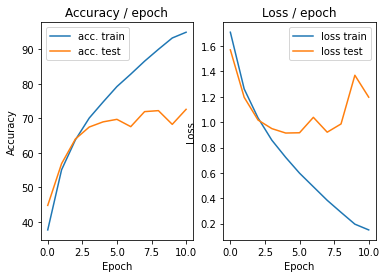

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.1063 (0.1063)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


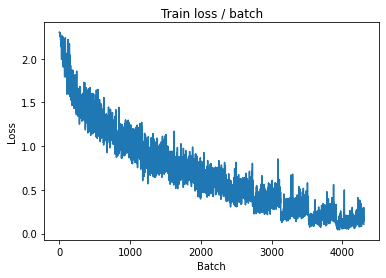

[TRAIN Batch 200/391]	Time 0.049s (0.038s)	Loss 0.0351 (0.0739)	Prec@1 100.0 ( 97.7)	Prec@5 100.0 (100.0)


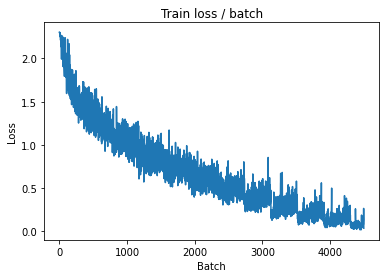


===============> Total time 14s	Avg loss 0.1009	Avg Prec@1 96.76 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.1353 (1.1353)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.3094	Avg Prec@1 72.54 %	Avg Prec@5 97.39 %



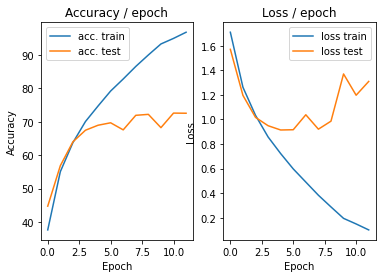

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.0784 (0.0784)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


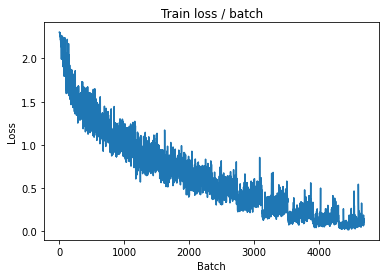

[TRAIN Batch 200/391]	Time 0.046s (0.039s)	Loss 0.1475 (0.0595)	Prec@1  93.0 ( 98.2)	Prec@5 100.0 (100.0)


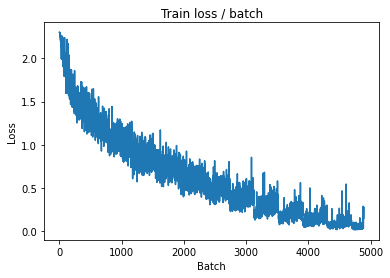


===============> Total time 14s	Avg loss 0.0912	Avg Prec@1 97.20 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 1.2982 (1.2982)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2949	Avg Prec@1 73.89 %	Avg Prec@5 97.76 %



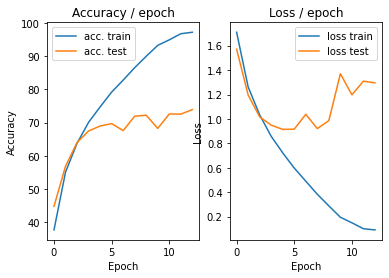

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.0414 (0.0414)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


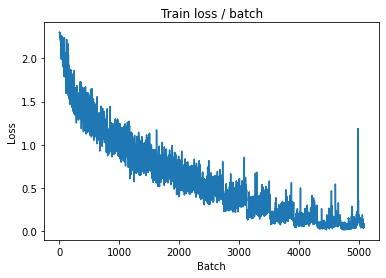

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0279 (0.0466)	Prec@1  98.4 ( 98.6)	Prec@5 100.0 (100.0)


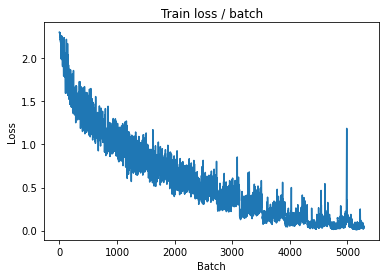


===============> Total time 14s	Avg loss 0.0719	Avg Prec@1 97.67 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.4173 (1.4173)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.2751	Avg Prec@1 72.87 %	Avg Prec@5 97.48 %



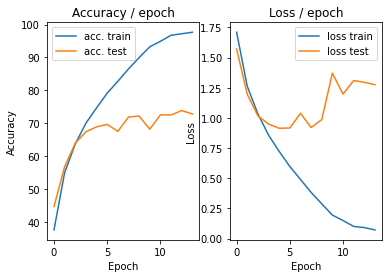

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.0683 (0.0683)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


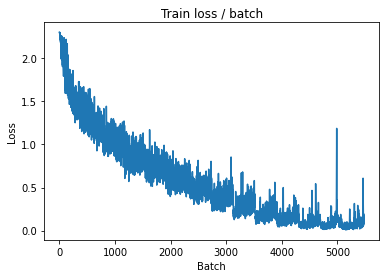

[TRAIN Batch 200/391]	Time 0.048s (0.038s)	Loss 0.0210 (0.0486)	Prec@1 100.0 ( 98.5)	Prec@5 100.0 (100.0)


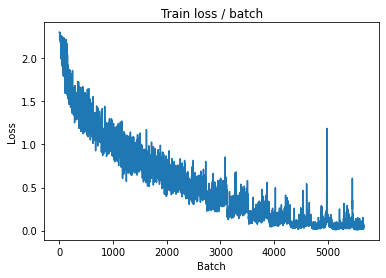


===============> Total time 14s	Avg loss 0.0511	Avg Prec@1 98.38 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 1.5782 (1.5782)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.4827	Avg Prec@1 74.12 %	Avg Prec@5 97.42 %



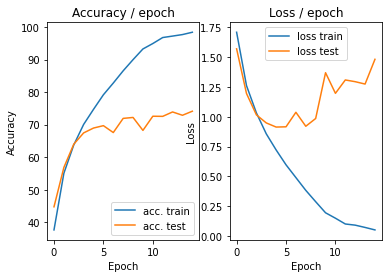

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.0509 (0.0509)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


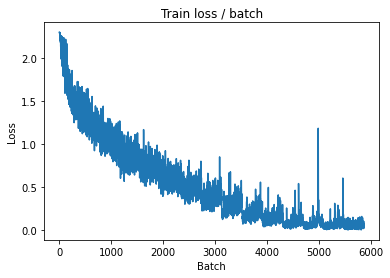

[TRAIN Batch 200/391]	Time 0.071s (0.038s)	Loss 0.0533 (0.0459)	Prec@1  98.4 ( 98.6)	Prec@5 100.0 (100.0)


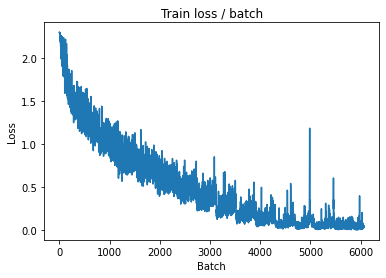


===============> Total time 14s	Avg loss 0.0622	Avg Prec@1 98.02 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.4125 (1.4125)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.5639	Avg Prec@1 72.64 %	Avg Prec@5 97.54 %



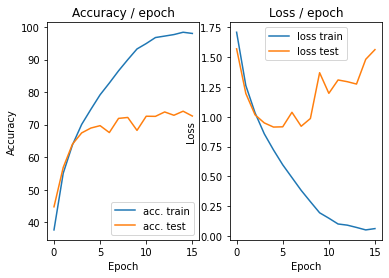

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0269 (0.0269)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


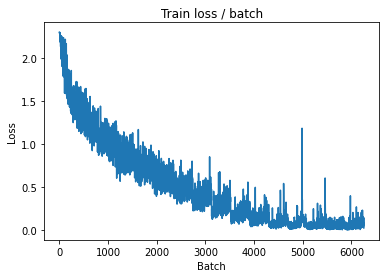

[TRAIN Batch 200/391]	Time 0.055s (0.038s)	Loss 0.0605 (0.0426)	Prec@1  98.4 ( 98.6)	Prec@5 100.0 (100.0)


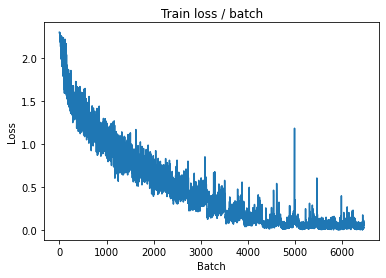


===============> Total time 14s	Avg loss 0.0546	Avg Prec@1 98.23 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 1.7251 (1.7251)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.6357	Avg Prec@1 71.63 %	Avg Prec@5 97.51 %



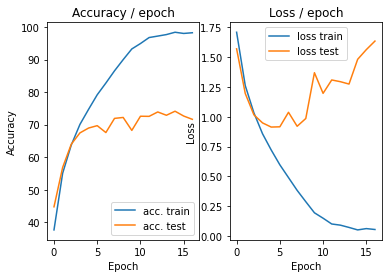

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.0855 (0.0855)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


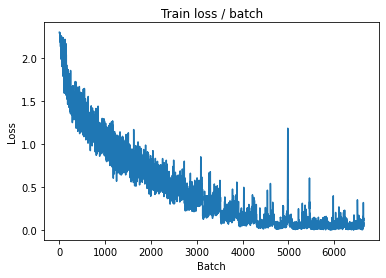

[TRAIN Batch 200/391]	Time 0.024s (0.039s)	Loss 0.1081 (0.0248)	Prec@1  95.3 ( 99.3)	Prec@5 100.0 (100.0)


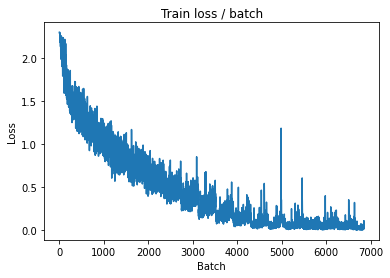


===============> Total time 14s	Avg loss 0.0397	Avg Prec@1 98.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 1.9058 (1.9058)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.6214	Avg Prec@1 74.05 %	Avg Prec@5 97.40 %



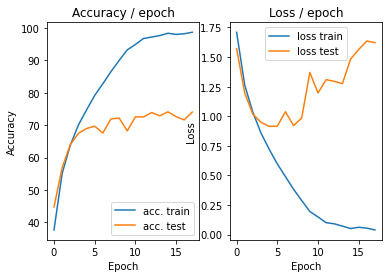

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0724 (0.0724)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


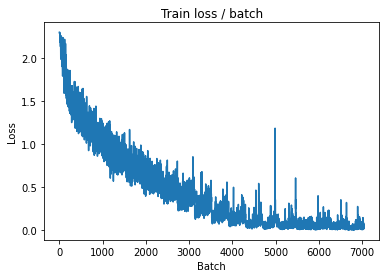

[TRAIN Batch 200/391]	Time 0.025s (0.039s)	Loss 0.0106 (0.0174)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


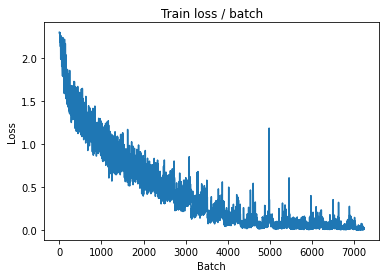


===============> Total time 14s	Avg loss 0.0230	Avg Prec@1 99.27 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 2.3862 (2.3862)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.9237	Avg Prec@1 72.16 %	Avg Prec@5 97.60 %



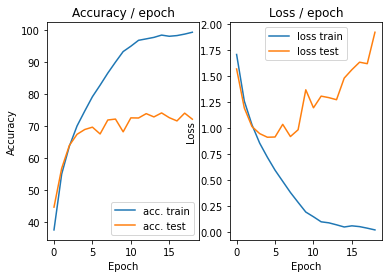

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.1023 (0.1023)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


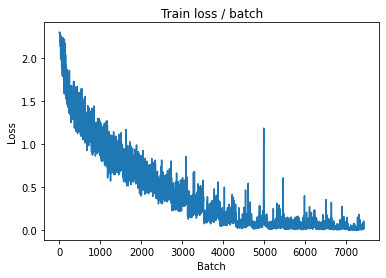

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0071 (0.0212)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


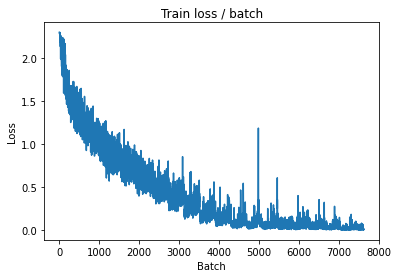


===============> Total time 14s	Avg loss 0.0350	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.8612 (1.8612)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.6631	Avg Prec@1 73.96 %	Avg Prec@5 97.37 %



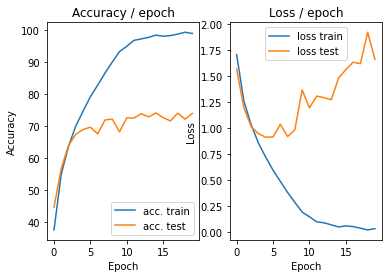

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.0086 (0.0086)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


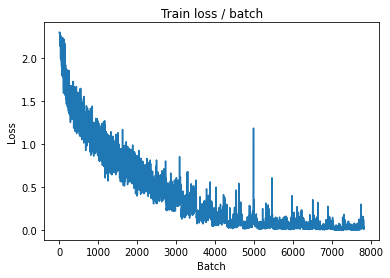

[TRAIN Batch 200/391]	Time 0.026s (0.038s)	Loss 0.0159 (0.0338)	Prec@1 100.0 ( 98.8)	Prec@5 100.0 (100.0)


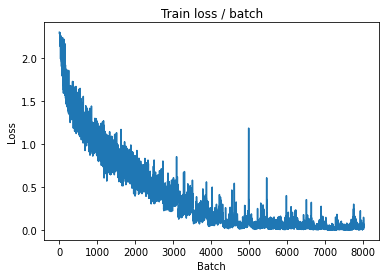


===============> Total time 14s	Avg loss 0.0350	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 1.8915 (1.8915)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.7844	Avg Prec@1 73.52 %	Avg Prec@5 97.59 %



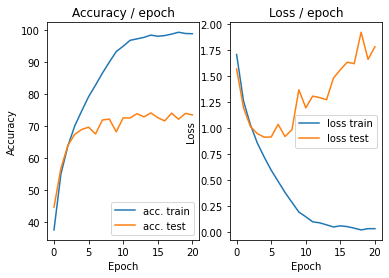

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0387 (0.0387)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


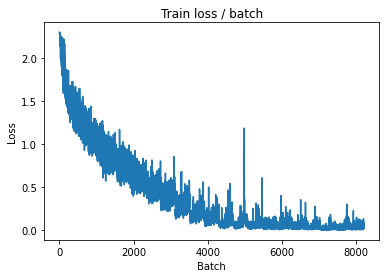

[TRAIN Batch 200/391]	Time 0.043s (0.038s)	Loss 0.0496 (0.0461)	Prec@1  96.9 ( 98.5)	Prec@5 100.0 (100.0)


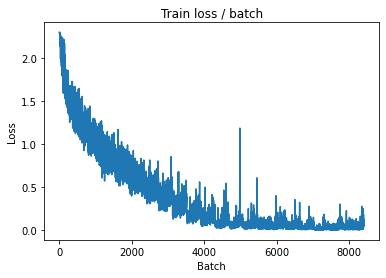


===============> Total time 14s	Avg loss 0.0473	Avg Prec@1 98.50 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.6963 (1.6963)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.7409	Avg Prec@1 73.42 %	Avg Prec@5 97.65 %



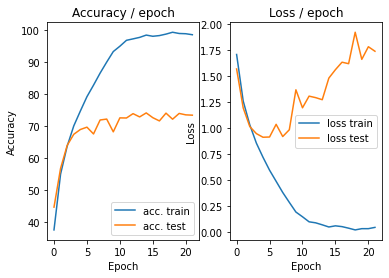

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.0054 (0.0054)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


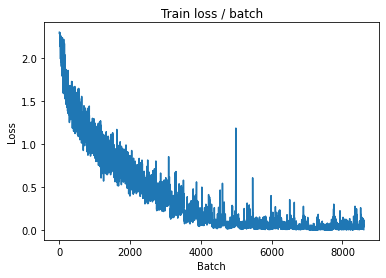

[TRAIN Batch 200/391]	Time 0.023s (0.037s)	Loss 0.0346 (0.0251)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


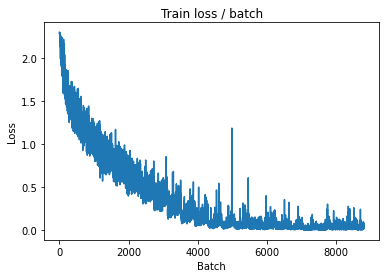


===============> Total time 14s	Avg loss 0.0453	Avg Prec@1 98.58 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.8152 (1.8152)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9523	Avg Prec@1 71.49 %	Avg Prec@5 97.39 %



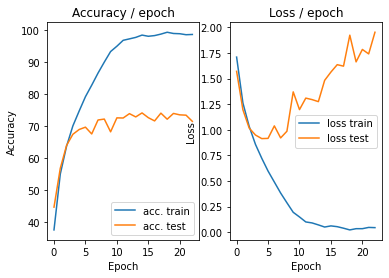

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0789 (0.0789)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


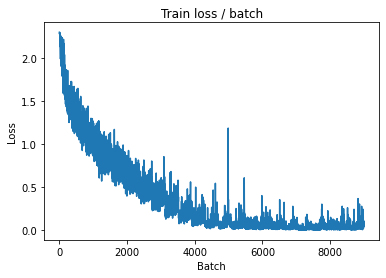

[TRAIN Batch 200/391]	Time 0.028s (0.037s)	Loss 0.0508 (0.0558)	Prec@1  96.9 ( 98.3)	Prec@5 100.0 (100.0)


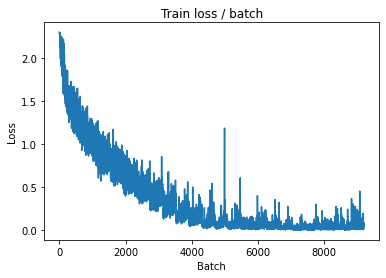


===============> Total time 14s	Avg loss 0.0498	Avg Prec@1 98.42 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 1.5446 (1.5446)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9831	Avg Prec@1 72.16 %	Avg Prec@5 97.02 %



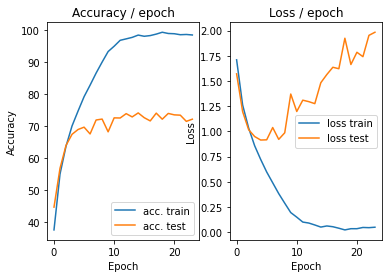

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.1591 (0.1591)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


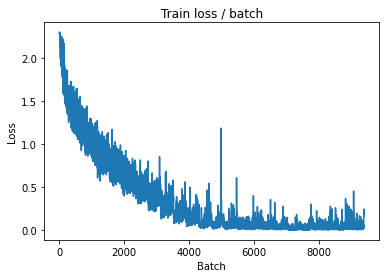

[TRAIN Batch 200/391]	Time 0.014s (0.038s)	Loss 0.0384 (0.0336)	Prec@1  98.4 ( 98.9)	Prec@5 100.0 (100.0)


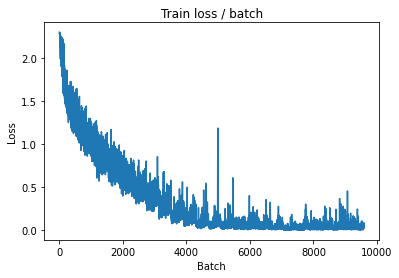


===============> Total time 14s	Avg loss 0.0374	Avg Prec@1 98.78 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.7916 (1.7916)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7719	Avg Prec@1 74.53 %	Avg Prec@5 97.65 %



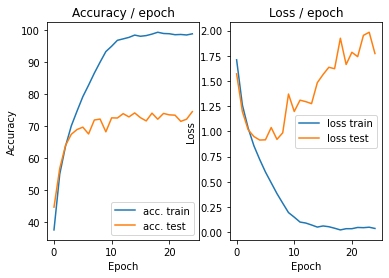

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.0065 (0.0065)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


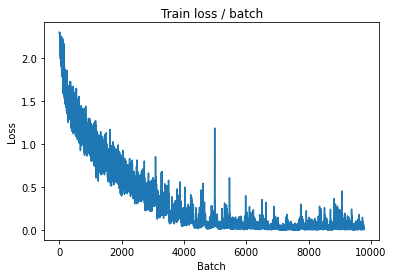

[TRAIN Batch 200/391]	Time 0.016s (0.038s)	Loss 0.0119 (0.0128)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


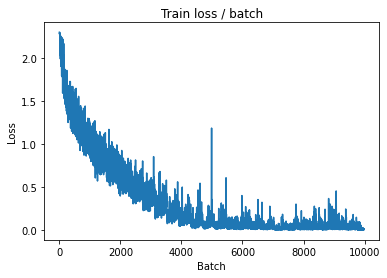


===============> Total time 14s	Avg loss 0.0125	Avg Prec@1 99.61 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 2.2381 (2.2381)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.0054	Avg Prec@1 74.05 %	Avg Prec@5 97.77 %



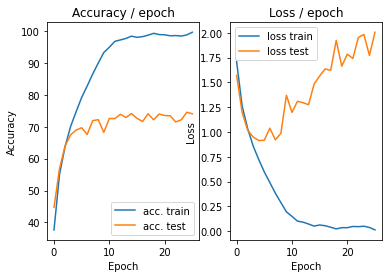

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


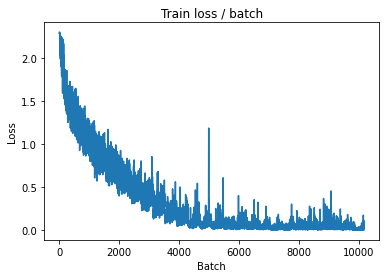

[TRAIN Batch 200/391]	Time 0.020s (0.040s)	Loss 0.0028 (0.0101)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


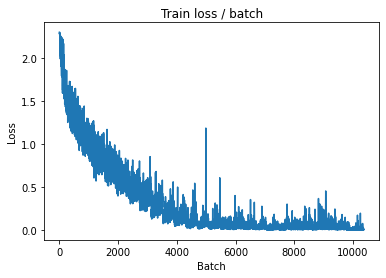


===============> Total time 15s	Avg loss 0.0146	Avg Prec@1 99.58 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.2096 (2.2096)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0024	Avg Prec@1 74.37 %	Avg Prec@5 97.69 %



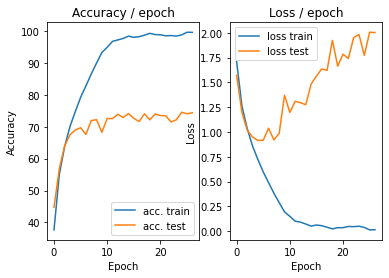

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


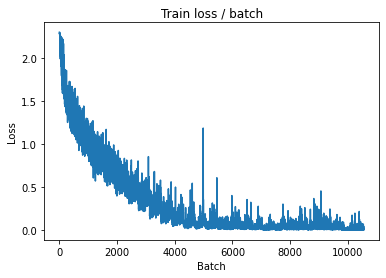

[TRAIN Batch 200/391]	Time 0.045s (0.038s)	Loss 0.0018 (0.0107)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


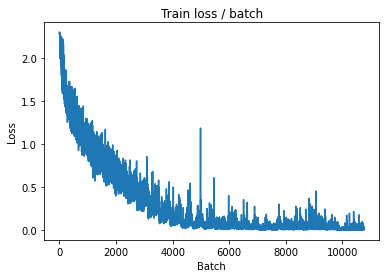


===============> Total time 14s	Avg loss 0.0106	Avg Prec@1 99.71 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 1.8482 (1.8482)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9594	Avg Prec@1 74.97 %	Avg Prec@5 97.83 %



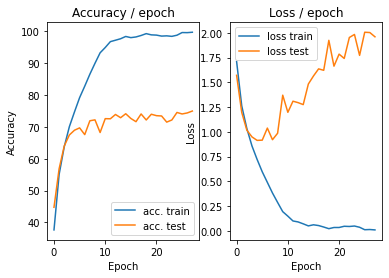

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.0040 (0.0040)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


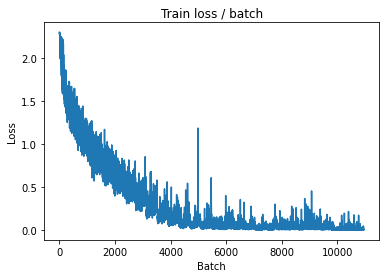

[TRAIN Batch 200/391]	Time 0.023s (0.037s)	Loss 0.0015 (0.0042)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


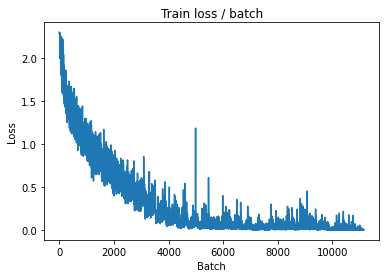


===============> Total time 14s	Avg loss 0.0036	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 2.0092 (2.0092)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0044	Avg Prec@1 75.09 %	Avg Prec@5 97.82 %



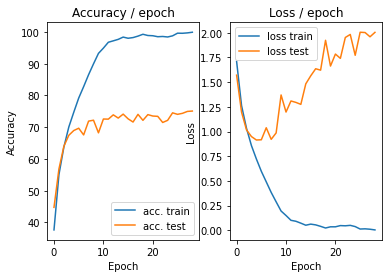

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


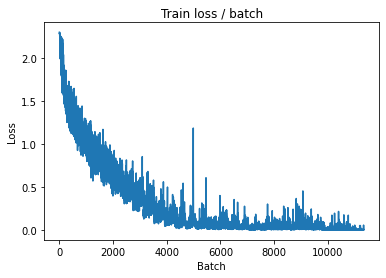

[TRAIN Batch 200/391]	Time 0.017s (0.037s)	Loss 0.0003 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


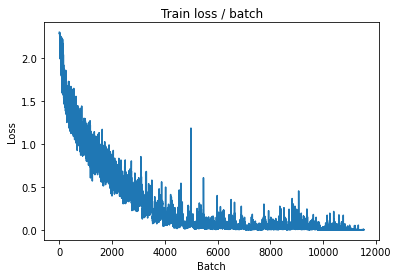


===============> Total time 14s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 2.0036 (2.0036)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0543	Avg Prec@1 75.86 %	Avg Prec@5 97.93 %



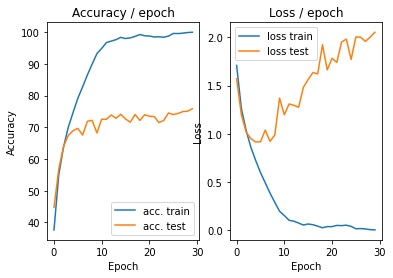

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


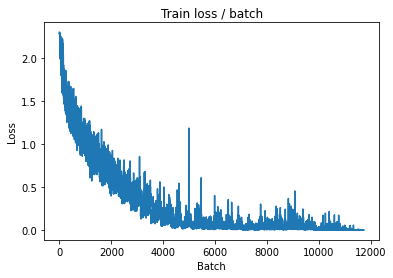

[TRAIN Batch 200/391]	Time 0.019s (0.037s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


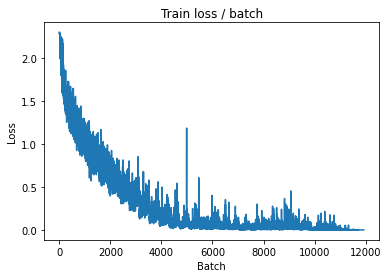


===============> Total time 14s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.0239 (2.0239)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0779	Avg Prec@1 75.95 %	Avg Prec@5 97.87 %



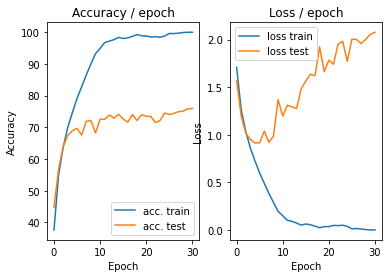

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


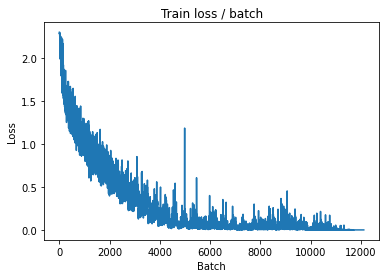

[TRAIN Batch 200/391]	Time 0.035s (0.038s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


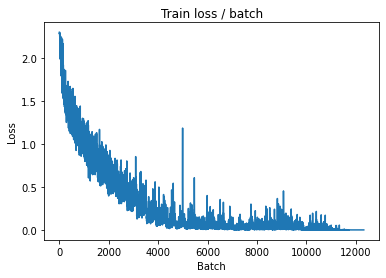


===============> Total time 14s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.0505 (2.0505)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1020	Avg Prec@1 75.93 %	Avg Prec@5 97.89 %



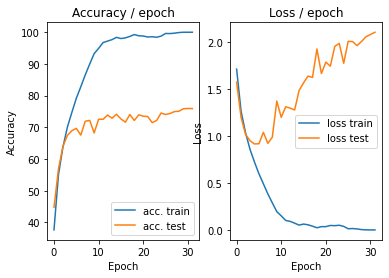

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


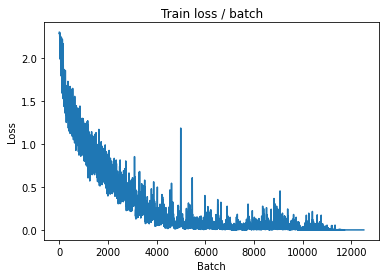

[TRAIN Batch 200/391]	Time 0.058s (0.039s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


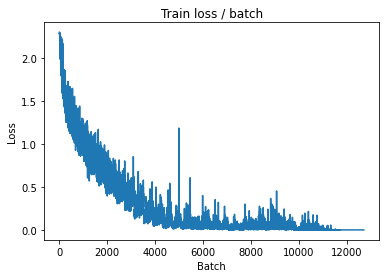


===============> Total time 14s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 2.0696 (2.0696)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1201	Avg Prec@1 75.97 %	Avg Prec@5 97.88 %



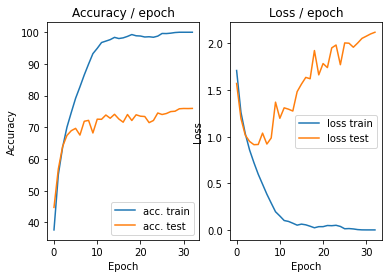

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


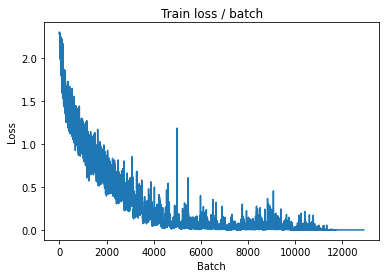

[TRAIN Batch 200/391]	Time 0.035s (0.039s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


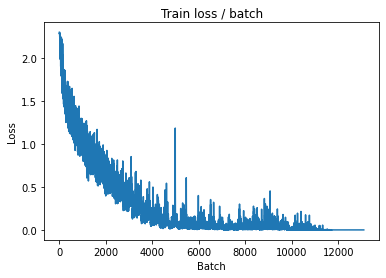


===============> Total time 15s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 2.0885 (2.0885)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1370	Avg Prec@1 75.97 %	Avg Prec@5 97.87 %



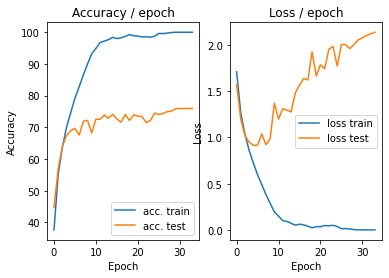

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


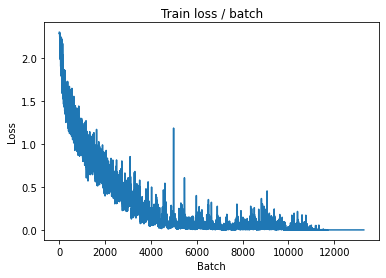

[TRAIN Batch 200/391]	Time 0.020s (0.041s)	Loss 0.0000 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


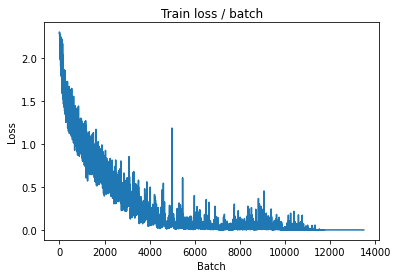


===============> Total time 15s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 2.1011 (2.1011)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1517	Avg Prec@1 75.92 %	Avg Prec@5 97.86 %



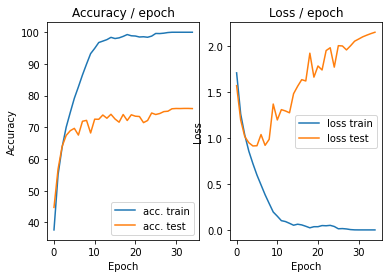

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


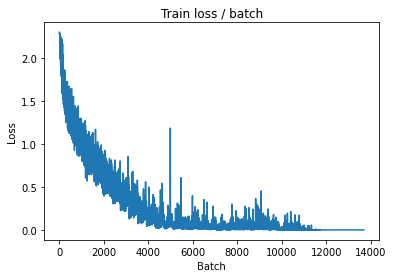

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


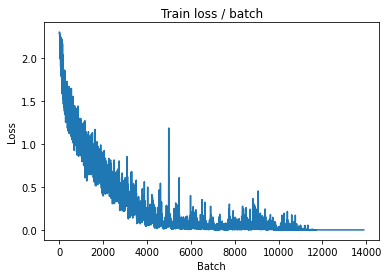


===============> Total time 14s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 2.1167 (2.1167)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1649	Avg Prec@1 75.93 %	Avg Prec@5 97.88 %



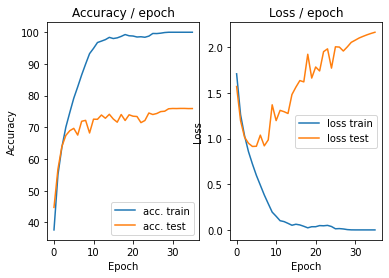

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


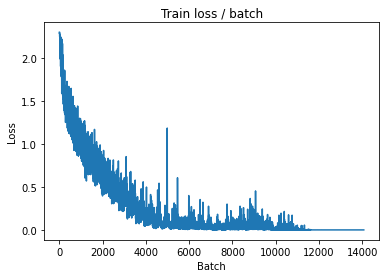

[TRAIN Batch 200/391]	Time 0.030s (0.039s)	Loss 0.0000 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


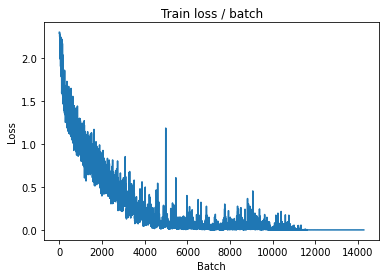


===============> Total time 15s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 2.1284 (2.1284)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1767	Avg Prec@1 75.97 %	Avg Prec@5 97.89 %



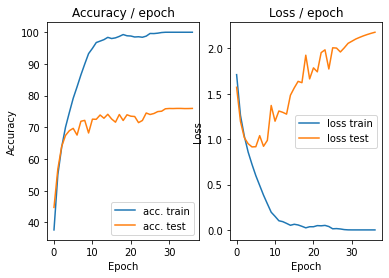

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


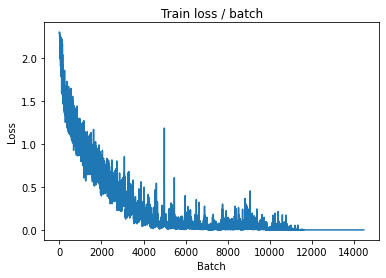

[TRAIN Batch 200/391]	Time 0.058s (0.038s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


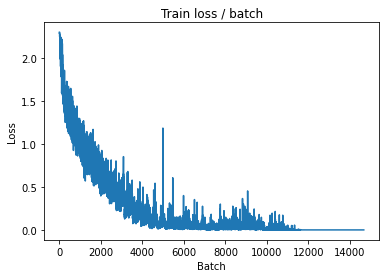


===============> Total time 14s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.1404 (2.1404)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1872	Avg Prec@1 75.98 %	Avg Prec@5 97.89 %



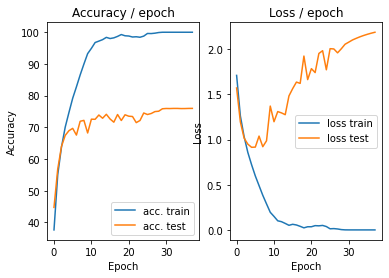

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


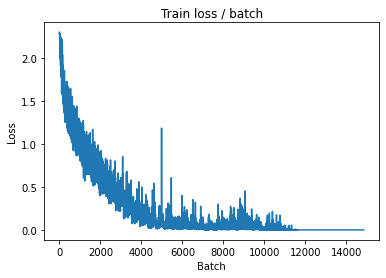

[TRAIN Batch 200/391]	Time 0.042s (0.039s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


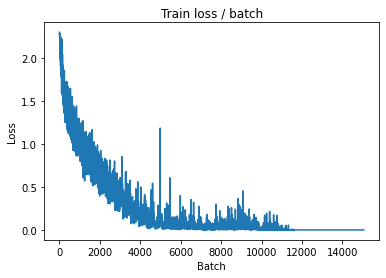


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 2.1510 (2.1510)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1976	Avg Prec@1 75.97 %	Avg Prec@5 97.88 %



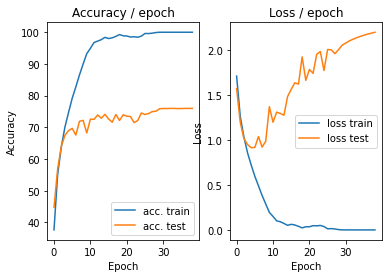

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


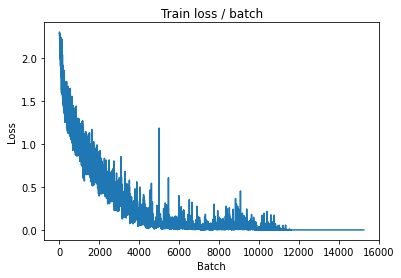

[TRAIN Batch 200/391]	Time 0.036s (0.036s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


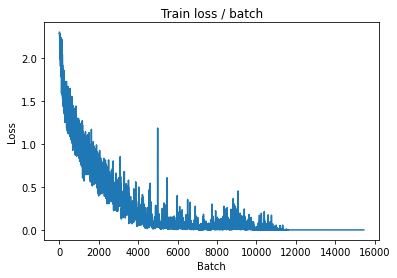


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 2.1606 (2.1606)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2073	Avg Prec@1 76.02 %	Avg Prec@5 97.87 %



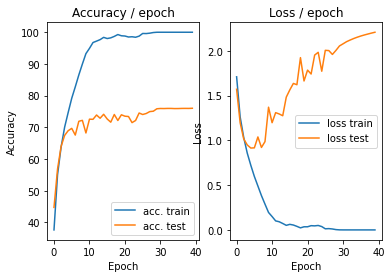

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


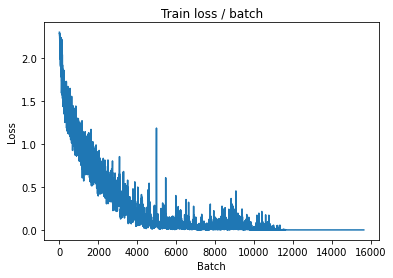

[TRAIN Batch 200/391]	Time 0.038s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


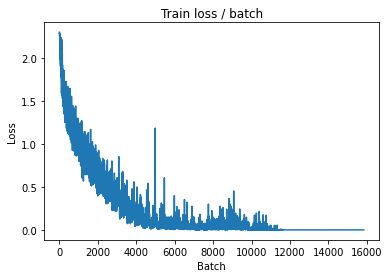


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 2.1705 (2.1705)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2160	Avg Prec@1 76.07 %	Avg Prec@5 97.87 %



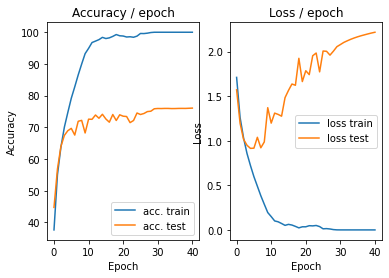

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


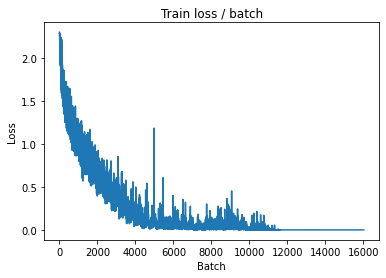

[TRAIN Batch 200/391]	Time 0.018s (0.039s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


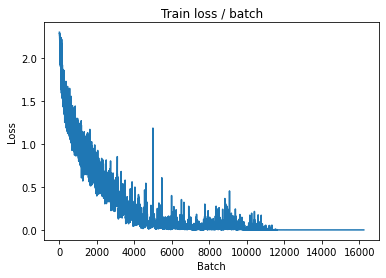


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 2.1790 (2.1790)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2244	Avg Prec@1 76.09 %	Avg Prec@5 97.87 %



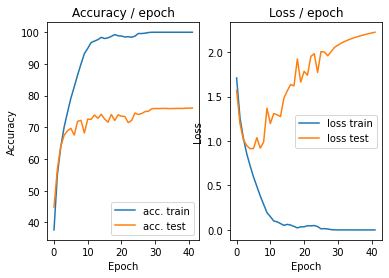

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


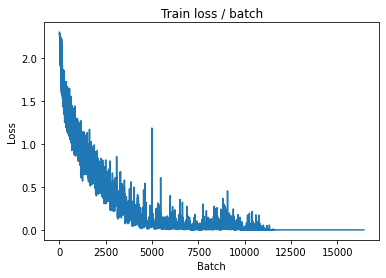

[TRAIN Batch 200/391]	Time 0.023s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


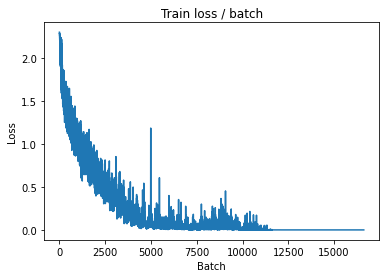


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 2.1871 (2.1871)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2321	Avg Prec@1 76.10 %	Avg Prec@5 97.87 %



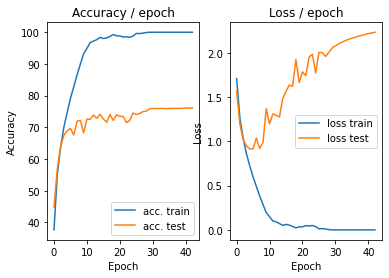

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


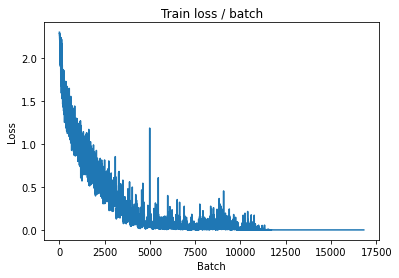

[TRAIN Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


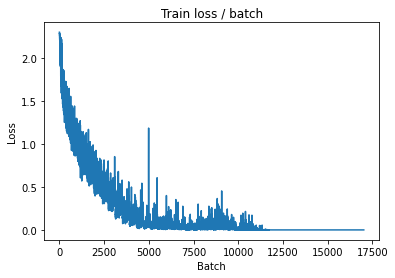


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 2.1957 (2.1957)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2397	Avg Prec@1 76.07 %	Avg Prec@5 97.87 %



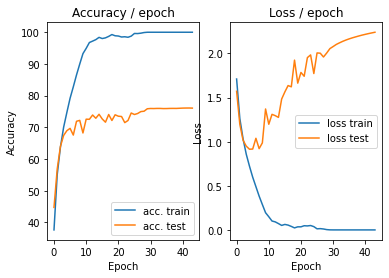

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


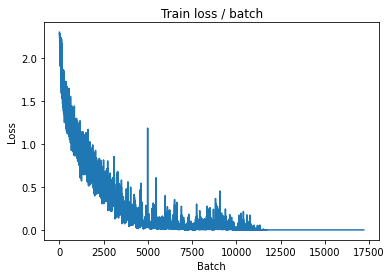

[TRAIN Batch 200/391]	Time 0.058s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


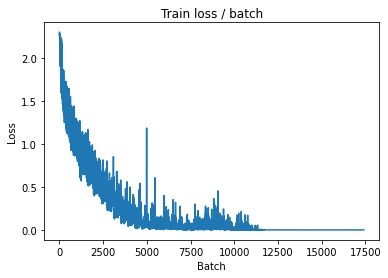


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.2036 (2.2036)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2469	Avg Prec@1 76.07 %	Avg Prec@5 97.88 %



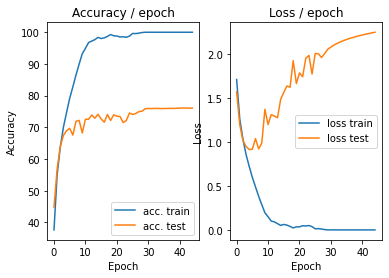

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


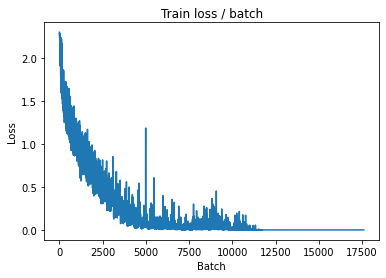

[TRAIN Batch 200/391]	Time 0.044s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


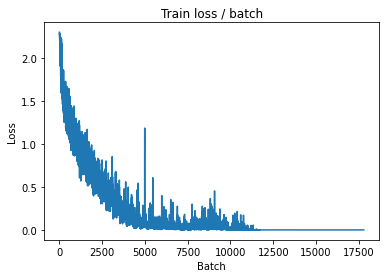


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 2.2109 (2.2109)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2537	Avg Prec@1 76.07 %	Avg Prec@5 97.88 %



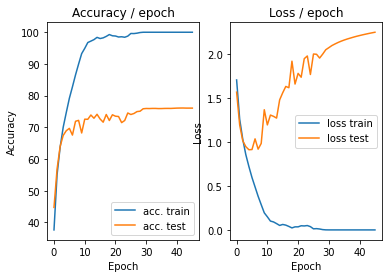

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


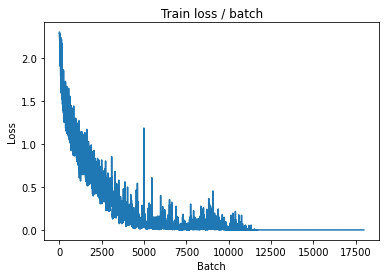

[TRAIN Batch 200/391]	Time 0.036s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


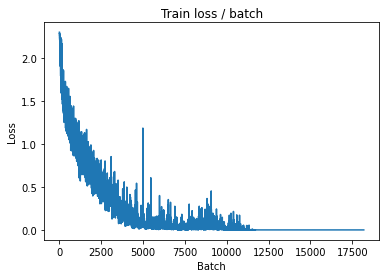


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 2.2174 (2.2174)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2602	Avg Prec@1 76.07 %	Avg Prec@5 97.89 %



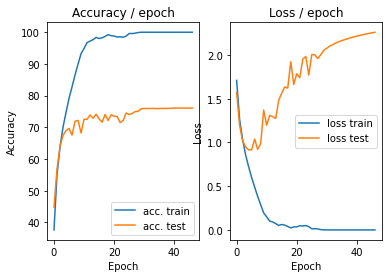

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


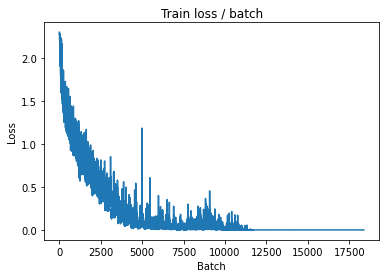

[TRAIN Batch 200/391]	Time 0.019s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


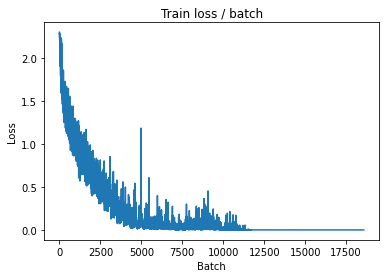


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 2.2242 (2.2242)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2666	Avg Prec@1 76.07 %	Avg Prec@5 97.90 %



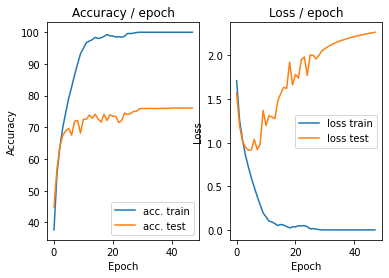

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


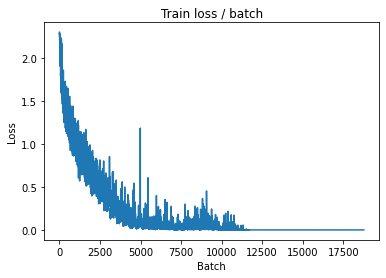

[TRAIN Batch 200/391]	Time 0.019s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


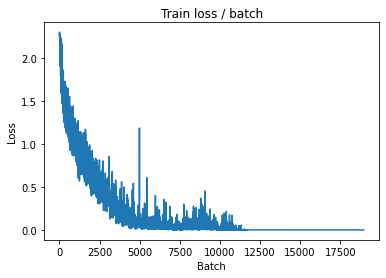


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 2.2307 (2.2307)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2727	Avg Prec@1 76.05 %	Avg Prec@5 97.90 %



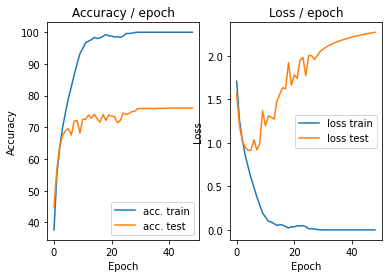

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


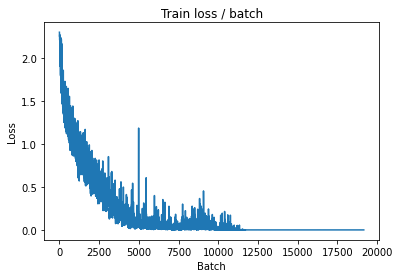

[TRAIN Batch 200/391]	Time 0.028s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


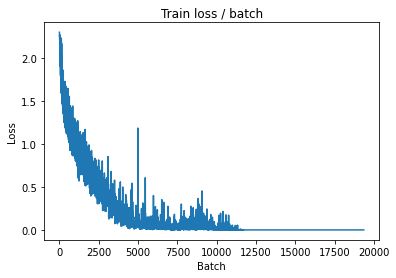


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 2.2370 (2.2370)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2784	Avg Prec@1 76.07 %	Avg Prec@5 97.90 %



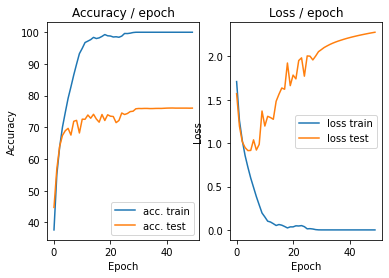

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


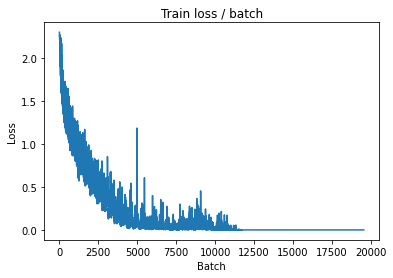

[TRAIN Batch 200/391]	Time 0.029s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


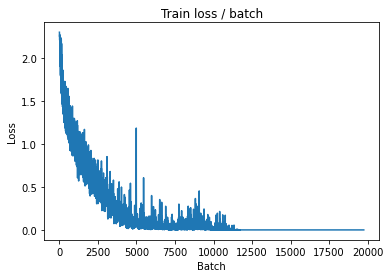


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.2433 (2.2433)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2840	Avg Prec@1 76.07 %	Avg Prec@5 97.90 %



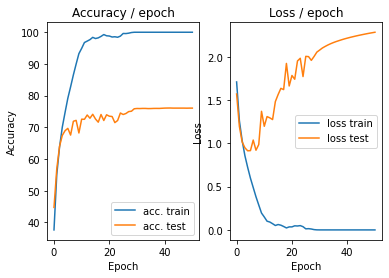

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


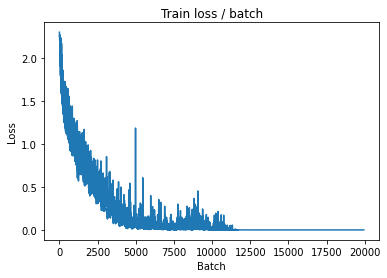

[TRAIN Batch 200/391]	Time 0.021s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


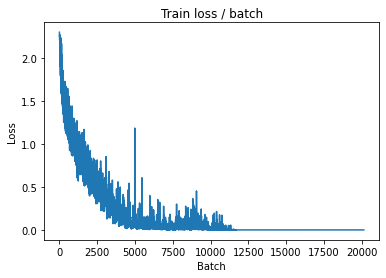


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 2.2489 (2.2489)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2894	Avg Prec@1 76.08 %	Avg Prec@5 97.90 %



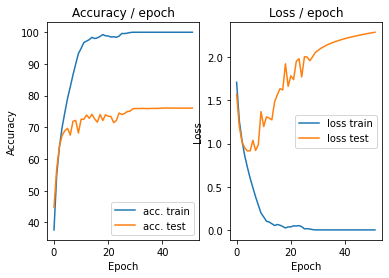

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


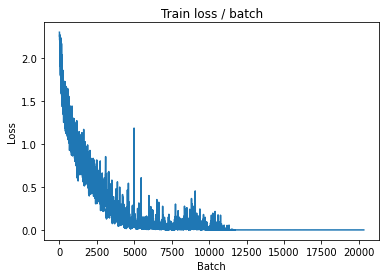

[TRAIN Batch 200/391]	Time 0.034s (0.039s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


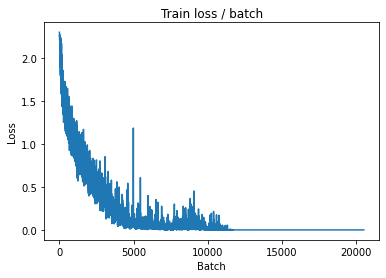


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 2.2550 (2.2550)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2945	Avg Prec@1 76.08 %	Avg Prec@5 97.90 %



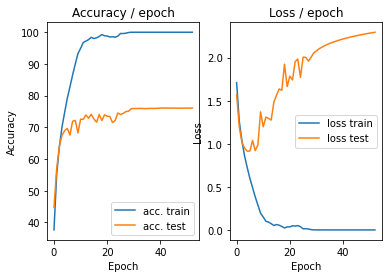

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


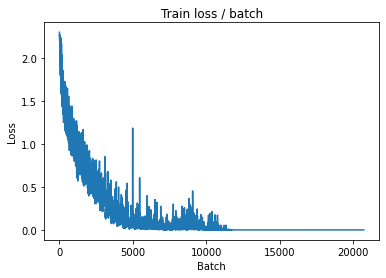

[TRAIN Batch 200/391]	Time 0.041s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


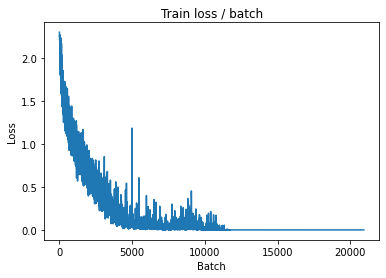


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 2.2602 (2.2602)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2996	Avg Prec@1 76.07 %	Avg Prec@5 97.90 %



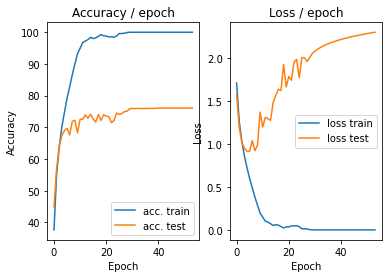

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


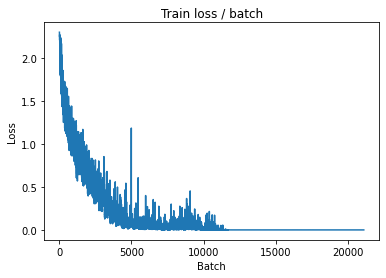

[TRAIN Batch 200/391]	Time 0.050s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


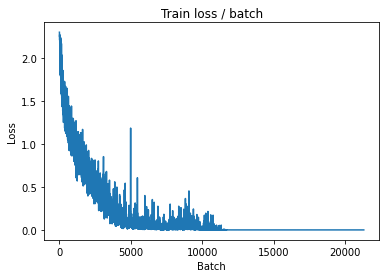


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 2.2656 (2.2656)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3044	Avg Prec@1 76.06 %	Avg Prec@5 97.89 %



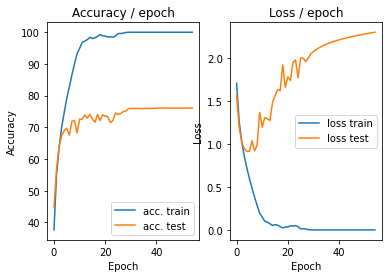

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


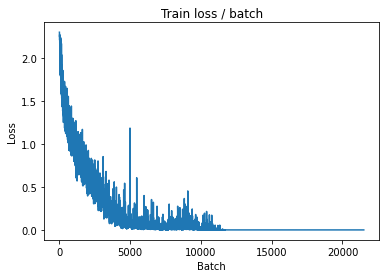

[TRAIN Batch 200/391]	Time 0.019s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


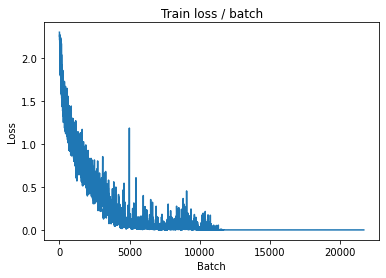


===============> Total time 15s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 2.2710 (2.2710)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3091	Avg Prec@1 76.05 %	Avg Prec@5 97.90 %



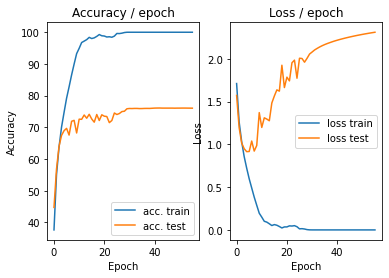

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


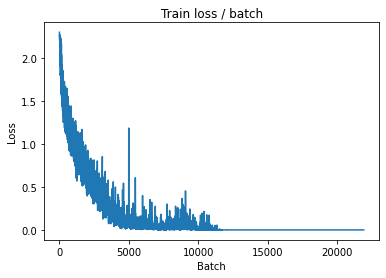

[TRAIN Batch 200/391]	Time 0.065s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


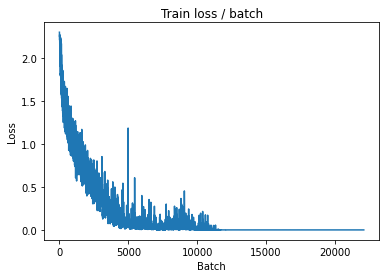


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 2.2760 (2.2760)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3138	Avg Prec@1 76.06 %	Avg Prec@5 97.90 %



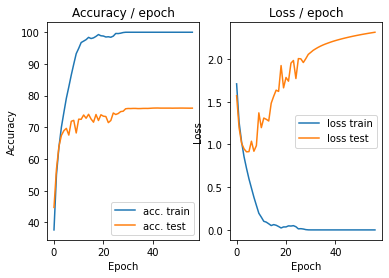

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


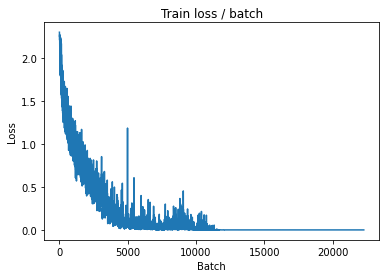

[TRAIN Batch 200/391]	Time 0.021s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


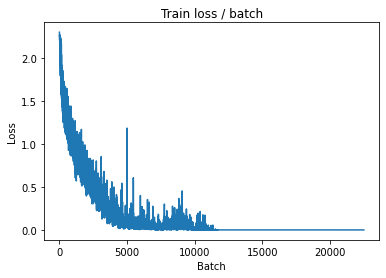


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 2.2809 (2.2809)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3183	Avg Prec@1 76.05 %	Avg Prec@5 97.90 %



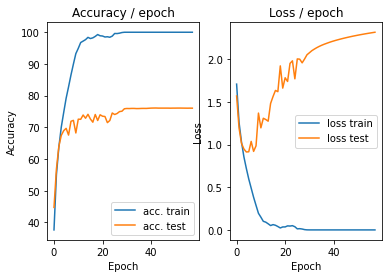

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


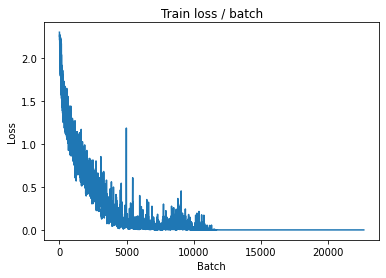

[TRAIN Batch 200/391]	Time 0.058s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


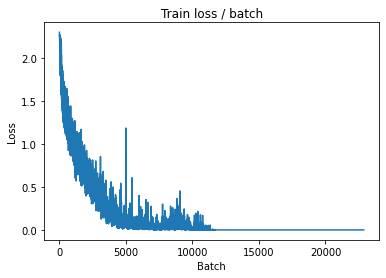


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 2.2856 (2.2856)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3227	Avg Prec@1 76.06 %	Avg Prec@5 97.90 %



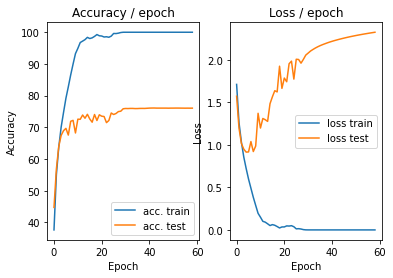

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


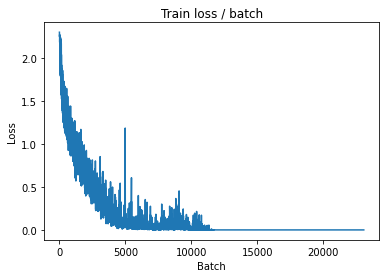

[TRAIN Batch 200/391]	Time 0.056s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


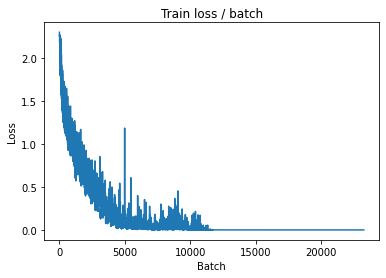


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 2.2903 (2.2903)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3269	Avg Prec@1 76.08 %	Avg Prec@5 97.90 %



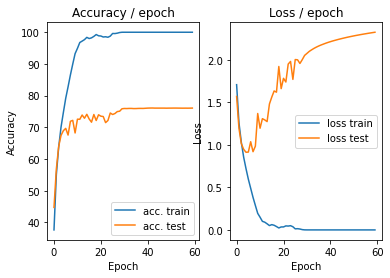

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


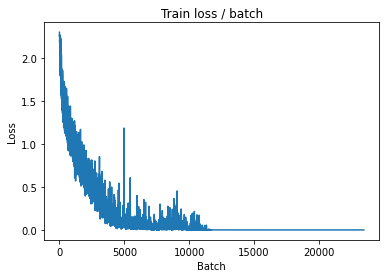

[TRAIN Batch 200/391]	Time 0.050s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


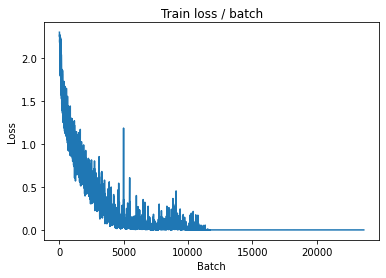


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 2.2951 (2.2951)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3311	Avg Prec@1 76.09 %	Avg Prec@5 97.91 %



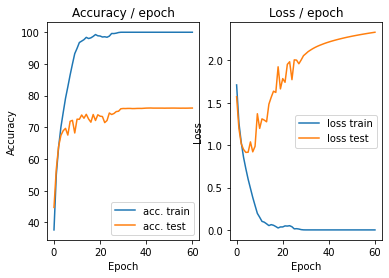

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


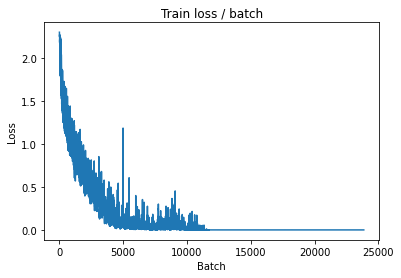

[TRAIN Batch 200/391]	Time 0.041s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


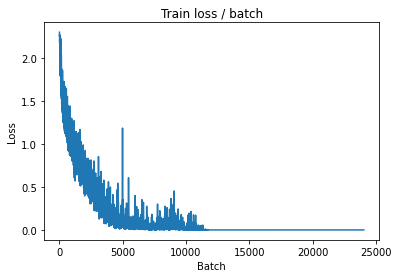


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 2.3003 (2.3003)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3352	Avg Prec@1 76.12 %	Avg Prec@5 97.89 %



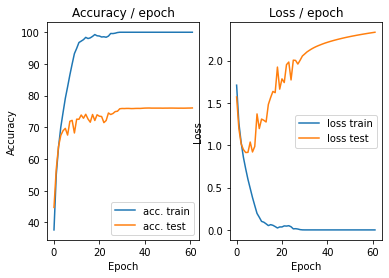

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


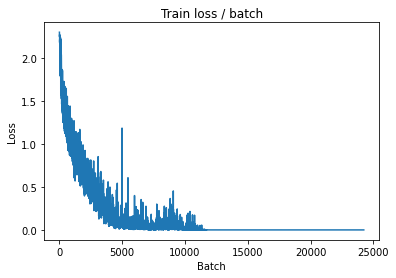

[TRAIN Batch 200/391]	Time 0.024s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


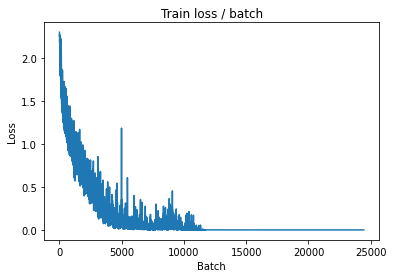


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 2.3048 (2.3048)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3391	Avg Prec@1 76.10 %	Avg Prec@5 97.90 %



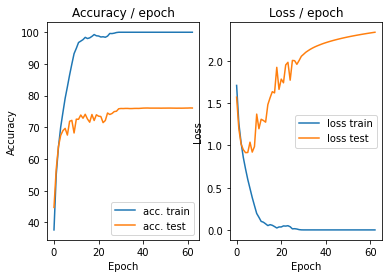

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


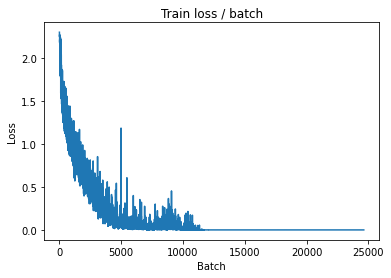

[TRAIN Batch 200/391]	Time 0.042s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


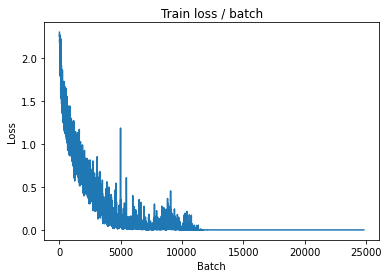


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 2.3091 (2.3091)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3428	Avg Prec@1 76.11 %	Avg Prec@5 97.89 %



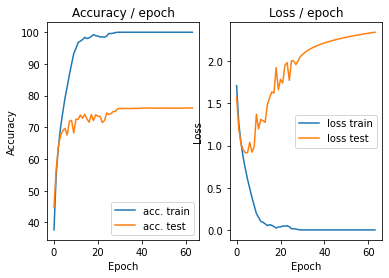

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


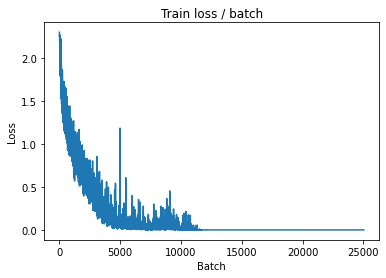

[TRAIN Batch 200/391]	Time 0.049s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


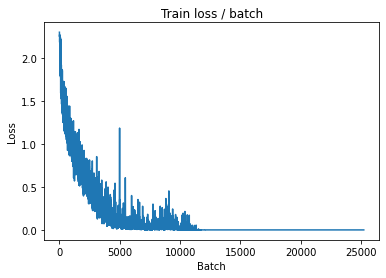


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 2.3134 (2.3134)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3466	Avg Prec@1 76.13 %	Avg Prec@5 97.89 %



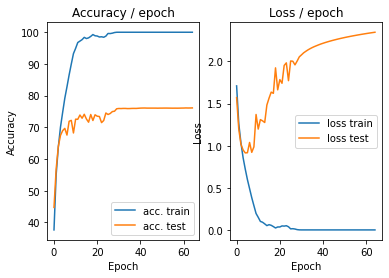

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


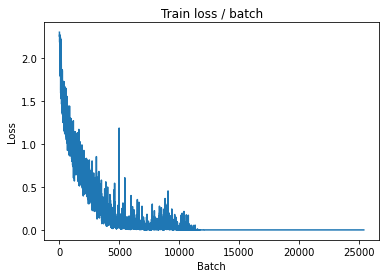

[TRAIN Batch 200/391]	Time 0.028s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


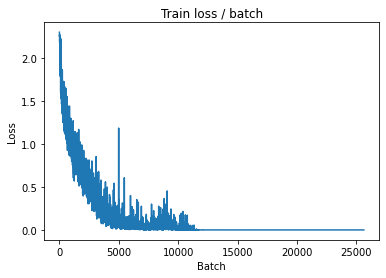


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 2.3174 (2.3174)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3503	Avg Prec@1 76.13 %	Avg Prec@5 97.89 %



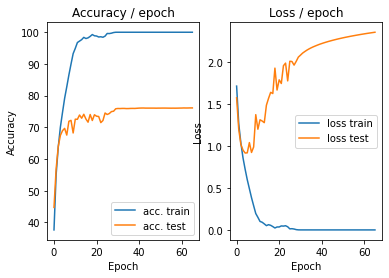

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


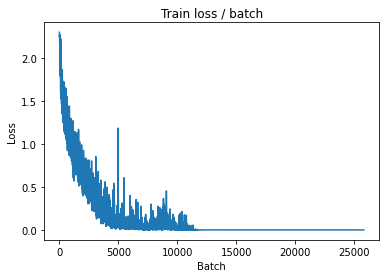

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


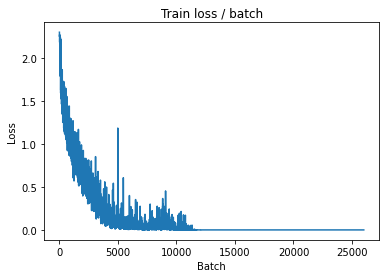


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.3212 (2.3212)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3539	Avg Prec@1 76.13 %	Avg Prec@5 97.89 %



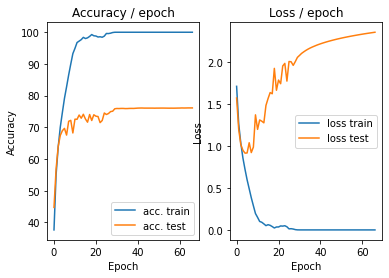

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


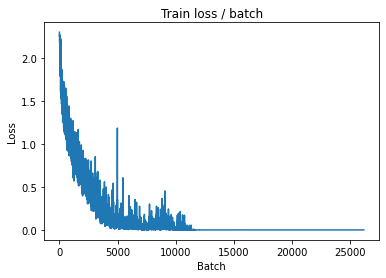

[TRAIN Batch 200/391]	Time 0.040s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


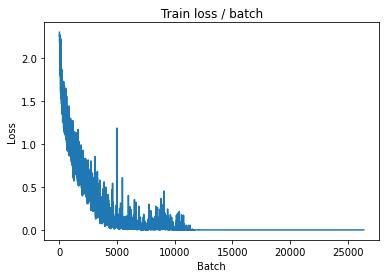


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 2.3251 (2.3251)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3574	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



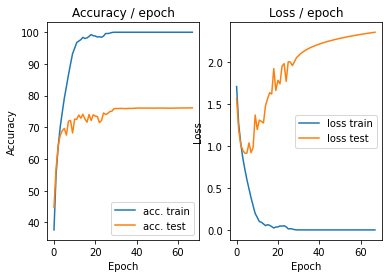

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


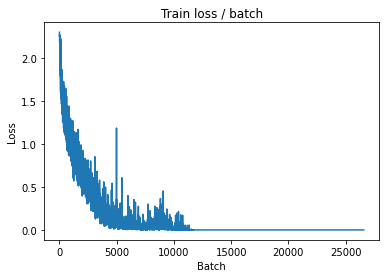

[TRAIN Batch 200/391]	Time 0.019s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


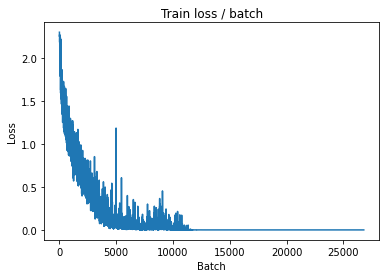


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 2.3291 (2.3291)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3608	Avg Prec@1 76.15 %	Avg Prec@5 97.91 %



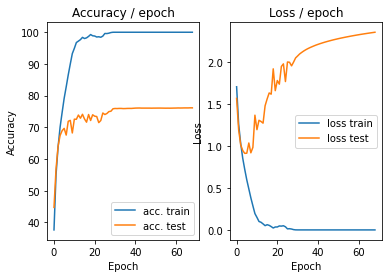

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


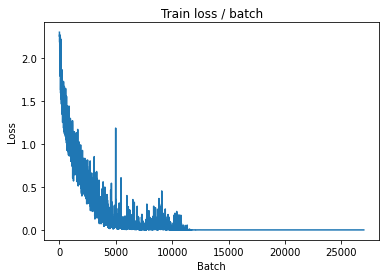

[TRAIN Batch 200/391]	Time 0.052s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


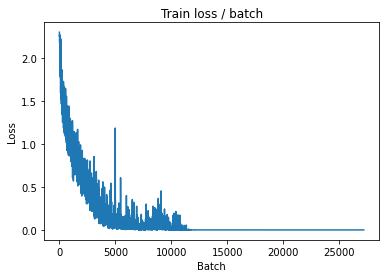


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 2.3329 (2.3329)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3642	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



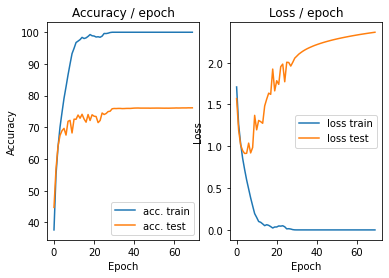

=== EPOCH 71 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


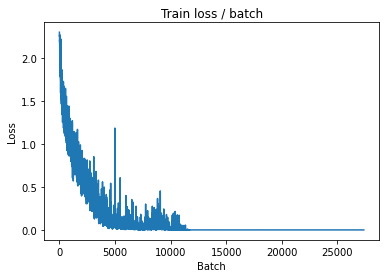

[TRAIN Batch 200/391]	Time 0.025s (0.040s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


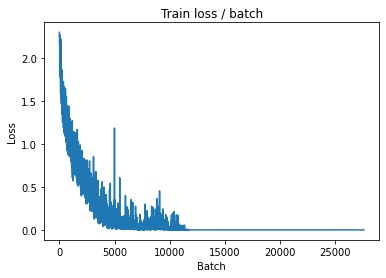


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 2.3367 (2.3367)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3675	Avg Prec@1 76.15 %	Avg Prec@5 97.91 %



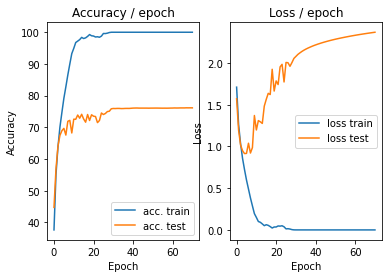

=== EPOCH 72 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


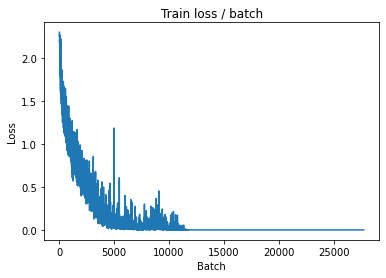

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


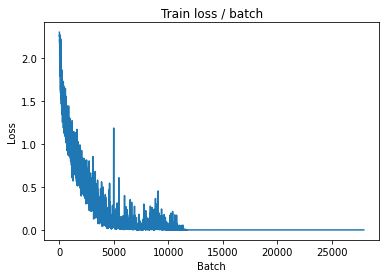


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 2.3406 (2.3406)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3707	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



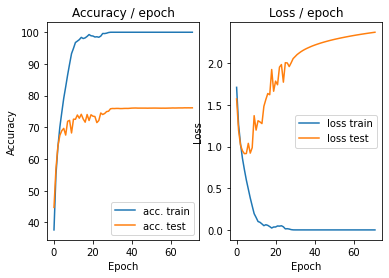

=== EPOCH 73 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


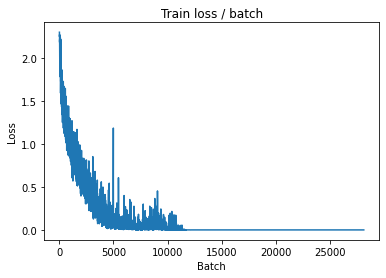

[TRAIN Batch 200/391]	Time 0.028s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


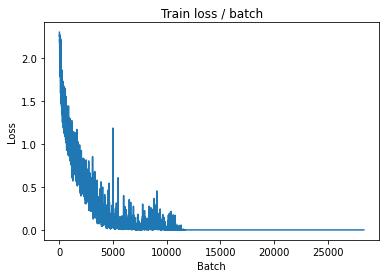


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 2.3442 (2.3442)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3739	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



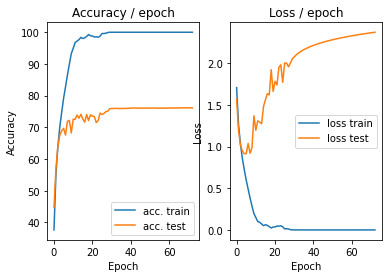

=== EPOCH 74 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


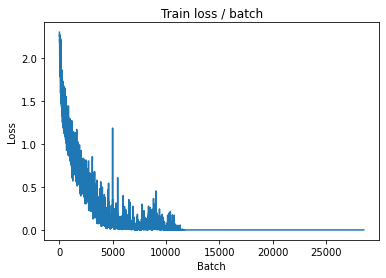

[TRAIN Batch 200/391]	Time 0.034s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


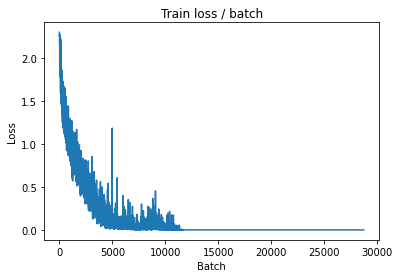


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 2.3478 (2.3478)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3770	Avg Prec@1 76.15 %	Avg Prec@5 97.91 %



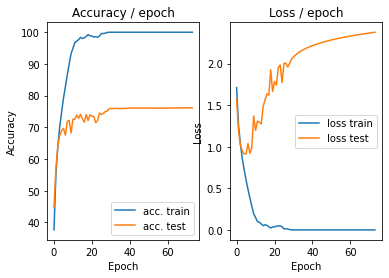

=== EPOCH 75 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


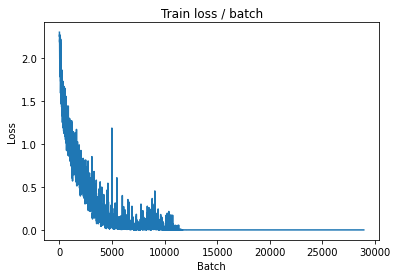

[TRAIN Batch 200/391]	Time 0.056s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


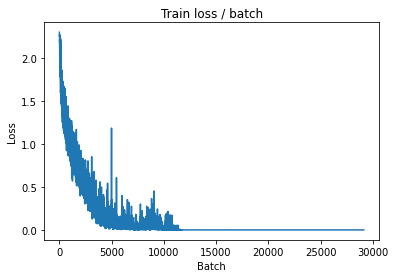


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.3512 (2.3512)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3800	Avg Prec@1 76.15 %	Avg Prec@5 97.91 %



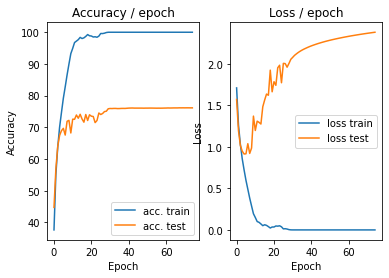

=== EPOCH 76 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


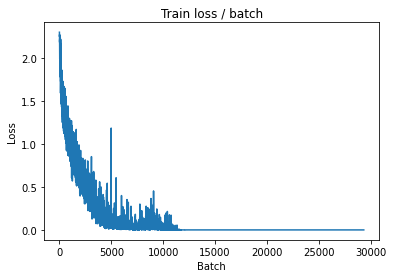

[TRAIN Batch 200/391]	Time 0.053s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


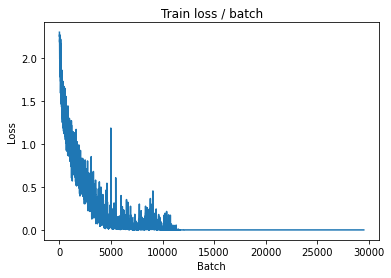


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 2.3547 (2.3547)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3831	Avg Prec@1 76.17 %	Avg Prec@5 97.91 %



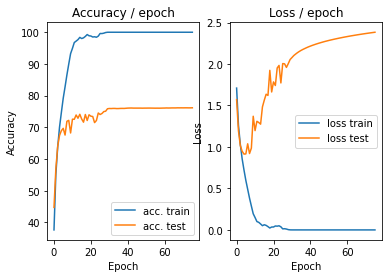

=== EPOCH 77 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


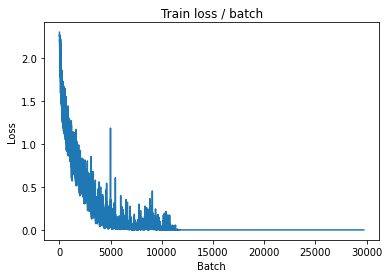

[TRAIN Batch 200/391]	Time 0.025s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


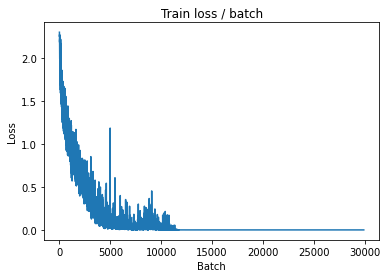


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 2.3580 (2.3580)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3860	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



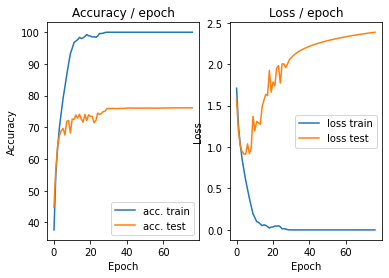

=== EPOCH 78 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


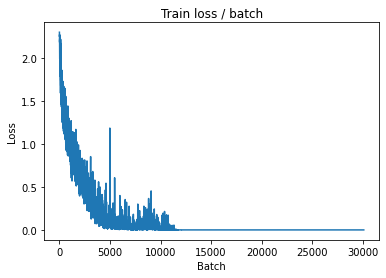

[TRAIN Batch 200/391]	Time 0.062s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


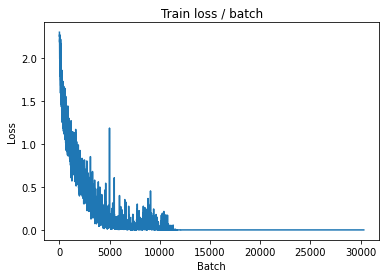


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 2.3614 (2.3614)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3888	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



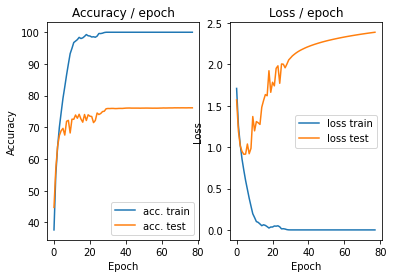

=== EPOCH 79 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


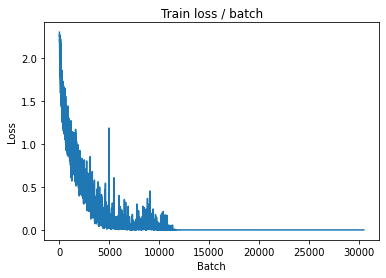

[TRAIN Batch 200/391]	Time 0.039s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


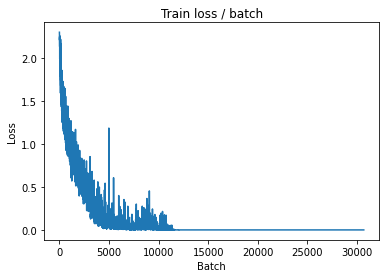


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 2.3646 (2.3646)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3917	Avg Prec@1 76.16 %	Avg Prec@5 97.91 %



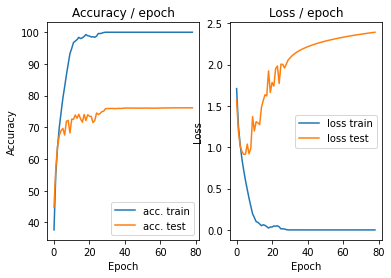

=== EPOCH 80 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


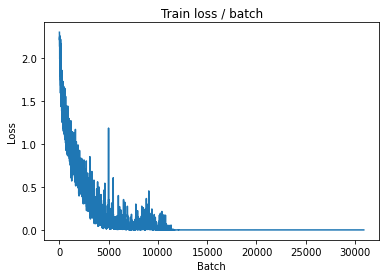

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


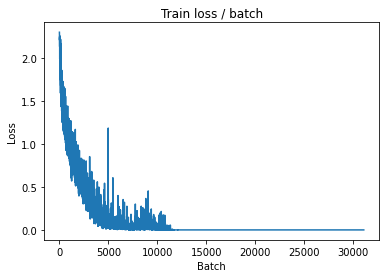


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 2.3677 (2.3677)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3945	Avg Prec@1 76.17 %	Avg Prec@5 97.91 %



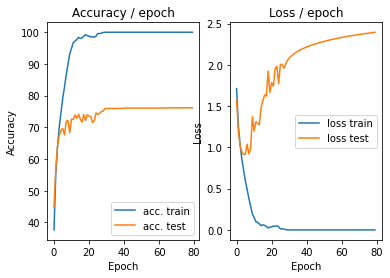

=== EPOCH 81 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


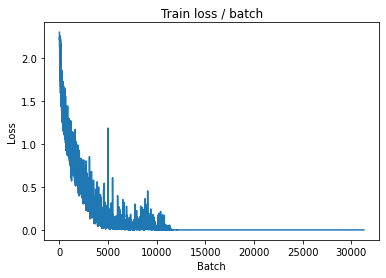

[TRAIN Batch 200/391]	Time 0.067s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


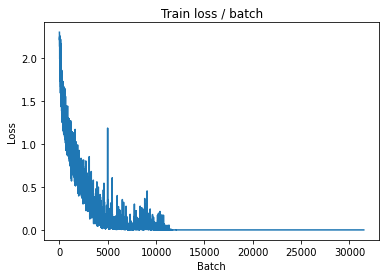


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.3710 (2.3710)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3973	Avg Prec@1 76.19 %	Avg Prec@5 97.91 %



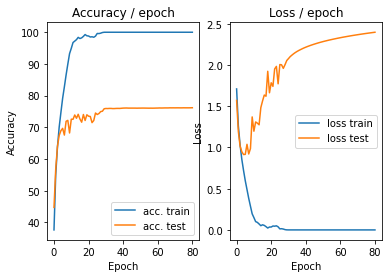

=== EPOCH 82 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


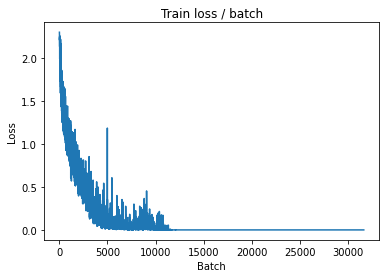

[TRAIN Batch 200/391]	Time 0.022s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


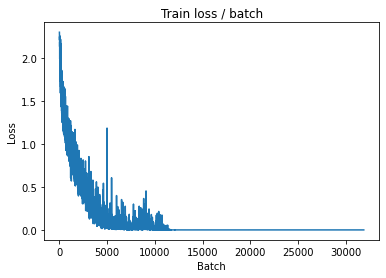


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 2.3742 (2.3742)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4000	Avg Prec@1 76.19 %	Avg Prec@5 97.91 %



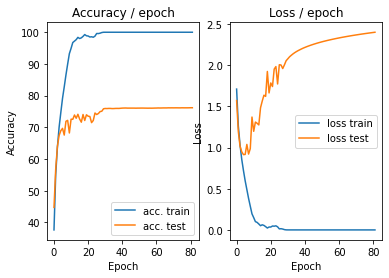

=== EPOCH 83 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


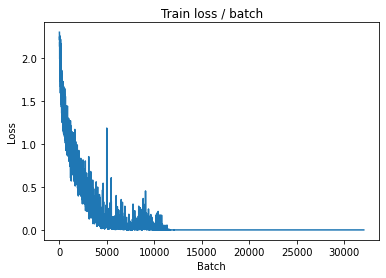

[TRAIN Batch 200/391]	Time 0.053s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


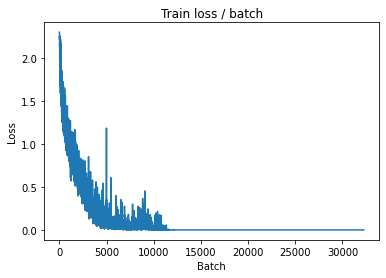


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 2.3772 (2.3772)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4027	Avg Prec@1 76.20 %	Avg Prec@5 97.92 %



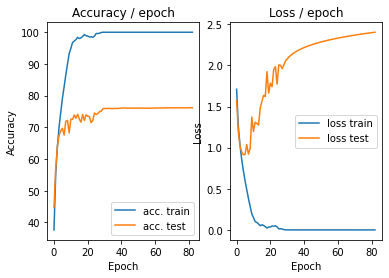

=== EPOCH 84 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


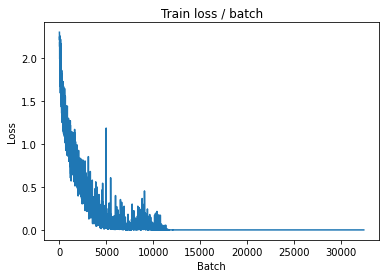

[TRAIN Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


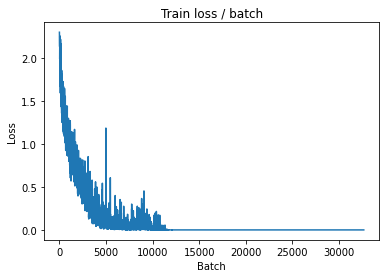


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 2.3801 (2.3801)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4053	Avg Prec@1 76.19 %	Avg Prec@5 97.92 %



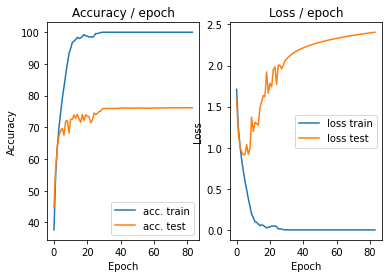

=== EPOCH 85 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


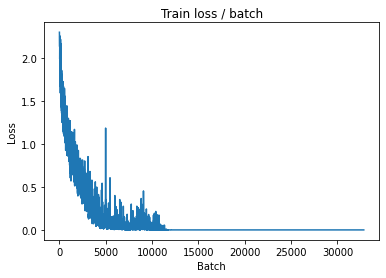

[TRAIN Batch 200/391]	Time 0.036s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


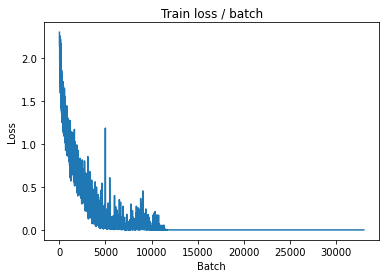


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 2.3832 (2.3832)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4079	Avg Prec@1 76.18 %	Avg Prec@5 97.92 %



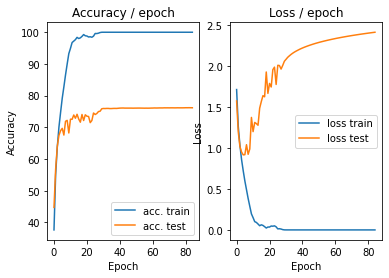

=== EPOCH 86 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


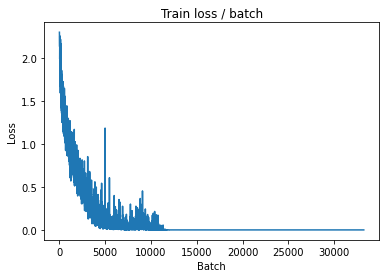

[TRAIN Batch 200/391]	Time 0.022s (0.036s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


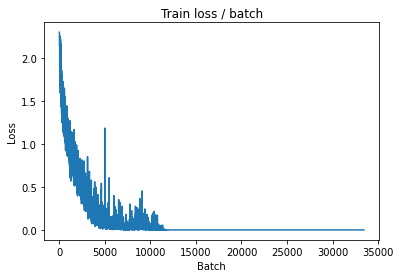


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.234s (0.234s)	Loss 2.3861 (2.3861)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4104	Avg Prec@1 76.17 %	Avg Prec@5 97.92 %



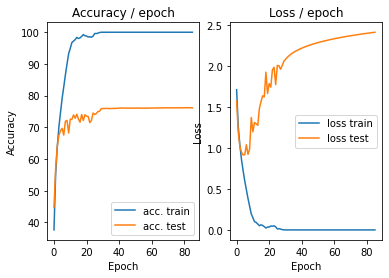

=== EPOCH 87 =====

[TRAIN Batch 000/391]	Time 0.307s (0.307s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


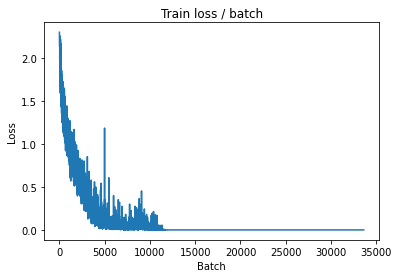

[TRAIN Batch 200/391]	Time 0.037s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


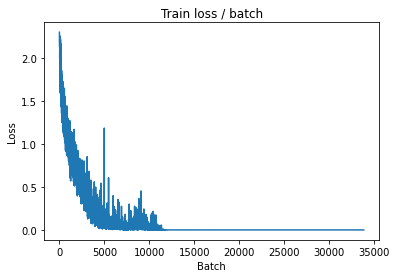


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 2.3889 (2.3889)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4130	Avg Prec@1 76.15 %	Avg Prec@5 97.92 %



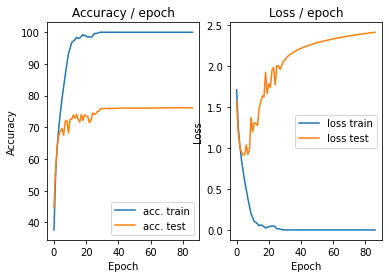

=== EPOCH 88 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


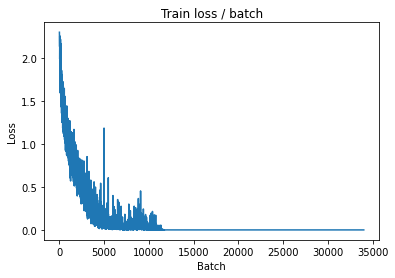

[TRAIN Batch 200/391]	Time 0.018s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


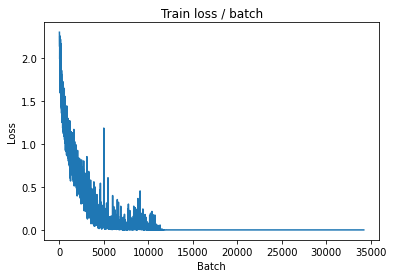


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 2.3918 (2.3918)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4154	Avg Prec@1 76.15 %	Avg Prec@5 97.92 %



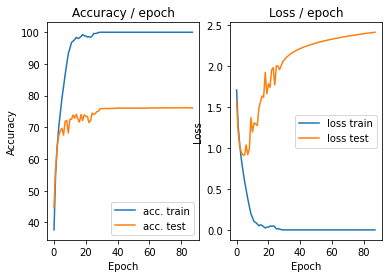

=== EPOCH 89 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


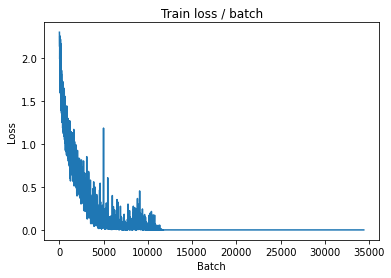

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


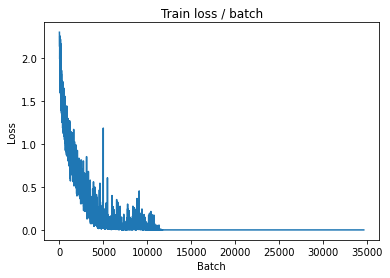


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 2.3946 (2.3946)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4179	Avg Prec@1 76.16 %	Avg Prec@5 97.93 %



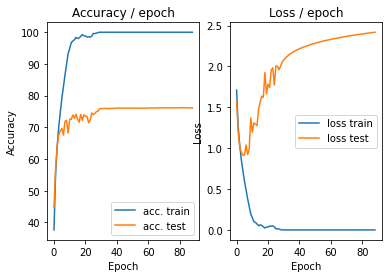

=== EPOCH 90 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


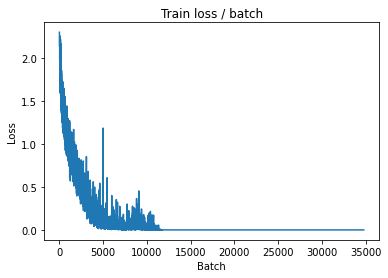

[TRAIN Batch 200/391]	Time 0.058s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


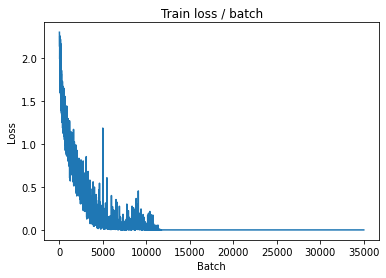


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 2.3974 (2.3974)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4203	Avg Prec@1 76.17 %	Avg Prec@5 97.93 %



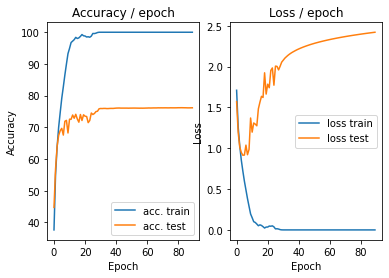

=== EPOCH 91 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


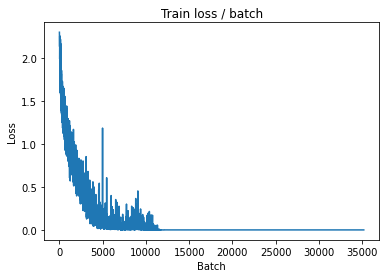

[TRAIN Batch 200/391]	Time 0.022s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


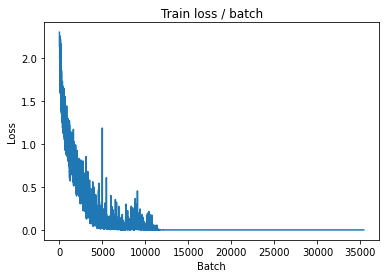


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 2.4001 (2.4001)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4226	Avg Prec@1 76.19 %	Avg Prec@5 97.93 %



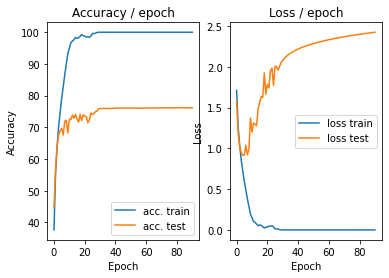

=== EPOCH 92 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


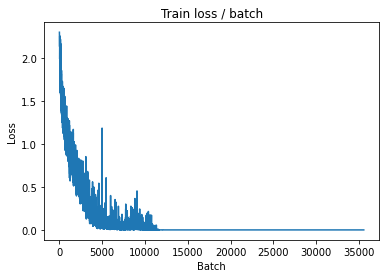

[TRAIN Batch 200/391]	Time 0.056s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


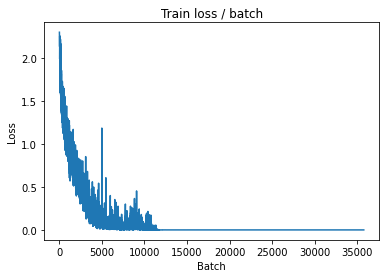


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 2.4026 (2.4026)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4250	Avg Prec@1 76.20 %	Avg Prec@5 97.93 %



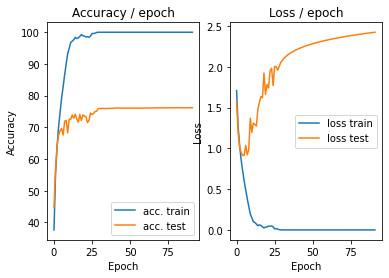

=== EPOCH 93 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


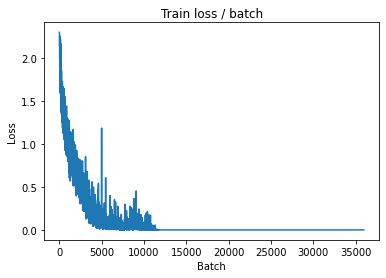

[TRAIN Batch 200/391]	Time 0.026s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


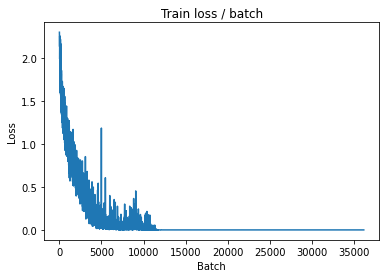


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 2.4052 (2.4052)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4273	Avg Prec@1 76.20 %	Avg Prec@5 97.94 %



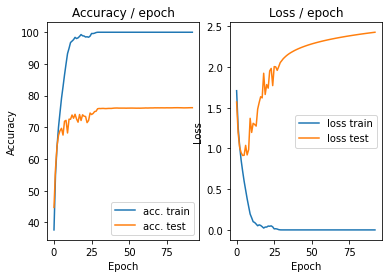

=== EPOCH 94 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


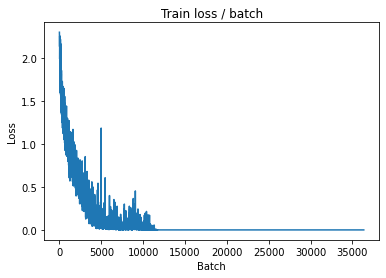

[TRAIN Batch 200/391]	Time 0.027s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


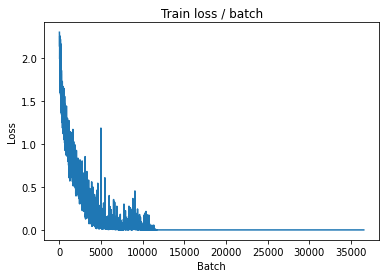


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 2.4077 (2.4077)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4296	Avg Prec@1 76.20 %	Avg Prec@5 97.94 %



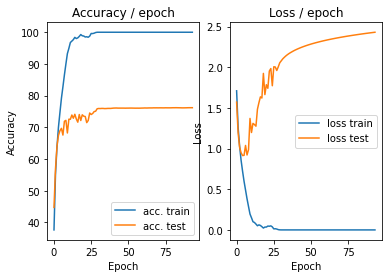

=== EPOCH 95 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


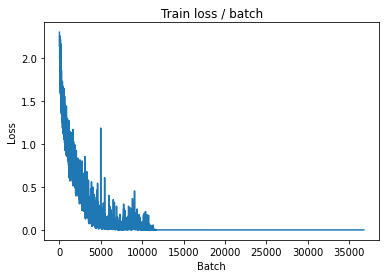

[TRAIN Batch 200/391]	Time 0.023s (0.040s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


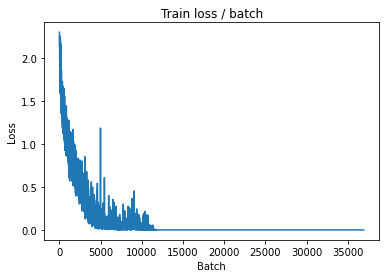


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 2.4102 (2.4102)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4318	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



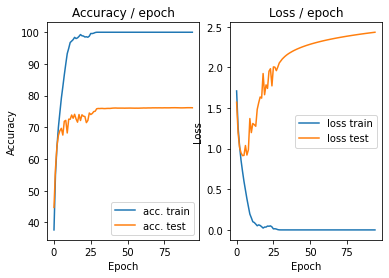

=== EPOCH 96 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


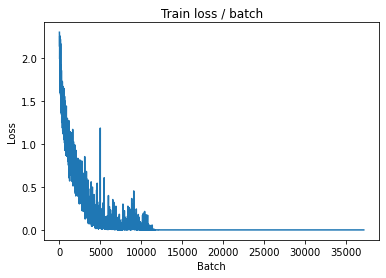

[TRAIN Batch 200/391]	Time 0.059s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


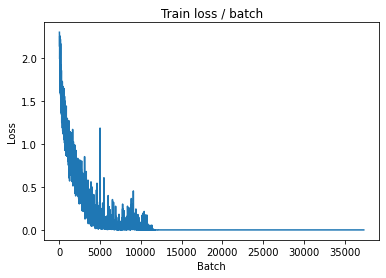


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 2.4127 (2.4127)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4340	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



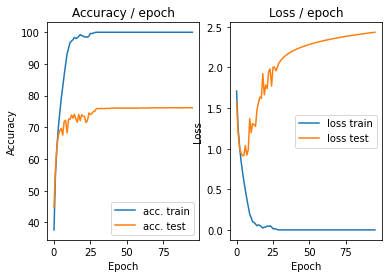

=== EPOCH 97 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


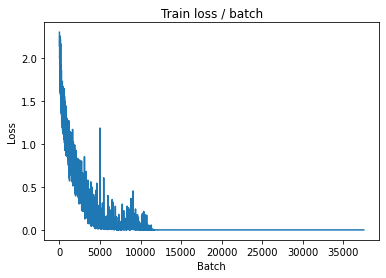

[TRAIN Batch 200/391]	Time 0.053s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


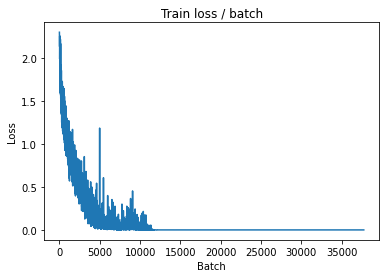


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 2.4153 (2.4153)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4362	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



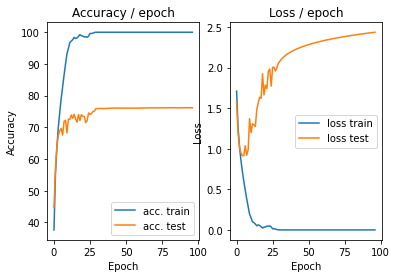

=== EPOCH 98 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


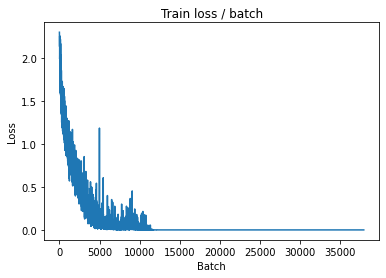

[TRAIN Batch 200/391]	Time 0.023s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


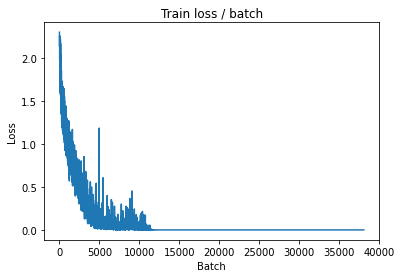


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.237s (0.237s)	Loss 2.4177 (2.4177)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4384	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



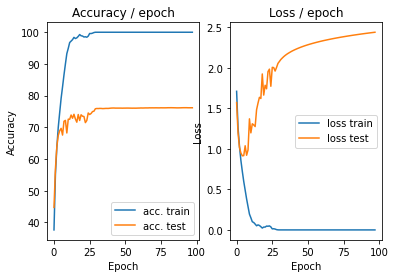

=== EPOCH 99 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


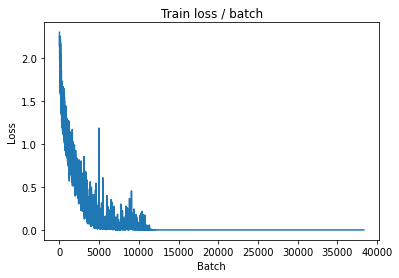

[TRAIN Batch 200/391]	Time 0.037s (0.039s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


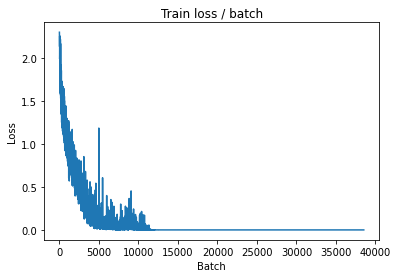


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 2.4201 (2.4201)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4405	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



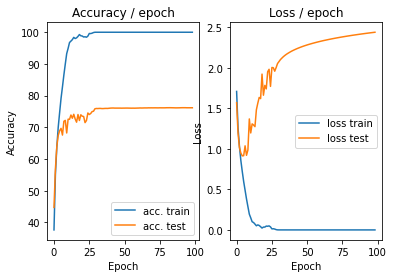

=== EPOCH 100 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


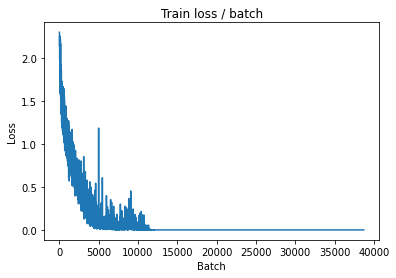

[TRAIN Batch 200/391]	Time 0.031s (0.038s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


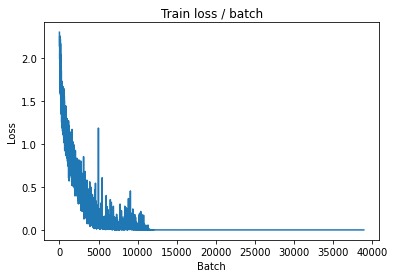


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 2.4225 (2.4225)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4426	Avg Prec@1 76.18 %	Avg Prec@5 97.94 %



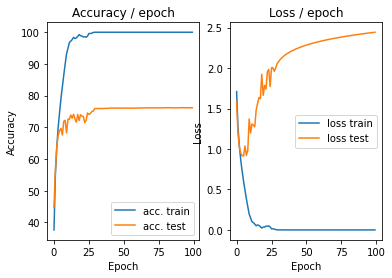

In [ ]:
main(128, 0.1, 100, cuda=True)

Partie 3.2 Data Augmentation

In [ ]:
class ConvNetDataAug(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetDataAug, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2), #conv1
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool1
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), #conv2
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool2
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), #conv3
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), #pool3
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000), #fc4
            nn.ReLU(),
            nn.Linear(1000, 10), #fc5
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )   

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    normalize = transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.RandomCrop(28), transforms.RandomHorizontalFlip()               
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetDataAug()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 2.3010 (2.3010)	Prec@1  16.4 ( 16.4)	Prec@5  50.0 ( 50.0)


<Figure size 432x288 with 0 Axes>

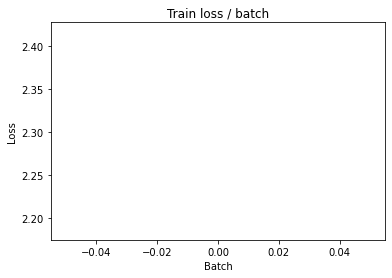

[TRAIN Batch 200/391]	Time 0.024s (0.049s)	Loss 1.6517 (1.9701)	Prec@1  33.6 ( 27.9)	Prec@5  93.0 ( 78.2)


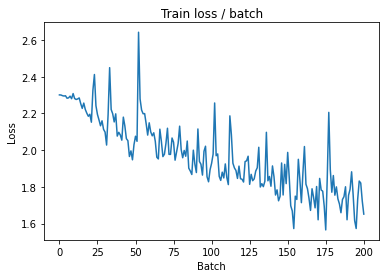


===============> Total time 19s	Avg loss 1.7995	Avg Prec@1 34.45 %	Avg Prec@5 83.87 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.6719 (1.6719)	Prec@1  35.9 ( 35.9)	Prec@5  89.8 ( 89.8)

===============> Total time 2s	Avg loss 1.6060	Avg Prec@1 41.16 %	Avg Prec@5 90.80 %



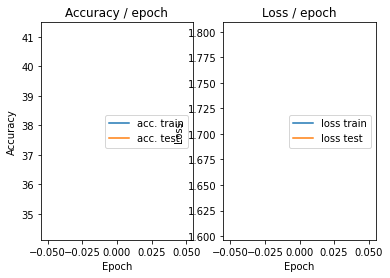

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 1.6513 (1.6513)	Prec@1  45.3 ( 45.3)	Prec@5  92.2 ( 92.2)


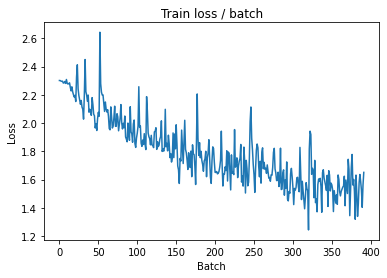

[TRAIN Batch 200/391]	Time 0.021s (0.049s)	Loss 1.5956 (1.4513)	Prec@1  40.6 ( 48.3)	Prec@5  92.2 ( 92.2)


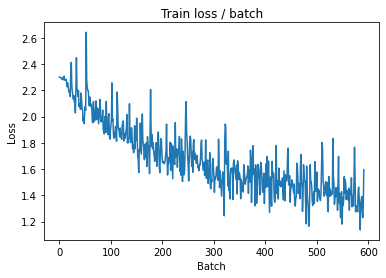


===============> Total time 18s	Avg loss 1.3940	Avg Prec@1 50.46 %	Avg Prec@5 92.96 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.0843 (1.0843)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2420	Avg Prec@1 54.91 %	Avg Prec@5 95.25 %



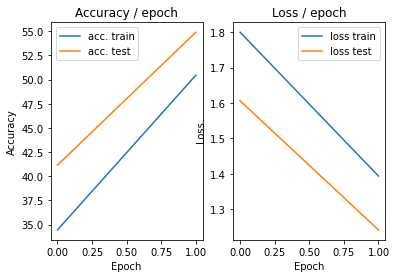

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 1.1590 (1.1590)	Prec@1  57.8 ( 57.8)	Prec@5  96.9 ( 96.9)


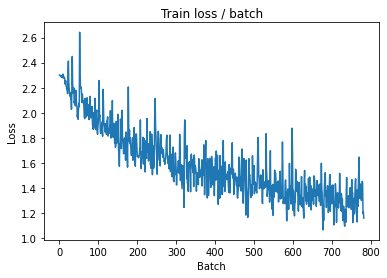

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 1.2779 (1.2256)	Prec@1  60.9 ( 56.6)	Prec@5  93.0 ( 95.2)


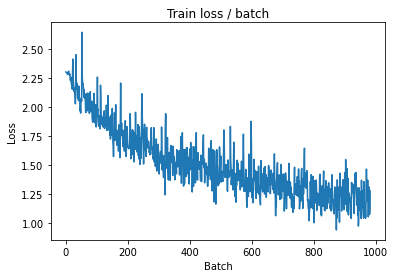


===============> Total time 18s	Avg loss 1.1877	Avg Prec@1 58.12 %	Avg Prec@5 95.34 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.3186 (1.3186)	Prec@1  55.5 ( 55.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.3090	Avg Prec@1 55.04 %	Avg Prec@5 94.74 %



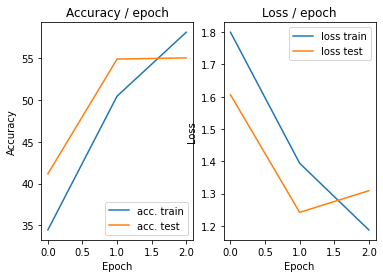

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 1.3360 (1.3360)	Prec@1  50.0 ( 50.0)	Prec@5  93.8 ( 93.8)


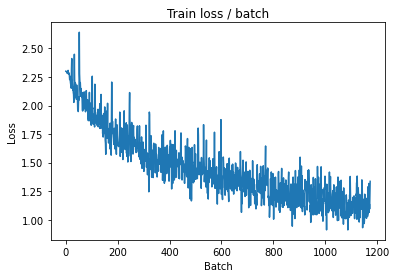

[TRAIN Batch 200/391]	Time 0.025s (0.048s)	Loss 1.1256 (1.0598)	Prec@1  61.7 ( 62.9)	Prec@5  96.1 ( 96.3)


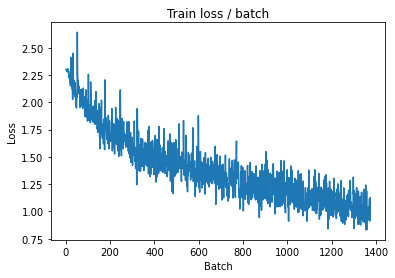


===============> Total time 18s	Avg loss 1.0331	Avg Prec@1 63.69 %	Avg Prec@5 96.44 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.9636 (0.9636)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9990	Avg Prec@1 65.33 %	Avg Prec@5 96.49 %



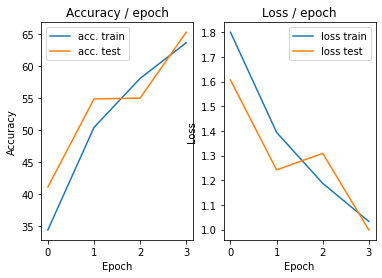

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.9186 (0.9186)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


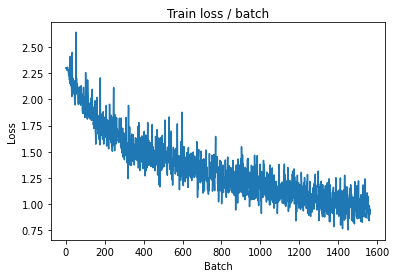

[TRAIN Batch 200/391]	Time 0.077s (0.050s)	Loss 0.9690 (0.9339)	Prec@1  63.3 ( 67.4)	Prec@5  98.4 ( 97.2)


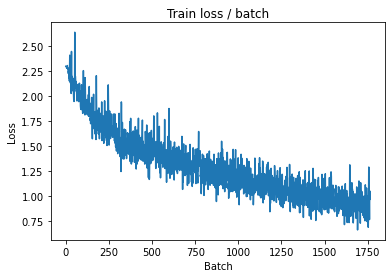


===============> Total time 18s	Avg loss 0.9187	Avg Prec@1 68.13 %	Avg Prec@5 97.23 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 0.9309 (0.9309)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0537	Avg Prec@1 64.11 %	Avg Prec@5 95.51 %



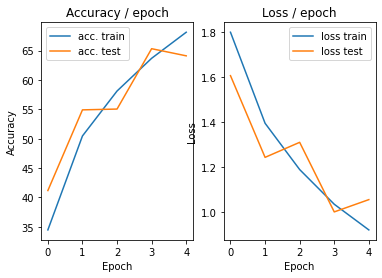

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 1.0990 (1.0990)	Prec@1  59.4 ( 59.4)	Prec@5  95.3 ( 95.3)


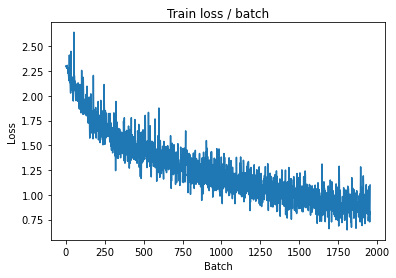

[TRAIN Batch 200/391]	Time 0.026s (0.046s)	Loss 0.7896 (0.8466)	Prec@1  68.8 ( 70.2)	Prec@5 100.0 ( 97.7)


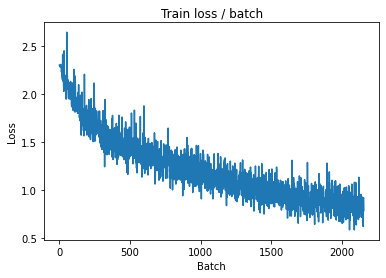


===============> Total time 18s	Avg loss 0.8359	Avg Prec@1 70.77 %	Avg Prec@5 97.70 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.6939 (0.6939)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7966	Avg Prec@1 72.10 %	Avg Prec@5 98.00 %



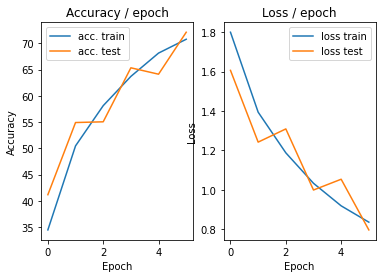

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.8053 (0.8053)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


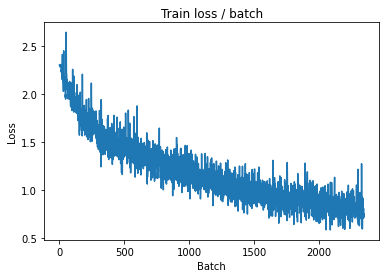

[TRAIN Batch 200/391]	Time 0.069s (0.049s)	Loss 0.7185 (0.7841)	Prec@1  77.3 ( 72.8)	Prec@5 100.0 ( 98.1)


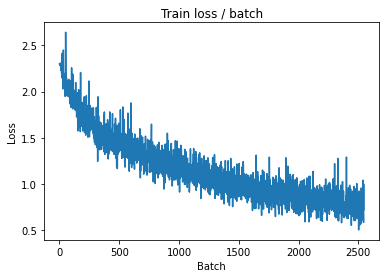


===============> Total time 18s	Avg loss 0.7712	Avg Prec@1 73.30 %	Avg Prec@5 98.10 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.7197 (0.7197)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7955	Avg Prec@1 72.84 %	Avg Prec@5 97.98 %



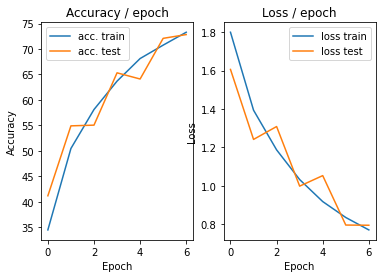

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.5920 (0.5920)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


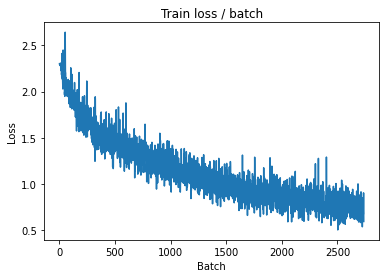

[TRAIN Batch 200/391]	Time 0.039s (0.047s)	Loss 0.5919 (0.7216)	Prec@1  78.9 ( 74.7)	Prec@5  98.4 ( 98.3)


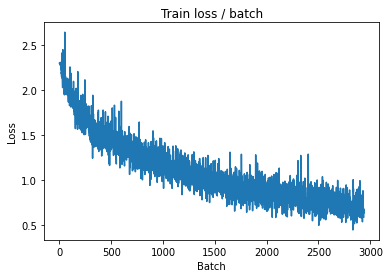


===============> Total time 18s	Avg loss 0.7091	Avg Prec@1 75.16 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.7112 (0.7112)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7469	Avg Prec@1 74.72 %	Avg Prec@5 98.18 %



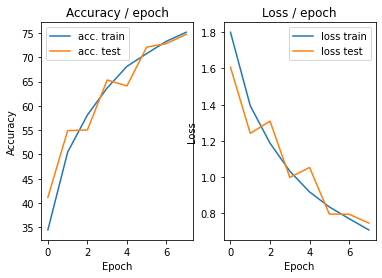

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.7263 (0.7263)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)


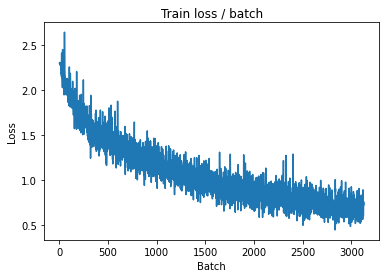

[TRAIN Batch 200/391]	Time 0.061s (0.047s)	Loss 0.7228 (0.6691)	Prec@1  74.2 ( 76.9)	Prec@5  96.9 ( 98.6)


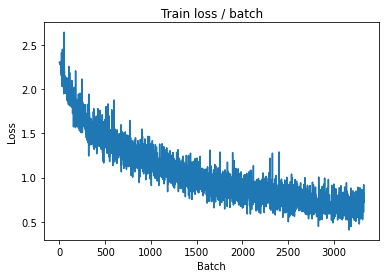


===============> Total time 18s	Avg loss 0.6675	Avg Prec@1 76.85 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.6659 (0.6659)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7177	Avg Prec@1 75.72 %	Avg Prec@5 98.18 %



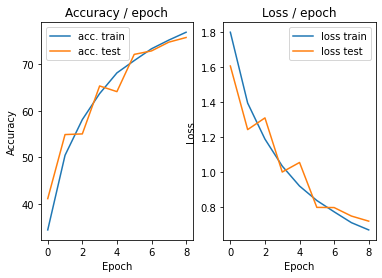

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.4389 (0.4389)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


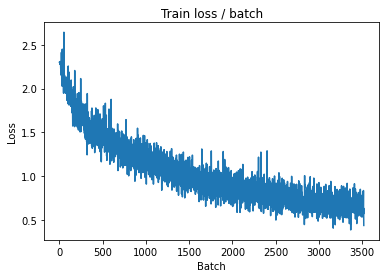

[TRAIN Batch 200/391]	Time 0.019s (0.047s)	Loss 0.8416 (0.6170)	Prec@1  72.7 ( 78.4)	Prec@5  96.1 ( 98.8)


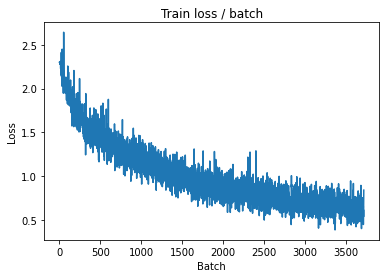


===============> Total time 18s	Avg loss 0.6264	Avg Prec@1 78.09 %	Avg Prec@5 98.73 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.6259 (0.6259)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6901	Avg Prec@1 76.49 %	Avg Prec@5 98.48 %



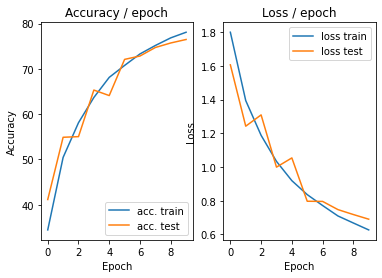

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.4714 (0.4714)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


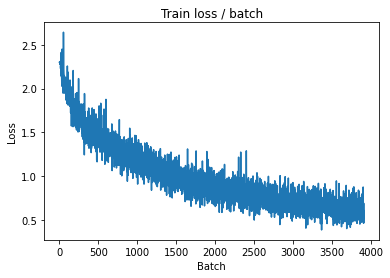

[TRAIN Batch 200/391]	Time 0.045s (0.046s)	Loss 0.5547 (0.5940)	Prec@1  82.8 ( 79.4)	Prec@5  98.4 ( 99.0)


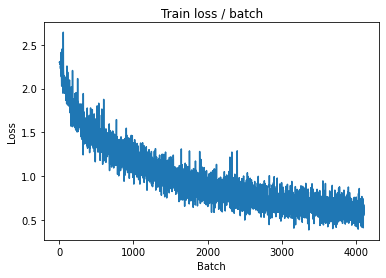


===============> Total time 17s	Avg loss 0.5929	Avg Prec@1 79.34 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.6465 (0.6465)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6920	Avg Prec@1 76.78 %	Avg Prec@5 98.37 %



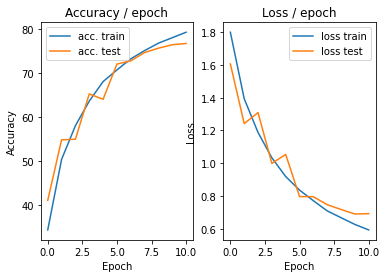

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.4934 (0.4934)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)


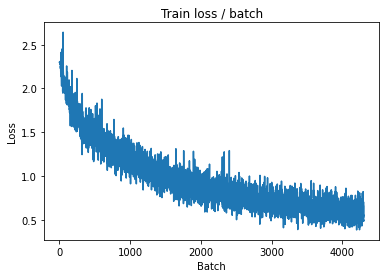

[TRAIN Batch 200/391]	Time 0.059s (0.049s)	Loss 0.5126 (0.5634)	Prec@1  81.2 ( 80.8)	Prec@5  97.7 ( 98.8)


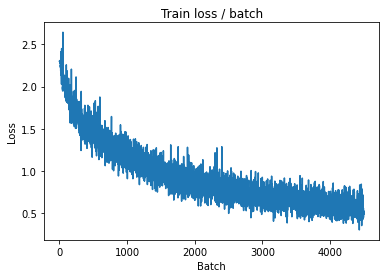


===============> Total time 18s	Avg loss 0.5647	Avg Prec@1 80.63 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.6181 (0.6181)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7468	Avg Prec@1 74.74 %	Avg Prec@5 98.28 %



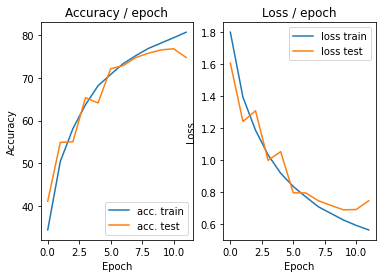

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.4542 (0.4542)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


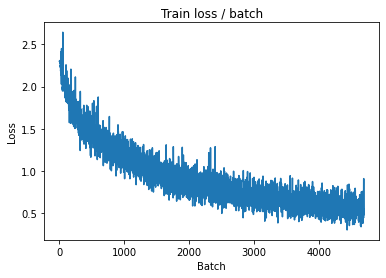

[TRAIN Batch 200/391]	Time 0.084s (0.047s)	Loss 0.5002 (0.5261)	Prec@1  82.8 ( 81.8)	Prec@5  99.2 ( 99.1)


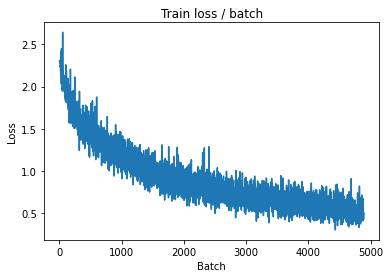


===============> Total time 18s	Avg loss 0.5291	Avg Prec@1 81.64 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6921 (0.6921)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6779	Avg Prec@1 77.25 %	Avg Prec@5 98.57 %



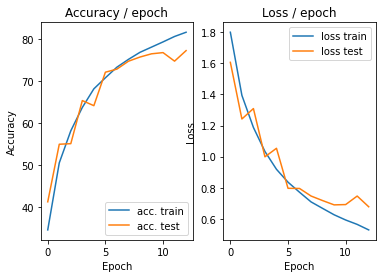

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.5210 (0.5210)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


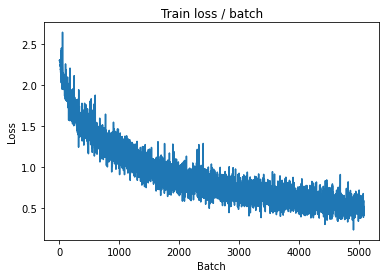

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.5016 (0.4994)	Prec@1  84.4 ( 82.4)	Prec@5  99.2 ( 99.3)


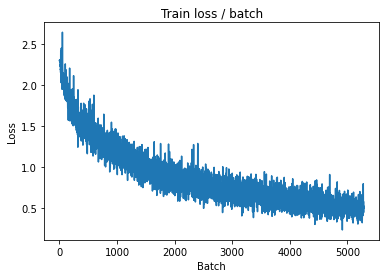


===============> Total time 18s	Avg loss 0.5009	Avg Prec@1 82.49 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.5809 (0.5809)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6641	Avg Prec@1 77.90 %	Avg Prec@5 98.48 %



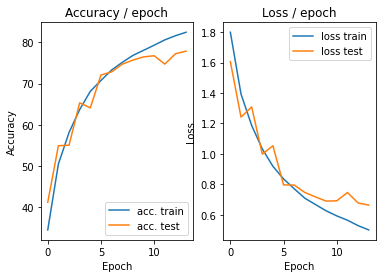

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.6287 (0.6287)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


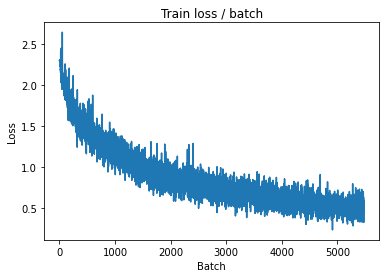

[TRAIN Batch 200/391]	Time 0.019s (0.047s)	Loss 0.5349 (0.4830)	Prec@1  85.2 ( 83.1)	Prec@5  98.4 ( 99.3)


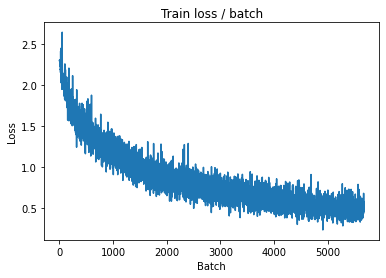


===============> Total time 18s	Avg loss 0.4829	Avg Prec@1 83.26 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.5543 (0.5543)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6214	Avg Prec@1 79.06 %	Avg Prec@5 98.63 %



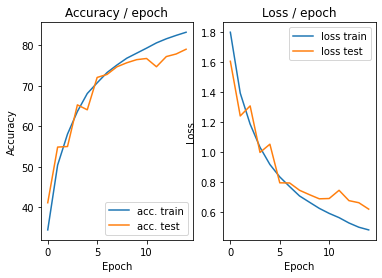

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.4840 (0.4840)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


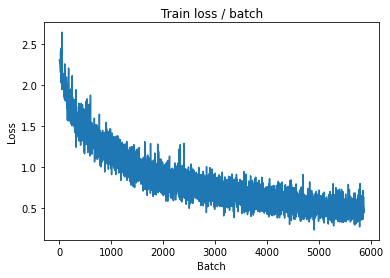

[TRAIN Batch 200/391]	Time 0.024s (0.046s)	Loss 0.3756 (0.4407)	Prec@1  85.9 ( 84.5)	Prec@5  99.2 ( 99.5)


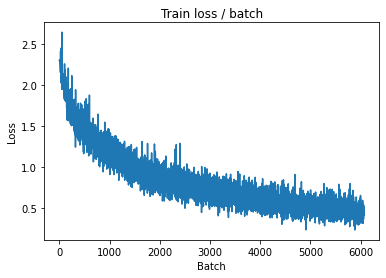


===============> Total time 17s	Avg loss 0.4538	Avg Prec@1 84.06 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.6093 (0.6093)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6787	Avg Prec@1 78.07 %	Avg Prec@5 98.53 %



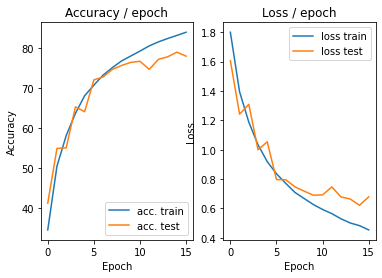

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.5494 (0.5494)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


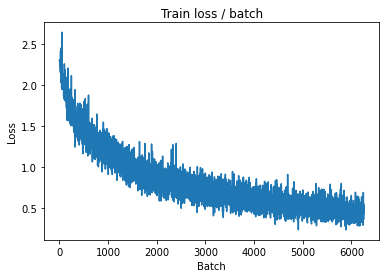

[TRAIN Batch 200/391]	Time 0.066s (0.048s)	Loss 0.4812 (0.4346)	Prec@1  84.4 ( 84.9)	Prec@5 100.0 ( 99.5)


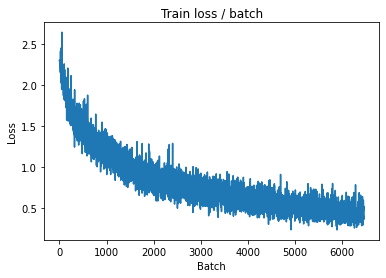


===============> Total time 18s	Avg loss 0.4388	Avg Prec@1 84.70 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.5157 (0.5157)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7164	Avg Prec@1 76.97 %	Avg Prec@5 98.10 %



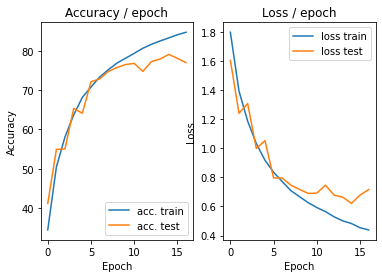

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.4403 (0.4403)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


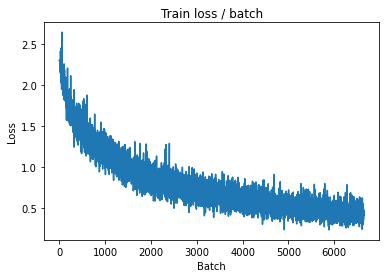

[TRAIN Batch 200/391]	Time 0.040s (0.048s)	Loss 0.4072 (0.4049)	Prec@1  83.6 ( 85.9)	Prec@5 100.0 ( 99.5)


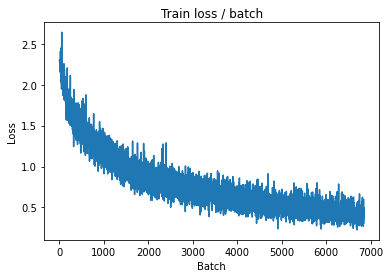


===============> Total time 18s	Avg loss 0.4186	Avg Prec@1 85.45 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.5190 (0.5190)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6083	Avg Prec@1 80.01 %	Avg Prec@5 98.80 %



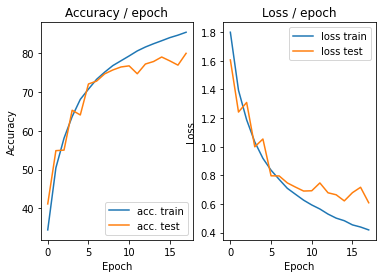

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.4007 (0.4007)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


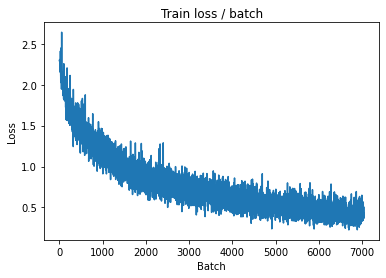

[TRAIN Batch 200/391]	Time 0.087s (0.048s)	Loss 0.3213 (0.3879)	Prec@1  89.1 ( 86.4)	Prec@5 100.0 ( 99.7)


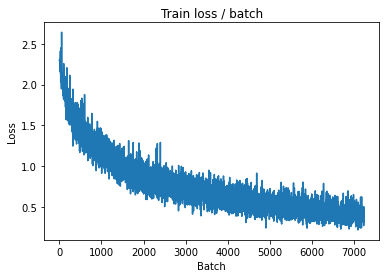


===============> Total time 18s	Avg loss 0.3993	Avg Prec@1 85.97 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.6290 (0.6290)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7213	Avg Prec@1 78.15 %	Avg Prec@5 98.64 %



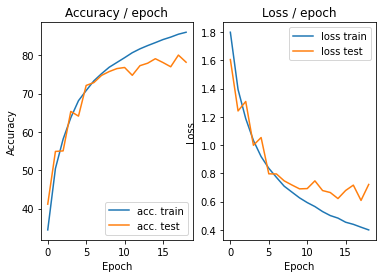

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.3350 (0.3350)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


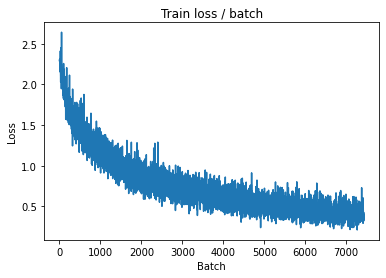

[TRAIN Batch 200/391]	Time 0.076s (0.048s)	Loss 0.3997 (0.3689)	Prec@1  87.5 ( 87.1)	Prec@5 100.0 ( 99.7)


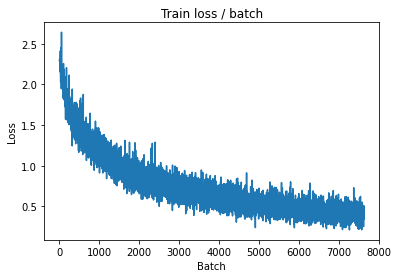


===============> Total time 18s	Avg loss 0.3765	Avg Prec@1 86.71 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.5181 (0.5181)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6621	Avg Prec@1 78.92 %	Avg Prec@5 98.73 %



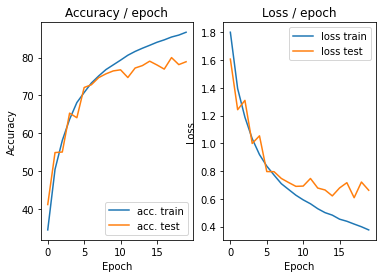

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 0.4586 (0.4586)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


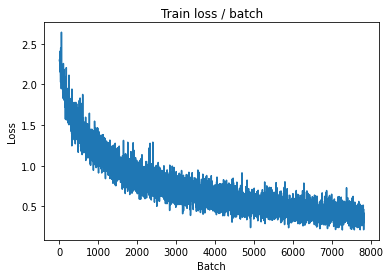

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.3505 (0.3602)	Prec@1  88.3 ( 87.3)	Prec@5 100.0 ( 99.6)


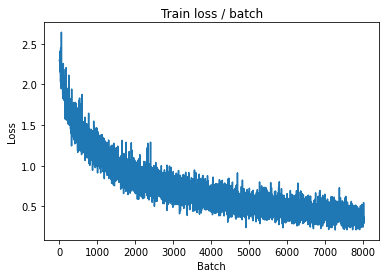


===============> Total time 18s	Avg loss 0.3641	Avg Prec@1 87.14 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.6889 (0.6889)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6945	Avg Prec@1 78.60 %	Avg Prec@5 98.81 %



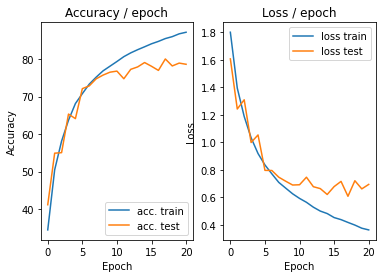

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.3506 (0.3506)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


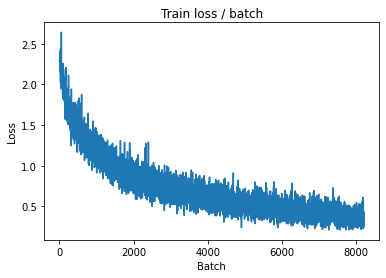

[TRAIN Batch 200/391]	Time 0.025s (0.052s)	Loss 0.4396 (0.3455)	Prec@1  81.2 ( 88.0)	Prec@5 100.0 ( 99.7)


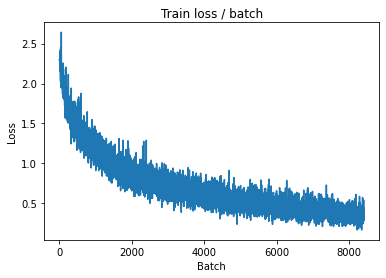


===============> Total time 19s	Avg loss 0.3508	Avg Prec@1 87.79 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.4909 (0.4909)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6428	Avg Prec@1 80.25 %	Avg Prec@5 98.76 %



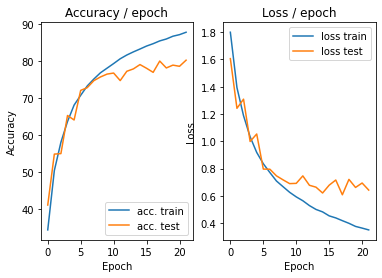

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.3689 (0.3689)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


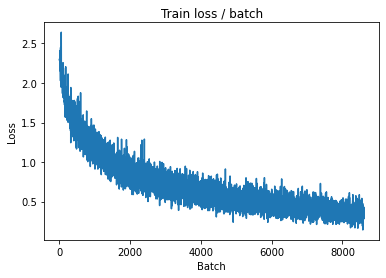

[TRAIN Batch 200/391]	Time 0.046s (0.048s)	Loss 0.3222 (0.3171)	Prec@1  86.7 ( 89.0)	Prec@5  99.2 ( 99.7)


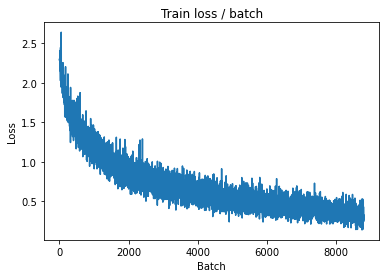


===============> Total time 18s	Avg loss 0.3309	Avg Prec@1 88.47 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.5401 (0.5401)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6398	Avg Prec@1 80.74 %	Avg Prec@5 98.80 %



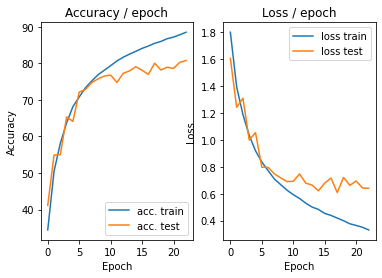

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.4400 (0.4400)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


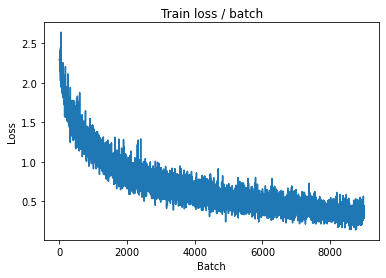

[TRAIN Batch 200/391]	Time 0.031s (0.048s)	Loss 0.2528 (0.3210)	Prec@1  88.3 ( 88.9)	Prec@5 100.0 ( 99.8)


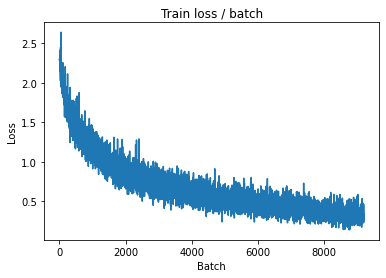


===============> Total time 18s	Avg loss 0.3223	Avg Prec@1 88.76 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6102 (0.6102)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6677	Avg Prec@1 79.51 %	Avg Prec@5 98.45 %



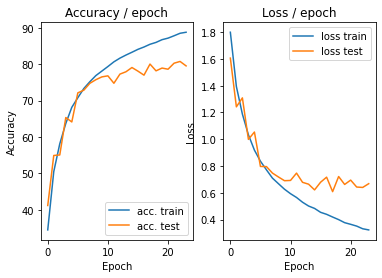

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.4013 (0.4013)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


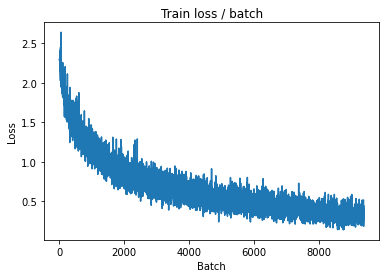

[TRAIN Batch 200/391]	Time 0.079s (0.048s)	Loss 0.2406 (0.2904)	Prec@1  92.2 ( 89.8)	Prec@5 100.0 ( 99.8)


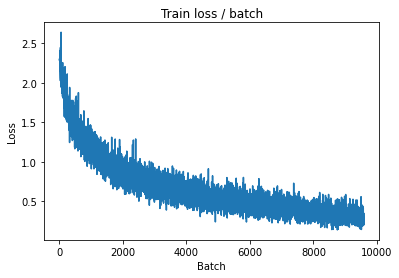


===============> Total time 18s	Avg loss 0.3071	Avg Prec@1 89.19 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.5335 (0.5335)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6397	Avg Prec@1 80.35 %	Avg Prec@5 98.76 %



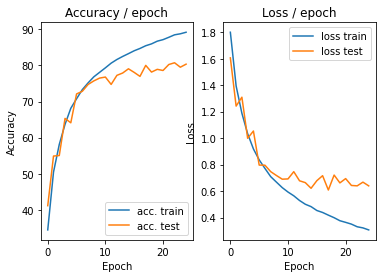

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.2761 (0.2761)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


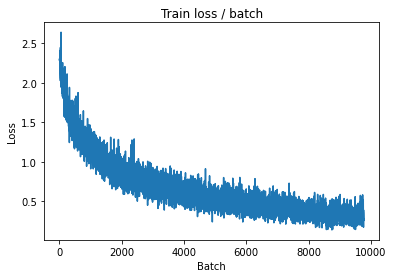

[TRAIN Batch 200/391]	Time 0.071s (0.050s)	Loss 0.3334 (0.2868)	Prec@1  89.1 ( 89.9)	Prec@5 100.0 ( 99.8)


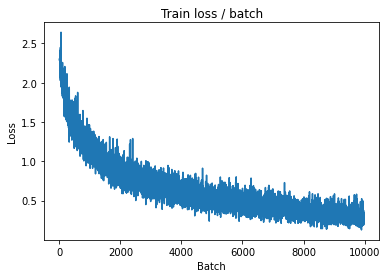


===============> Total time 18s	Avg loss 0.2952	Avg Prec@1 89.63 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.6396 (0.6396)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7407	Avg Prec@1 79.22 %	Avg Prec@5 98.74 %



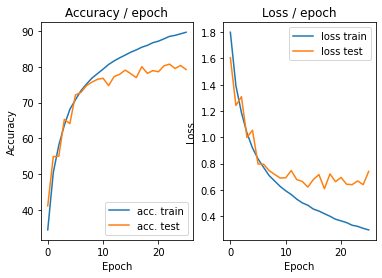

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.3847 (0.3847)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


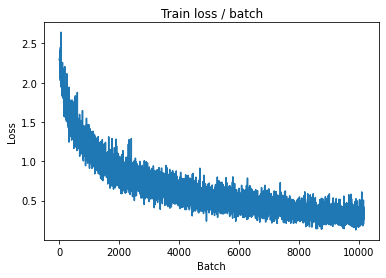

[TRAIN Batch 200/391]	Time 0.073s (0.048s)	Loss 0.3635 (0.2821)	Prec@1  88.3 ( 90.2)	Prec@5  99.2 ( 99.8)


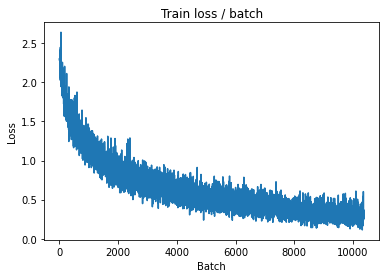


===============> Total time 18s	Avg loss 0.2914	Avg Prec@1 89.99 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.5520 (0.5520)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6739	Avg Prec@1 79.59 %	Avg Prec@5 98.64 %



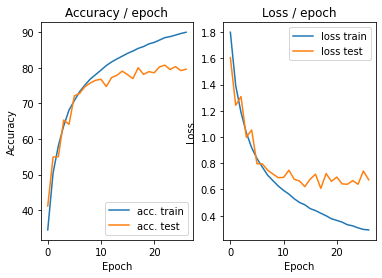

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.2168 (0.2168)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


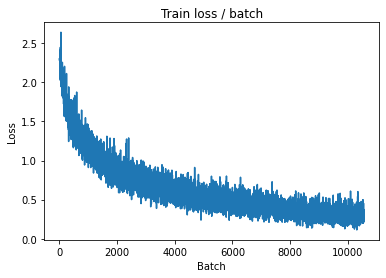

[TRAIN Batch 200/391]	Time 0.025s (0.047s)	Loss 0.2509 (0.2695)	Prec@1  93.8 ( 90.4)	Prec@5 100.0 ( 99.8)


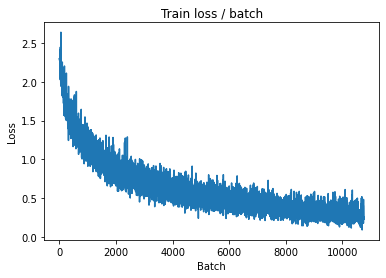


===============> Total time 18s	Avg loss 0.2709	Avg Prec@1 90.46 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.5267 (0.5267)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6912	Avg Prec@1 79.49 %	Avg Prec@5 98.60 %



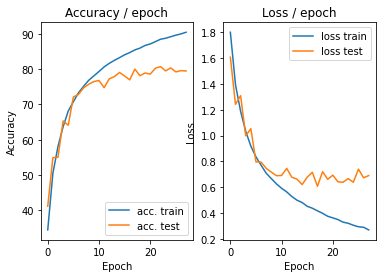

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.2319 (0.2319)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


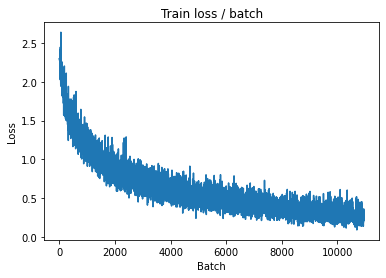

[TRAIN Batch 200/391]	Time 0.019s (0.047s)	Loss 0.2459 (0.2580)	Prec@1  90.6 ( 91.0)	Prec@5 100.0 ( 99.9)


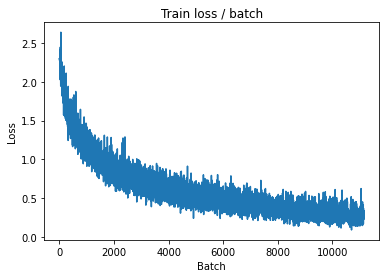


===============> Total time 18s	Avg loss 0.2654	Avg Prec@1 90.78 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.6972 (0.6972)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7205	Avg Prec@1 79.27 %	Avg Prec@5 98.58 %



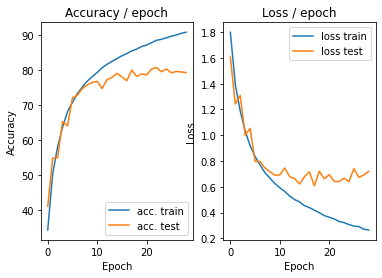

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.3084 (0.3084)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


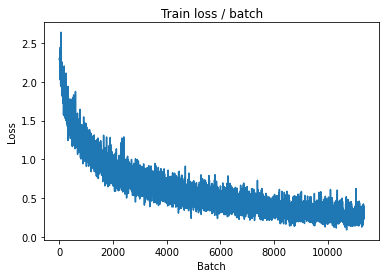

[TRAIN Batch 200/391]	Time 0.018s (0.049s)	Loss 0.2569 (0.2505)	Prec@1  90.6 ( 91.2)	Prec@5 100.0 ( 99.9)


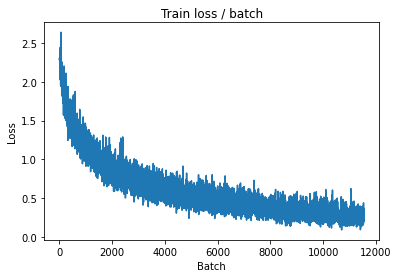


===============> Total time 18s	Avg loss 0.2570	Avg Prec@1 90.94 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.5983 (0.5983)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7087	Avg Prec@1 80.47 %	Avg Prec@5 98.64 %



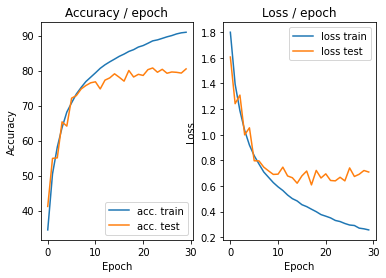

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.1811 (0.1811)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


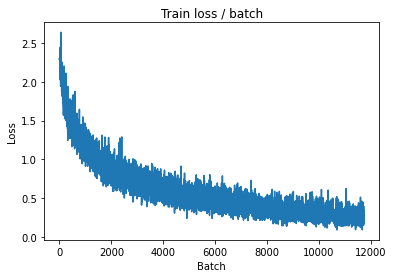

[TRAIN Batch 200/391]	Time 0.028s (0.048s)	Loss 0.3309 (0.2335)	Prec@1  84.4 ( 91.9)	Prec@5 100.0 ( 99.9)


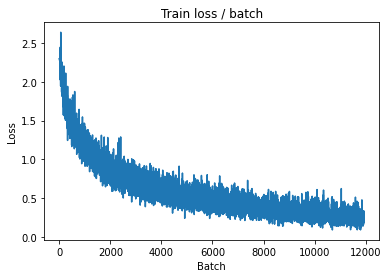


===============> Total time 18s	Avg loss 0.2457	Avg Prec@1 91.46 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.6000 (0.6000)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7098	Avg Prec@1 79.98 %	Avg Prec@5 98.58 %



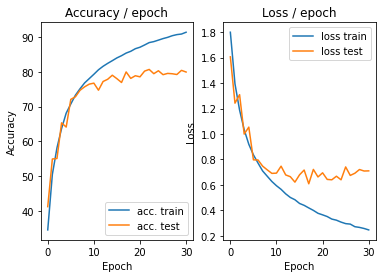

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.2152 (0.2152)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


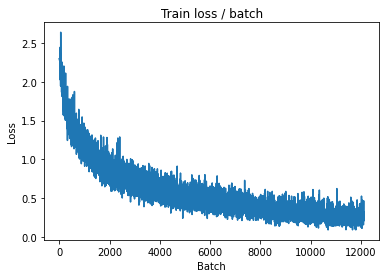

[TRAIN Batch 200/391]	Time 0.037s (0.048s)	Loss 0.2594 (0.2318)	Prec@1  89.8 ( 91.9)	Prec@5 100.0 ( 99.9)


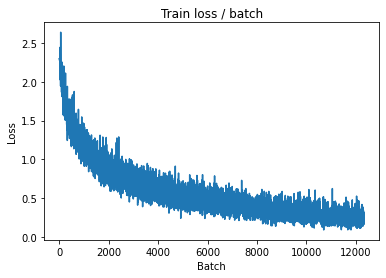


===============> Total time 18s	Avg loss 0.2421	Avg Prec@1 91.60 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.5936 (0.5936)	Prec@1  85.2 ( 85.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7260	Avg Prec@1 80.14 %	Avg Prec@5 98.68 %



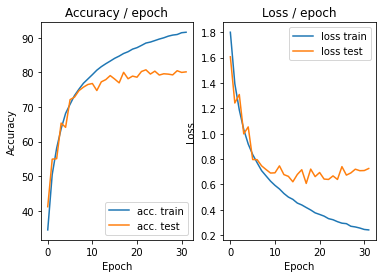

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.3009 (0.3009)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


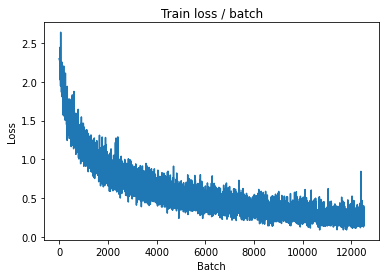

[TRAIN Batch 200/391]	Time 0.067s (0.048s)	Loss 0.2374 (0.2223)	Prec@1  91.4 ( 92.2)	Prec@5 100.0 ( 99.9)


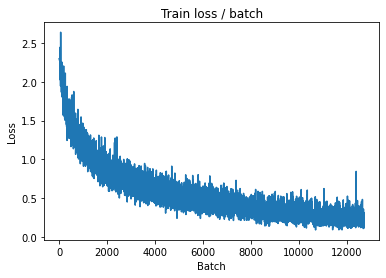


===============> Total time 18s	Avg loss 0.2395	Avg Prec@1 91.57 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.6334 (0.6334)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7078	Avg Prec@1 80.59 %	Avg Prec@5 98.69 %



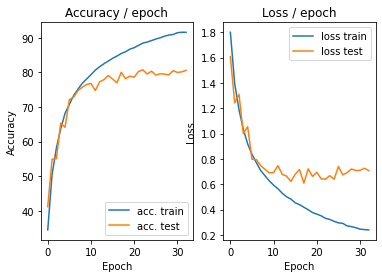

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.2854 (0.2854)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


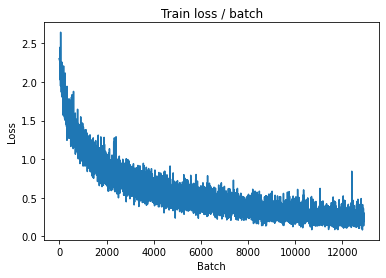

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.1574 (0.2234)	Prec@1  95.3 ( 92.2)	Prec@5 100.0 (100.0)


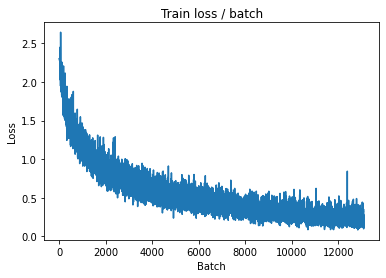


===============> Total time 18s	Avg loss 0.2319	Avg Prec@1 91.99 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.7491 (0.7491)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7792	Avg Prec@1 79.39 %	Avg Prec@5 98.58 %



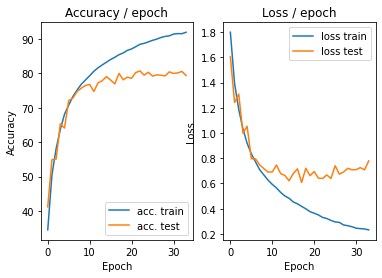

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.2869 (0.2869)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)


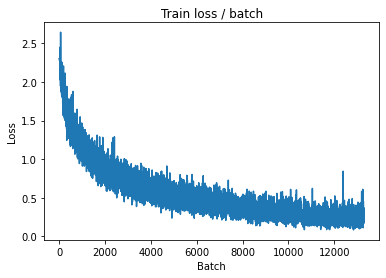

[TRAIN Batch 200/391]	Time 0.035s (0.047s)	Loss 0.1499 (0.2217)	Prec@1  95.3 ( 92.4)	Prec@5 100.0 ( 99.9)


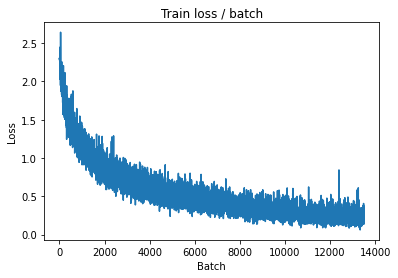


===============> Total time 18s	Avg loss 0.2260	Avg Prec@1 92.13 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.6564 (0.6564)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7228	Avg Prec@1 80.74 %	Avg Prec@5 98.85 %



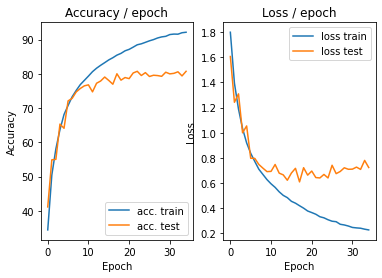

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.2297 (0.2297)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


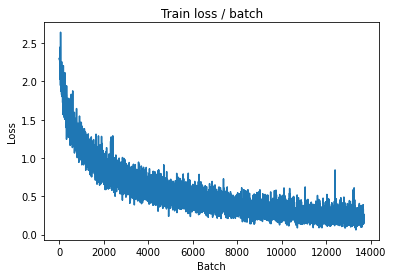

[TRAIN Batch 200/391]	Time 0.020s (0.048s)	Loss 0.2348 (0.2116)	Prec@1  89.8 ( 92.7)	Prec@5 100.0 ( 99.9)


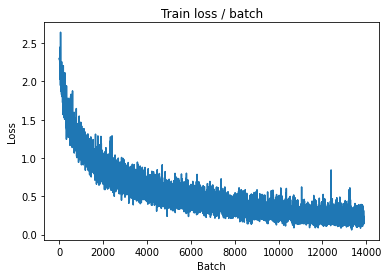


===============> Total time 18s	Avg loss 0.2182	Avg Prec@1 92.36 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.6895 (0.6895)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7564	Avg Prec@1 80.04 %	Avg Prec@5 98.72 %



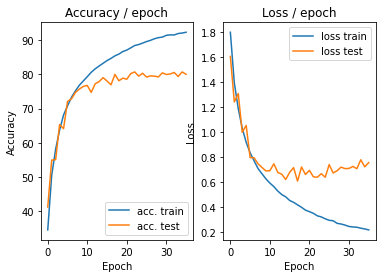

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.2712 (0.2712)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


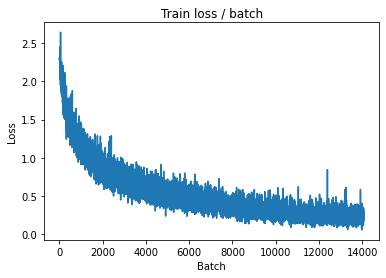

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.1811 (0.2064)	Prec@1  96.1 ( 92.8)	Prec@5 100.0 ( 99.9)


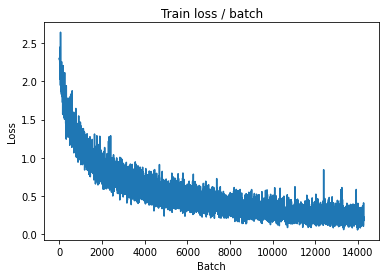


===============> Total time 18s	Avg loss 0.2163	Avg Prec@1 92.40 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.6149 (0.6149)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7384	Avg Prec@1 80.41 %	Avg Prec@5 98.64 %



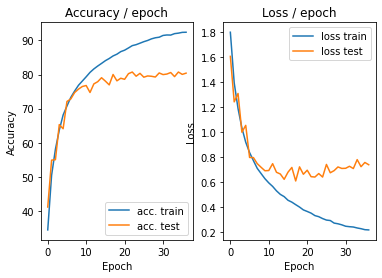

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.2403 (0.2403)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


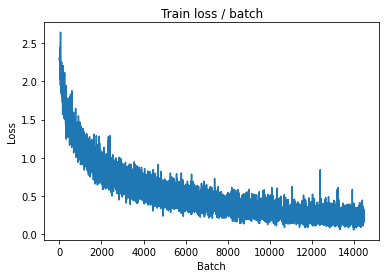

[TRAIN Batch 200/391]	Time 0.075s (0.049s)	Loss 0.1663 (0.1980)	Prec@1  95.3 ( 93.2)	Prec@5 100.0 ( 99.9)


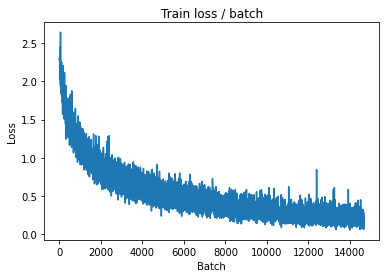


===============> Total time 18s	Avg loss 0.2010	Avg Prec@1 93.02 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.8450 (0.8450)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7710	Avg Prec@1 80.29 %	Avg Prec@5 98.39 %



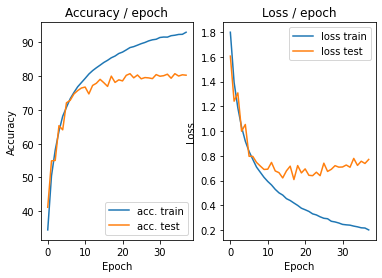

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.2473 (0.2473)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


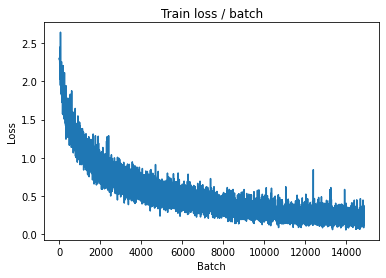

[TRAIN Batch 200/391]	Time 0.078s (0.048s)	Loss 0.1622 (0.1873)	Prec@1  96.1 ( 93.5)	Prec@5 100.0 ( 99.9)


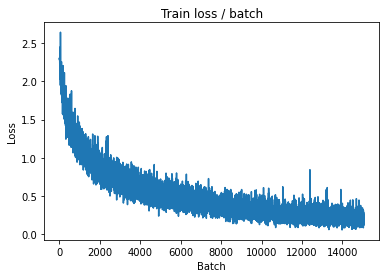


===============> Total time 18s	Avg loss 0.1927	Avg Prec@1 93.28 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.8416 (0.8416)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8427	Avg Prec@1 79.43 %	Avg Prec@5 98.50 %



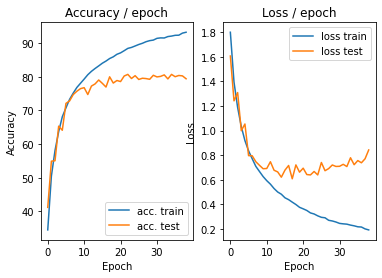

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.1567 (0.1567)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


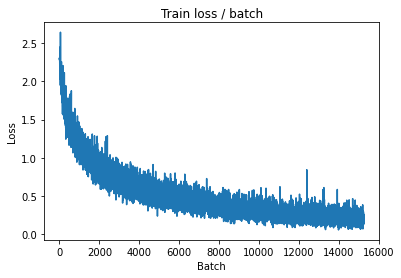

[TRAIN Batch 200/391]	Time 0.042s (0.047s)	Loss 0.1288 (0.1865)	Prec@1  96.1 ( 93.4)	Prec@5 100.0 ( 99.9)


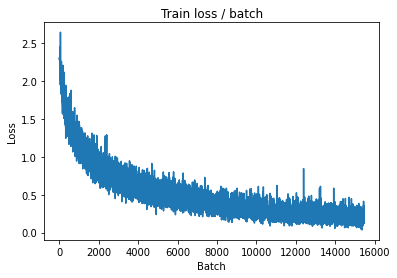


===============> Total time 18s	Avg loss 0.1947	Avg Prec@1 93.23 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.8193 (0.8193)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8296	Avg Prec@1 79.83 %	Avg Prec@5 98.71 %



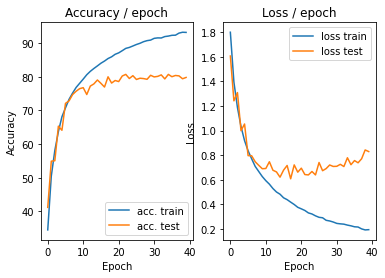

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.2405 (0.2405)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


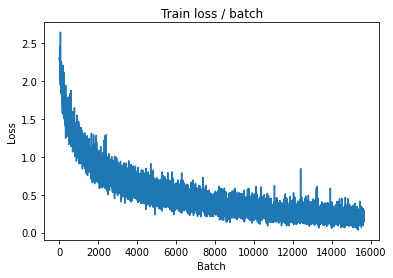

[TRAIN Batch 200/391]	Time 0.026s (0.048s)	Loss 0.2126 (0.1839)	Prec@1  90.6 ( 93.6)	Prec@5 100.0 ( 99.9)


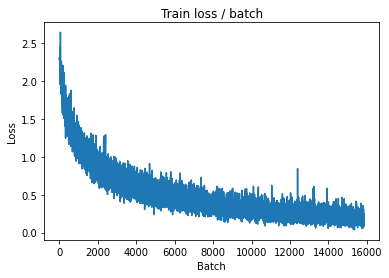


===============> Total time 18s	Avg loss 0.1870	Avg Prec@1 93.55 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.7614 (0.7614)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7877	Avg Prec@1 80.44 %	Avg Prec@5 98.75 %



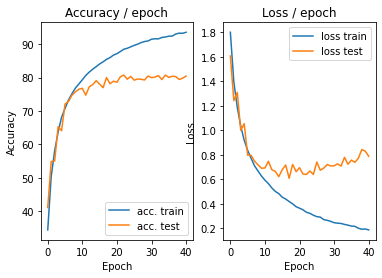

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.0905 (0.0905)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


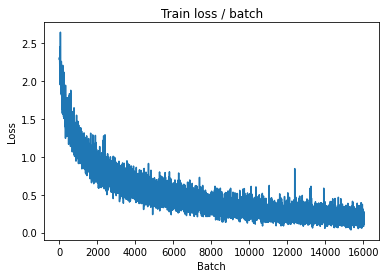

[TRAIN Batch 200/391]	Time 0.079s (0.052s)	Loss 0.2076 (0.1677)	Prec@1  94.5 ( 94.2)	Prec@5 100.0 (100.0)


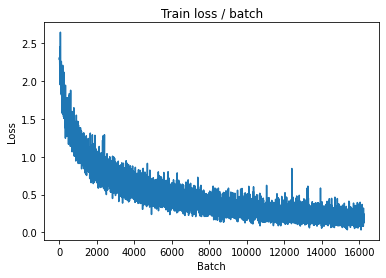


===============> Total time 19s	Avg loss 0.1819	Avg Prec@1 93.63 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.6279 (0.6279)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7898	Avg Prec@1 81.38 %	Avg Prec@5 98.61 %



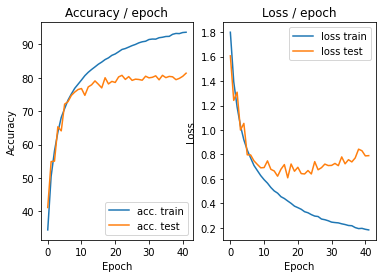

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.1958 (0.1958)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


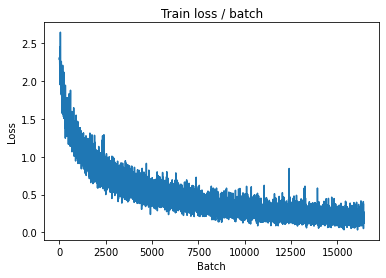

[TRAIN Batch 200/391]	Time 0.024s (0.049s)	Loss 0.0900 (0.1715)	Prec@1  97.7 ( 93.9)	Prec@5 100.0 (100.0)


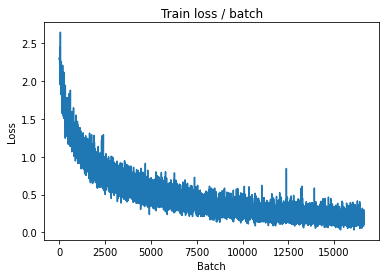


===============> Total time 18s	Avg loss 0.1794	Avg Prec@1 93.68 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.6985 (0.6985)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8101	Avg Prec@1 80.64 %	Avg Prec@5 98.55 %



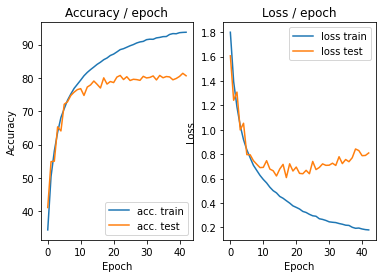

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2409 (0.2409)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


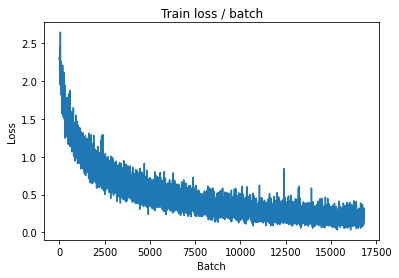

[TRAIN Batch 200/391]	Time 0.026s (0.049s)	Loss 0.2327 (0.1796)	Prec@1  91.4 ( 93.8)	Prec@5 100.0 ( 99.9)


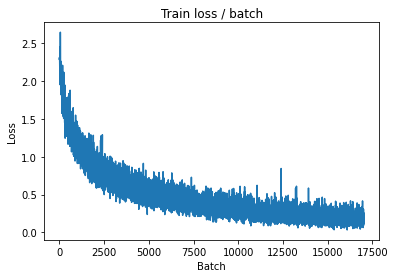


===============> Total time 18s	Avg loss 0.1827	Avg Prec@1 93.75 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.8644 (0.8644)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7694	Avg Prec@1 80.81 %	Avg Prec@5 98.72 %



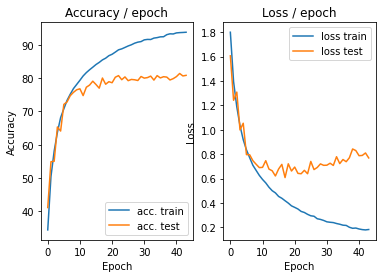

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.1448 (0.1448)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


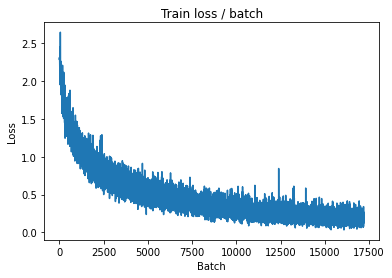

[TRAIN Batch 200/391]	Time 0.029s (0.049s)	Loss 0.1304 (0.1669)	Prec@1  93.8 ( 94.2)	Prec@5 100.0 (100.0)


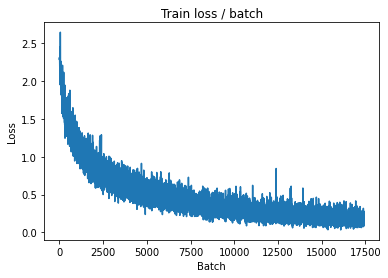


===============> Total time 18s	Avg loss 0.1737	Avg Prec@1 93.94 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.8580 (0.8580)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7983	Avg Prec@1 80.50 %	Avg Prec@5 98.84 %



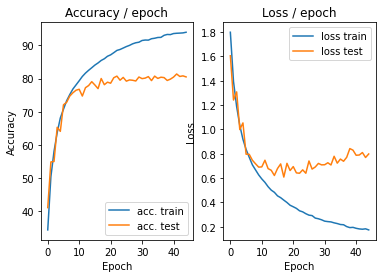

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.1367 (0.1367)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


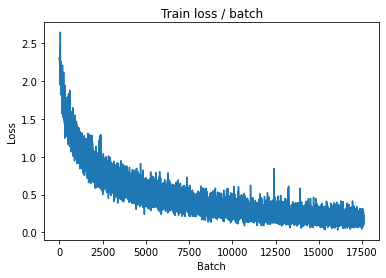

[TRAIN Batch 200/391]	Time 0.087s (0.049s)	Loss 0.1276 (0.1639)	Prec@1  94.5 ( 94.3)	Prec@5 100.0 (100.0)


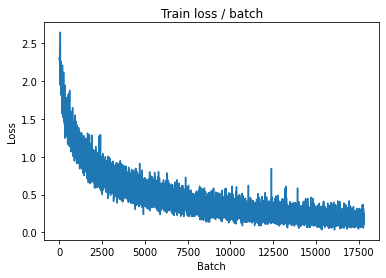


===============> Total time 18s	Avg loss 0.1683	Avg Prec@1 94.13 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.8514 (0.8514)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8411	Avg Prec@1 80.97 %	Avg Prec@5 98.69 %



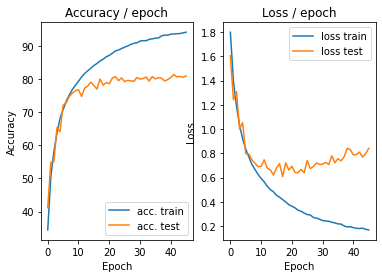

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.1020 (0.1020)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


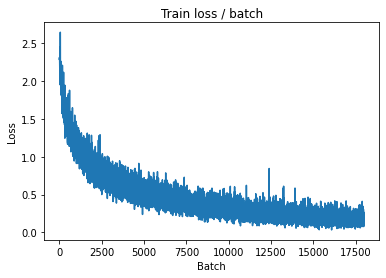

[TRAIN Batch 200/391]	Time 0.083s (0.049s)	Loss 0.2063 (0.1616)	Prec@1  93.0 ( 94.4)	Prec@5 100.0 (100.0)


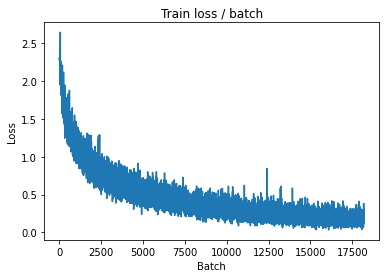


===============> Total time 19s	Avg loss 0.1680	Avg Prec@1 94.21 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.7618 (0.7618)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8065	Avg Prec@1 81.22 %	Avg Prec@5 98.81 %



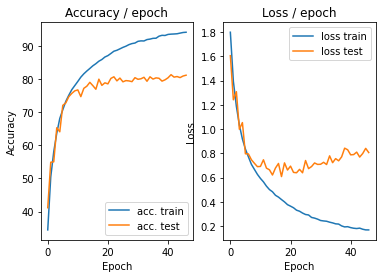

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2430 (0.2430)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


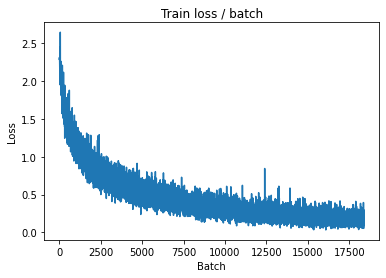

[TRAIN Batch 200/391]	Time 0.049s (0.049s)	Loss 0.1373 (0.1631)	Prec@1  95.3 ( 94.5)	Prec@5 100.0 ( 99.9)


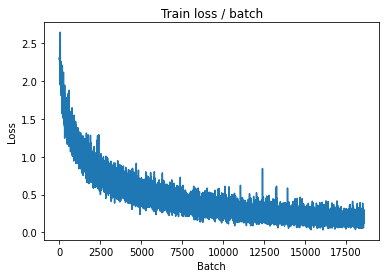


===============> Total time 19s	Avg loss 0.1686	Avg Prec@1 94.19 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.9634 (0.9634)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7768	Avg Prec@1 81.07 %	Avg Prec@5 98.53 %



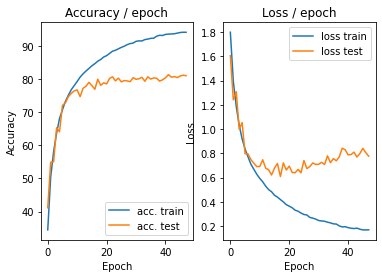

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.2334 (0.2334)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


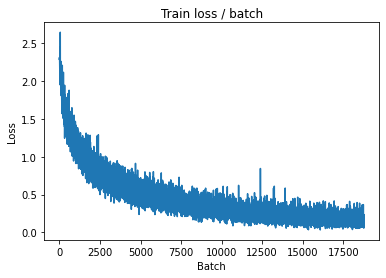

[TRAIN Batch 200/391]	Time 0.073s (0.048s)	Loss 0.1371 (0.1516)	Prec@1  95.3 ( 94.8)	Prec@5 100.0 (100.0)


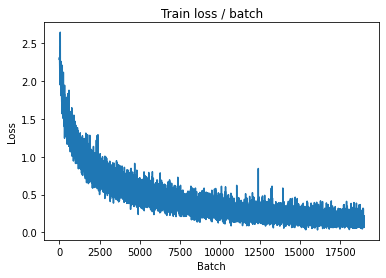


===============> Total time 19s	Avg loss 0.1557	Avg Prec@1 94.61 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.9870 (0.9870)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8576	Avg Prec@1 80.90 %	Avg Prec@5 98.56 %



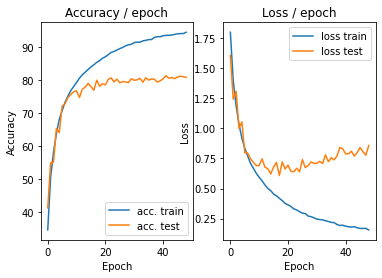

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.1769 (0.1769)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


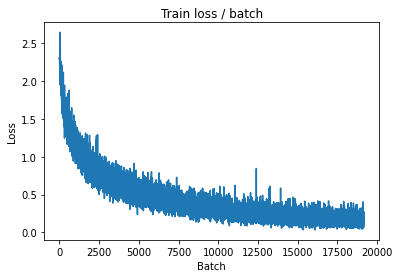

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 0.1493 (0.1587)	Prec@1  94.5 ( 94.6)	Prec@5 100.0 (100.0)


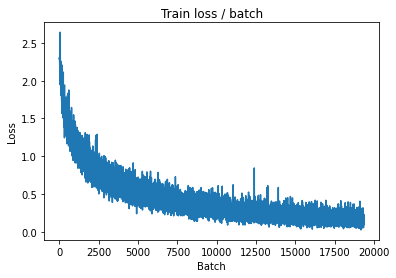


===============> Total time 18s	Avg loss 0.1635	Avg Prec@1 94.40 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 0.9715 (0.9715)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9919	Avg Prec@1 78.96 %	Avg Prec@5 98.41 %



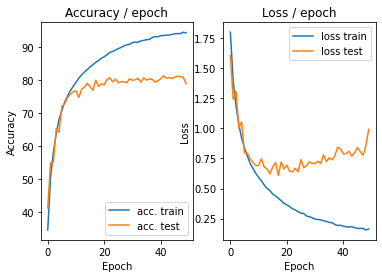

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.1353 (0.1353)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


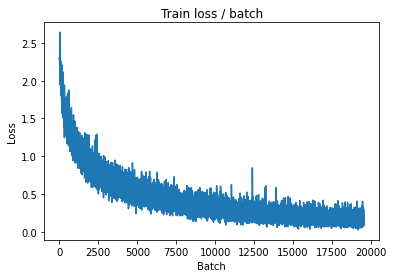

[TRAIN Batch 200/391]	Time 0.024s (0.049s)	Loss 0.1398 (0.1514)	Prec@1  94.5 ( 94.8)	Prec@5 100.0 (100.0)


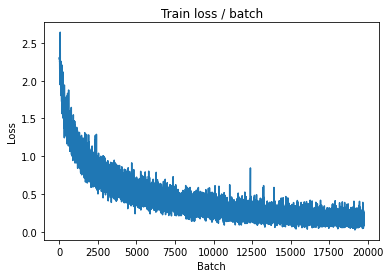


===============> Total time 18s	Avg loss 0.1597	Avg Prec@1 94.57 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.1627 (1.1627)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9863	Avg Prec@1 78.86 %	Avg Prec@5 98.44 %



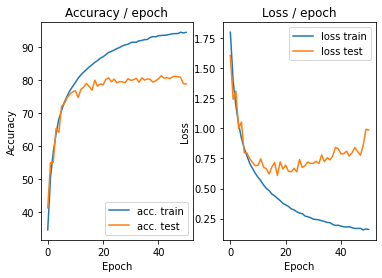

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.1950 (0.1950)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


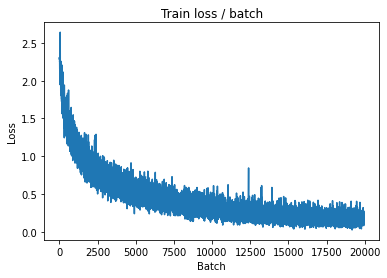

[TRAIN Batch 200/391]	Time 0.038s (0.048s)	Loss 0.0943 (0.1500)	Prec@1  96.1 ( 94.9)	Prec@5 100.0 ( 99.9)


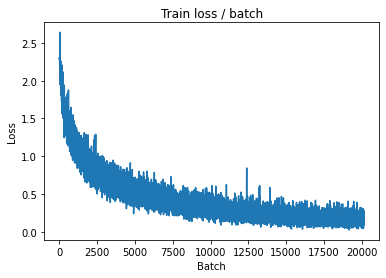


===============> Total time 18s	Avg loss 0.1540	Avg Prec@1 94.73 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.0224 (1.0224)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8336	Avg Prec@1 81.14 %	Avg Prec@5 98.86 %



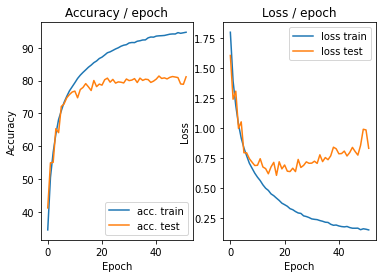

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.0564 (0.0564)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


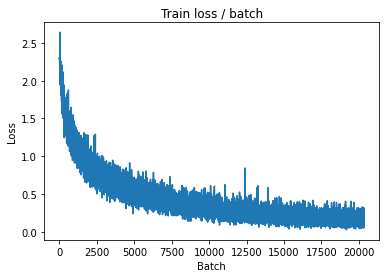

[TRAIN Batch 200/391]	Time 0.077s (0.049s)	Loss 0.0762 (0.1377)	Prec@1  98.4 ( 95.4)	Prec@5 100.0 (100.0)


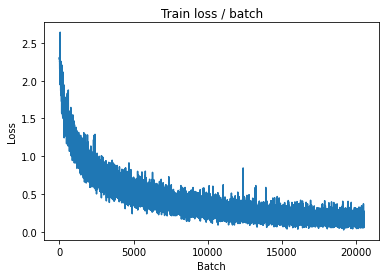


===============> Total time 19s	Avg loss 0.1523	Avg Prec@1 94.92 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 0.9169 (0.9169)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8378	Avg Prec@1 80.99 %	Avg Prec@5 98.70 %



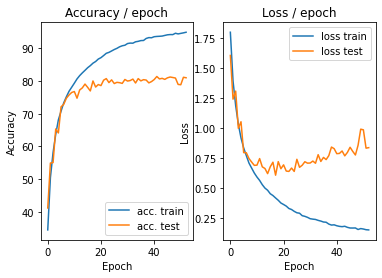

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.0660 (0.0660)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


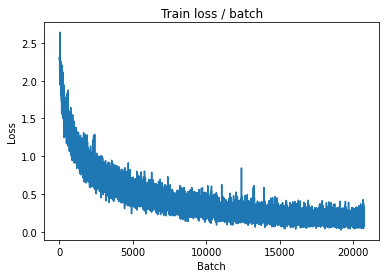

[TRAIN Batch 200/391]	Time 0.081s (0.050s)	Loss 0.1860 (0.1417)	Prec@1  94.5 ( 95.2)	Prec@5 100.0 (100.0)


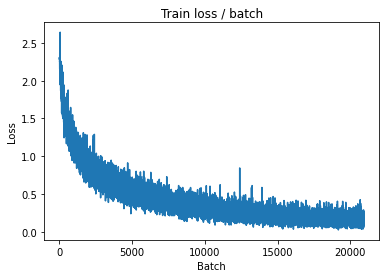


===============> Total time 18s	Avg loss 0.1461	Avg Prec@1 95.01 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 1.0704 (1.0704)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8517	Avg Prec@1 81.53 %	Avg Prec@5 98.58 %



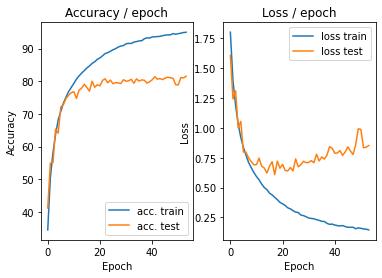

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.0790 (0.0790)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


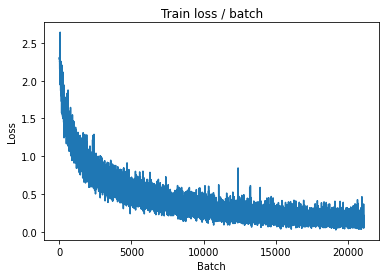

[TRAIN Batch 200/391]	Time 0.046s (0.048s)	Loss 0.1068 (0.1287)	Prec@1  95.3 ( 95.6)	Prec@5 100.0 (100.0)


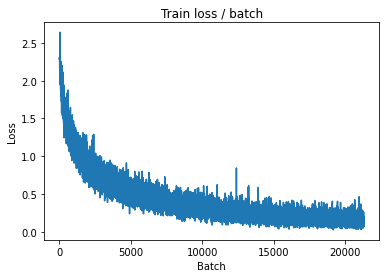


===============> Total time 18s	Avg loss 0.1423	Avg Prec@1 95.19 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.9993 (0.9993)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8604	Avg Prec@1 80.83 %	Avg Prec@5 98.62 %



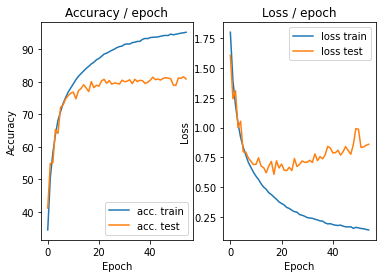

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.1701 (0.1701)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


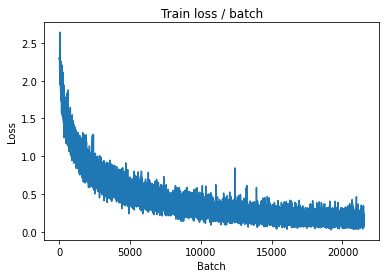

[TRAIN Batch 200/391]	Time 0.085s (0.049s)	Loss 0.2779 (0.1442)	Prec@1  93.0 ( 95.1)	Prec@5 100.0 (100.0)


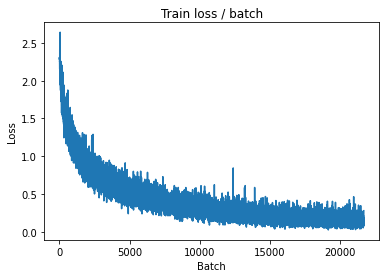


===============> Total time 18s	Avg loss 0.1465	Avg Prec@1 94.97 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.1181 (1.1181)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8357	Avg Prec@1 80.97 %	Avg Prec@5 98.66 %



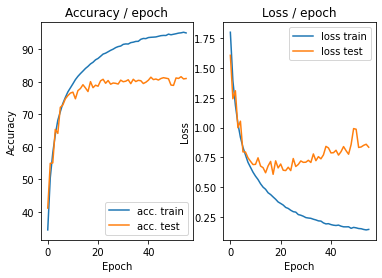

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.0881 (0.0881)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


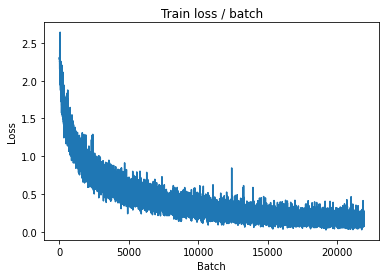

[TRAIN Batch 200/391]	Time 0.055s (0.047s)	Loss 0.1356 (0.1404)	Prec@1  96.1 ( 95.2)	Prec@5 100.0 (100.0)


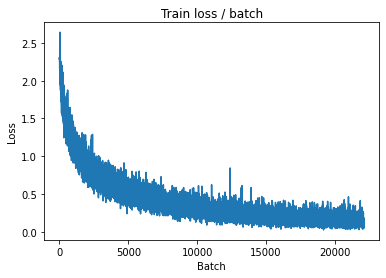


===============> Total time 18s	Avg loss 0.1436	Avg Prec@1 95.05 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 1.2685 (1.2685)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8755	Avg Prec@1 81.31 %	Avg Prec@5 98.63 %



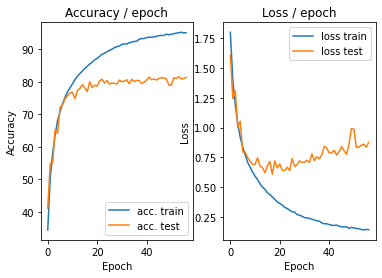

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.0496 (0.0496)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


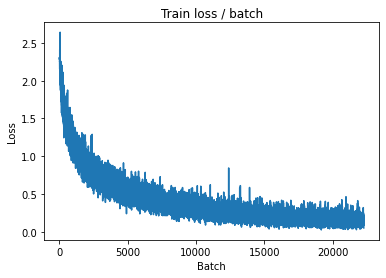

[TRAIN Batch 200/391]	Time 0.084s (0.049s)	Loss 0.1476 (0.1346)	Prec@1  94.5 ( 95.5)	Prec@5 100.0 (100.0)


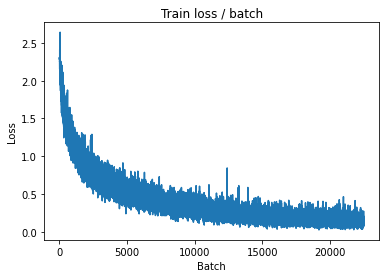


===============> Total time 18s	Avg loss 0.1436	Avg Prec@1 95.13 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 1.2957 (1.2957)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9106	Avg Prec@1 80.38 %	Avg Prec@5 98.45 %



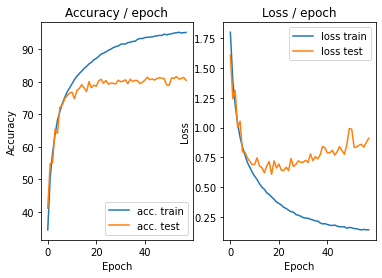

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.1599 (0.1599)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


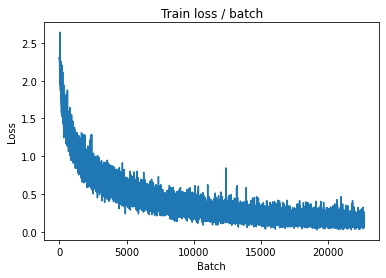

[TRAIN Batch 200/391]	Time 0.034s (0.047s)	Loss 0.1909 (0.1357)	Prec@1  93.8 ( 95.4)	Prec@5 100.0 (100.0)


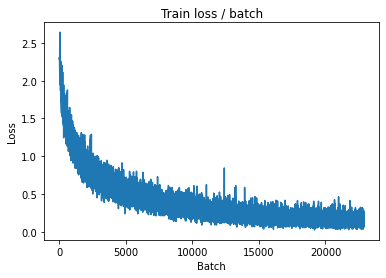


===============> Total time 18s	Avg loss 0.1422	Avg Prec@1 95.21 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 1.4451 (1.4451)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9019	Avg Prec@1 80.77 %	Avg Prec@5 98.60 %



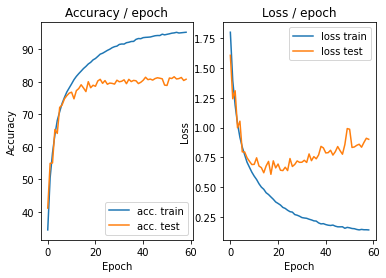

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0548 (0.0548)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


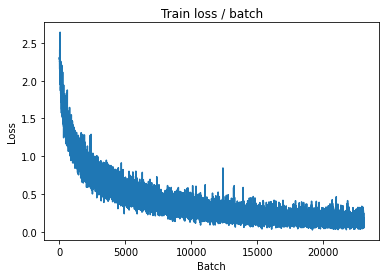

[TRAIN Batch 200/391]	Time 0.044s (0.048s)	Loss 0.2013 (0.1458)	Prec@1  94.5 ( 95.0)	Prec@5 100.0 ( 99.9)


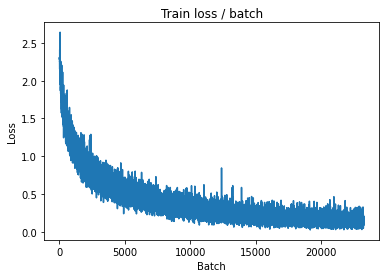


===============> Total time 18s	Avg loss 0.1446	Avg Prec@1 95.08 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 1.0473 (1.0473)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9700	Avg Prec@1 80.10 %	Avg Prec@5 98.52 %



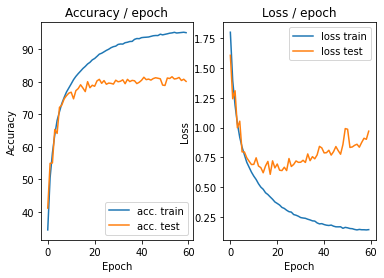

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.0784 (0.0784)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


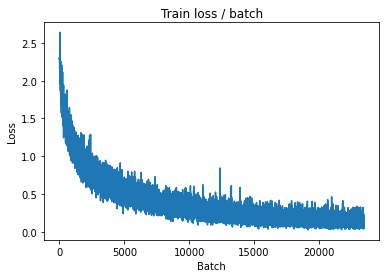

[TRAIN Batch 200/391]	Time 0.050s (0.050s)	Loss 0.0531 (0.1373)	Prec@1  99.2 ( 95.4)	Prec@5 100.0 (100.0)


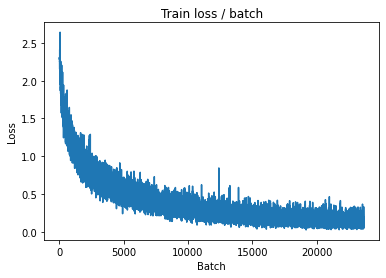


===============> Total time 18s	Avg loss 0.1399	Avg Prec@1 95.28 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.2505 (1.2505)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8838	Avg Prec@1 80.91 %	Avg Prec@5 98.66 %



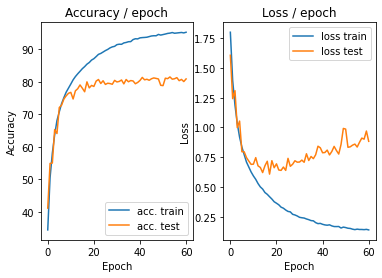

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.1663 (0.1663)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


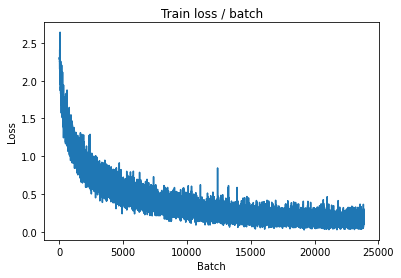

[TRAIN Batch 200/391]	Time 0.026s (0.049s)	Loss 0.1297 (0.1283)	Prec@1  95.3 ( 95.6)	Prec@5 100.0 (100.0)


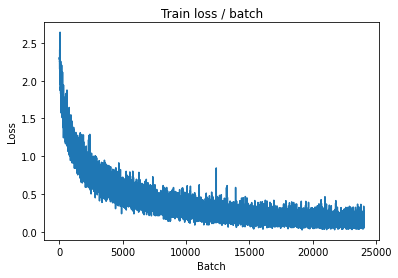


===============> Total time 18s	Avg loss 0.1342	Avg Prec@1 95.50 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.0523 (1.0523)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8709	Avg Prec@1 81.04 %	Avg Prec@5 98.74 %



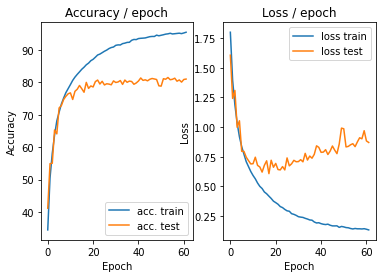

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.1056 (0.1056)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


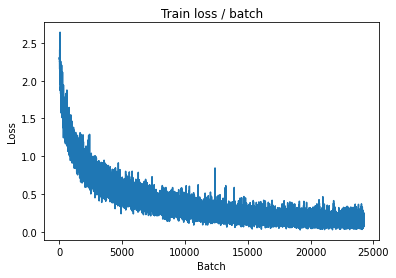

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.1785 (0.1328)	Prec@1  95.3 ( 95.6)	Prec@5 100.0 (100.0)


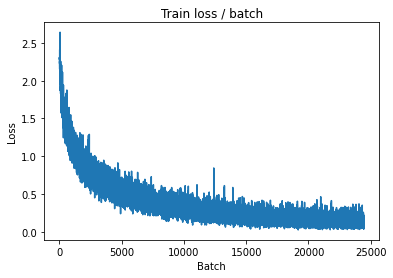


===============> Total time 18s	Avg loss 0.1364	Avg Prec@1 95.51 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 1.0835 (1.0835)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8794	Avg Prec@1 81.00 %	Avg Prec@5 98.70 %



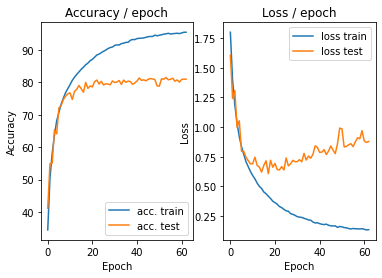

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 0.0502 (0.0502)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


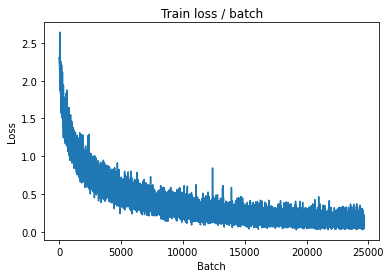

[TRAIN Batch 200/391]	Time 0.024s (0.049s)	Loss 0.1053 (0.1239)	Prec@1  94.5 ( 95.8)	Prec@5 100.0 (100.0)


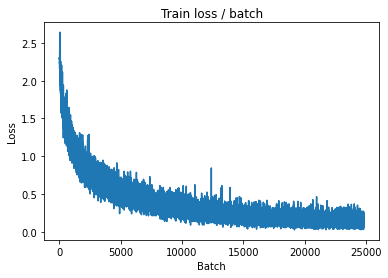


===============> Total time 18s	Avg loss 0.1301	Avg Prec@1 95.56 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 1.1987 (1.1987)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9310	Avg Prec@1 80.94 %	Avg Prec@5 98.67 %



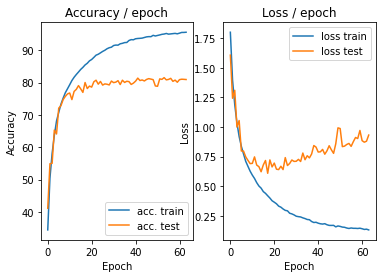

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.2253 (0.2253)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


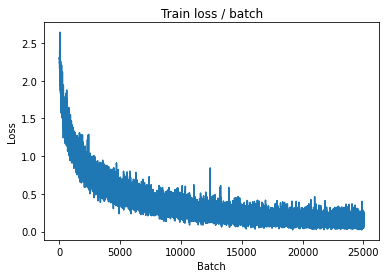

[TRAIN Batch 200/391]	Time 0.068s (0.048s)	Loss 0.1270 (0.1221)	Prec@1  94.5 ( 95.8)	Prec@5 100.0 (100.0)


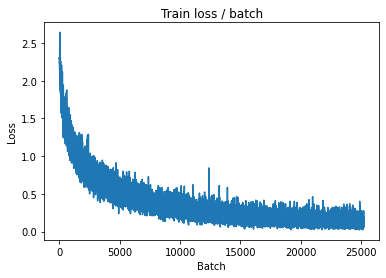


===============> Total time 18s	Avg loss 0.1305	Avg Prec@1 95.57 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.0264 (1.0264)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9336	Avg Prec@1 80.88 %	Avg Prec@5 98.68 %



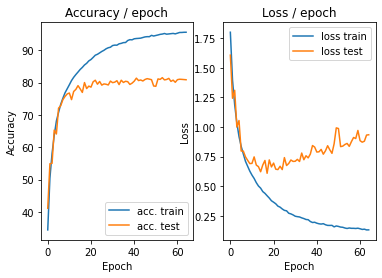

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.1467 (0.1467)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


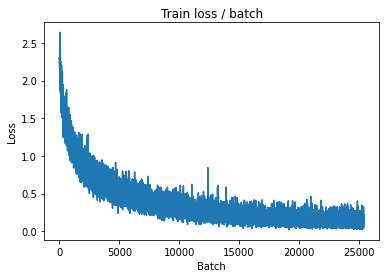

[TRAIN Batch 200/391]	Time 0.032s (0.048s)	Loss 0.2102 (0.1150)	Prec@1  94.5 ( 96.1)	Prec@5 100.0 (100.0)


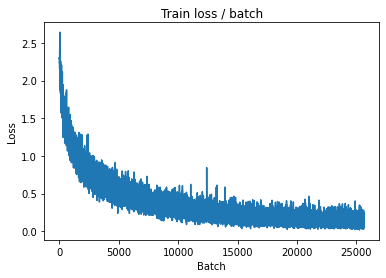


===============> Total time 18s	Avg loss 0.1240	Avg Prec@1 95.83 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.8543 (0.8543)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.9860	Avg Prec@1 80.22 %	Avg Prec@5 98.62 %



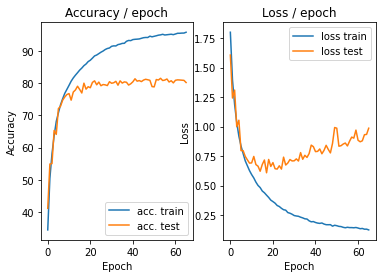

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.317s (0.317s)	Loss 0.0750 (0.0750)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


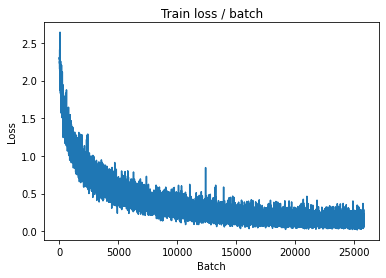

[TRAIN Batch 200/391]	Time 0.084s (0.049s)	Loss 0.2128 (0.1292)	Prec@1  91.4 ( 95.5)	Prec@5 100.0 (100.0)


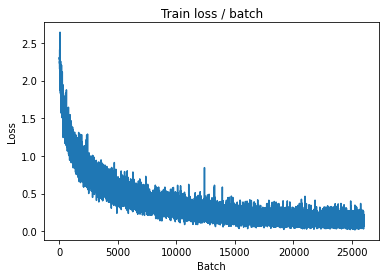


===============> Total time 19s	Avg loss 0.1282	Avg Prec@1 95.67 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.225s (0.225s)	Loss 0.8716 (0.8716)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.0284	Avg Prec@1 79.07 %	Avg Prec@5 98.35 %



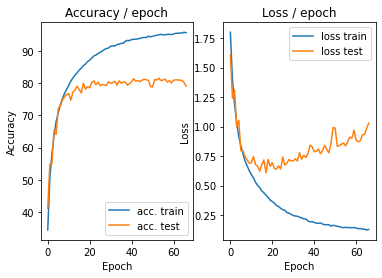

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.1740 (0.1740)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


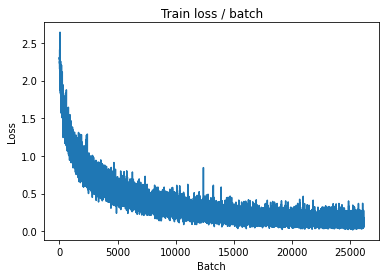

[TRAIN Batch 200/391]	Time 0.046s (0.049s)	Loss 0.0527 (0.1212)	Prec@1  97.7 ( 95.7)	Prec@5 100.0 (100.0)


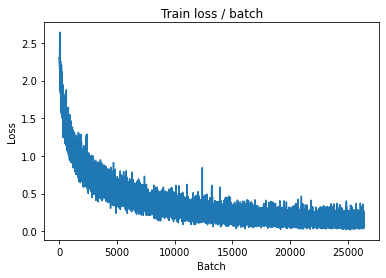


===============> Total time 19s	Avg loss 0.1248	Avg Prec@1 95.69 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 0.8486 (0.8486)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9236	Avg Prec@1 81.48 %	Avg Prec@5 98.81 %



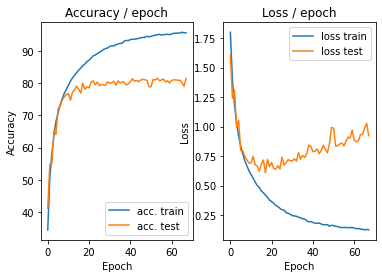

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.1530 (0.1530)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


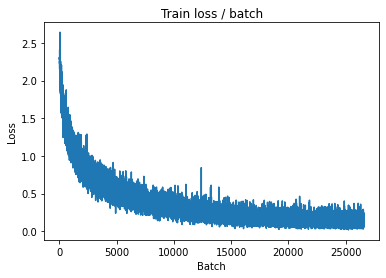

[TRAIN Batch 200/391]	Time 0.034s (0.050s)	Loss 0.1282 (0.1184)	Prec@1  95.3 ( 96.0)	Prec@5 100.0 (100.0)


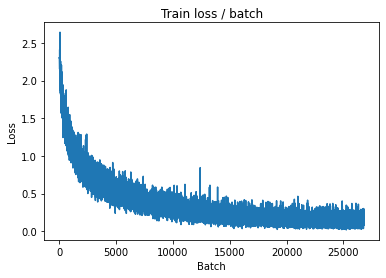


===============> Total time 19s	Avg loss 0.1197	Avg Prec@1 96.00 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 1.0071 (1.0071)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9624	Avg Prec@1 80.74 %	Avg Prec@5 98.54 %



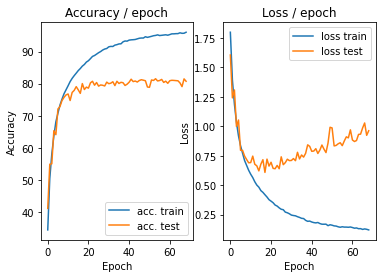

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 0.1243 (0.1243)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


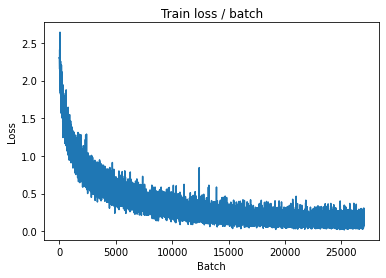

[TRAIN Batch 200/391]	Time 0.054s (0.050s)	Loss 0.2836 (0.1184)	Prec@1  93.0 ( 96.1)	Prec@5  99.2 (100.0)


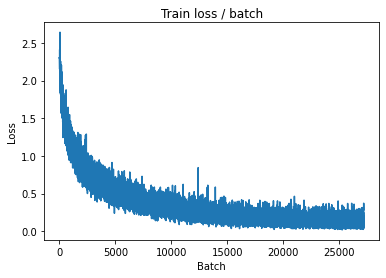


===============> Total time 19s	Avg loss 0.1211	Avg Prec@1 95.92 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 1.1302 (1.1302)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9248	Avg Prec@1 81.29 %	Avg Prec@5 98.80 %



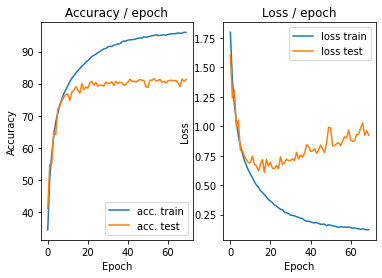

=== EPOCH 71 =====

[TRAIN Batch 000/391]	Time 0.329s (0.329s)	Loss 0.0797 (0.0797)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


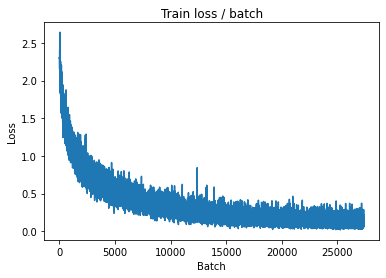

[TRAIN Batch 200/391]	Time 0.025s (0.047s)	Loss 0.1324 (0.1133)	Prec@1  95.3 ( 96.1)	Prec@5 100.0 (100.0)


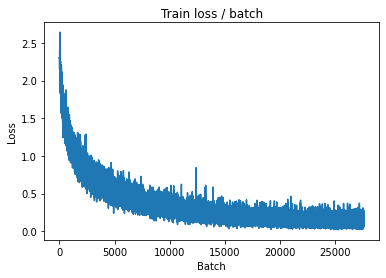


===============> Total time 18s	Avg loss 0.1211	Avg Prec@1 95.92 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 1.1538 (1.1538)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9186	Avg Prec@1 81.80 %	Avg Prec@5 98.68 %



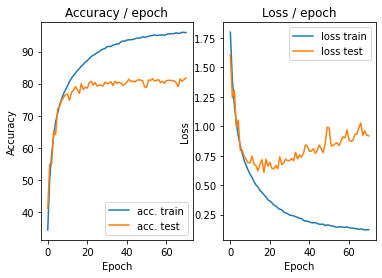

=== EPOCH 72 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.0513 (0.0513)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


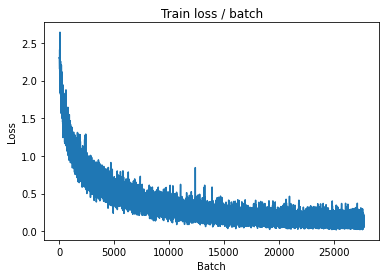

[TRAIN Batch 200/391]	Time 0.030s (0.048s)	Loss 0.0903 (0.1082)	Prec@1  97.7 ( 96.3)	Prec@5 100.0 (100.0)


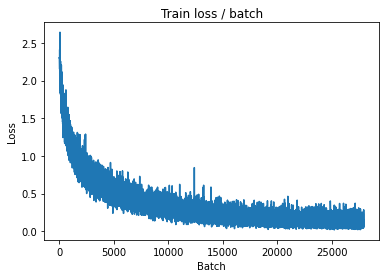


===============> Total time 18s	Avg loss 0.1179	Avg Prec@1 96.13 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 1.0783 (1.0783)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9248	Avg Prec@1 81.78 %	Avg Prec@5 98.77 %



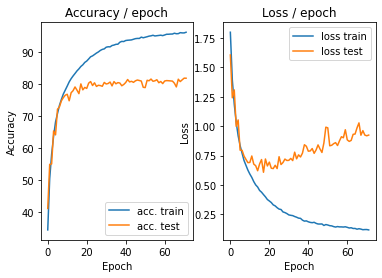

=== EPOCH 73 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.0515 (0.0515)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


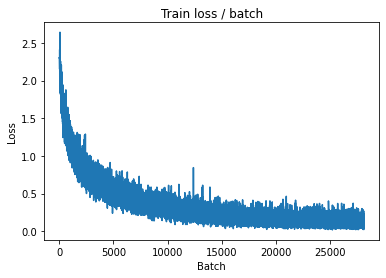

[TRAIN Batch 200/391]	Time 0.016s (0.049s)	Loss 0.0533 (0.1187)	Prec@1  97.7 ( 96.0)	Prec@5 100.0 (100.0)


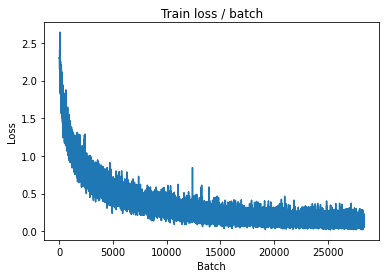


===============> Total time 19s	Avg loss 0.1169	Avg Prec@1 96.10 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.9502 (0.9502)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0055	Avg Prec@1 80.78 %	Avg Prec@5 98.60 %



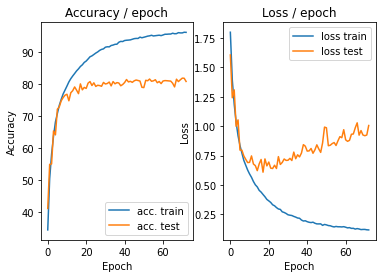

=== EPOCH 74 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.0906 (0.0906)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


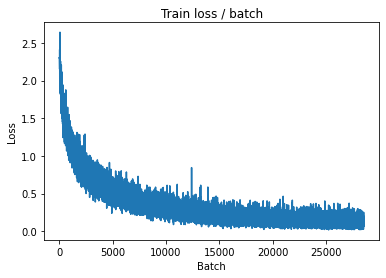

[TRAIN Batch 200/391]	Time 0.074s (0.052s)	Loss 0.1806 (0.1100)	Prec@1  95.3 ( 96.3)	Prec@5 100.0 (100.0)


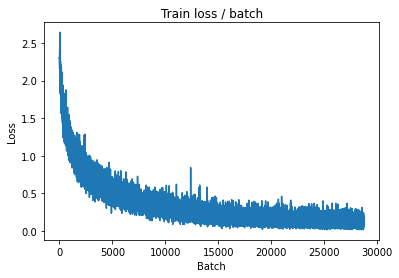


===============> Total time 19s	Avg loss 0.1135	Avg Prec@1 96.15 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.9358 (0.9358)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9699	Avg Prec@1 80.82 %	Avg Prec@5 98.45 %



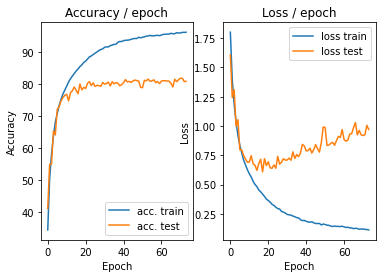

=== EPOCH 75 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.1120 (0.1120)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


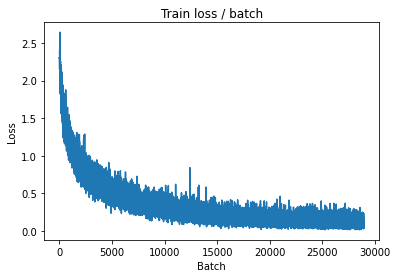

[TRAIN Batch 200/391]	Time 0.059s (0.048s)	Loss 0.0922 (0.1012)	Prec@1  94.5 ( 96.6)	Prec@5 100.0 (100.0)


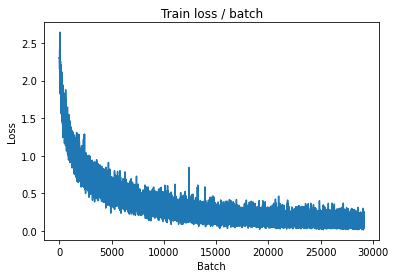


===============> Total time 18s	Avg loss 0.1133	Avg Prec@1 96.16 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.9045 (0.9045)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9601	Avg Prec@1 80.21 %	Avg Prec@5 98.65 %



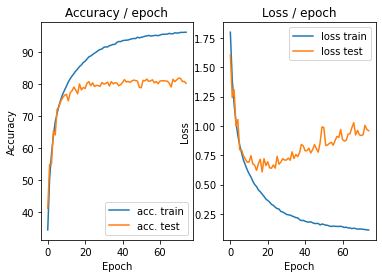

=== EPOCH 76 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.0627 (0.0627)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


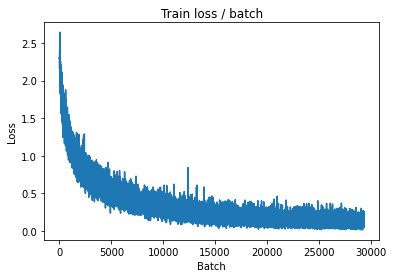

[TRAIN Batch 200/391]	Time 0.069s (0.048s)	Loss 0.1898 (0.1153)	Prec@1  95.3 ( 96.2)	Prec@5 100.0 (100.0)


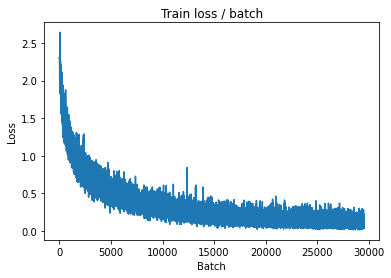


===============> Total time 18s	Avg loss 0.1180	Avg Prec@1 96.05 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.8835 (0.8835)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9857	Avg Prec@1 80.80 %	Avg Prec@5 98.54 %



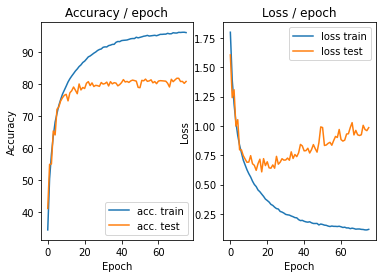

=== EPOCH 77 =====

[TRAIN Batch 000/391]	Time 0.312s (0.312s)	Loss 0.1865 (0.1865)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


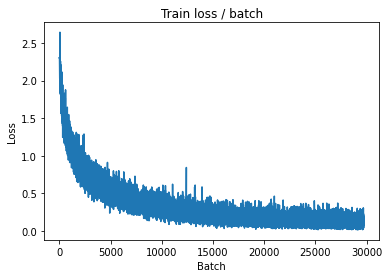

[TRAIN Batch 200/391]	Time 0.101s (0.049s)	Loss 0.1359 (0.1050)	Prec@1  96.1 ( 96.5)	Prec@5 100.0 (100.0)


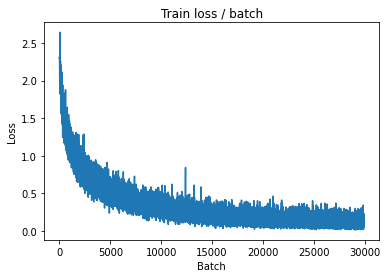


===============> Total time 19s	Avg loss 0.1115	Avg Prec@1 96.32 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 1.0578 (1.0578)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0040	Avg Prec@1 80.99 %	Avg Prec@5 98.66 %



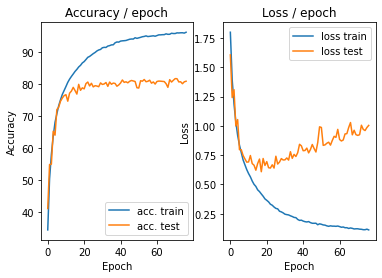

=== EPOCH 78 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.2311 (0.2311)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


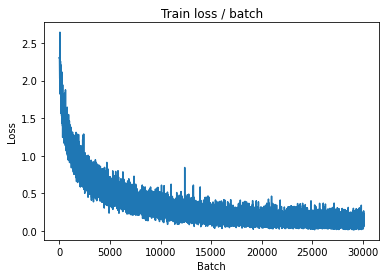

[TRAIN Batch 200/391]	Time 0.069s (0.052s)	Loss 0.1875 (0.1130)	Prec@1  94.5 ( 96.2)	Prec@5 100.0 (100.0)


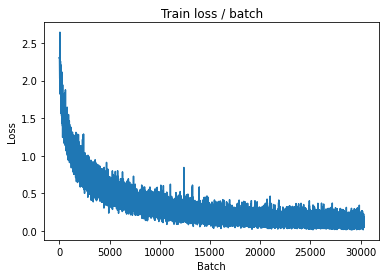


===============> Total time 19s	Avg loss 0.1186	Avg Prec@1 96.03 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.9424 (0.9424)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0155	Avg Prec@1 80.47 %	Avg Prec@5 98.78 %



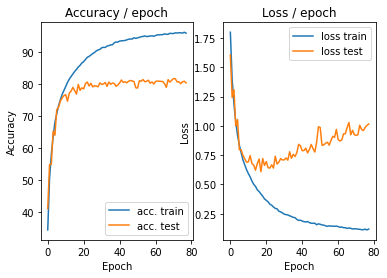

=== EPOCH 79 =====

[TRAIN Batch 000/391]	Time 0.281s (0.281s)	Loss 0.0553 (0.0553)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


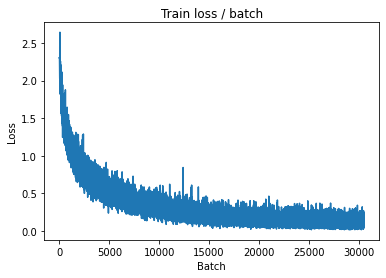

[TRAIN Batch 200/391]	Time 0.055s (0.049s)	Loss 0.0891 (0.1220)	Prec@1  95.3 ( 96.0)	Prec@5 100.0 (100.0)


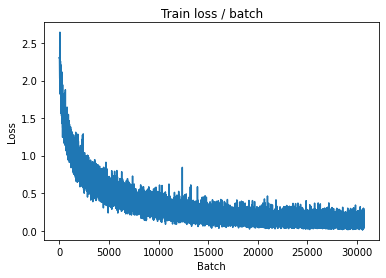


===============> Total time 19s	Avg loss 0.1236	Avg Prec@1 95.91 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 1.0834 (1.0834)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.0233	Avg Prec@1 80.81 %	Avg Prec@5 98.57 %



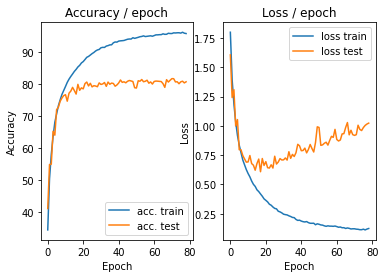

=== EPOCH 80 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.1567 (0.1567)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


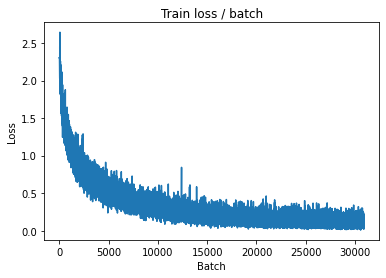

[TRAIN Batch 200/391]	Time 0.020s (0.051s)	Loss 0.1431 (0.1114)	Prec@1  94.5 ( 96.3)	Prec@5 100.0 (100.0)


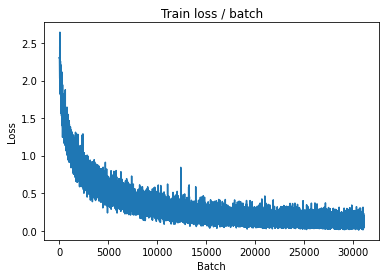


===============> Total time 19s	Avg loss 0.1161	Avg Prec@1 96.11 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.239s (0.239s)	Loss 1.0910 (1.0910)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9747	Avg Prec@1 81.05 %	Avg Prec@5 98.37 %



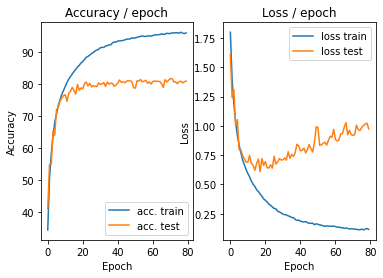

=== EPOCH 81 =====

[TRAIN Batch 000/391]	Time 0.287s (0.287s)	Loss 0.1620 (0.1620)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


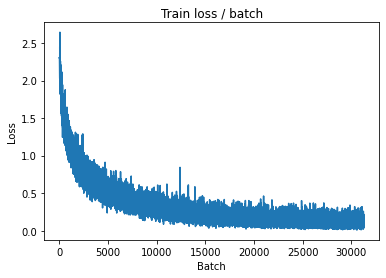

[TRAIN Batch 200/391]	Time 0.020s (0.049s)	Loss 0.1775 (0.1037)	Prec@1  95.3 ( 96.4)	Prec@5 100.0 (100.0)


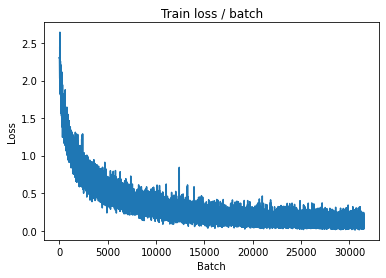


===============> Total time 19s	Avg loss 0.1041	Avg Prec@1 96.42 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.225s (0.225s)	Loss 1.0891 (1.0891)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9867	Avg Prec@1 81.33 %	Avg Prec@5 98.60 %



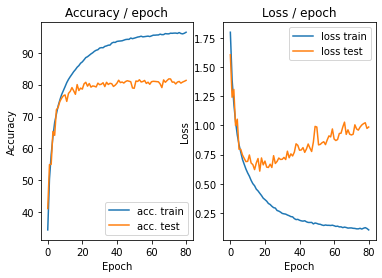

=== EPOCH 82 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.1163 (0.1163)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


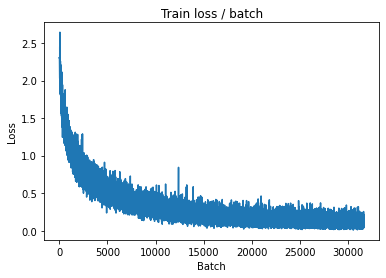

[TRAIN Batch 200/391]	Time 0.052s (0.049s)	Loss 0.1542 (0.1037)	Prec@1  96.1 ( 96.6)	Prec@5  99.2 (100.0)


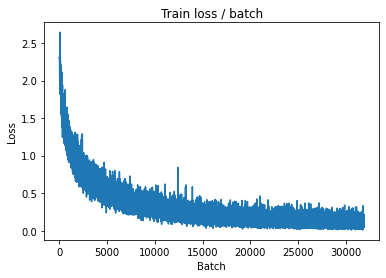


===============> Total time 18s	Avg loss 0.1086	Avg Prec@1 96.45 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 1.0083 (1.0083)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.0163	Avg Prec@1 80.75 %	Avg Prec@5 98.61 %



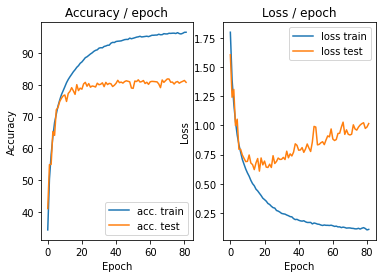

=== EPOCH 83 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.0753 (0.0753)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


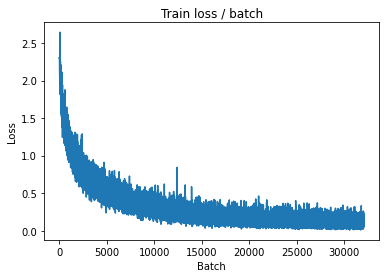

[TRAIN Batch 200/391]	Time 0.069s (0.049s)	Loss 0.1064 (0.1070)	Prec@1  95.3 ( 96.5)	Prec@5 100.0 (100.0)


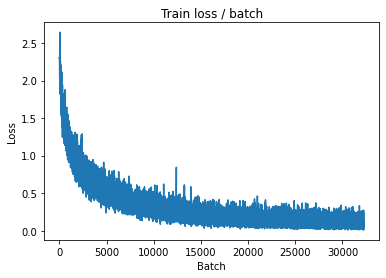


===============> Total time 19s	Avg loss 0.1052	Avg Prec@1 96.52 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 1.2513 (1.2513)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0958	Avg Prec@1 79.16 %	Avg Prec@5 98.46 %



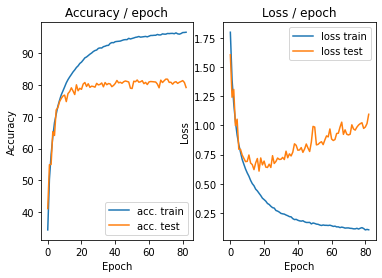

=== EPOCH 84 =====

[TRAIN Batch 000/391]	Time 0.298s (0.298s)	Loss 0.0798 (0.0798)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


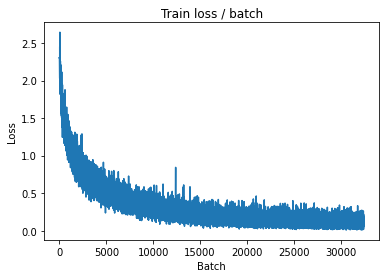

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.0519 (0.1064)	Prec@1  97.7 ( 96.6)	Prec@5 100.0 (100.0)


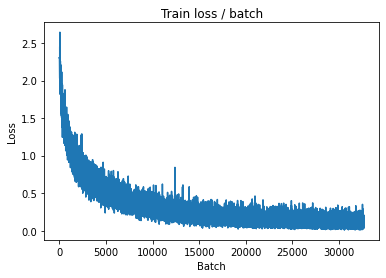


===============> Total time 18s	Avg loss 0.1081	Avg Prec@1 96.51 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 1.1065 (1.1065)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0160	Avg Prec@1 81.17 %	Avg Prec@5 98.60 %



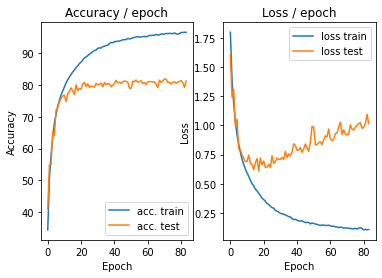

=== EPOCH 85 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.0384 (0.0384)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


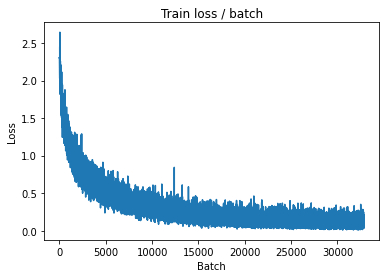

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.1099 (0.1030)	Prec@1  96.9 ( 96.7)	Prec@5 100.0 (100.0)


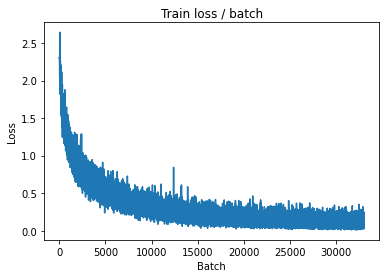


===============> Total time 18s	Avg loss 0.1050	Avg Prec@1 96.56 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 1.2185 (1.2185)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.0614	Avg Prec@1 80.48 %	Avg Prec@5 98.34 %



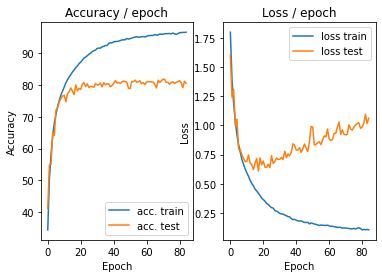

=== EPOCH 86 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 0.1084 (0.1084)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


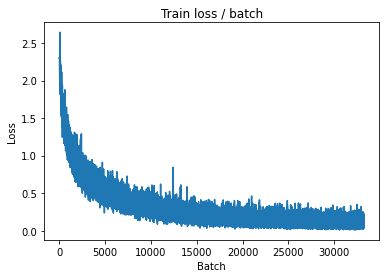

[TRAIN Batch 200/391]	Time 0.019s (0.051s)	Loss 0.0747 (0.1073)	Prec@1  97.7 ( 96.6)	Prec@5 100.0 (100.0)


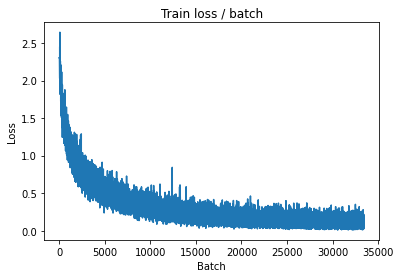


===============> Total time 19s	Avg loss 0.1054	Avg Prec@1 96.59 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 1.4870 (1.4870)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0404	Avg Prec@1 81.28 %	Avg Prec@5 98.49 %



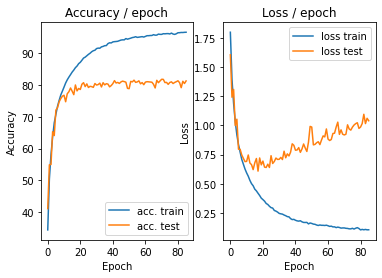

=== EPOCH 87 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.0402 (0.0402)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


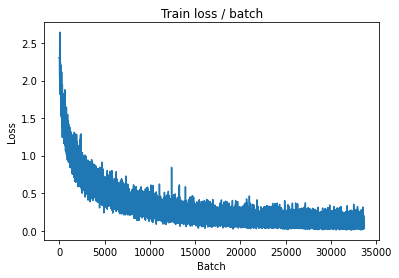

[TRAIN Batch 200/391]	Time 0.025s (0.049s)	Loss 0.1522 (0.1092)	Prec@1  92.2 ( 96.4)	Prec@5 100.0 (100.0)


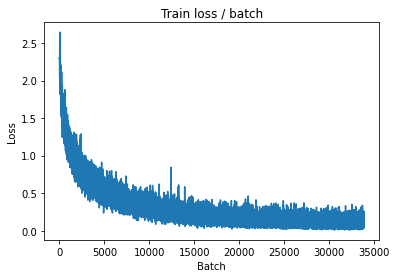


===============> Total time 18s	Avg loss 0.1099	Avg Prec@1 96.33 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 1.2089 (1.2089)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.0827	Avg Prec@1 80.32 %	Avg Prec@5 98.47 %



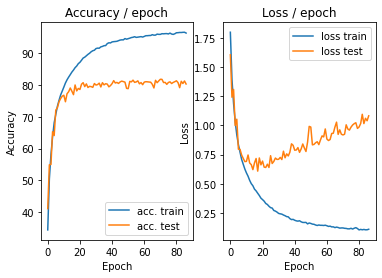

=== EPOCH 88 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.0874 (0.0874)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


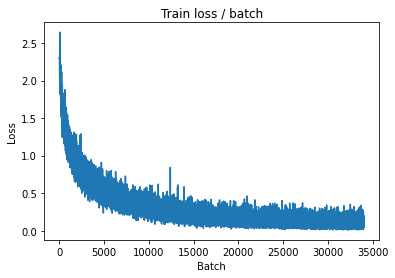

[TRAIN Batch 200/391]	Time 0.088s (0.050s)	Loss 0.2230 (0.1029)	Prec@1  94.5 ( 96.6)	Prec@5 100.0 (100.0)


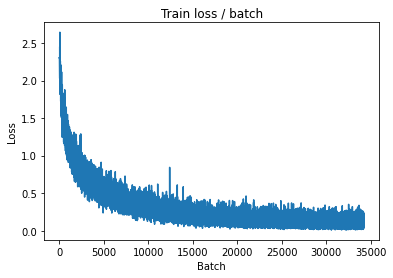


===============> Total time 19s	Avg loss 0.1089	Avg Prec@1 96.44 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.237s (0.237s)	Loss 1.2597 (1.2597)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0370	Avg Prec@1 81.02 %	Avg Prec@5 98.45 %



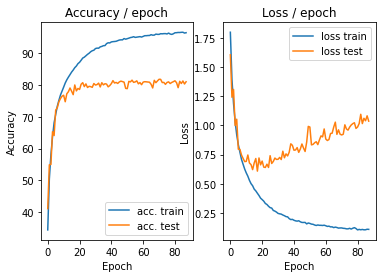

=== EPOCH 89 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.1361 (0.1361)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


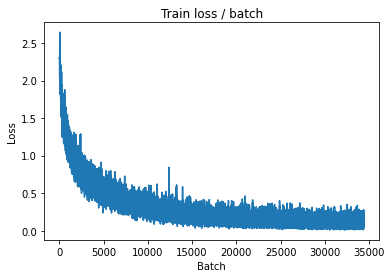

[TRAIN Batch 200/391]	Time 0.029s (0.048s)	Loss 0.2394 (0.0971)	Prec@1  93.8 ( 96.8)	Prec@5  99.2 (100.0)


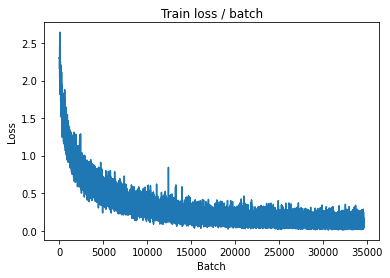


===============> Total time 18s	Avg loss 0.1022	Avg Prec@1 96.60 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 1.3038 (1.3038)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1218	Avg Prec@1 80.60 %	Avg Prec@5 98.49 %



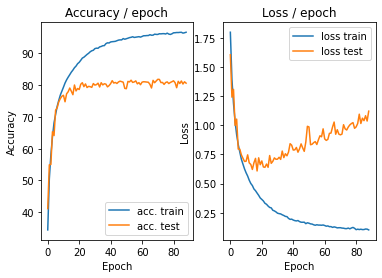

=== EPOCH 90 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 0.0773 (0.0773)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


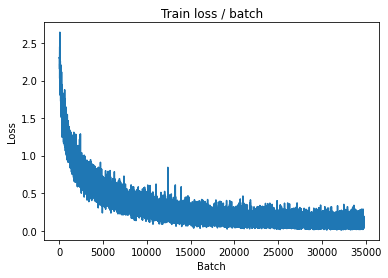

[TRAIN Batch 200/391]	Time 0.023s (0.048s)	Loss 0.0861 (0.1072)	Prec@1  96.9 ( 96.5)	Prec@5 100.0 (100.0)


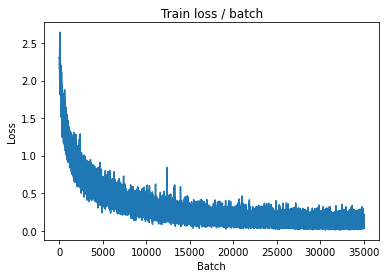


===============> Total time 18s	Avg loss 0.1039	Avg Prec@1 96.58 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.238s (0.238s)	Loss 1.3601 (1.3601)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.0656	Avg Prec@1 80.09 %	Avg Prec@5 98.55 %



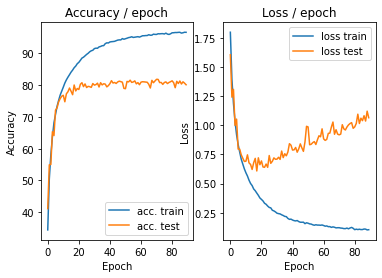

=== EPOCH 91 =====

[TRAIN Batch 000/391]	Time 0.307s (0.307s)	Loss 0.1425 (0.1425)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


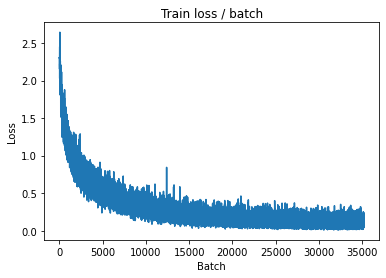

[TRAIN Batch 200/391]	Time 0.029s (0.049s)	Loss 0.1429 (0.1026)	Prec@1  94.5 ( 96.5)	Prec@5 100.0 (100.0)


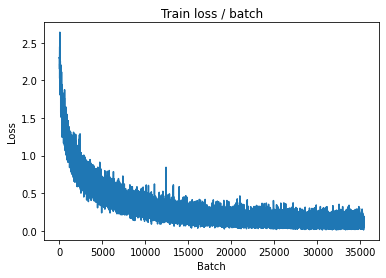


===============> Total time 19s	Avg loss 0.1048	Avg Prec@1 96.53 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 1.1296 (1.1296)	Prec@1  83.6 ( 83.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0790	Avg Prec@1 80.80 %	Avg Prec@5 98.39 %



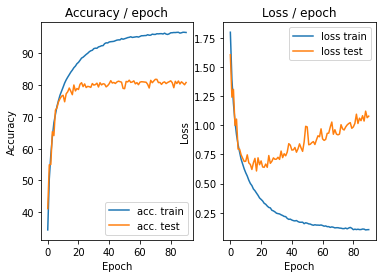

=== EPOCH 92 =====

[TRAIN Batch 000/391]	Time 0.302s (0.302s)	Loss 0.1289 (0.1289)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


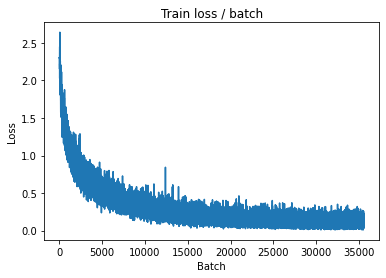

[TRAIN Batch 200/391]	Time 0.052s (0.049s)	Loss 0.2893 (0.1116)	Prec@1  93.0 ( 96.3)	Prec@5 100.0 (100.0)


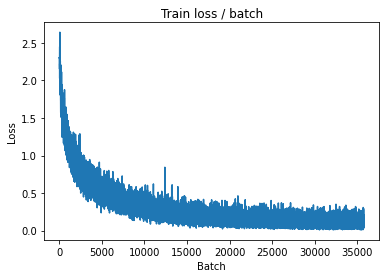


===============> Total time 18s	Avg loss 0.1124	Avg Prec@1 96.32 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 1.2598 (1.2598)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0553	Avg Prec@1 81.07 %	Avg Prec@5 98.49 %



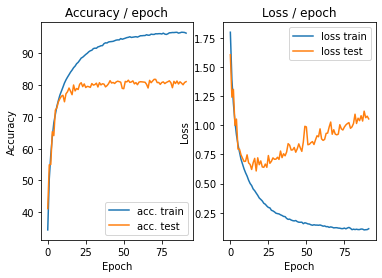

=== EPOCH 93 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.0309 (0.0309)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


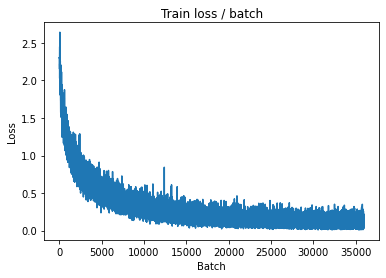

[TRAIN Batch 200/391]	Time 0.074s (0.048s)	Loss 0.0096 (0.0886)	Prec@1 100.0 ( 97.1)	Prec@5 100.0 (100.0)


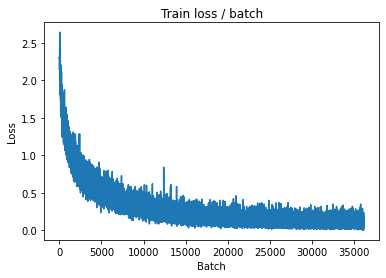


===============> Total time 18s	Avg loss 0.0997	Avg Prec@1 96.77 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 1.1125 (1.1125)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.0803	Avg Prec@1 80.89 %	Avg Prec@5 98.45 %



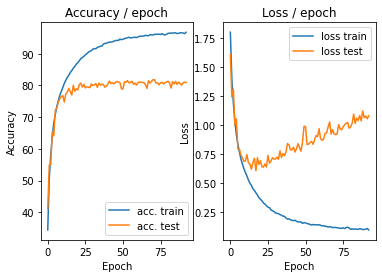

=== EPOCH 94 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.0530 (0.0530)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


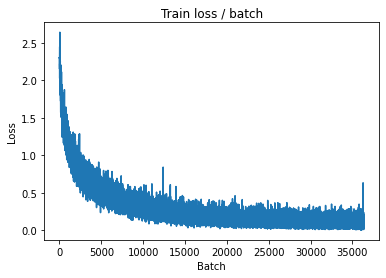

[TRAIN Batch 200/391]	Time 0.020s (0.051s)	Loss 0.1433 (0.1103)	Prec@1  95.3 ( 96.4)	Prec@5 100.0 (100.0)


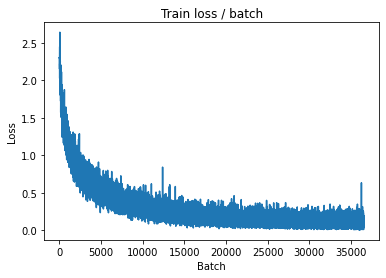


===============> Total time 19s	Avg loss 0.1135	Avg Prec@1 96.33 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 1.0766 (1.0766)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1051	Avg Prec@1 80.51 %	Avg Prec@5 98.57 %



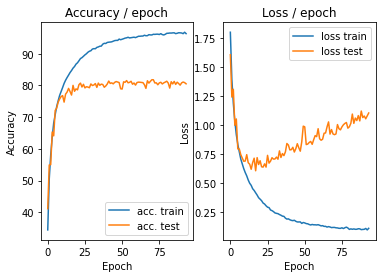

=== EPOCH 95 =====

[TRAIN Batch 000/391]	Time 0.312s (0.312s)	Loss 0.1033 (0.1033)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


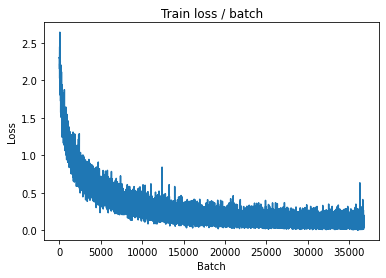

[TRAIN Batch 200/391]	Time 0.034s (0.049s)	Loss 0.1011 (0.0999)	Prec@1  96.1 ( 96.7)	Prec@5 100.0 (100.0)


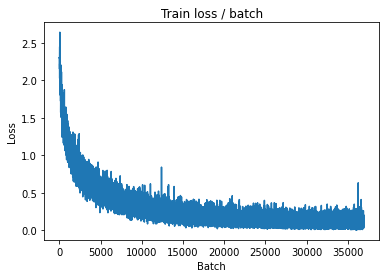


===============> Total time 18s	Avg loss 0.1011	Avg Prec@1 96.75 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 1.3176 (1.3176)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.1022	Avg Prec@1 80.81 %	Avg Prec@5 98.51 %



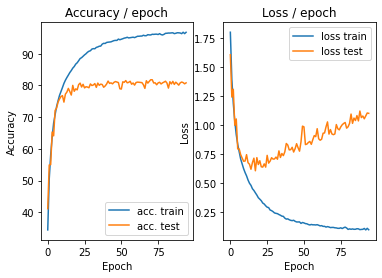

=== EPOCH 96 =====

[TRAIN Batch 000/391]	Time 0.331s (0.331s)	Loss 0.0847 (0.0847)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


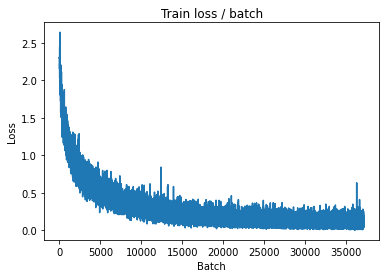

[TRAIN Batch 200/391]	Time 0.026s (0.049s)	Loss 0.0799 (0.1031)	Prec@1  98.4 ( 96.6)	Prec@5 100.0 (100.0)


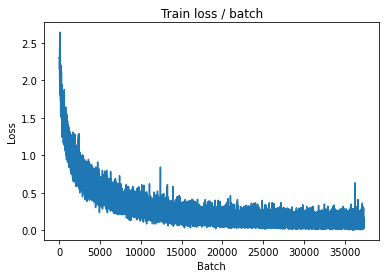


===============> Total time 18s	Avg loss 0.1047	Avg Prec@1 96.60 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.225s (0.225s)	Loss 1.5018 (1.5018)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.1852	Avg Prec@1 80.60 %	Avg Prec@5 98.66 %



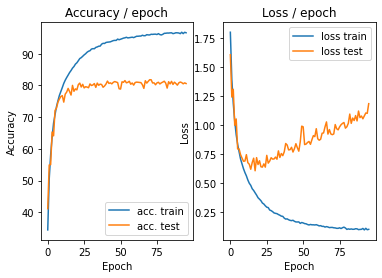

=== EPOCH 97 =====

[TRAIN Batch 000/391]	Time 0.308s (0.308s)	Loss 0.2099 (0.2099)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


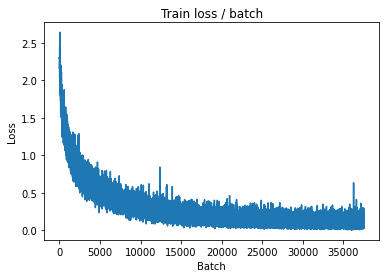

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.1495 (0.0968)	Prec@1  95.3 ( 96.8)	Prec@5 100.0 (100.0)


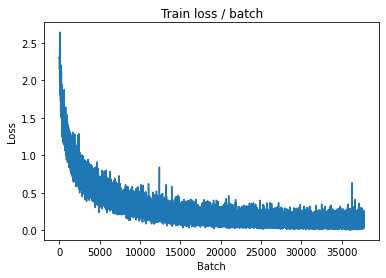


===============> Total time 18s	Avg loss 0.1039	Avg Prec@1 96.64 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.468s (0.468s)	Loss 1.1627 (1.1627)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.0412	Avg Prec@1 81.24 %	Avg Prec@5 98.56 %



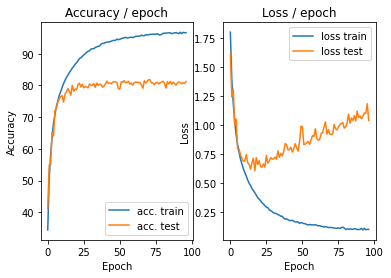

=== EPOCH 98 =====

[TRAIN Batch 000/391]	Time 0.327s (0.327s)	Loss 0.0982 (0.0982)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


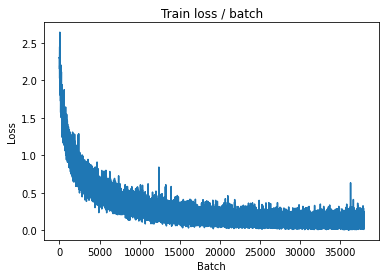

[TRAIN Batch 200/391]	Time 0.084s (0.051s)	Loss 0.1538 (0.0990)	Prec@1  94.5 ( 96.8)	Prec@5 100.0 (100.0)


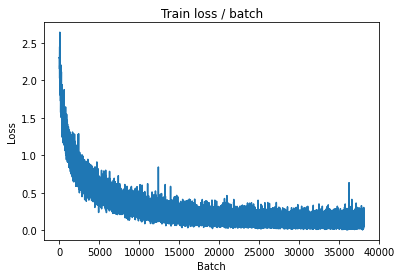


===============> Total time 18s	Avg loss 0.0988	Avg Prec@1 96.81 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.232s (0.232s)	Loss 1.2871 (1.2871)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.0877	Avg Prec@1 81.05 %	Avg Prec@5 98.66 %



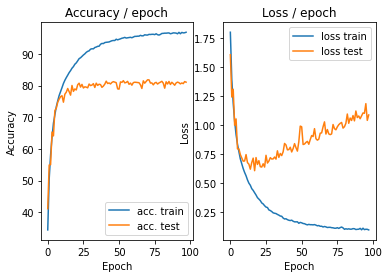

=== EPOCH 99 =====

[TRAIN Batch 000/391]	Time 0.324s (0.324s)	Loss 0.0706 (0.0706)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


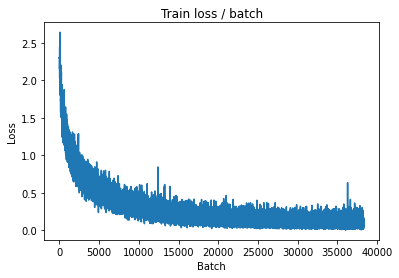

[TRAIN Batch 200/391]	Time 0.031s (0.050s)	Loss 0.1312 (0.1009)	Prec@1  96.9 ( 96.8)	Prec@5 100.0 (100.0)


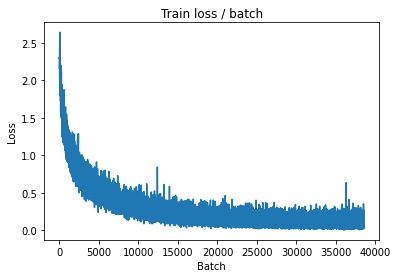


===============> Total time 18s	Avg loss 0.1028	Avg Prec@1 96.72 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 1.2088 (1.2088)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.0923	Avg Prec@1 81.08 %	Avg Prec@5 98.44 %



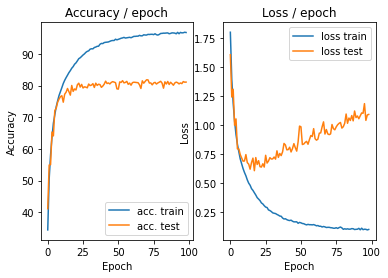

=== EPOCH 100 =====

[TRAIN Batch 000/391]	Time 0.327s (0.327s)	Loss 0.0195 (0.0195)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


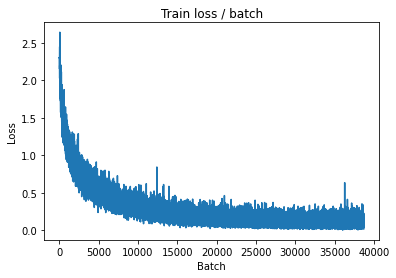

[TRAIN Batch 200/391]	Time 0.068s (0.049s)	Loss 0.1076 (0.1033)	Prec@1  96.1 ( 96.6)	Prec@5 100.0 (100.0)


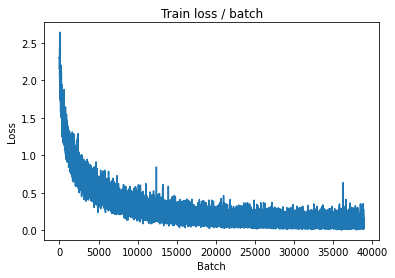


===============> Total time 18s	Avg loss 0.1069	Avg Prec@1 96.51 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 1.2406 (1.2406)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1003	Avg Prec@1 80.87 %	Avg Prec@5 98.67 %



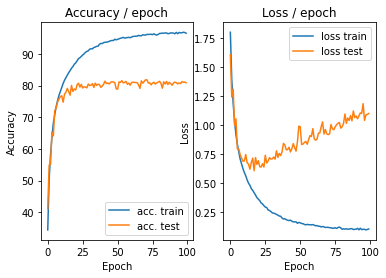

In [ ]:
main(128, 0.1, 100, cuda=True)

Partie 3.3 Variantes sur l'algorithme d'optimisation

In [ ]:
class ConvNetVar(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetVar, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2), #conv1
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool1
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), #conv2
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool2
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), #conv3
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), #pool3
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000), #fc4
            nn.ReLU(),
            nn.Linear(1000, 10), #fc5
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )   

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    normalize = transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.RandomCrop(28), transforms.RandomHorizontalFlip()               
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetVar()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
    
    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Apres chaque epoch, modifier le learning rate
        lr_sched.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 1.112s (1.112s)	Loss 2.3065 (2.3065)	Prec@1  10.9 ( 10.9)	Prec@5  46.9 ( 46.9)


<Figure size 432x288 with 0 Axes>

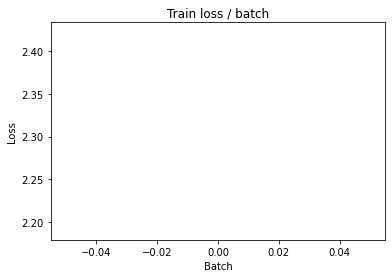

[TRAIN Batch 200/391]	Time 0.056s (0.052s)	Loss 1.8818 (2.0780)	Prec@1  25.0 ( 23.3)	Prec@5  82.8 ( 73.8)


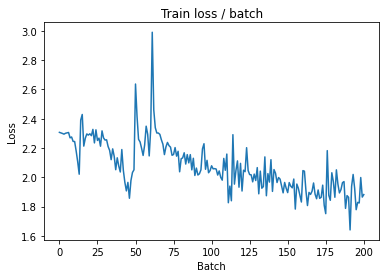


===============> Total time 19s	Avg loss 1.9359	Avg Prec@1 28.62 %	Avg Prec@5 79.74 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.5728 (1.5728)	Prec@1  48.4 ( 48.4)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.6603	Avg Prec@1 39.62 %	Avg Prec@5 88.84 %



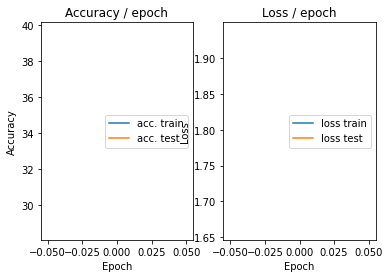

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 1.7314 (1.7314)	Prec@1  47.7 ( 47.7)	Prec@5  88.3 ( 88.3)


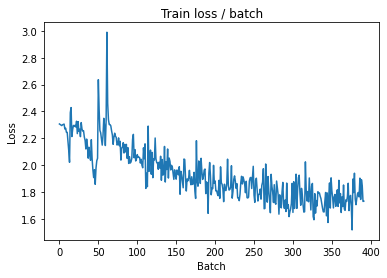

[TRAIN Batch 200/391]	Time 0.023s (0.048s)	Loss 1.6729 (1.7195)	Prec@1  33.6 ( 36.7)	Prec@5  89.8 ( 87.7)


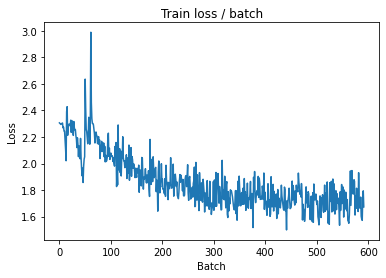


===============> Total time 18s	Avg loss 1.6769	Avg Prec@1 38.59 %	Avg Prec@5 88.59 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.5271 (1.5271)	Prec@1  49.2 ( 49.2)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.6255	Avg Prec@1 42.41 %	Avg Prec@5 89.99 %



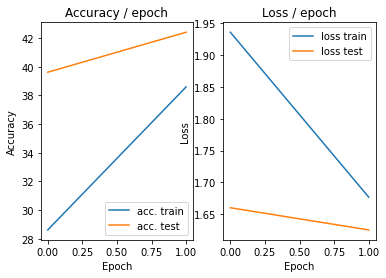

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.8042 (1.8042)	Prec@1  36.7 ( 36.7)	Prec@5  88.3 ( 88.3)


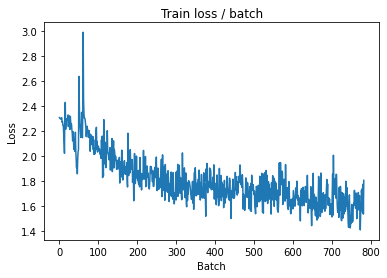

[TRAIN Batch 200/391]	Time 0.024s (0.049s)	Loss 1.6589 (1.5764)	Prec@1  33.6 ( 42.9)	Prec@5  91.4 ( 90.2)


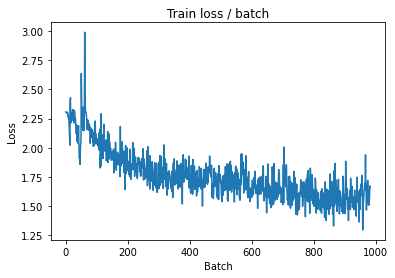


===============> Total time 19s	Avg loss 1.5658	Avg Prec@1 43.34 %	Avg Prec@5 90.46 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.6048 (1.6048)	Prec@1  41.4 ( 41.4)	Prec@5  89.8 ( 89.8)

===============> Total time 3s	Avg loss 1.5525	Avg Prec@1 44.18 %	Avg Prec@5 91.22 %



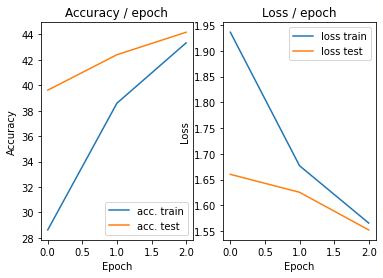

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 1.6327 (1.6327)	Prec@1  43.0 ( 43.0)	Prec@5  92.2 ( 92.2)


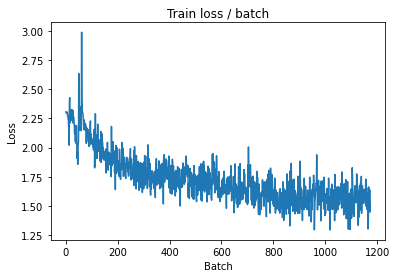

[TRAIN Batch 200/391]	Time 0.031s (0.047s)	Loss 1.5559 (1.5174)	Prec@1  46.9 ( 45.3)	Prec@5  89.1 ( 91.3)


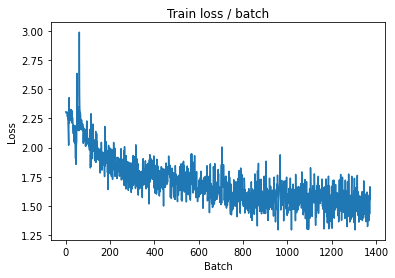


===============> Total time 18s	Avg loss 1.5019	Avg Prec@1 45.82 %	Avg Prec@5 91.39 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.5051 (1.5051)	Prec@1  39.1 ( 39.1)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.4405	Avg Prec@1 47.83 %	Avg Prec@5 92.14 %



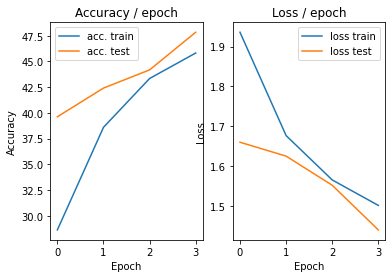

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 1.4461 (1.4461)	Prec@1  46.9 ( 46.9)	Prec@5  88.3 ( 88.3)


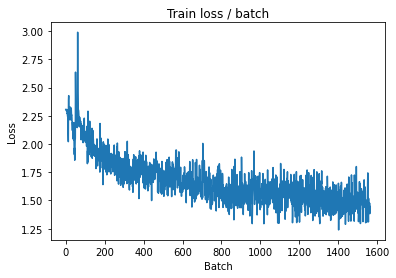

[TRAIN Batch 200/391]	Time 0.059s (0.051s)	Loss 1.5630 (1.4434)	Prec@1  48.4 ( 48.8)	Prec@5  92.2 ( 92.0)


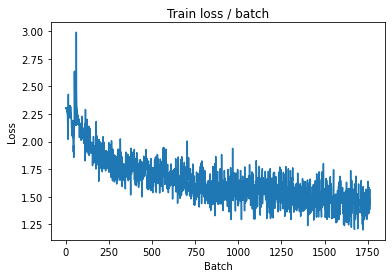


===============> Total time 19s	Avg loss 1.4396	Avg Prec@1 48.93 %	Avg Prec@5 92.18 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.5096 (1.5096)	Prec@1  53.1 ( 53.1)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4118	Avg Prec@1 49.83 %	Avg Prec@5 92.28 %



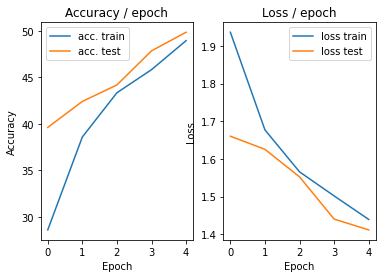

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 1.3584 (1.3584)	Prec@1  50.0 ( 50.0)	Prec@5  92.2 ( 92.2)


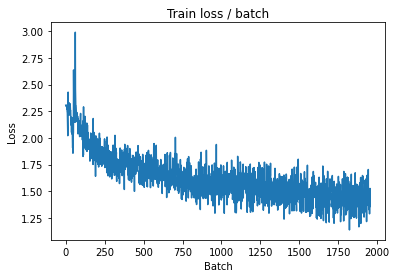

[TRAIN Batch 200/391]	Time 0.054s (0.049s)	Loss 1.3164 (1.4037)	Prec@1  52.3 ( 50.5)	Prec@5  94.5 ( 92.8)


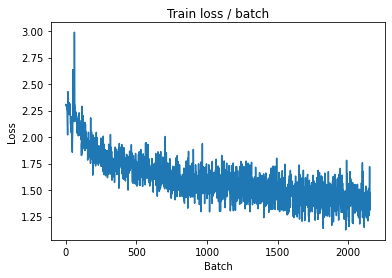


===============> Total time 19s	Avg loss 1.3975	Avg Prec@1 51.14 %	Avg Prec@5 92.69 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.4510 (1.4510)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.3711	Avg Prec@1 50.40 %	Avg Prec@5 92.68 %



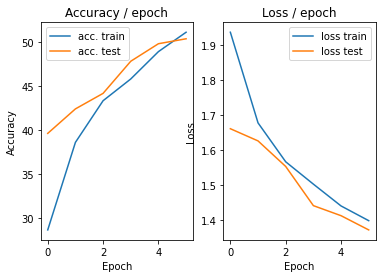

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 1.3556 (1.3556)	Prec@1  48.4 ( 48.4)	Prec@5  93.0 ( 93.0)


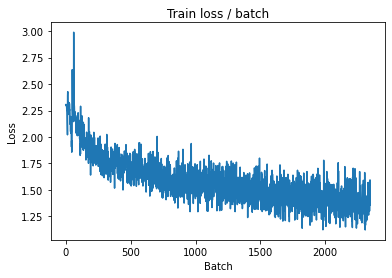

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 1.3839 (1.3533)	Prec@1  53.1 ( 52.6)	Prec@5  91.4 ( 93.0)


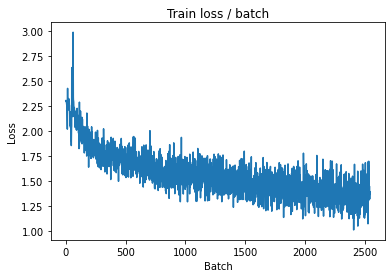


===============> Total time 18s	Avg loss 1.3651	Avg Prec@1 52.24 %	Avg Prec@5 92.90 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 1.3766 (1.3766)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.3092	Avg Prec@1 54.33 %	Avg Prec@5 93.92 %



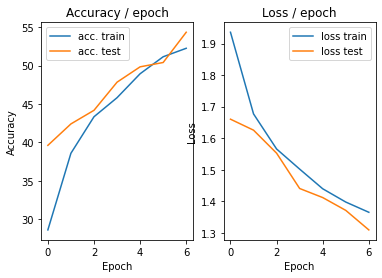

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 1.3080 (1.3080)	Prec@1  57.0 ( 57.0)	Prec@5  93.0 ( 93.0)


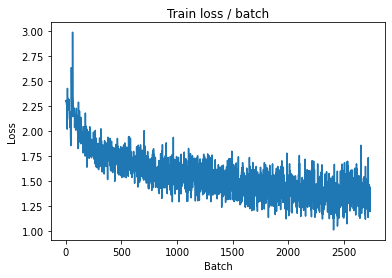

[TRAIN Batch 200/391]	Time 0.030s (0.050s)	Loss 1.2946 (1.3106)	Prec@1  56.2 ( 54.9)	Prec@5  93.8 ( 93.3)


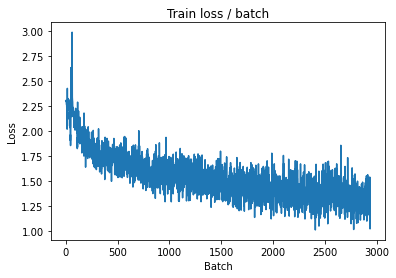


===============> Total time 19s	Avg loss 1.2990	Avg Prec@1 55.13 %	Avg Prec@5 93.52 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.3031 (1.3031)	Prec@1  50.8 ( 50.8)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.2420	Avg Prec@1 56.70 %	Avg Prec@5 94.60 %



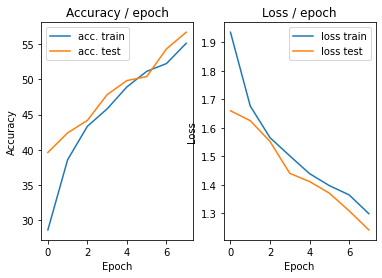

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 1.2673 (1.2673)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)


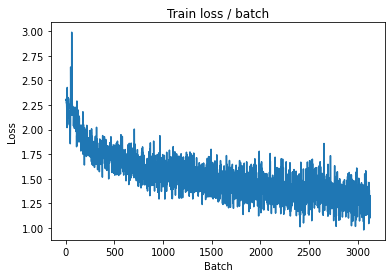

[TRAIN Batch 200/391]	Time 0.046s (0.049s)	Loss 1.1759 (1.2640)	Prec@1  58.6 ( 56.5)	Prec@5  90.6 ( 94.0)


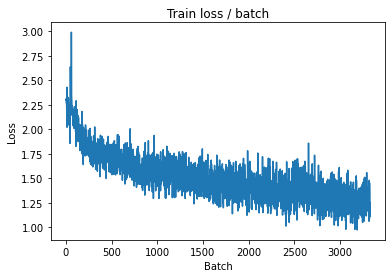


===============> Total time 18s	Avg loss 1.2680	Avg Prec@1 56.47 %	Avg Prec@5 93.86 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.0624 (1.0624)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2231	Avg Prec@1 57.39 %	Avg Prec@5 94.39 %



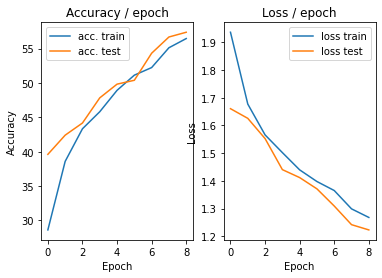

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 1.3680 (1.3680)	Prec@1  52.3 ( 52.3)	Prec@5  93.8 ( 93.8)


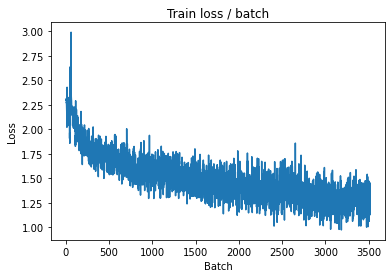

[TRAIN Batch 200/391]	Time 0.023s (0.049s)	Loss 1.1946 (1.2212)	Prec@1  59.4 ( 57.8)	Prec@5  96.1 ( 94.6)


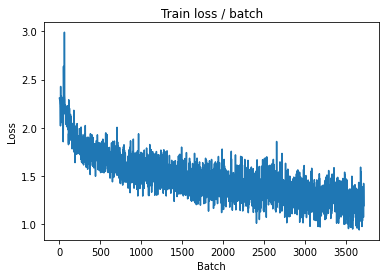


===============> Total time 18s	Avg loss 1.2276	Avg Prec@1 57.89 %	Avg Prec@5 94.37 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.1332 (1.1332)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1832	Avg Prec@1 59.07 %	Avg Prec@5 95.23 %



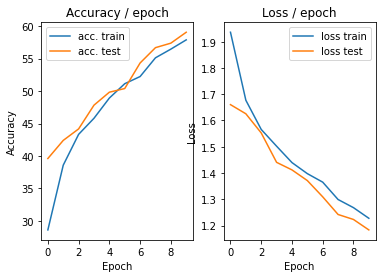

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 1.3479 (1.3479)	Prec@1  50.0 ( 50.0)	Prec@5  93.8 ( 93.8)


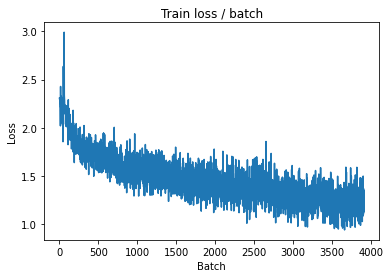

[TRAIN Batch 200/391]	Time 0.049s (0.049s)	Loss 1.1163 (1.1726)	Prec@1  57.8 ( 60.1)	Prec@5  96.9 ( 94.6)


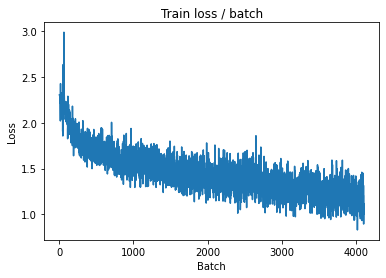


===============> Total time 19s	Avg loss 1.1877	Avg Prec@1 59.56 %	Avg Prec@5 94.55 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.3121 (1.3121)	Prec@1  52.3 ( 52.3)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.1721	Avg Prec@1 60.69 %	Avg Prec@5 94.39 %



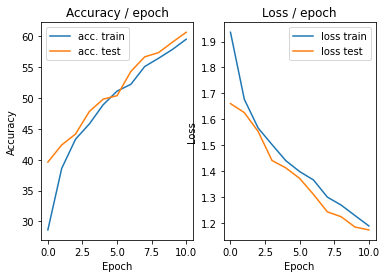

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 1.1447 (1.1447)	Prec@1  63.3 ( 63.3)	Prec@5  93.0 ( 93.0)


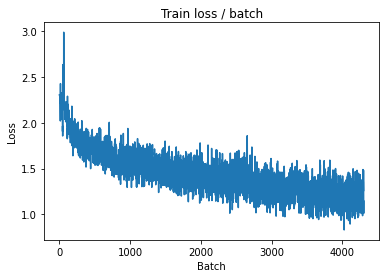

[TRAIN Batch 200/391]	Time 0.042s (0.050s)	Loss 1.2052 (1.1738)	Prec@1  58.6 ( 60.0)	Prec@5  93.0 ( 94.5)


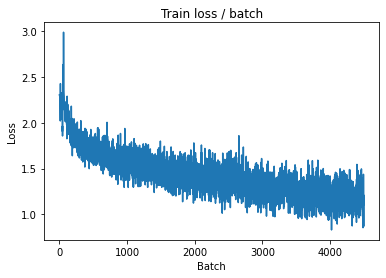


===============> Total time 18s	Avg loss 1.1623	Avg Prec@1 60.30 %	Avg Prec@5 94.77 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.0742 (1.0742)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1167	Avg Prec@1 62.46 %	Avg Prec@5 95.10 %



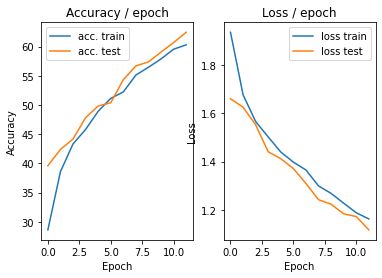

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 1.1294 (1.1294)	Prec@1  60.2 ( 60.2)	Prec@5  93.8 ( 93.8)


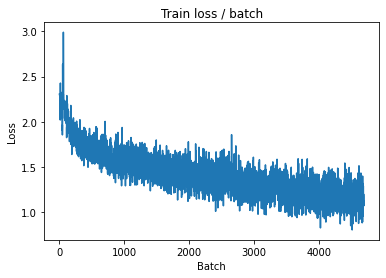

[TRAIN Batch 200/391]	Time 0.080s (0.049s)	Loss 0.9831 (1.1108)	Prec@1  68.0 ( 62.4)	Prec@5  94.5 ( 95.3)


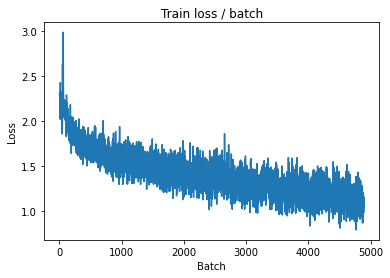


===============> Total time 19s	Avg loss 1.1203	Avg Prec@1 61.93 %	Avg Prec@5 95.27 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 1.1405 (1.1405)	Prec@1  62.5 ( 62.5)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.0885	Avg Prec@1 62.55 %	Avg Prec@5 95.68 %



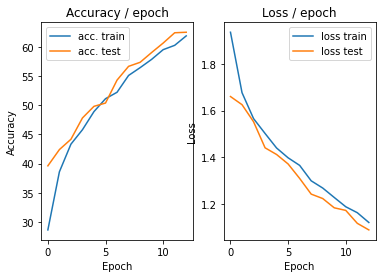

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.9089 (0.9089)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


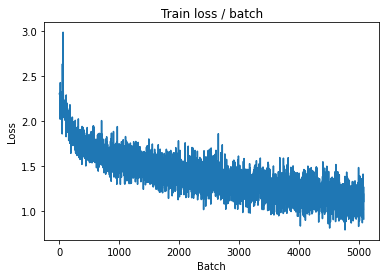

[TRAIN Batch 200/391]	Time 0.018s (0.049s)	Loss 0.9803 (1.0698)	Prec@1  70.3 ( 63.6)	Prec@5  94.5 ( 95.7)


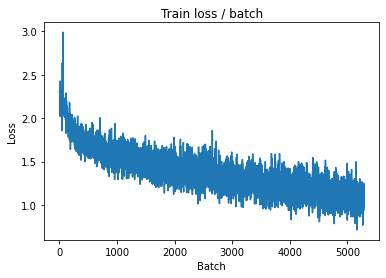


===============> Total time 19s	Avg loss 1.0722	Avg Prec@1 63.71 %	Avg Prec@5 95.72 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.0856 (1.0856)	Prec@1  63.3 ( 63.3)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.1123	Avg Prec@1 63.30 %	Avg Prec@5 95.72 %



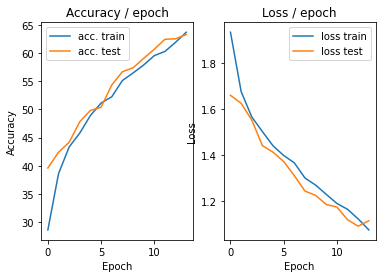

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 1.0823 (1.0823)	Prec@1  69.5 ( 69.5)	Prec@5  95.3 ( 95.3)


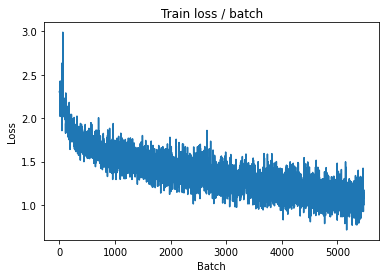

[TRAIN Batch 200/391]	Time 0.040s (0.049s)	Loss 1.0017 (1.0295)	Prec@1  63.3 ( 65.2)	Prec@5  93.0 ( 95.9)


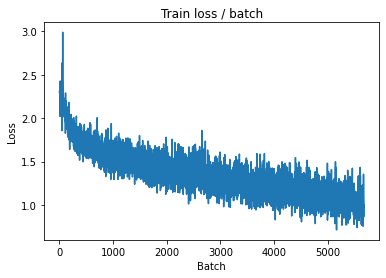


===============> Total time 18s	Avg loss 1.0407	Avg Prec@1 64.90 %	Avg Prec@5 95.74 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.1013 (1.1013)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.0877	Avg Prec@1 62.84 %	Avg Prec@5 95.42 %



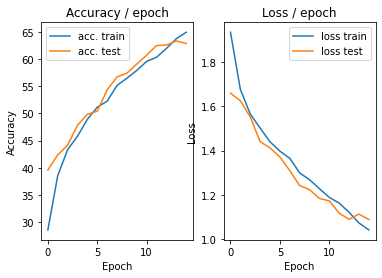

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.9890 (0.9890)	Prec@1  68.0 ( 68.0)	Prec@5  93.8 ( 93.8)


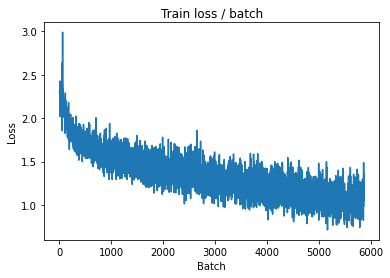

[TRAIN Batch 200/391]	Time 0.051s (0.051s)	Loss 0.8668 (1.0071)	Prec@1  68.0 ( 65.7)	Prec@5  96.1 ( 96.0)


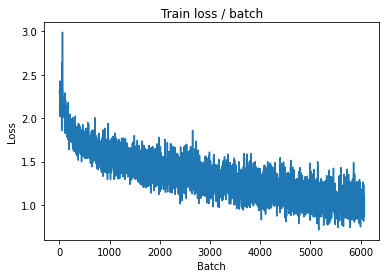


===============> Total time 19s	Avg loss 1.0002	Avg Prec@1 66.19 %	Avg Prec@5 96.14 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.1688 (1.1688)	Prec@1  58.6 ( 58.6)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.0391	Avg Prec@1 65.36 %	Avg Prec@5 95.57 %



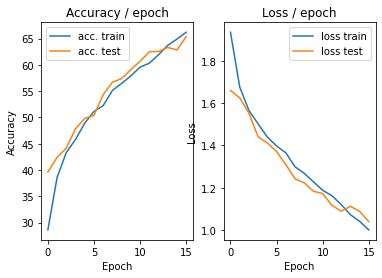

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 1.0086 (1.0086)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


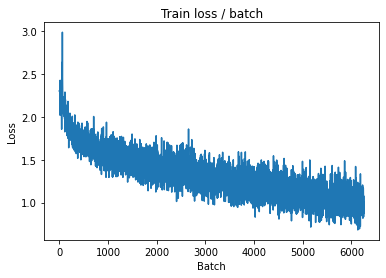

[TRAIN Batch 200/391]	Time 0.061s (0.049s)	Loss 0.8800 (0.9810)	Prec@1  66.4 ( 66.5)	Prec@5  98.4 ( 96.3)


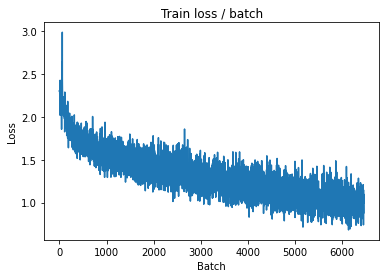


===============> Total time 18s	Avg loss 0.9815	Avg Prec@1 66.56 %	Avg Prec@5 96.30 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.1121 (1.1121)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0168	Avg Prec@1 66.49 %	Avg Prec@5 96.37 %



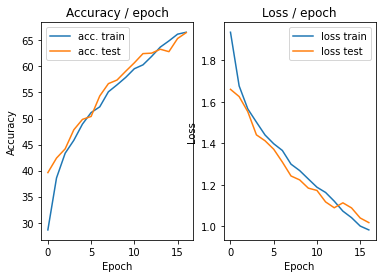

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.8720 (0.8720)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)


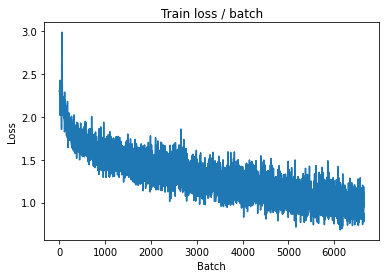

[TRAIN Batch 200/391]	Time 0.019s (0.051s)	Loss 1.1157 (0.9442)	Prec@1  64.8 ( 68.3)	Prec@5  96.9 ( 96.6)


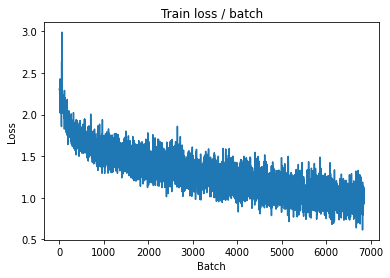


===============> Total time 19s	Avg loss 0.9595	Avg Prec@1 67.85 %	Avg Prec@5 96.46 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 1.0638 (1.0638)	Prec@1  64.1 ( 64.1)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.0344	Avg Prec@1 65.17 %	Avg Prec@5 95.90 %



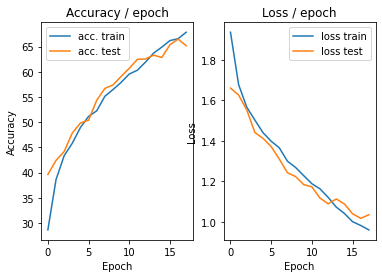

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.9406 (0.9406)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)


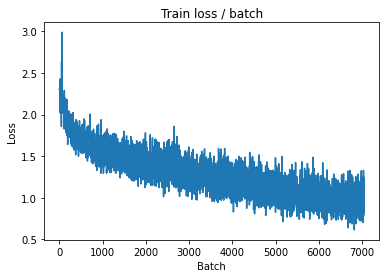

[TRAIN Batch 200/391]	Time 0.087s (0.049s)	Loss 1.0159 (0.9484)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 96.7)


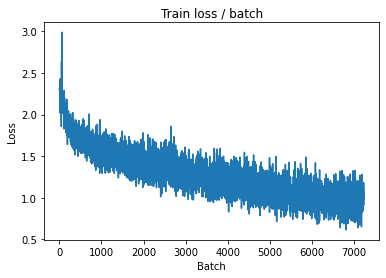


===============> Total time 18s	Avg loss 0.9329	Avg Prec@1 68.64 %	Avg Prec@5 96.74 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.9432 (0.9432)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9861	Avg Prec@1 67.85 %	Avg Prec@5 96.57 %



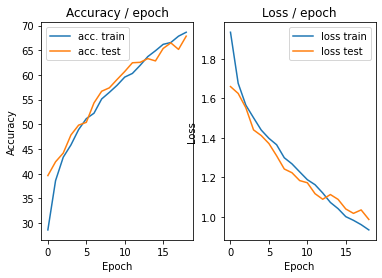

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.8911 (0.8911)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


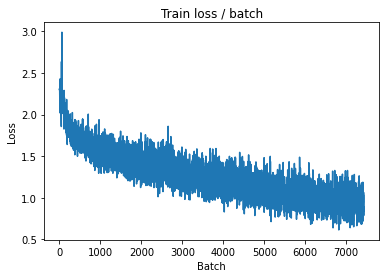

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 0.8020 (0.8940)	Prec@1  71.9 ( 69.8)	Prec@5  96.9 ( 97.1)


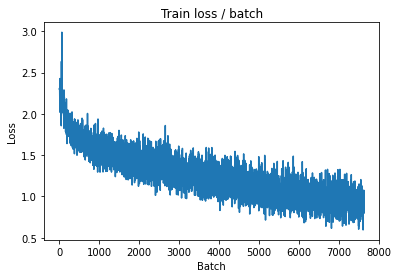


===============> Total time 19s	Avg loss 0.8881	Avg Prec@1 69.95 %	Avg Prec@5 97.09 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9726 (0.9726)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9400	Avg Prec@1 68.77 %	Avg Prec@5 96.66 %



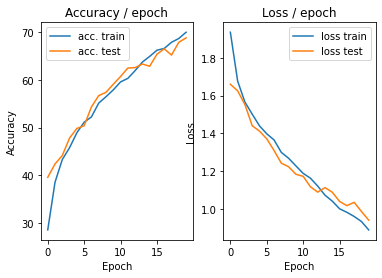

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.9183 (0.9183)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


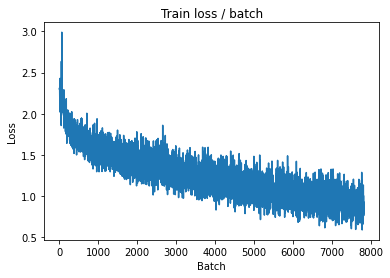

[TRAIN Batch 200/391]	Time 0.063s (0.050s)	Loss 0.7297 (0.8504)	Prec@1  77.3 ( 71.2)	Prec@5  96.1 ( 97.2)


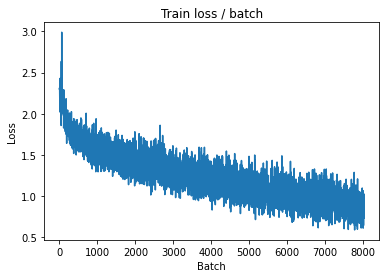


===============> Total time 19s	Avg loss 0.8621	Avg Prec@1 70.85 %	Avg Prec@5 97.15 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.9228 (0.9228)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8966	Avg Prec@1 70.59 %	Avg Prec@5 97.30 %



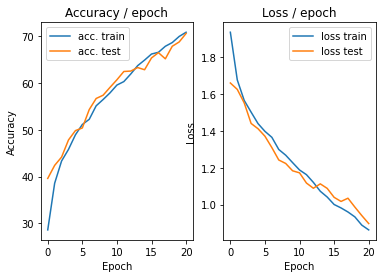

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.8206 (0.8206)	Prec@1  75.0 ( 75.0)	Prec@5  94.5 ( 94.5)


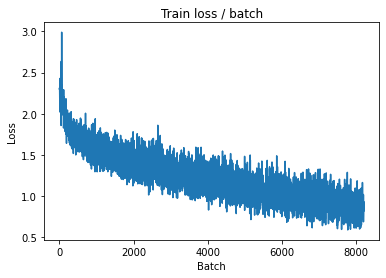

[TRAIN Batch 200/391]	Time 0.025s (0.048s)	Loss 0.7962 (0.8302)	Prec@1  73.4 ( 71.6)	Prec@5  97.7 ( 97.4)


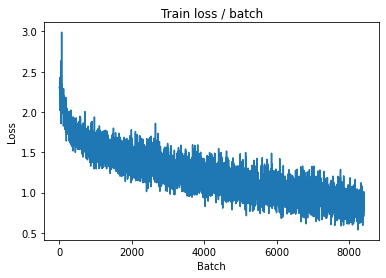


===============> Total time 18s	Avg loss 0.8338	Avg Prec@1 71.62 %	Avg Prec@5 97.29 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8806 (0.8806)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9323	Avg Prec@1 69.31 %	Avg Prec@5 96.81 %



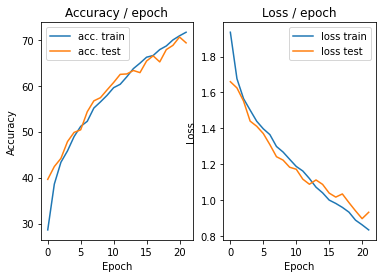

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.6475 (0.6475)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


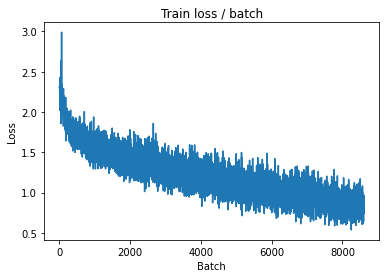

[TRAIN Batch 200/391]	Time 0.031s (0.050s)	Loss 0.8142 (0.7959)	Prec@1  76.6 ( 73.1)	Prec@5  95.3 ( 97.7)


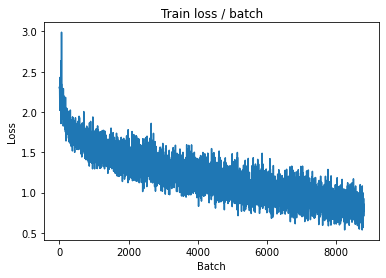


===============> Total time 19s	Avg loss 0.7999	Avg Prec@1 73.18 %	Avg Prec@5 97.66 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.9392 (0.9392)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8542	Avg Prec@1 71.71 %	Avg Prec@5 97.44 %



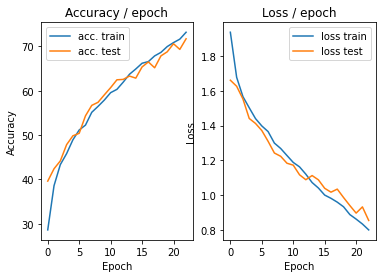

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.8052 (0.8052)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


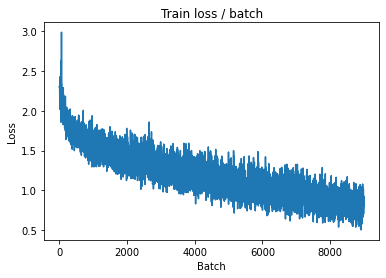

[TRAIN Batch 200/391]	Time 0.079s (0.049s)	Loss 0.8153 (0.7746)	Prec@1  68.8 ( 73.6)	Prec@5  96.1 ( 97.9)


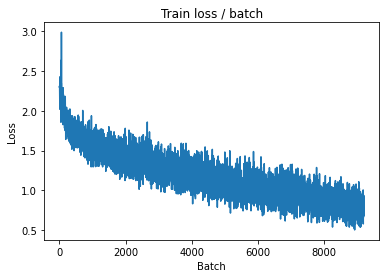


===============> Total time 19s	Avg loss 0.7708	Avg Prec@1 73.96 %	Avg Prec@5 97.83 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.7982 (0.7982)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8541	Avg Prec@1 71.87 %	Avg Prec@5 97.28 %



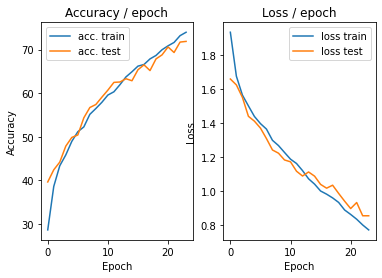

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.7588 (0.7588)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


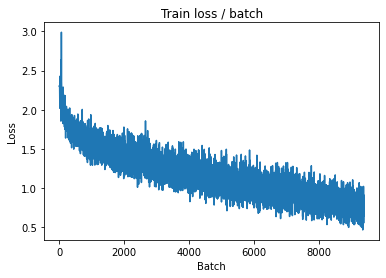

[TRAIN Batch 200/391]	Time 0.080s (0.049s)	Loss 0.6609 (0.7615)	Prec@1  75.0 ( 74.2)	Prec@5  97.7 ( 97.9)


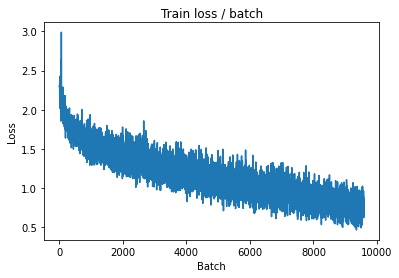


===============> Total time 18s	Avg loss 0.7504	Avg Prec@1 74.72 %	Avg Prec@5 97.86 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8664 (0.8664)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8598	Avg Prec@1 72.45 %	Avg Prec@5 97.50 %



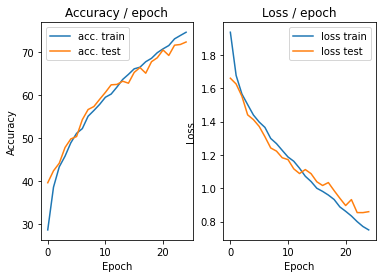

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.8044 (0.8044)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)


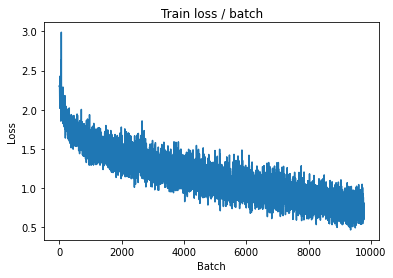

[TRAIN Batch 200/391]	Time 0.118s (0.049s)	Loss 0.9083 (0.7233)	Prec@1  71.1 ( 75.5)	Prec@5  94.5 ( 98.0)


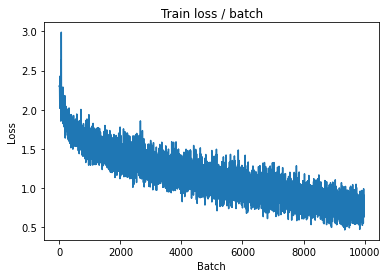


===============> Total time 18s	Avg loss 0.7224	Avg Prec@1 75.57 %	Avg Prec@5 98.04 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.7646 (0.7646)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8338	Avg Prec@1 72.57 %	Avg Prec@5 97.54 %



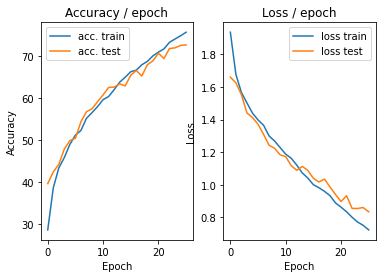

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.7493 (0.7493)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


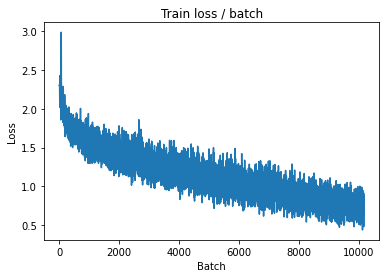

[TRAIN Batch 200/391]	Time 0.066s (0.051s)	Loss 0.8457 (0.6961)	Prec@1  73.4 ( 76.2)	Prec@5  97.7 ( 98.2)


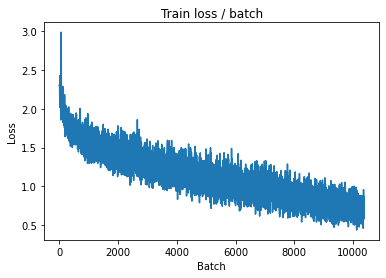


===============> Total time 19s	Avg loss 0.7071	Avg Prec@1 75.85 %	Avg Prec@5 98.15 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.7744 (0.7744)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8364	Avg Prec@1 73.23 %	Avg Prec@5 97.27 %



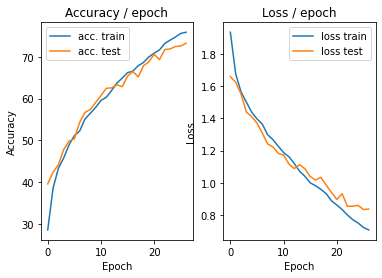

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.6126 (0.6126)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


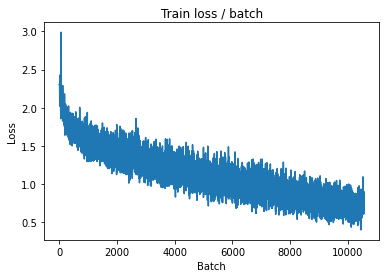

[TRAIN Batch 200/391]	Time 0.052s (0.048s)	Loss 0.7960 (0.6736)	Prec@1  71.9 ( 77.5)	Prec@5  99.2 ( 98.3)


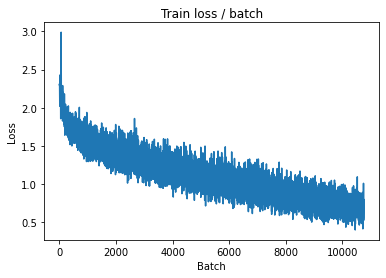


===============> Total time 18s	Avg loss 0.6833	Avg Prec@1 77.11 %	Avg Prec@5 98.25 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.7947 (0.7947)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8102	Avg Prec@1 73.69 %	Avg Prec@5 97.48 %



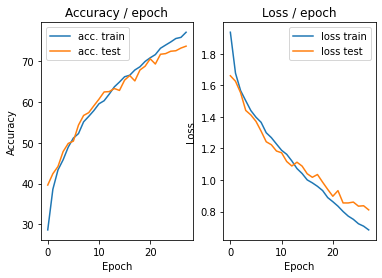

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.5399 (0.5399)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)


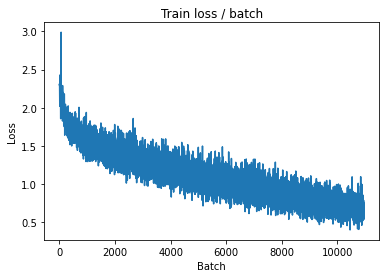

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.6882 (0.6523)	Prec@1  78.1 ( 77.9)	Prec@5  97.7 ( 98.5)


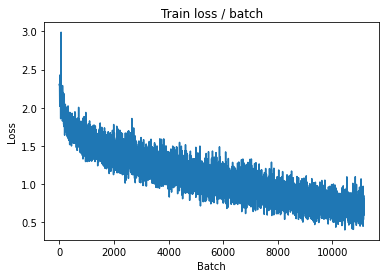


===============> Total time 18s	Avg loss 0.6573	Avg Prec@1 77.73 %	Avg Prec@5 98.48 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7980 (0.7980)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7795	Avg Prec@1 74.81 %	Avg Prec@5 97.73 %



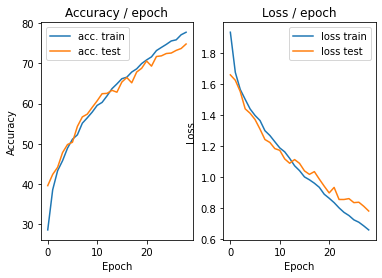

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.6196 (0.6196)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


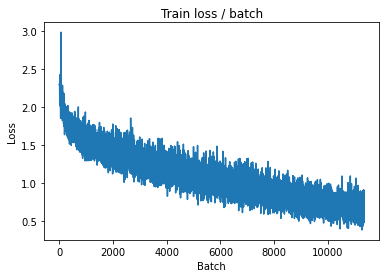

[TRAIN Batch 200/391]	Time 0.031s (0.048s)	Loss 0.5927 (0.6159)	Prec@1  82.0 ( 79.0)	Prec@5  98.4 ( 98.7)


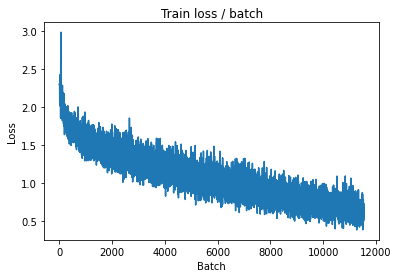


===============> Total time 18s	Avg loss 0.6266	Avg Prec@1 78.71 %	Avg Prec@5 98.58 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.8158 (0.8158)	Prec@1  81.2 ( 81.2)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.7878	Avg Prec@1 74.83 %	Avg Prec@5 97.74 %



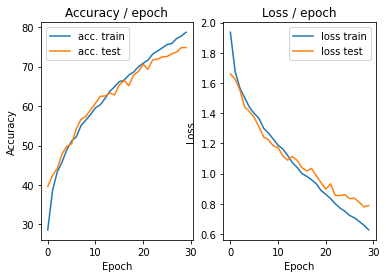

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.6100 (0.6100)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


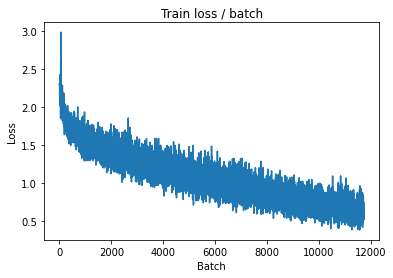

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 0.7010 (0.6104)	Prec@1  77.3 ( 79.2)	Prec@5  96.1 ( 98.5)


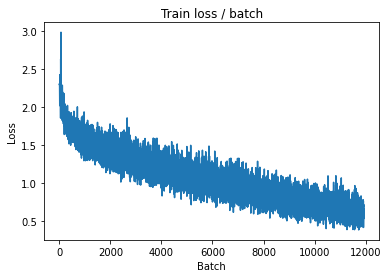


===============> Total time 18s	Avg loss 0.6173	Avg Prec@1 78.88 %	Avg Prec@5 98.58 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.8194 (0.8194)	Prec@1  78.9 ( 78.9)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.7688	Avg Prec@1 75.96 %	Avg Prec@5 97.59 %



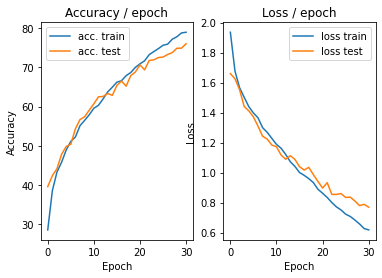

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.5641 (0.5641)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


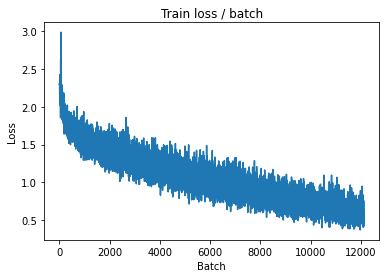

[TRAIN Batch 200/391]	Time 0.031s (0.049s)	Loss 0.6324 (0.5842)	Prec@1  78.9 ( 80.1)	Prec@5  97.7 ( 98.7)


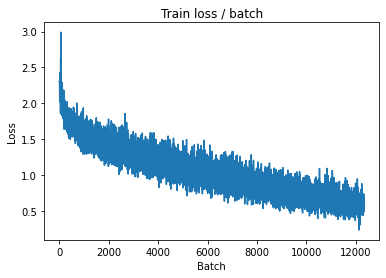


===============> Total time 19s	Avg loss 0.5947	Avg Prec@1 79.74 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.6944 (0.6944)	Prec@1  79.7 ( 79.7)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.7625	Avg Prec@1 75.93 %	Avg Prec@5 97.89 %



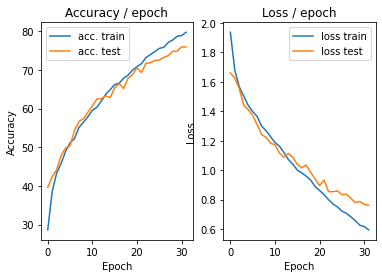

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.3690 (0.3690)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


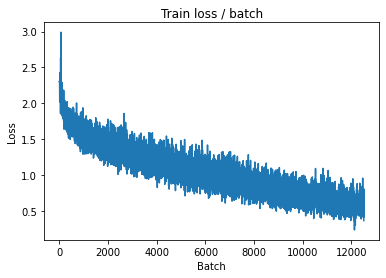

[TRAIN Batch 200/391]	Time 0.063s (0.048s)	Loss 0.5471 (0.5720)	Prec@1  81.2 ( 80.7)	Prec@5  98.4 ( 98.8)


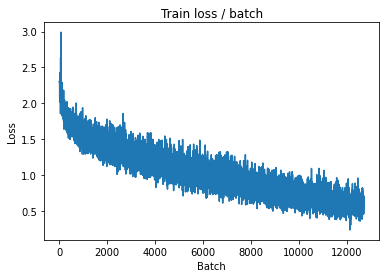


===============> Total time 18s	Avg loss 0.5735	Avg Prec@1 80.48 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.7631 (0.7631)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7659	Avg Prec@1 75.55 %	Avg Prec@5 97.75 %



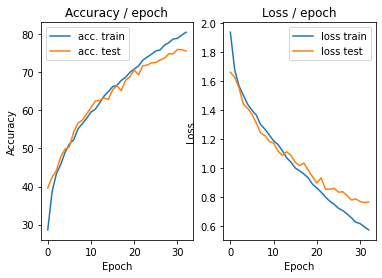

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 0.5341 (0.5341)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


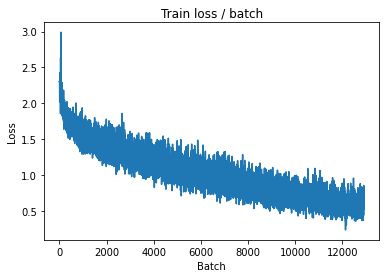

[TRAIN Batch 200/391]	Time 0.025s (0.049s)	Loss 0.4812 (0.5388)	Prec@1  83.6 ( 81.4)	Prec@5  98.4 ( 98.9)


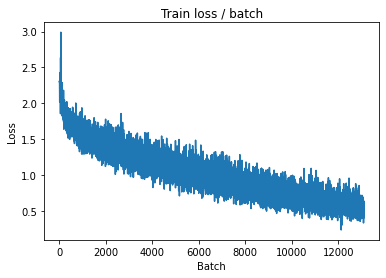


===============> Total time 18s	Avg loss 0.5470	Avg Prec@1 81.31 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 0.6929 (0.6929)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7483	Avg Prec@1 76.48 %	Avg Prec@5 97.77 %



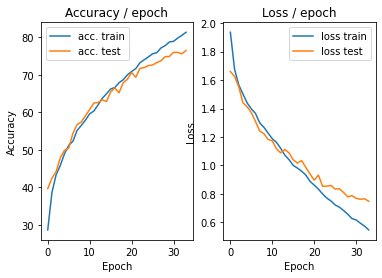

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.6241 (0.6241)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


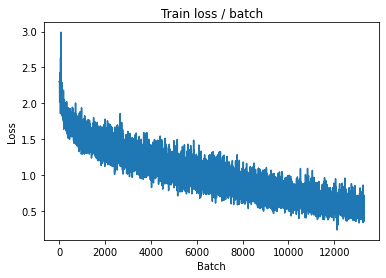

[TRAIN Batch 200/391]	Time 0.028s (0.051s)	Loss 0.5204 (0.5226)	Prec@1  83.6 ( 82.1)	Prec@5  97.7 ( 99.0)


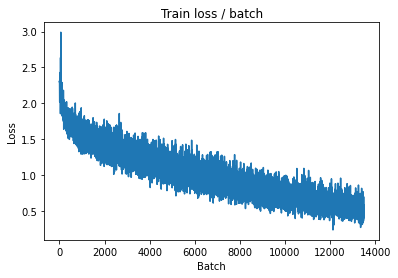


===============> Total time 19s	Avg loss 0.5309	Avg Prec@1 81.81 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.7215 (0.7215)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7666	Avg Prec@1 76.30 %	Avg Prec@5 97.75 %



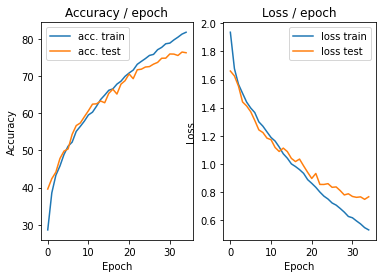

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.5503 (0.5503)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)


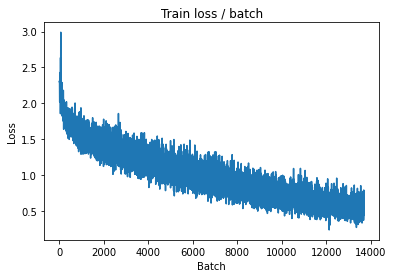

[TRAIN Batch 200/391]	Time 0.074s (0.049s)	Loss 0.4735 (0.5024)	Prec@1  80.5 ( 82.6)	Prec@5 100.0 ( 99.1)


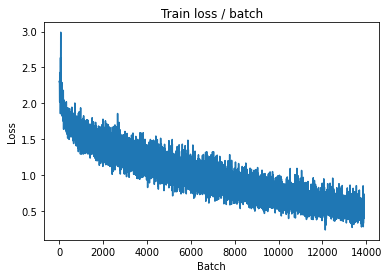


===============> Total time 18s	Avg loss 0.5093	Avg Prec@1 82.32 %	Avg Prec@5 99.03 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.7020 (0.7020)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7295	Avg Prec@1 76.93 %	Avg Prec@5 97.99 %



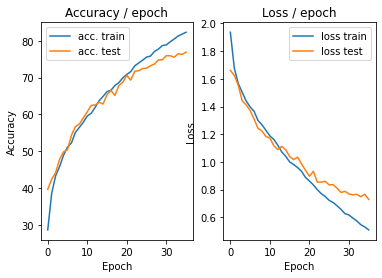

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.5422 (0.5422)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


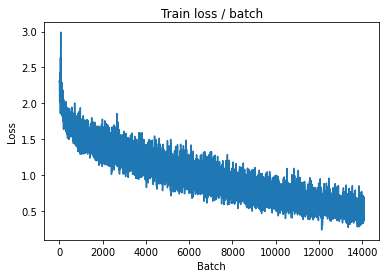

[TRAIN Batch 200/391]	Time 0.024s (0.050s)	Loss 0.4359 (0.4931)	Prec@1  83.6 ( 82.9)	Prec@5  99.2 ( 99.2)


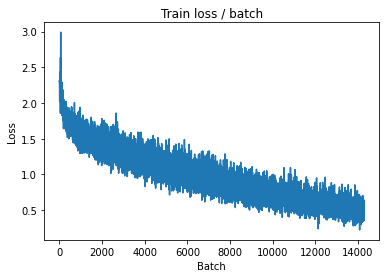


===============> Total time 19s	Avg loss 0.4922	Avg Prec@1 83.00 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.6992 (0.6992)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7362	Avg Prec@1 77.25 %	Avg Prec@5 98.09 %



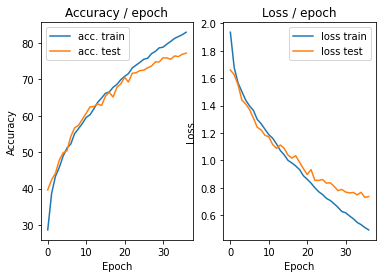

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4161 (0.4161)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


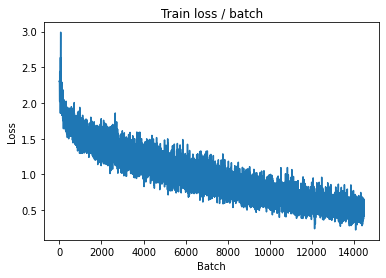

[TRAIN Batch 200/391]	Time 0.021s (0.049s)	Loss 0.4661 (0.4715)	Prec@1  85.9 ( 83.9)	Prec@5  99.2 ( 99.2)


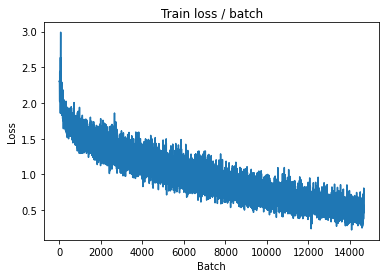


===============> Total time 19s	Avg loss 0.4759	Avg Prec@1 83.54 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6757 (0.6757)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.7422	Avg Prec@1 77.07 %	Avg Prec@5 98.15 %



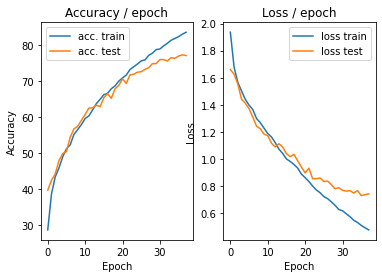

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.4971 (0.4971)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


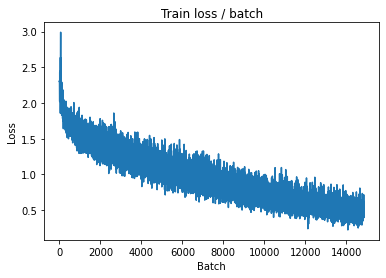

[TRAIN Batch 200/391]	Time 0.029s (0.050s)	Loss 0.5306 (0.4516)	Prec@1  78.9 ( 84.2)	Prec@5 100.0 ( 99.3)


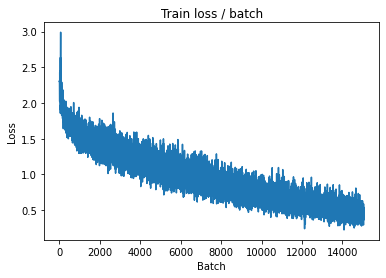


===============> Total time 19s	Avg loss 0.4531	Avg Prec@1 84.23 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.7239 (0.7239)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7458	Avg Prec@1 77.43 %	Avg Prec@5 98.26 %



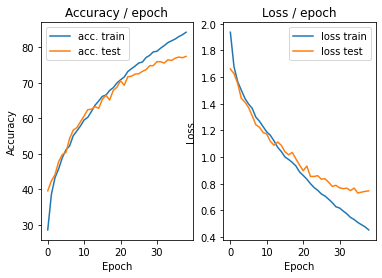

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.4065 (0.4065)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)


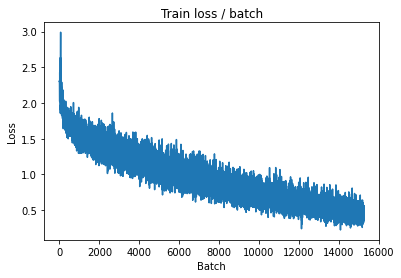

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 0.3514 (0.4428)	Prec@1  87.5 ( 84.7)	Prec@5  99.2 ( 99.3)


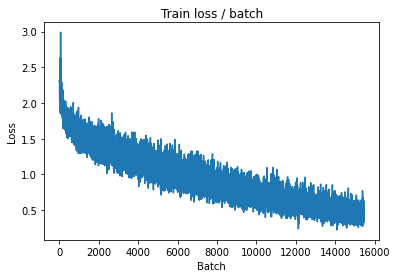


===============> Total time 19s	Avg loss 0.4528	Avg Prec@1 84.35 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.6470 (0.6470)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7301	Avg Prec@1 77.52 %	Avg Prec@5 98.15 %



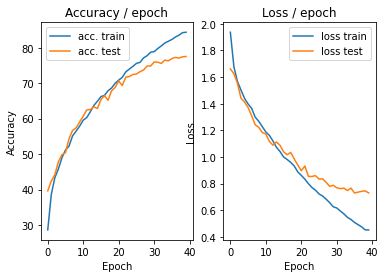

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.4073 (0.4073)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


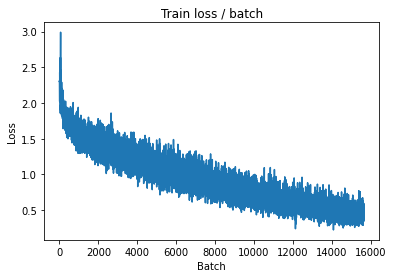

[TRAIN Batch 200/391]	Time 0.067s (0.050s)	Loss 0.3420 (0.4264)	Prec@1  89.8 ( 85.2)	Prec@5 100.0 ( 99.4)


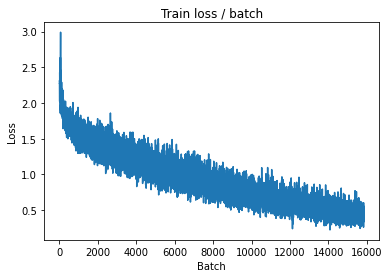


===============> Total time 19s	Avg loss 0.4259	Avg Prec@1 85.12 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.7397 (0.7397)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7363	Avg Prec@1 77.55 %	Avg Prec@5 98.22 %



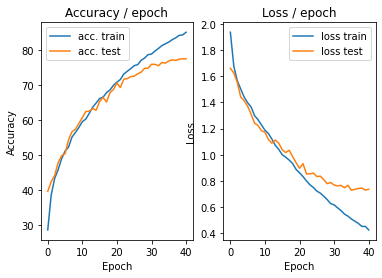

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.3912 (0.3912)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


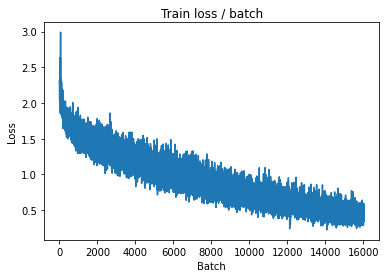

[TRAIN Batch 200/391]	Time 0.026s (0.051s)	Loss 0.4376 (0.4091)	Prec@1  86.7 ( 85.7)	Prec@5 100.0 ( 99.5)


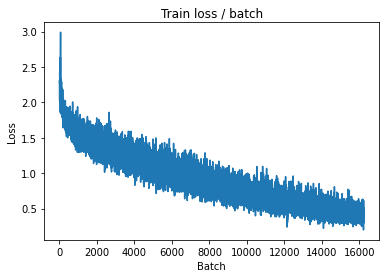


===============> Total time 19s	Avg loss 0.4114	Avg Prec@1 85.60 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.8259 (0.8259)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7727	Avg Prec@1 78.01 %	Avg Prec@5 98.12 %



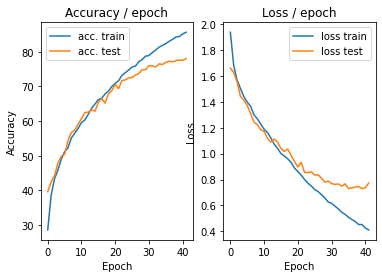

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 0.4876 (0.4876)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


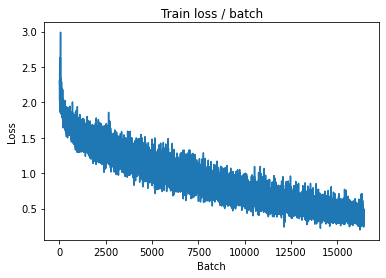

[TRAIN Batch 200/391]	Time 0.019s (0.048s)	Loss 0.4224 (0.3839)	Prec@1  84.4 ( 86.6)	Prec@5  98.4 ( 99.5)


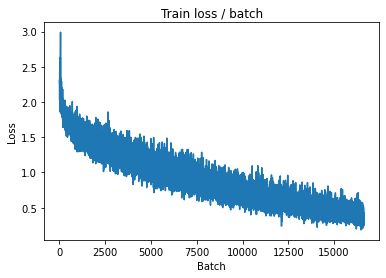


===============> Total time 19s	Avg loss 0.3972	Avg Prec@1 86.21 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.8125 (0.8125)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7598	Avg Prec@1 78.29 %	Avg Prec@5 98.06 %



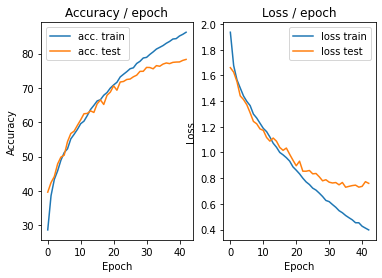

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.4141 (0.4141)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


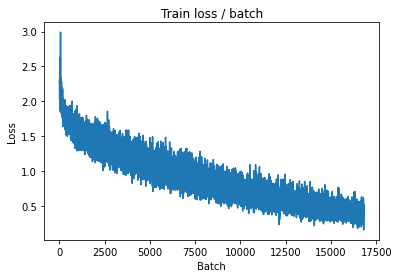

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 0.4267 (0.3865)	Prec@1  87.5 ( 86.7)	Prec@5  99.2 ( 99.4)


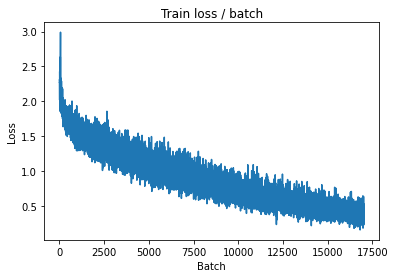


===============> Total time 18s	Avg loss 0.3853	Avg Prec@1 86.64 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.8533 (0.8533)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7421	Avg Prec@1 78.52 %	Avg Prec@5 98.26 %



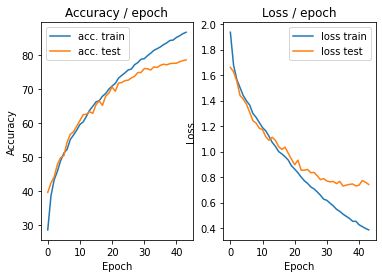

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.3828 (0.3828)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


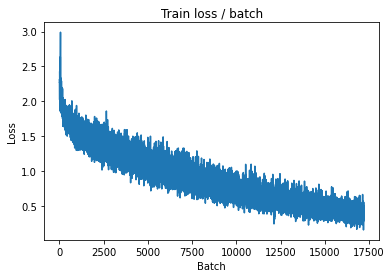

[TRAIN Batch 200/391]	Time 0.063s (0.050s)	Loss 0.3573 (0.3684)	Prec@1  88.3 ( 87.1)	Prec@5  98.4 ( 99.4)


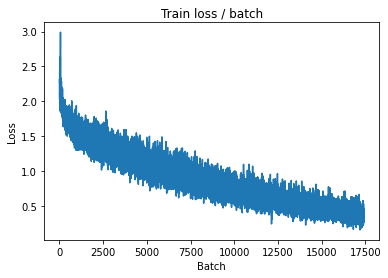


===============> Total time 19s	Avg loss 0.3720	Avg Prec@1 86.94 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.8222 (0.8222)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7706	Avg Prec@1 78.78 %	Avg Prec@5 98.28 %



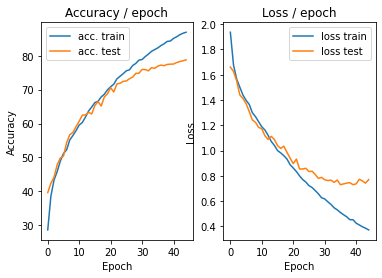

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.2913 (0.2913)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


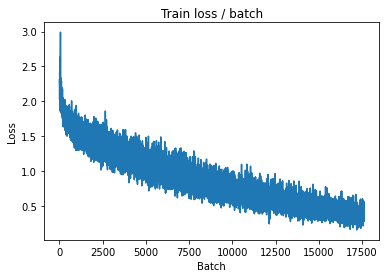

[TRAIN Batch 200/391]	Time 0.101s (0.052s)	Loss 0.5472 (0.3503)	Prec@1  80.5 ( 87.7)	Prec@5  99.2 ( 99.6)


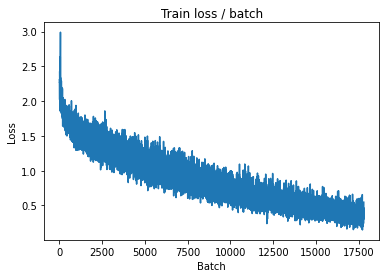


===============> Total time 19s	Avg loss 0.3578	Avg Prec@1 87.45 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.8867 (0.8867)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7753	Avg Prec@1 77.57 %	Avg Prec@5 98.16 %



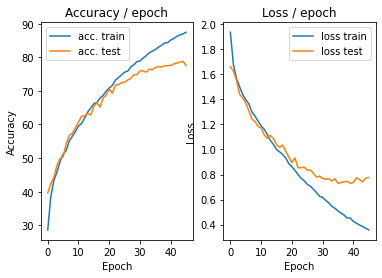

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.3398 (0.3398)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


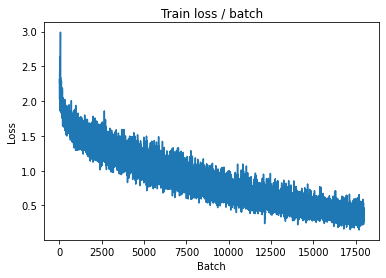

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.3345 (0.3379)	Prec@1  89.8 ( 88.3)	Prec@5 100.0 ( 99.6)


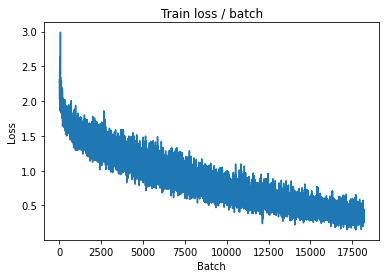


===============> Total time 19s	Avg loss 0.3470	Avg Prec@1 87.97 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.8140 (0.8140)	Prec@1  81.2 ( 81.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7669	Avg Prec@1 78.18 %	Avg Prec@5 98.27 %



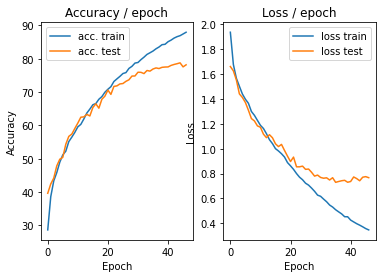

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.2637 (0.2637)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


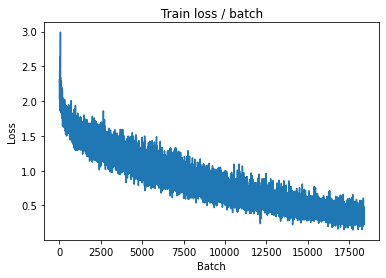

[TRAIN Batch 200/391]	Time 0.078s (0.050s)	Loss 0.3061 (0.3267)	Prec@1  88.3 ( 88.7)	Prec@5 100.0 ( 99.7)


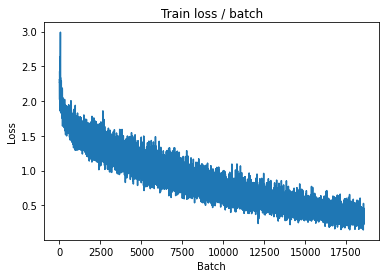


===============> Total time 19s	Avg loss 0.3288	Avg Prec@1 88.60 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.7660 (0.7660)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7770	Avg Prec@1 78.84 %	Avg Prec@5 98.43 %



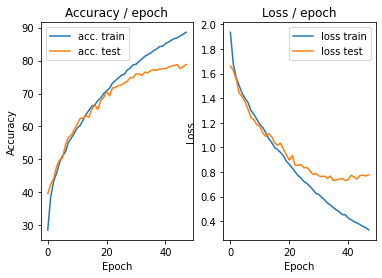

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.2411 (0.2411)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


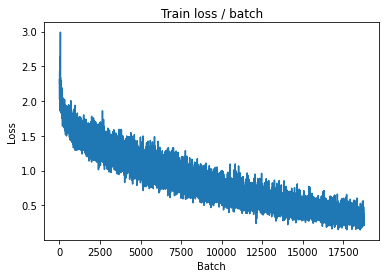

[TRAIN Batch 200/391]	Time 0.076s (0.050s)	Loss 0.3769 (0.3235)	Prec@1  89.1 ( 88.7)	Prec@5  99.2 ( 99.7)


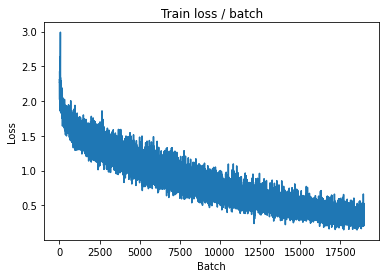


===============> Total time 19s	Avg loss 0.3267	Avg Prec@1 88.60 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.8202 (0.8202)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7591	Avg Prec@1 78.53 %	Avg Prec@5 98.33 %



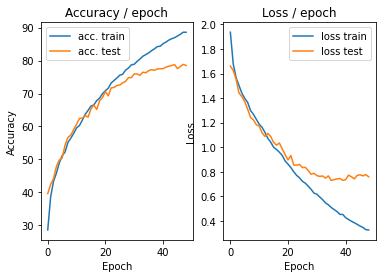

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.2851 (0.2851)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


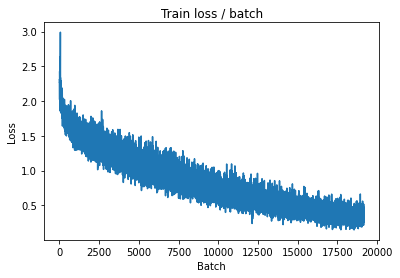

[TRAIN Batch 200/391]	Time 0.062s (0.050s)	Loss 0.2414 (0.3105)	Prec@1  92.2 ( 89.3)	Prec@5 100.0 ( 99.7)


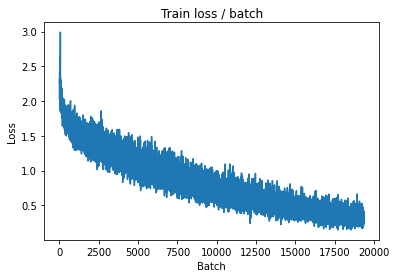


===============> Total time 19s	Avg loss 0.3131	Avg Prec@1 89.17 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.8532 (0.8532)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7695	Avg Prec@1 78.86 %	Avg Prec@5 98.25 %



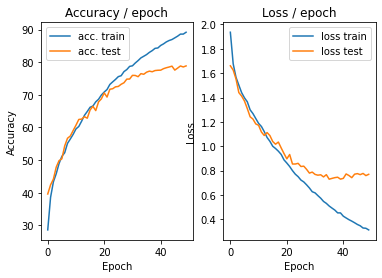

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.2305 (0.2305)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


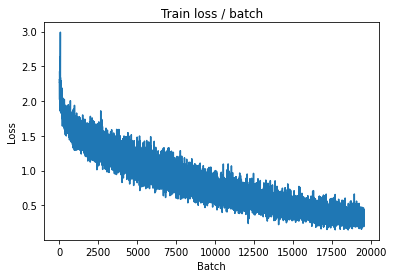

[TRAIN Batch 200/391]	Time 0.069s (0.049s)	Loss 0.2897 (0.3038)	Prec@1  88.3 ( 89.6)	Prec@5 100.0 ( 99.7)


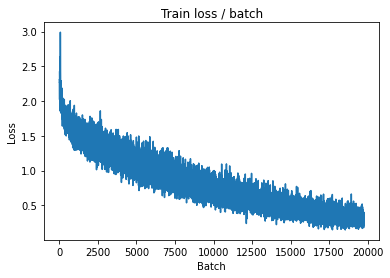


===============> Total time 19s	Avg loss 0.3042	Avg Prec@1 89.41 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.8022 (0.8022)	Prec@1  78.9 ( 78.9)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7732	Avg Prec@1 78.59 %	Avg Prec@5 98.13 %



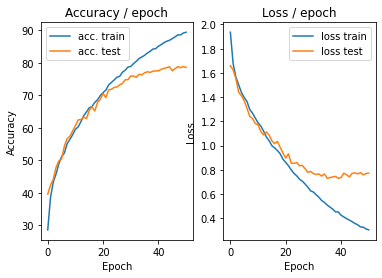

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.3081 (0.3081)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


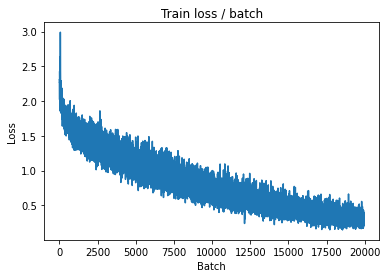

[TRAIN Batch 200/391]	Time 0.072s (0.049s)	Loss 0.2395 (0.2965)	Prec@1  91.4 ( 89.7)	Prec@5  98.4 ( 99.7)


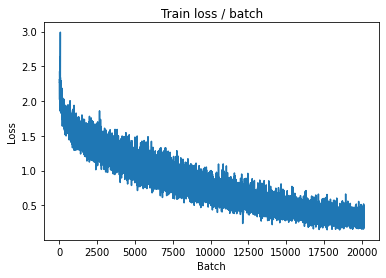


===============> Total time 18s	Avg loss 0.2963	Avg Prec@1 89.76 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.7564 (0.7564)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7592	Avg Prec@1 79.40 %	Avg Prec@5 98.25 %



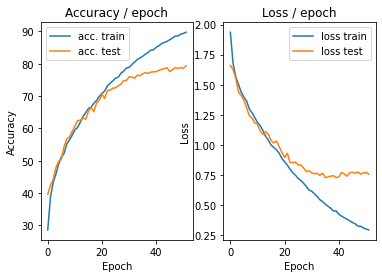

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.3420 (0.3420)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


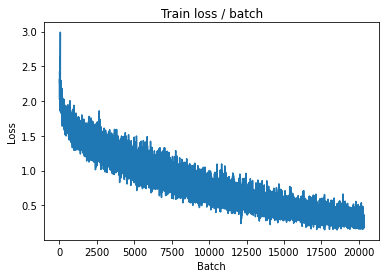

[TRAIN Batch 200/391]	Time 0.026s (0.048s)	Loss 0.3249 (0.2762)	Prec@1  91.4 ( 90.3)	Prec@5  99.2 ( 99.8)


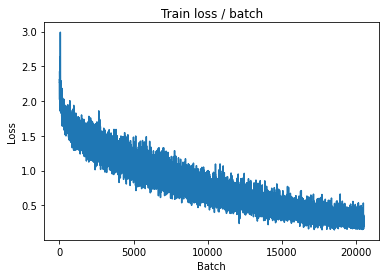


===============> Total time 18s	Avg loss 0.2835	Avg Prec@1 90.08 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.8012 (0.8012)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7719	Avg Prec@1 79.00 %	Avg Prec@5 98.44 %



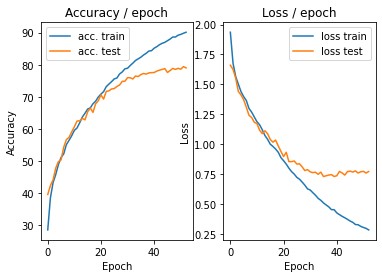

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.1675 (0.1675)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


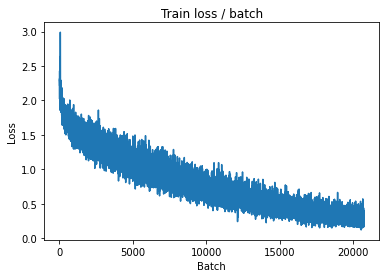

[TRAIN Batch 200/391]	Time 0.063s (0.049s)	Loss 0.2938 (0.2688)	Prec@1  88.3 ( 90.4)	Prec@5  99.2 ( 99.7)


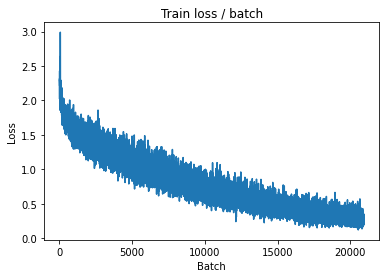


===============> Total time 19s	Avg loss 0.2709	Avg Prec@1 90.42 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.8144 (0.8144)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7801	Avg Prec@1 79.19 %	Avg Prec@5 98.42 %



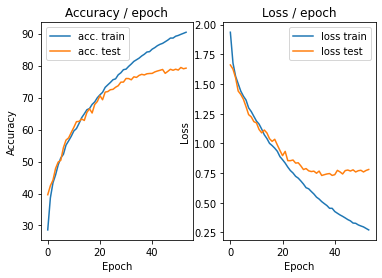

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.3376 (0.3376)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


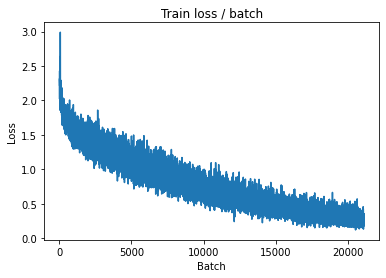

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 0.3172 (0.2592)	Prec@1  89.8 ( 90.8)	Prec@5 100.0 ( 99.8)


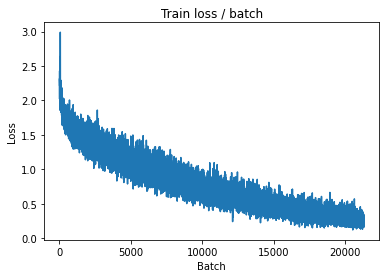


===============> Total time 19s	Avg loss 0.2619	Avg Prec@1 90.76 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.8307 (0.8307)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7751	Avg Prec@1 79.55 %	Avg Prec@5 98.35 %



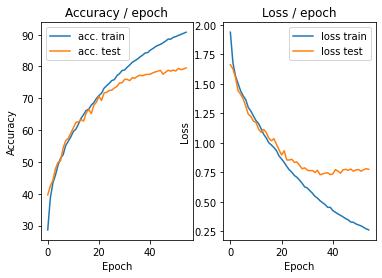

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.2076 (0.2076)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


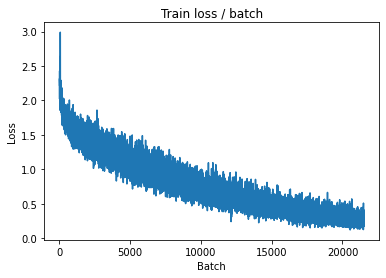

[TRAIN Batch 200/391]	Time 0.056s (0.051s)	Loss 0.2186 (0.2598)	Prec@1  92.2 ( 91.0)	Prec@5 100.0 ( 99.8)


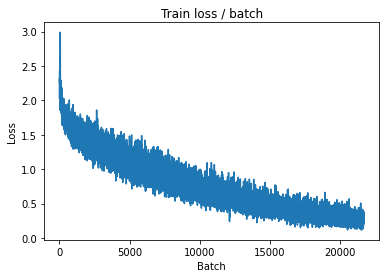


===============> Total time 19s	Avg loss 0.2613	Avg Prec@1 90.79 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.8627 (0.8627)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7964	Avg Prec@1 79.36 %	Avg Prec@5 98.37 %



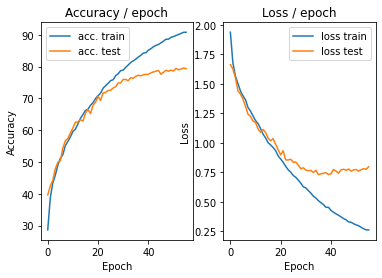

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.2057 (0.2057)	Prec@1  93.8 ( 93.8)	Prec@5  98.4 ( 98.4)


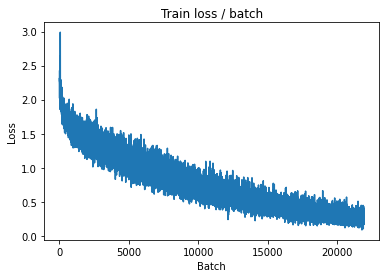

[TRAIN Batch 200/391]	Time 0.081s (0.050s)	Loss 0.4592 (0.2488)	Prec@1  89.1 ( 91.5)	Prec@5 100.0 ( 99.8)


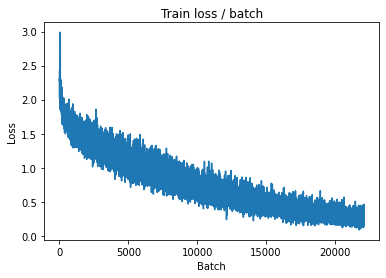


===============> Total time 19s	Avg loss 0.2516	Avg Prec@1 91.20 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.8499 (0.8499)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7811	Avg Prec@1 79.58 %	Avg Prec@5 98.36 %



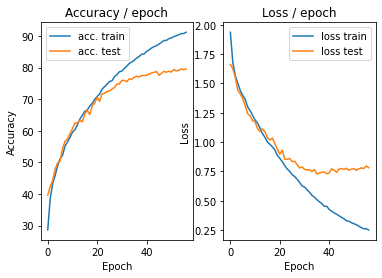

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.3986 (0.3986)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


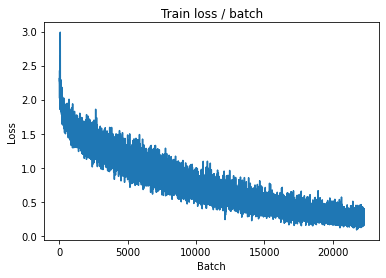

[TRAIN Batch 200/391]	Time 0.084s (0.048s)	Loss 0.1756 (0.2490)	Prec@1  92.2 ( 91.4)	Prec@5  99.2 ( 99.8)


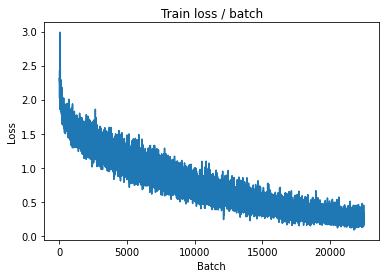


===============> Total time 18s	Avg loss 0.2446	Avg Prec@1 91.52 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.8561 (0.8561)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7956	Avg Prec@1 79.25 %	Avg Prec@5 98.36 %



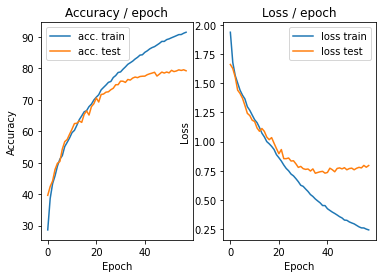

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.3301 (0.3301)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


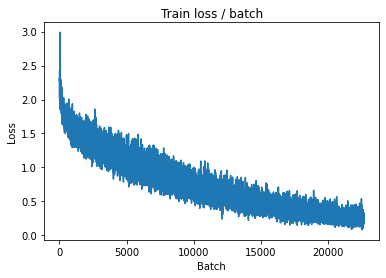

[TRAIN Batch 200/391]	Time 0.028s (0.051s)	Loss 0.2382 (0.2347)	Prec@1  93.0 ( 91.7)	Prec@5 100.0 ( 99.8)


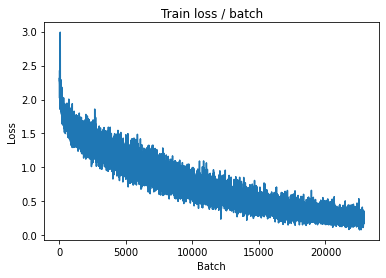


===============> Total time 19s	Avg loss 0.2374	Avg Prec@1 91.62 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.8913 (0.8913)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7863	Avg Prec@1 79.41 %	Avg Prec@5 98.37 %



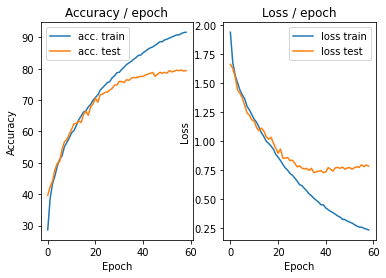

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.2362 (0.2362)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


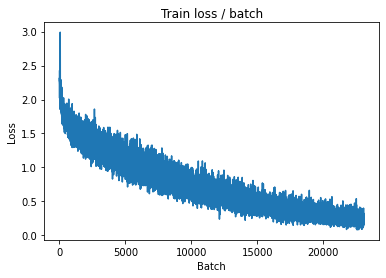

[TRAIN Batch 200/391]	Time 0.069s (0.051s)	Loss 0.2854 (0.2311)	Prec@1  89.8 ( 92.0)	Prec@5  98.4 ( 99.8)


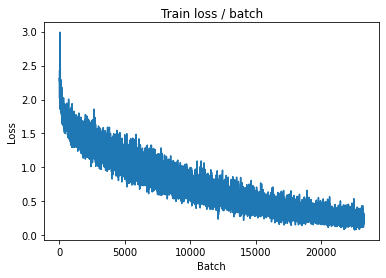


===============> Total time 19s	Avg loss 0.2299	Avg Prec@1 92.03 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.9364 (0.9364)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8206	Avg Prec@1 79.73 %	Avg Prec@5 98.32 %



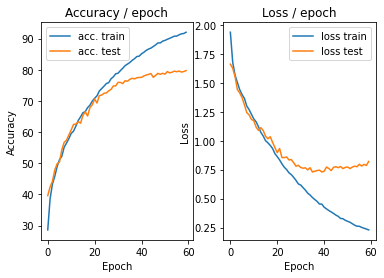

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.2233 (0.2233)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


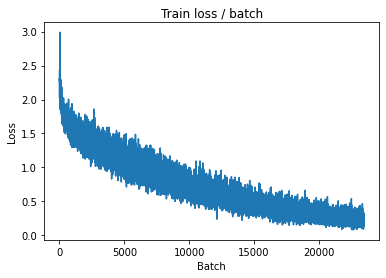

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 0.1708 (0.2321)	Prec@1  93.0 ( 91.7)	Prec@5 100.0 ( 99.8)


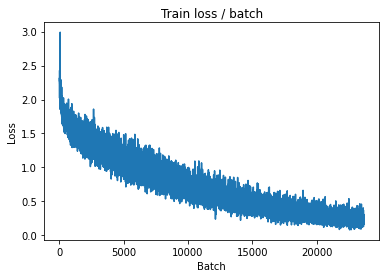


===============> Total time 19s	Avg loss 0.2258	Avg Prec@1 91.98 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.9867 (0.9867)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8198	Avg Prec@1 79.35 %	Avg Prec@5 98.23 %



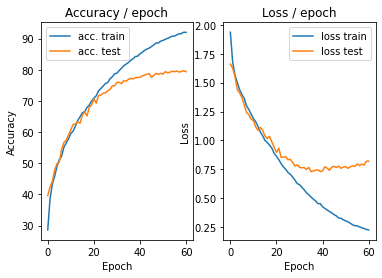

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.2077 (0.2077)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


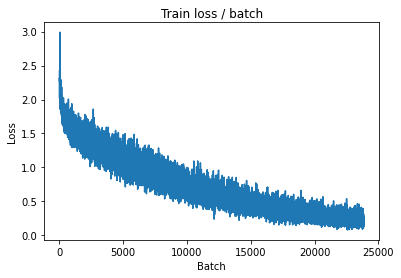

[TRAIN Batch 200/391]	Time 0.054s (0.050s)	Loss 0.2226 (0.2225)	Prec@1  88.3 ( 92.3)	Prec@5  99.2 ( 99.9)


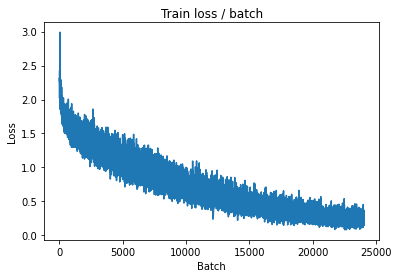


===============> Total time 19s	Avg loss 0.2178	Avg Prec@1 92.46 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.9270 (0.9270)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8142	Avg Prec@1 79.52 %	Avg Prec@5 98.30 %



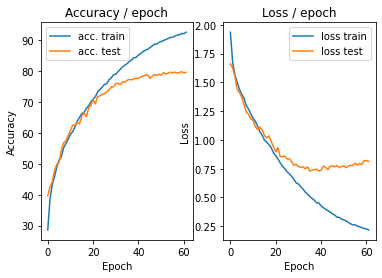

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.2015 (0.2015)	Prec@1  96.1 ( 96.1)	Prec@5  99.2 ( 99.2)


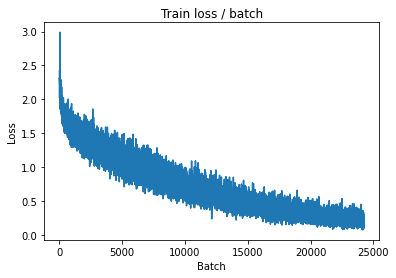

[TRAIN Batch 200/391]	Time 0.018s (0.050s)	Loss 0.1739 (0.2062)	Prec@1  94.5 ( 92.8)	Prec@5 100.0 ( 99.9)


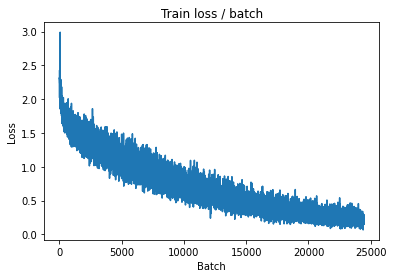


===============> Total time 19s	Avg loss 0.2129	Avg Prec@1 92.57 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.8575 (0.8575)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8100	Avg Prec@1 79.51 %	Avg Prec@5 98.34 %



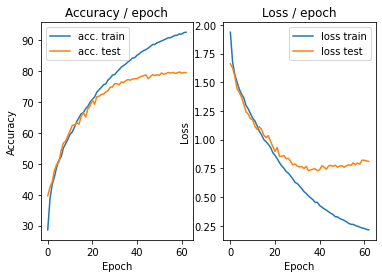

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.2328 (0.2328)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


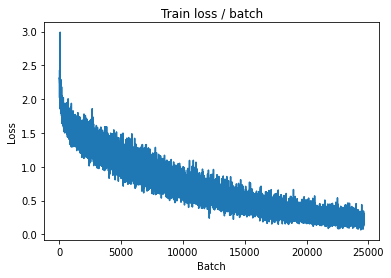

[TRAIN Batch 200/391]	Time 0.019s (0.050s)	Loss 0.2403 (0.2088)	Prec@1  92.2 ( 92.8)	Prec@5  99.2 ( 99.9)


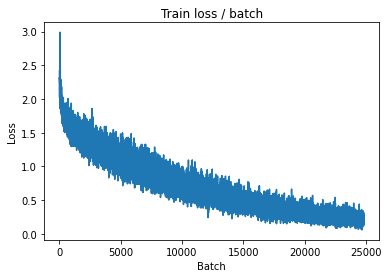


===============> Total time 19s	Avg loss 0.2068	Avg Prec@1 92.77 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.9030 (0.9030)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8160	Avg Prec@1 79.58 %	Avg Prec@5 98.36 %



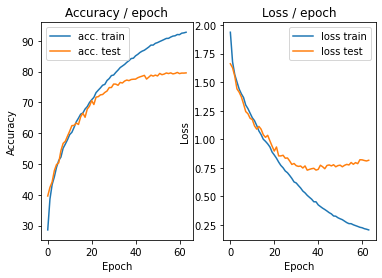

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.1339 (0.1339)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


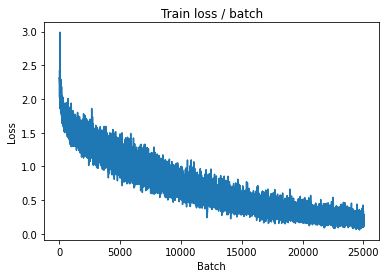

[TRAIN Batch 200/391]	Time 0.058s (0.050s)	Loss 0.1006 (0.1952)	Prec@1  98.4 ( 93.3)	Prec@5 100.0 ( 99.9)


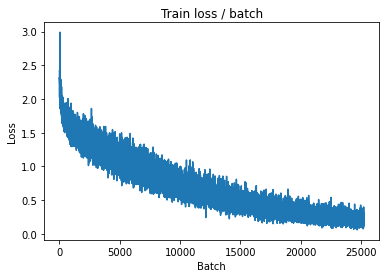


===============> Total time 19s	Avg loss 0.1992	Avg Prec@1 93.06 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.9115 (0.9115)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8211	Avg Prec@1 79.79 %	Avg Prec@5 98.24 %



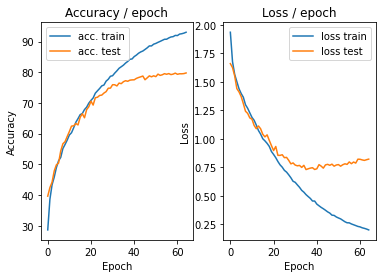

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.1492 (0.1492)	Prec@1  96.1 ( 96.1)	Prec@5  99.2 ( 99.2)


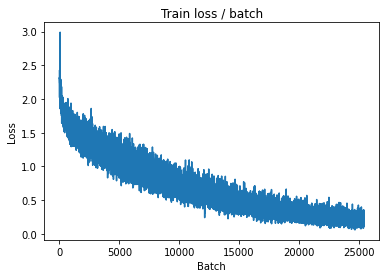

[TRAIN Batch 200/391]	Time 0.025s (0.051s)	Loss 0.2290 (0.1993)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.9)


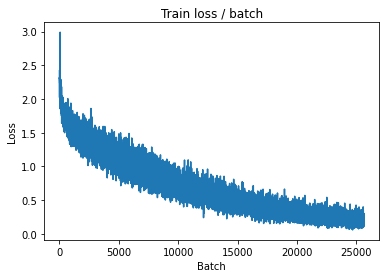


===============> Total time 19s	Avg loss 0.1964	Avg Prec@1 93.15 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.9343 (0.9343)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8392	Avg Prec@1 79.91 %	Avg Prec@5 98.29 %



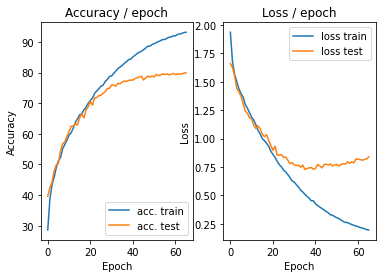

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.2194 (0.2194)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


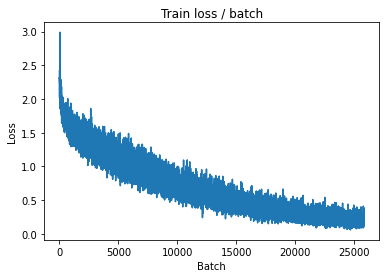

[TRAIN Batch 200/391]	Time 0.025s (0.049s)	Loss 0.0891 (0.1896)	Prec@1  97.7 ( 93.4)	Prec@5 100.0 ( 99.9)


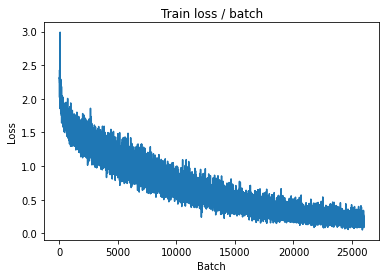


===============> Total time 18s	Avg loss 0.1920	Avg Prec@1 93.26 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.9467 (0.9467)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8410	Avg Prec@1 80.02 %	Avg Prec@5 98.48 %



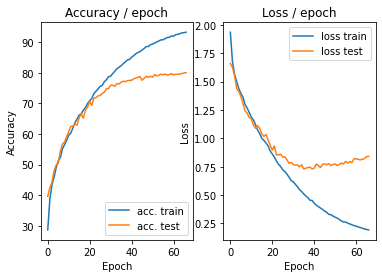

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.2412 (0.2412)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


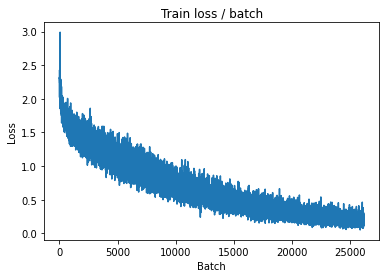

[TRAIN Batch 200/391]	Time 0.020s (0.049s)	Loss 0.1476 (0.1859)	Prec@1  95.3 ( 93.7)	Prec@5 100.0 ( 99.9)


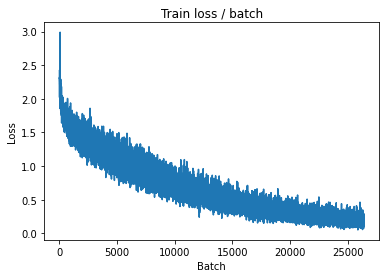


===============> Total time 18s	Avg loss 0.1857	Avg Prec@1 93.61 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.9529 (0.9529)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8518	Avg Prec@1 79.75 %	Avg Prec@5 98.39 %



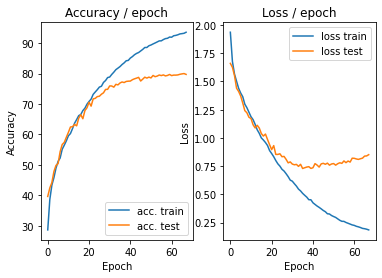

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.2583 (0.2583)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


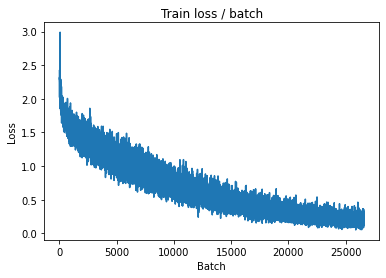

[TRAIN Batch 200/391]	Time 0.057s (0.050s)	Loss 0.1146 (0.1863)	Prec@1  97.7 ( 93.7)	Prec@5 100.0 ( 99.9)


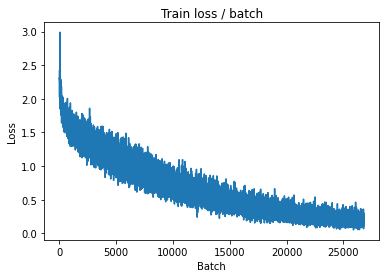


===============> Total time 19s	Avg loss 0.1875	Avg Prec@1 93.55 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 0.9663 (0.9663)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8530	Avg Prec@1 80.07 %	Avg Prec@5 98.31 %



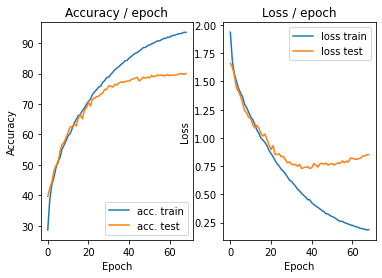

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.1060 (0.1060)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


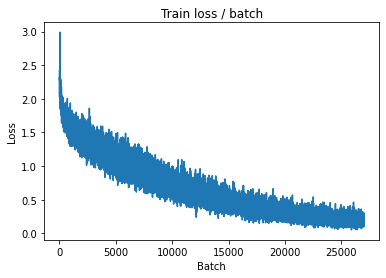

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 0.2013 (0.1744)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.9)


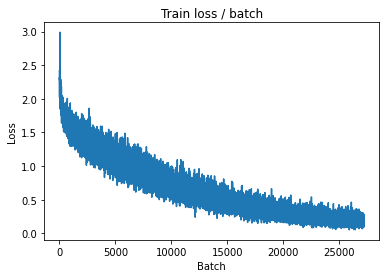


===============> Total time 19s	Avg loss 0.1752	Avg Prec@1 93.86 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.9036 (0.9036)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8483	Avg Prec@1 79.82 %	Avg Prec@5 98.27 %



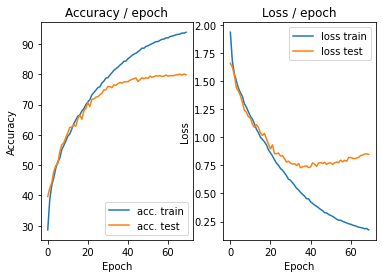

=== EPOCH 71 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.0728 (0.0728)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


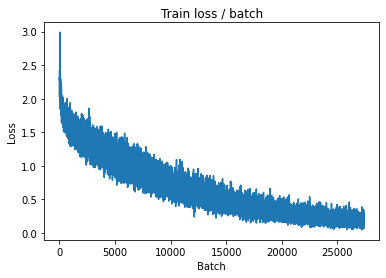

[TRAIN Batch 200/391]	Time 0.025s (0.048s)	Loss 0.0825 (0.1726)	Prec@1  97.7 ( 94.2)	Prec@5 100.0 ( 99.9)


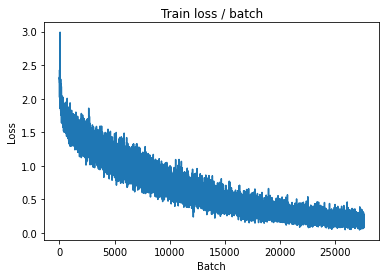


===============> Total time 18s	Avg loss 0.1733	Avg Prec@1 94.06 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.9214 (0.9214)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8576	Avg Prec@1 79.90 %	Avg Prec@5 98.38 %



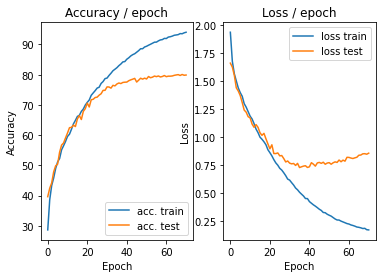

=== EPOCH 72 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2021 (0.2021)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


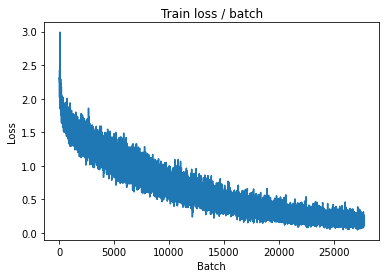

[TRAIN Batch 200/391]	Time 0.075s (0.050s)	Loss 0.1721 (0.1731)	Prec@1  93.0 ( 94.0)	Prec@5 100.0 ( 99.9)


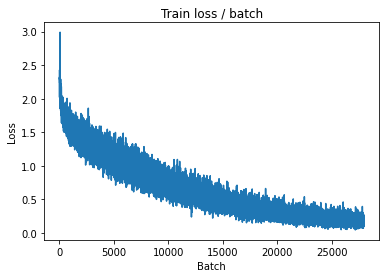


===============> Total time 19s	Avg loss 0.1715	Avg Prec@1 94.07 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.9304 (0.9304)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8616	Avg Prec@1 80.04 %	Avg Prec@5 98.38 %



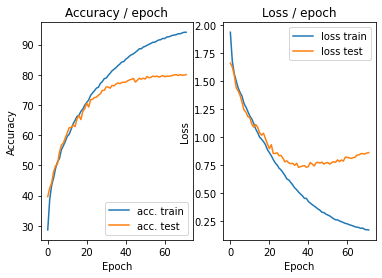

=== EPOCH 73 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.1748 (0.1748)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


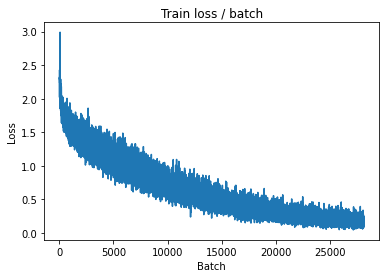

[TRAIN Batch 200/391]	Time 0.033s (0.048s)	Loss 0.1288 (0.1666)	Prec@1  96.1 ( 94.3)	Prec@5 100.0 ( 99.9)


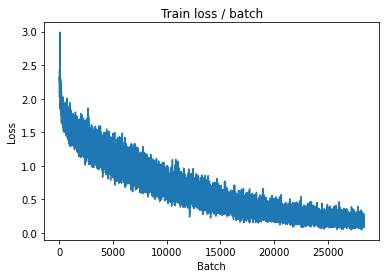


===============> Total time 19s	Avg loss 0.1690	Avg Prec@1 94.14 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 1.0024 (1.0024)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8776	Avg Prec@1 80.00 %	Avg Prec@5 98.31 %



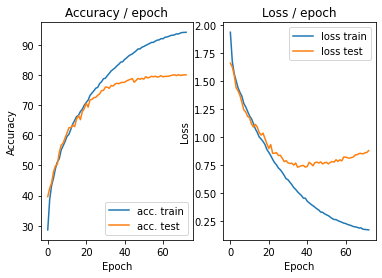

=== EPOCH 74 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 0.1954 (0.1954)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


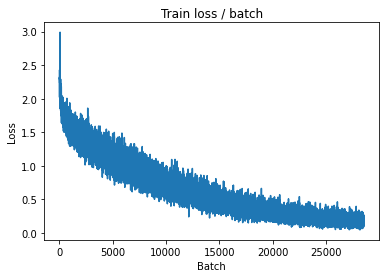

[TRAIN Batch 200/391]	Time 0.059s (0.049s)	Loss 0.1788 (0.1632)	Prec@1  94.5 ( 94.4)	Prec@5 100.0 ( 99.9)


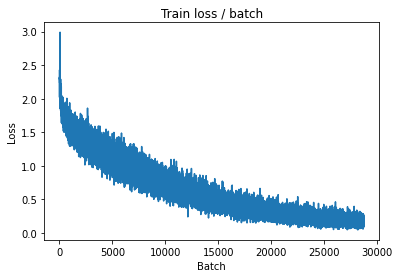


===============> Total time 19s	Avg loss 0.1648	Avg Prec@1 94.32 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.9312 (0.9312)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8871	Avg Prec@1 80.15 %	Avg Prec@5 98.41 %



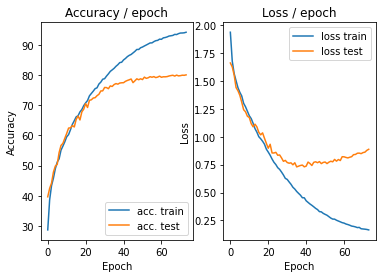

=== EPOCH 75 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.1101 (0.1101)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


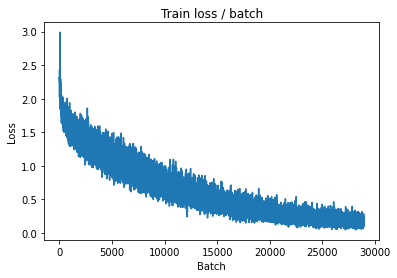

[TRAIN Batch 200/391]	Time 0.084s (0.051s)	Loss 0.1672 (0.1598)	Prec@1  93.8 ( 94.5)	Prec@5 100.0 ( 99.9)


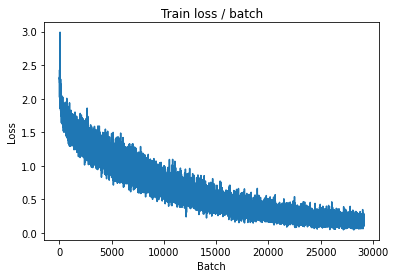


===============> Total time 19s	Avg loss 0.1615	Avg Prec@1 94.47 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.9316 (0.9316)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8766	Avg Prec@1 80.31 %	Avg Prec@5 98.34 %



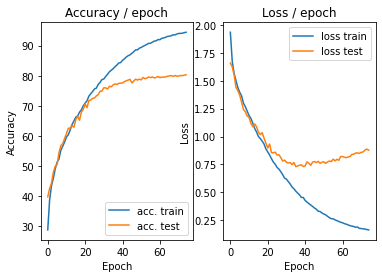

=== EPOCH 76 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.1478 (0.1478)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


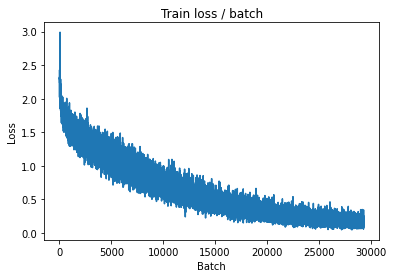

[TRAIN Batch 200/391]	Time 0.070s (0.049s)	Loss 0.1095 (0.1598)	Prec@1  97.7 ( 94.5)	Prec@5 100.0 ( 99.9)


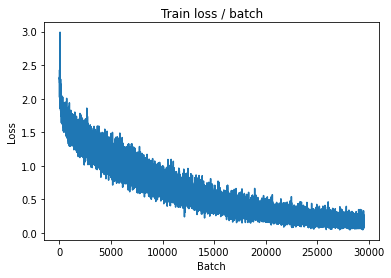


===============> Total time 19s	Avg loss 0.1607	Avg Prec@1 94.46 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.9712 (0.9712)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8813	Avg Prec@1 80.14 %	Avg Prec@5 98.34 %



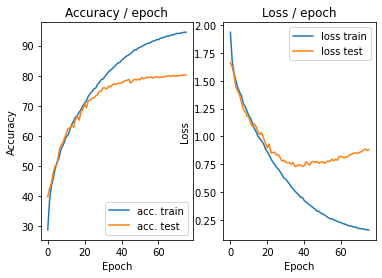

=== EPOCH 77 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.2920 (0.2920)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


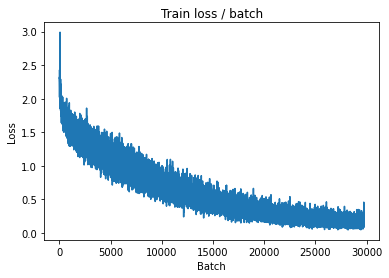

[TRAIN Batch 200/391]	Time 0.059s (0.051s)	Loss 0.0899 (0.1550)	Prec@1  96.9 ( 94.5)	Prec@5 100.0 ( 99.9)


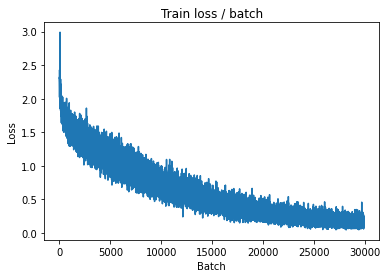


===============> Total time 19s	Avg loss 0.1560	Avg Prec@1 94.51 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.9538 (0.9538)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8872	Avg Prec@1 80.16 %	Avg Prec@5 98.26 %



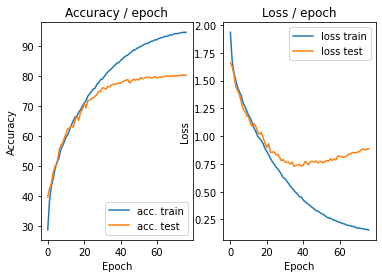

=== EPOCH 78 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.1587 (0.1587)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


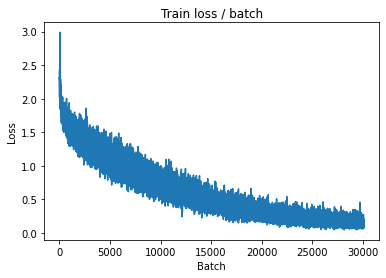

[TRAIN Batch 200/391]	Time 0.062s (0.049s)	Loss 0.1914 (0.1597)	Prec@1  93.0 ( 94.6)	Prec@5 100.0 ( 99.9)


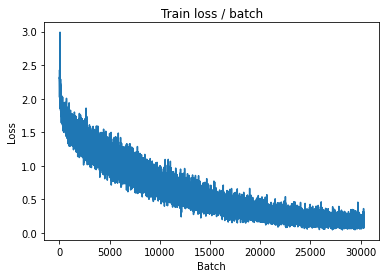


===============> Total time 19s	Avg loss 0.1579	Avg Prec@1 94.58 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.9093 (0.9093)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8815	Avg Prec@1 80.37 %	Avg Prec@5 98.22 %



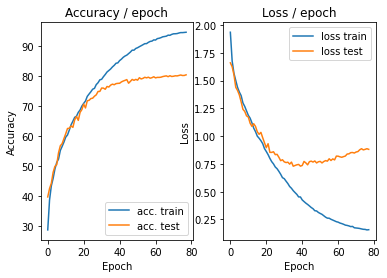

=== EPOCH 79 =====

[TRAIN Batch 000/391]	Time 0.287s (0.287s)	Loss 0.1560 (0.1560)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


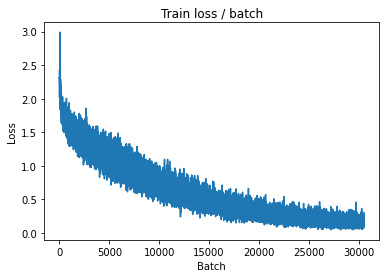

[TRAIN Batch 200/391]	Time 0.020s (0.050s)	Loss 0.1111 (0.1509)	Prec@1  96.9 ( 94.7)	Prec@5 100.0 ( 99.9)


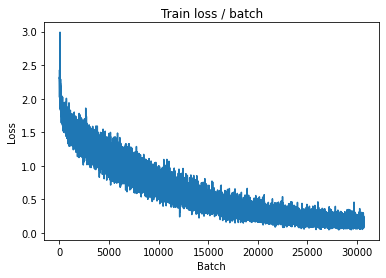


===============> Total time 19s	Avg loss 0.1529	Avg Prec@1 94.71 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.9669 (0.9669)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8815	Avg Prec@1 80.31 %	Avg Prec@5 98.36 %



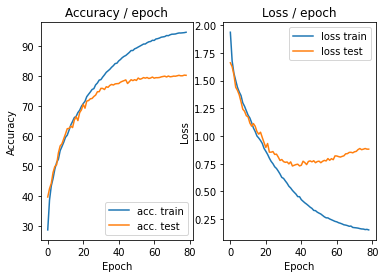

=== EPOCH 80 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.1807 (0.1807)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


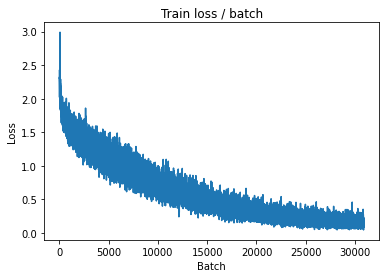

[TRAIN Batch 200/391]	Time 0.058s (0.050s)	Loss 0.1338 (0.1443)	Prec@1  95.3 ( 95.0)	Prec@5 100.0 (100.0)


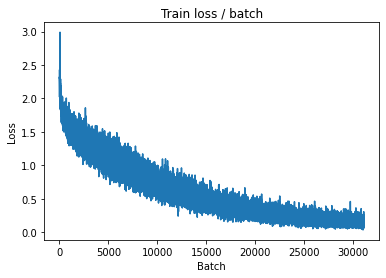


===============> Total time 19s	Avg loss 0.1464	Avg Prec@1 94.92 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.9313 (0.9313)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8978	Avg Prec@1 80.39 %	Avg Prec@5 98.35 %



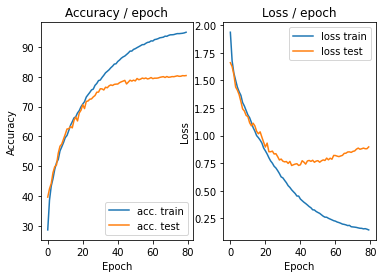

=== EPOCH 81 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.1591 (0.1591)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


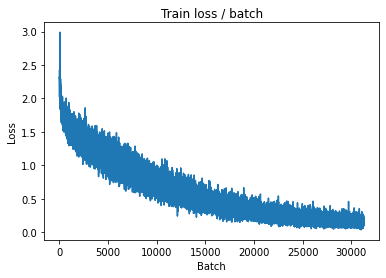

[TRAIN Batch 200/391]	Time 0.035s (0.049s)	Loss 0.1126 (0.1469)	Prec@1  95.3 ( 95.0)	Prec@5 100.0 ( 99.9)


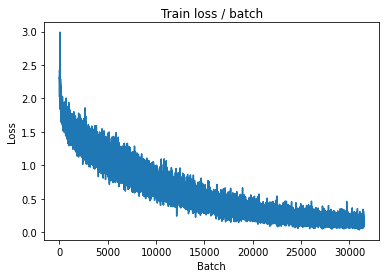


===============> Total time 18s	Avg loss 0.1477	Avg Prec@1 94.93 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.9936 (0.9936)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8992	Avg Prec@1 80.34 %	Avg Prec@5 98.36 %



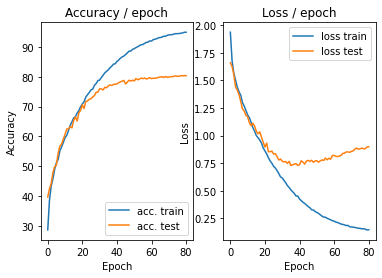

=== EPOCH 82 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.1483 (0.1483)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


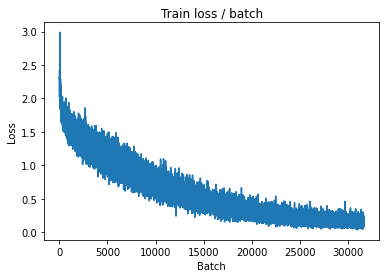

[TRAIN Batch 200/391]	Time 0.018s (0.051s)	Loss 0.2446 (0.1493)	Prec@1  91.4 ( 94.8)	Prec@5 100.0 ( 99.9)


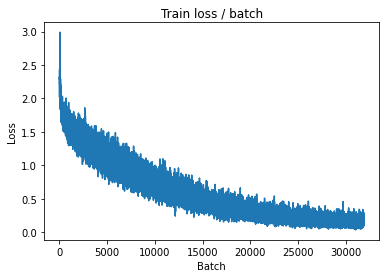


===============> Total time 19s	Avg loss 0.1502	Avg Prec@1 94.78 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.237s (0.237s)	Loss 0.9667 (0.9667)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8975	Avg Prec@1 80.21 %	Avg Prec@5 98.29 %



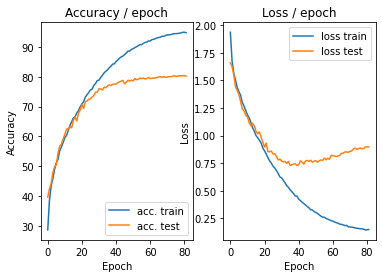

=== EPOCH 83 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.1057 (0.1057)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


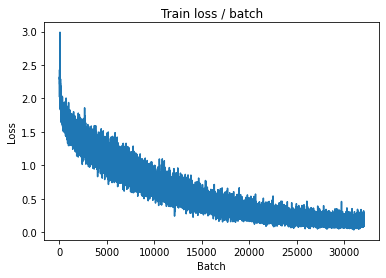

[TRAIN Batch 200/391]	Time 0.024s (0.048s)	Loss 0.1064 (0.1377)	Prec@1  96.9 ( 95.3)	Prec@5 100.0 ( 99.9)


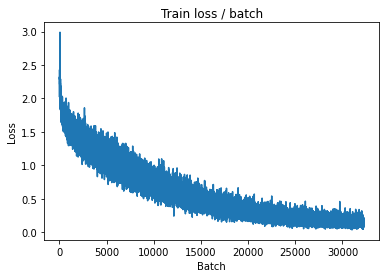


===============> Total time 18s	Avg loss 0.1411	Avg Prec@1 95.14 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.9851 (0.9851)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8966	Avg Prec@1 80.37 %	Avg Prec@5 98.38 %



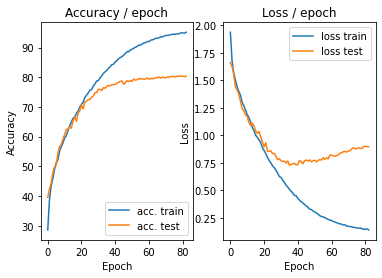

=== EPOCH 84 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.1937 (0.1937)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


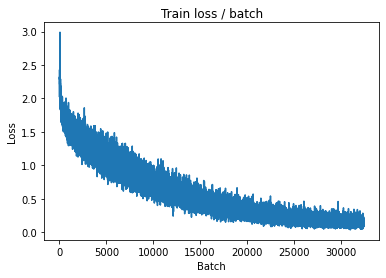

[TRAIN Batch 200/391]	Time 0.089s (0.049s)	Loss 0.1956 (0.1431)	Prec@1  94.5 ( 95.1)	Prec@5 100.0 ( 99.9)


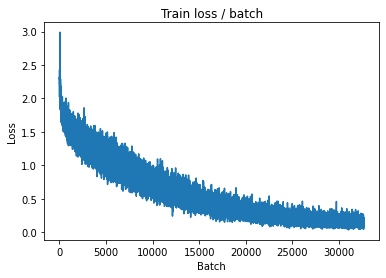


===============> Total time 18s	Avg loss 0.1413	Avg Prec@1 95.10 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.9864 (0.9864)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9043	Avg Prec@1 80.27 %	Avg Prec@5 98.34 %



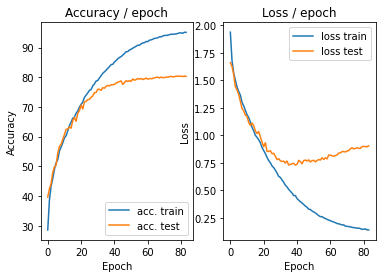

=== EPOCH 85 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.0914 (0.0914)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


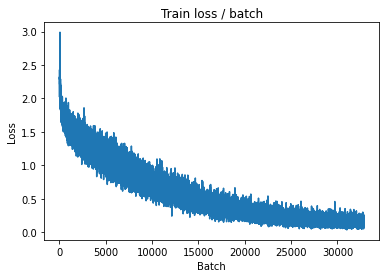

[TRAIN Batch 200/391]	Time 0.025s (0.050s)	Loss 0.1469 (0.1331)	Prec@1  95.3 ( 95.4)	Prec@5 100.0 ( 99.9)


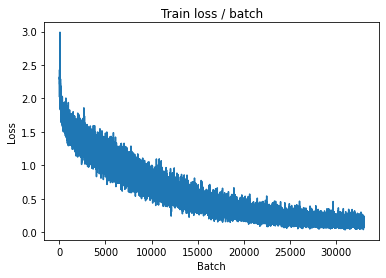


===============> Total time 19s	Avg loss 0.1363	Avg Prec@1 95.32 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 1.0004 (1.0004)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9060	Avg Prec@1 80.30 %	Avg Prec@5 98.33 %



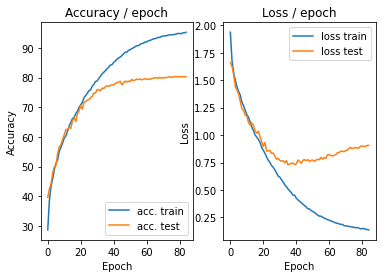

=== EPOCH 86 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.1364 (0.1364)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


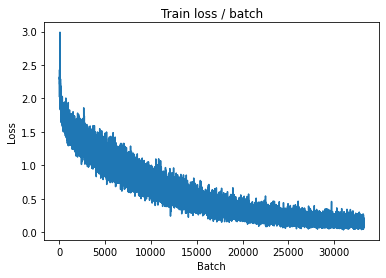

[TRAIN Batch 200/391]	Time 0.027s (0.048s)	Loss 0.1065 (0.1393)	Prec@1  95.3 ( 95.2)	Prec@5  99.2 ( 99.9)


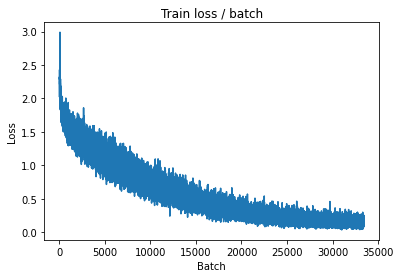


===============> Total time 18s	Avg loss 0.1358	Avg Prec@1 95.29 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.9944 (0.9944)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9070	Avg Prec@1 80.31 %	Avg Prec@5 98.30 %



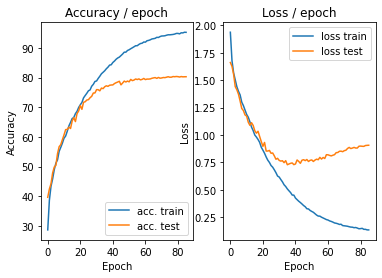

=== EPOCH 87 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.2048 (0.2048)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


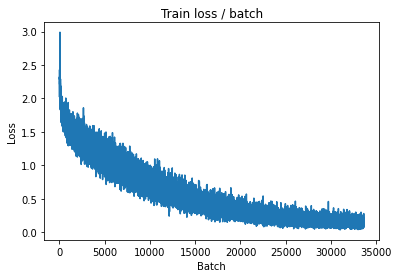

[TRAIN Batch 200/391]	Time 0.018s (0.047s)	Loss 0.0971 (0.1331)	Prec@1  95.3 ( 95.4)	Prec@5 100.0 ( 99.9)


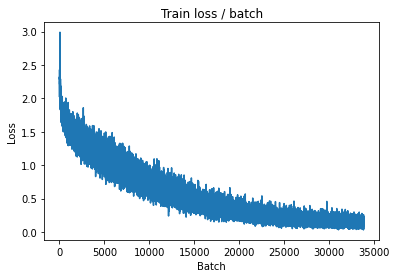


===============> Total time 18s	Avg loss 0.1348	Avg Prec@1 95.35 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.9699 (0.9699)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9005	Avg Prec@1 80.30 %	Avg Prec@5 98.37 %



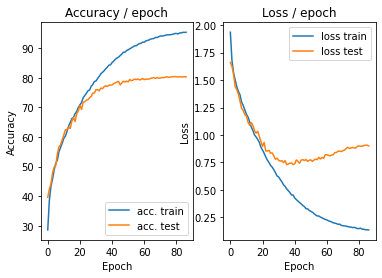

=== EPOCH 88 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.1020 (0.1020)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


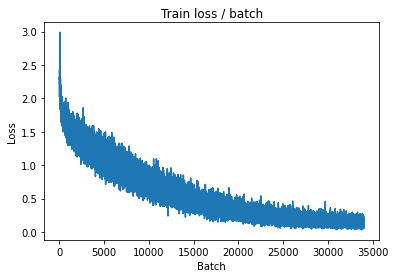

[TRAIN Batch 200/391]	Time 0.019s (0.049s)	Loss 0.0442 (0.1337)	Prec@1 100.0 ( 95.4)	Prec@5 100.0 ( 99.9)


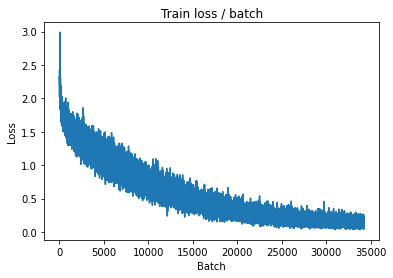


===============> Total time 18s	Avg loss 0.1326	Avg Prec@1 95.46 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 1.0068 (1.0068)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9078	Avg Prec@1 80.41 %	Avg Prec@5 98.33 %



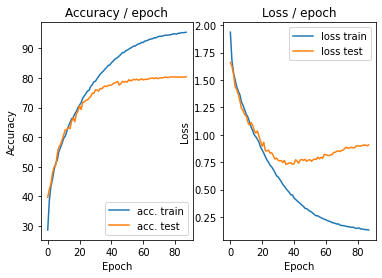

=== EPOCH 89 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.1922 (0.1922)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


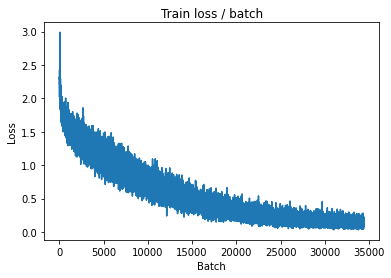

[TRAIN Batch 200/391]	Time 0.020s (0.051s)	Loss 0.1297 (0.1322)	Prec@1  95.3 ( 95.4)	Prec@5 100.0 ( 99.9)


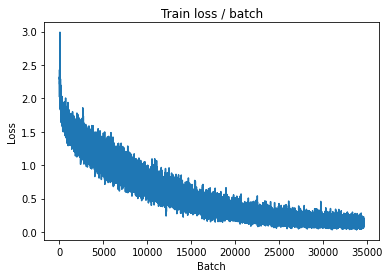


===============> Total time 19s	Avg loss 0.1306	Avg Prec@1 95.49 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.9696 (0.9696)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9054	Avg Prec@1 80.27 %	Avg Prec@5 98.40 %



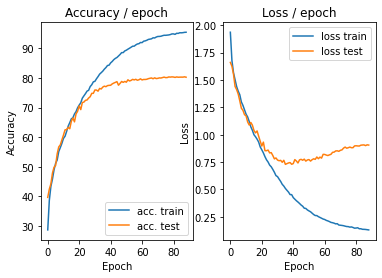

=== EPOCH 90 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.0788 (0.0788)	Prec@1  97.7 ( 97.7)	Prec@5  99.2 ( 99.2)


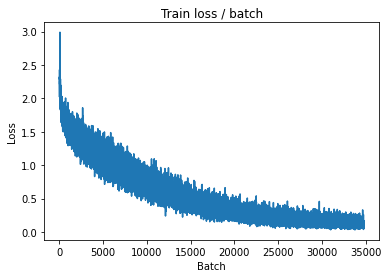

[TRAIN Batch 200/391]	Time 0.055s (0.048s)	Loss 0.1628 (0.1283)	Prec@1  94.5 ( 95.7)	Prec@5 100.0 ( 99.9)


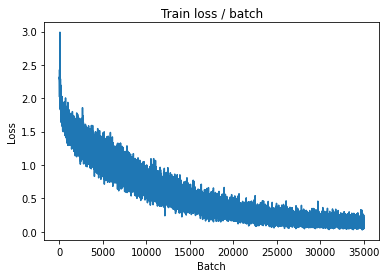


===============> Total time 18s	Avg loss 0.1311	Avg Prec@1 95.56 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.9820 (0.9820)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9089	Avg Prec@1 80.32 %	Avg Prec@5 98.41 %



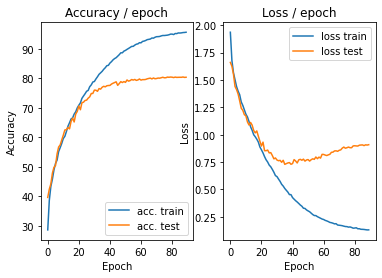

=== EPOCH 91 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.1709 (0.1709)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


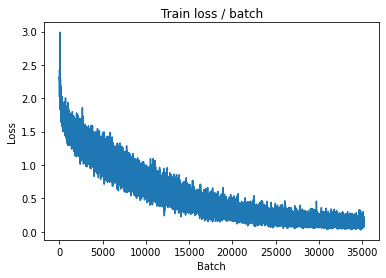

[TRAIN Batch 200/391]	Time 0.053s (0.048s)	Loss 0.0848 (0.1285)	Prec@1  98.4 ( 95.8)	Prec@5 100.0 (100.0)


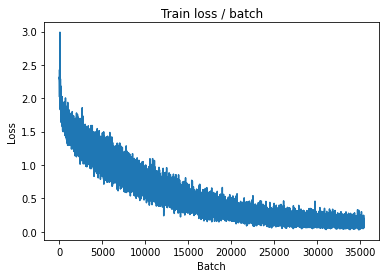


===============> Total time 18s	Avg loss 0.1292	Avg Prec@1 95.69 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.9899 (0.9899)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9129	Avg Prec@1 80.47 %	Avg Prec@5 98.39 %



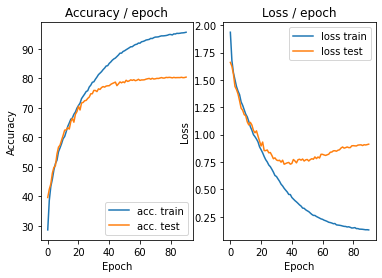

=== EPOCH 92 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.1526 (0.1526)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


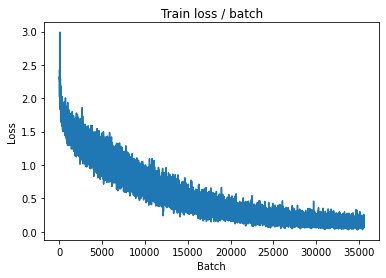

[TRAIN Batch 200/391]	Time 0.077s (0.049s)	Loss 0.1541 (0.1276)	Prec@1  94.5 ( 95.7)	Prec@5 100.0 (100.0)


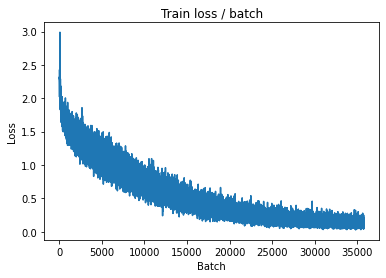


===============> Total time 18s	Avg loss 0.1286	Avg Prec@1 95.64 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.9979 (0.9979)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9158	Avg Prec@1 80.25 %	Avg Prec@5 98.33 %



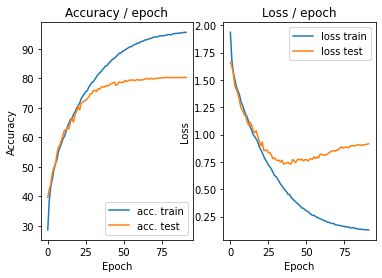

=== EPOCH 93 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.0959 (0.0959)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


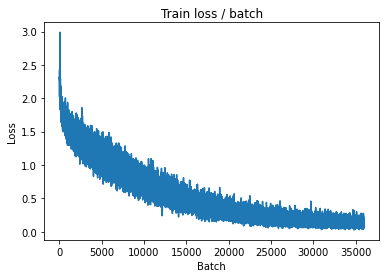

[TRAIN Batch 200/391]	Time 0.032s (0.049s)	Loss 0.0711 (0.1277)	Prec@1  96.9 ( 95.7)	Prec@5 100.0 (100.0)


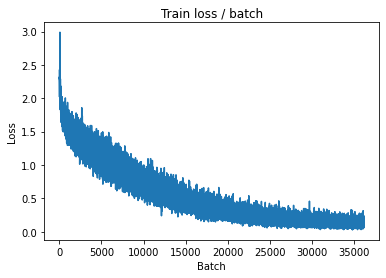


===============> Total time 18s	Avg loss 0.1258	Avg Prec@1 95.70 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.9938 (0.9938)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9215	Avg Prec@1 80.42 %	Avg Prec@5 98.41 %



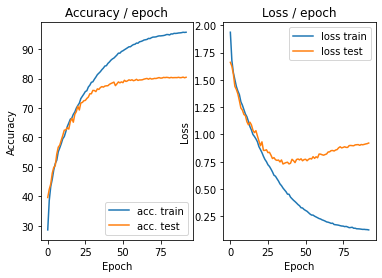

=== EPOCH 94 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.1434 (0.1434)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


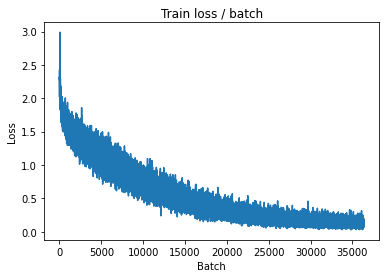

[TRAIN Batch 200/391]	Time 0.045s (0.049s)	Loss 0.1446 (0.1228)	Prec@1  95.3 ( 95.8)	Prec@5 100.0 (100.0)


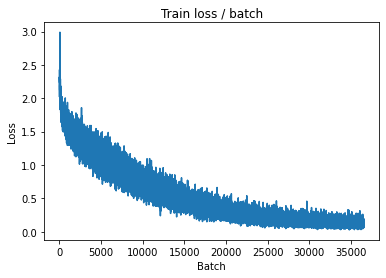


===============> Total time 19s	Avg loss 0.1234	Avg Prec@1 95.79 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.0093 (1.0093)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9162	Avg Prec@1 80.18 %	Avg Prec@5 98.46 %



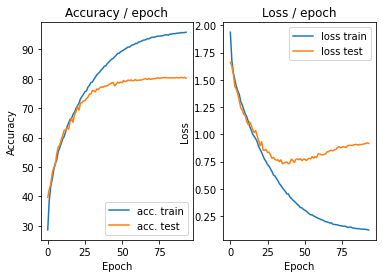

=== EPOCH 95 =====

[TRAIN Batch 000/391]	Time 0.376s (0.376s)	Loss 0.1294 (0.1294)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


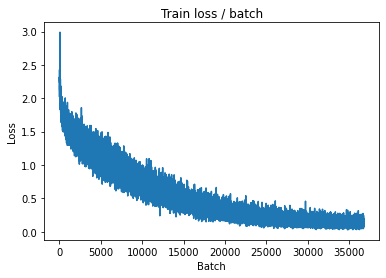

[TRAIN Batch 200/391]	Time 0.028s (0.050s)	Loss 0.0812 (0.1207)	Prec@1  97.7 ( 95.9)	Prec@5 100.0 (100.0)


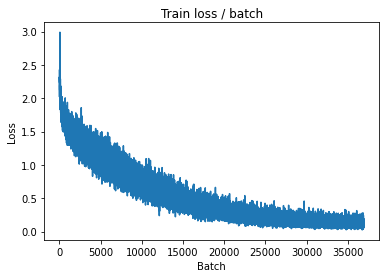


===============> Total time 19s	Avg loss 0.1251	Avg Prec@1 95.77 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 1.0089 (1.0089)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9193	Avg Prec@1 80.00 %	Avg Prec@5 98.42 %



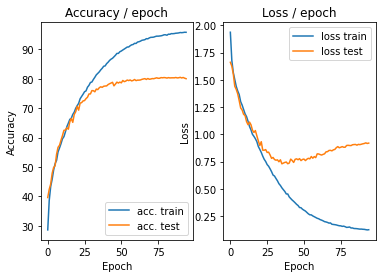

=== EPOCH 96 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.1109 (0.1109)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


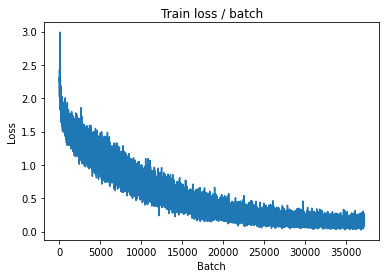

[TRAIN Batch 200/391]	Time 0.031s (0.050s)	Loss 0.0806 (0.1214)	Prec@1  97.7 ( 95.9)	Prec@5 100.0 (100.0)


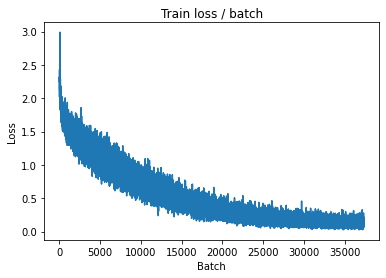


===============> Total time 18s	Avg loss 0.1224	Avg Prec@1 95.82 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.9970 (0.9970)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9208	Avg Prec@1 80.36 %	Avg Prec@5 98.42 %



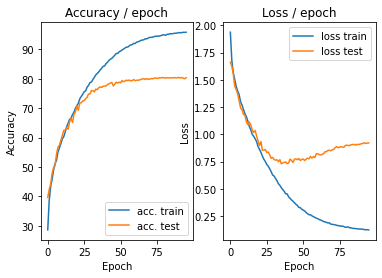

=== EPOCH 97 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.0710 (0.0710)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


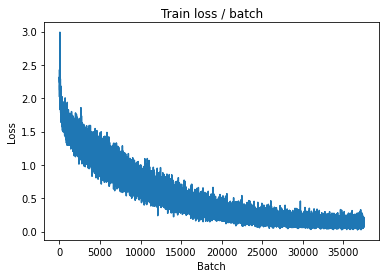

[TRAIN Batch 200/391]	Time 0.024s (0.050s)	Loss 0.1289 (0.1203)	Prec@1  96.1 ( 95.7)	Prec@5 100.0 (100.0)


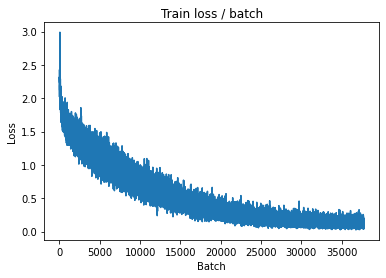


===============> Total time 18s	Avg loss 0.1186	Avg Prec@1 95.85 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.9949 (0.9949)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9273	Avg Prec@1 80.25 %	Avg Prec@5 98.47 %



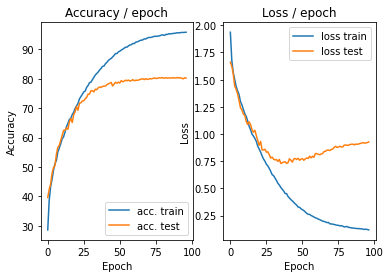

=== EPOCH 98 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.0839 (0.0839)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


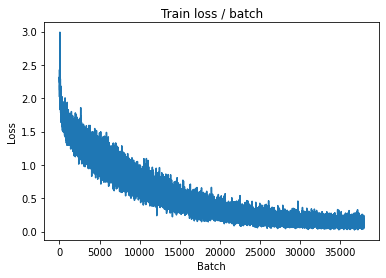

[TRAIN Batch 200/391]	Time 0.072s (0.049s)	Loss 0.1886 (0.1221)	Prec@1  95.3 ( 95.9)	Prec@5  99.2 ( 99.9)


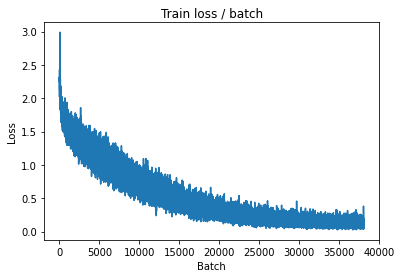


===============> Total time 18s	Avg loss 0.1231	Avg Prec@1 95.87 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.9908 (0.9908)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9261	Avg Prec@1 80.27 %	Avg Prec@5 98.45 %



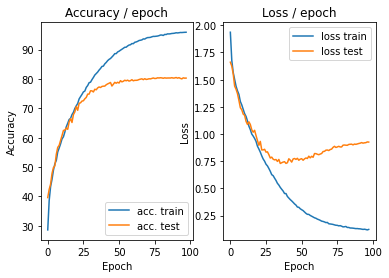

=== EPOCH 99 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.0658 (0.0658)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


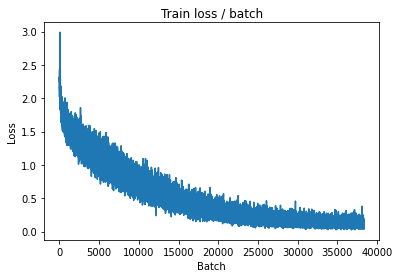

[TRAIN Batch 200/391]	Time 0.032s (0.048s)	Loss 0.1913 (0.1169)	Prec@1  95.3 ( 96.0)	Prec@5 100.0 ( 99.9)


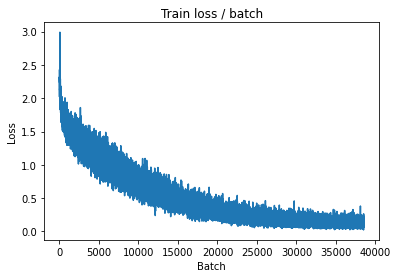


===============> Total time 18s	Avg loss 0.1213	Avg Prec@1 95.91 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.9865 (0.9865)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9242	Avg Prec@1 80.24 %	Avg Prec@5 98.39 %



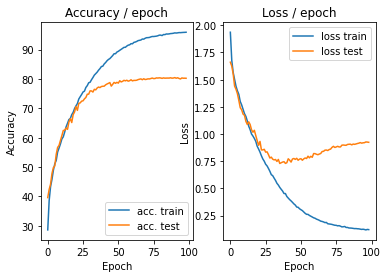

=== EPOCH 100 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 0.1266 (0.1266)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


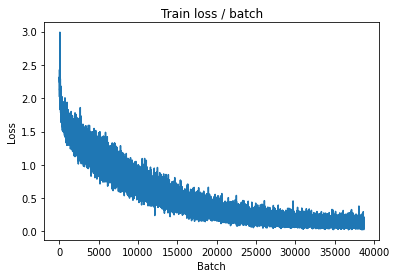

[TRAIN Batch 200/391]	Time 0.086s (0.049s)	Loss 0.0595 (0.1224)	Prec@1  98.4 ( 95.7)	Prec@5 100.0 ( 99.9)


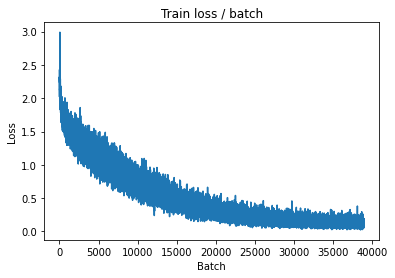


===============> Total time 18s	Avg loss 0.1213	Avg Prec@1 95.90 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.9903 (0.9903)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9277	Avg Prec@1 80.19 %	Avg Prec@5 98.42 %



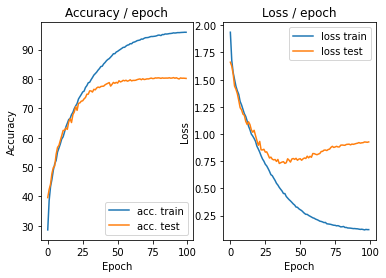

In [ ]:
main(128, 0.1, 100, cuda=True)

Partie 3.4 Regularisation du reseau par dropout

In [ ]:
class ConvNetDrop(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetDrop, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2), #conv1
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool1
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), #conv2
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool2
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), #conv3
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), #pool3
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000), #fc4
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10), #fc5
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )   

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    normalize = transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.RandomCrop(28), transforms.RandomHorizontalFlip()               
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetDrop()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
    
    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Apres chaque epoch, modifier le learning rate
        lr_sched.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.466s (0.466s)	Loss 2.3098 (2.3098)	Prec@1   5.5 (  5.5)	Prec@5  41.4 ( 41.4)


<Figure size 432x288 with 0 Axes>

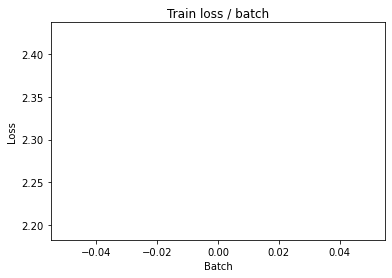

[TRAIN Batch 200/391]	Time 0.046s (0.054s)	Loss 2.0726 (2.1659)	Prec@1  21.1 ( 19.8)	Prec@5  75.0 ( 71.6)


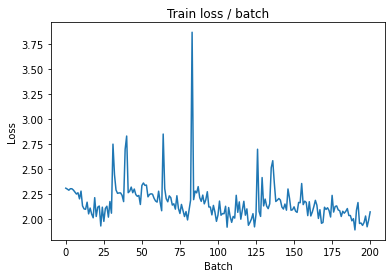


===============> Total time 20s	Avg loss 2.0586	Avg Prec@1 23.16 %	Avg Prec@5 76.58 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.8608 (1.8608)	Prec@1  30.5 ( 30.5)	Prec@5  82.8 ( 82.8)

===============> Total time 3s	Avg loss 1.8955	Avg Prec@1 30.37 %	Avg Prec@5 83.61 %



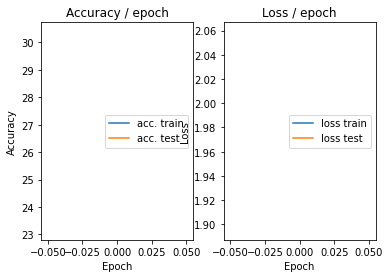

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 1.9666 (1.9666)	Prec@1  28.1 ( 28.1)	Prec@5  86.7 ( 86.7)


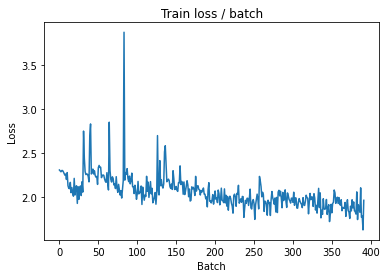

[TRAIN Batch 200/391]	Time 0.049s (0.054s)	Loss 1.9158 (1.8638)	Prec@1  31.2 ( 30.9)	Prec@5  84.4 ( 84.3)


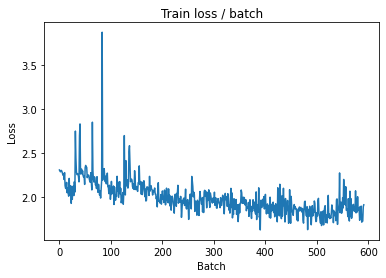


===============> Total time 20s	Avg loss 1.8255	Avg Prec@1 32.22 %	Avg Prec@5 85.31 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 1.6611 (1.6611)	Prec@1  39.8 ( 39.8)	Prec@5  88.3 ( 88.3)

===============> Total time 3s	Avg loss 1.7155	Avg Prec@1 36.36 %	Avg Prec@5 87.89 %



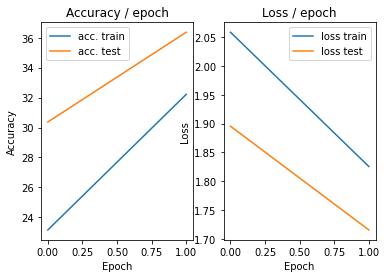

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 1.7902 (1.7902)	Prec@1  37.5 ( 37.5)	Prec@5  82.8 ( 82.8)


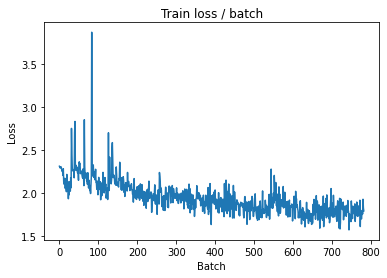

[TRAIN Batch 200/391]	Time 0.049s (0.055s)	Loss 1.7254 (1.7972)	Prec@1  42.2 ( 33.9)	Prec@5  89.1 ( 86.4)


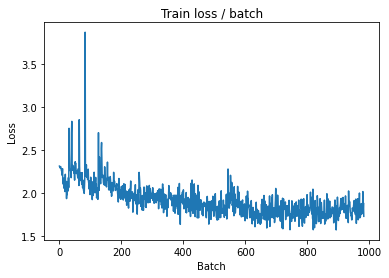


===============> Total time 21s	Avg loss 1.7879	Avg Prec@1 34.84 %	Avg Prec@5 86.30 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.6392 (1.6392)	Prec@1  41.4 ( 41.4)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.7410	Avg Prec@1 35.25 %	Avg Prec@5 87.21 %



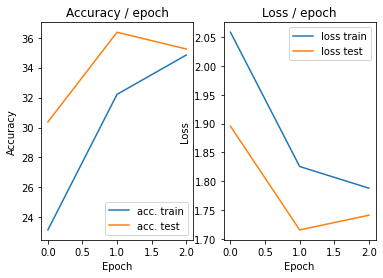

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 1.8212 (1.8212)	Prec@1  33.6 ( 33.6)	Prec@5  86.7 ( 86.7)


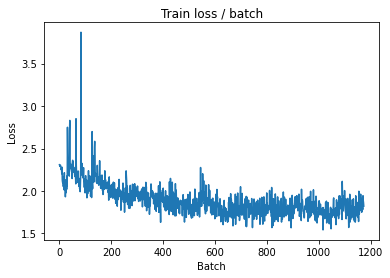

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 1.8236 (1.7363)	Prec@1  33.6 ( 36.7)	Prec@5  89.1 ( 87.5)


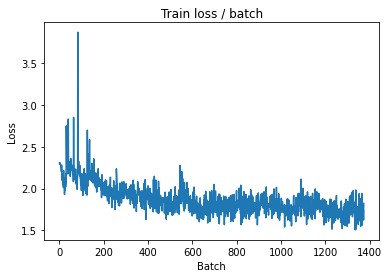


===============> Total time 21s	Avg loss 1.7403	Avg Prec@1 36.82 %	Avg Prec@5 87.23 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.6099 (1.6099)	Prec@1  40.6 ( 40.6)	Prec@5  89.8 ( 89.8)

===============> Total time 3s	Avg loss 1.5828	Avg Prec@1 42.57 %	Avg Prec@5 90.38 %



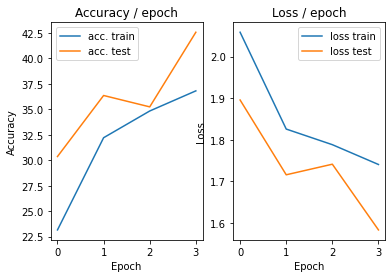

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 1.7062 (1.7062)	Prec@1  47.7 ( 47.7)	Prec@5  85.2 ( 85.2)


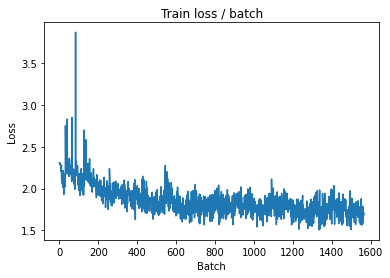

[TRAIN Batch 200/391]	Time 0.023s (0.055s)	Loss 1.7641 (1.6997)	Prec@1  35.2 ( 38.1)	Prec@5  90.6 ( 88.0)


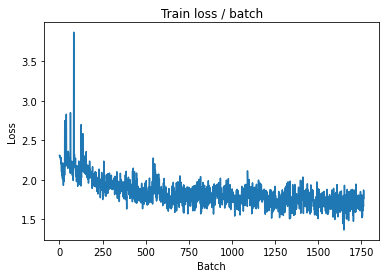


===============> Total time 21s	Avg loss 1.6786	Avg Prec@1 38.92 %	Avg Prec@5 88.36 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.5314 (1.5314)	Prec@1  42.2 ( 42.2)	Prec@5  89.1 ( 89.1)

===============> Total time 3s	Avg loss 1.5909	Avg Prec@1 42.06 %	Avg Prec@5 88.95 %



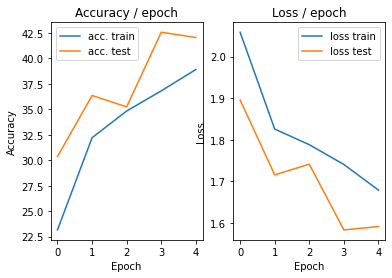

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 1.7090 (1.7090)	Prec@1  38.3 ( 38.3)	Prec@5  85.2 ( 85.2)


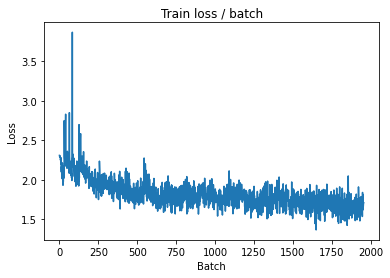

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 1.8280 (1.6775)	Prec@1  34.4 ( 39.6)	Prec@5  81.2 ( 88.2)


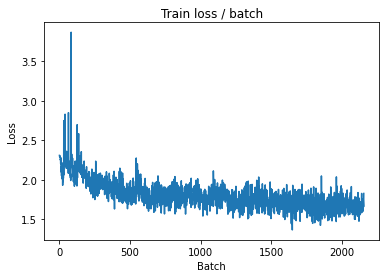


===============> Total time 21s	Avg loss 1.6459	Avg Prec@1 40.57 %	Avg Prec@5 88.82 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 1.5642 (1.5642)	Prec@1  45.3 ( 45.3)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.5480	Avg Prec@1 44.85 %	Avg Prec@5 90.92 %



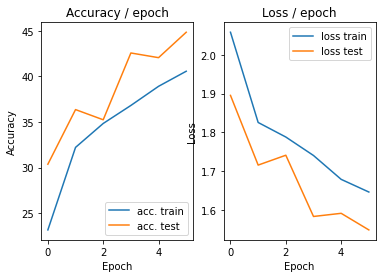

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 1.6738 (1.6738)	Prec@1  44.5 ( 44.5)	Prec@5  86.7 ( 86.7)


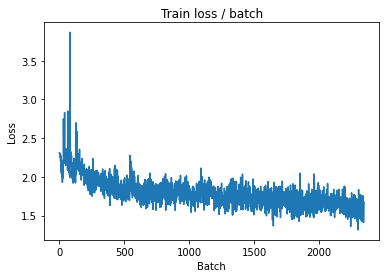

[TRAIN Batch 200/391]	Time 0.023s (0.055s)	Loss 1.7025 (1.5858)	Prec@1  37.5 ( 42.7)	Prec@5  87.5 ( 89.6)


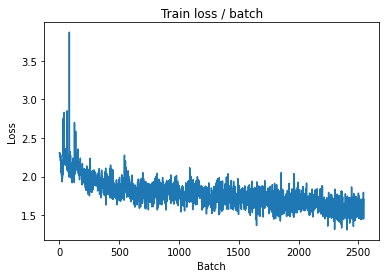


===============> Total time 21s	Avg loss 1.5815	Avg Prec@1 43.11 %	Avg Prec@5 89.69 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.4274 (1.4274)	Prec@1  48.4 ( 48.4)	Prec@5  89.8 ( 89.8)

===============> Total time 3s	Avg loss 1.4840	Avg Prec@1 45.98 %	Avg Prec@5 90.53 %



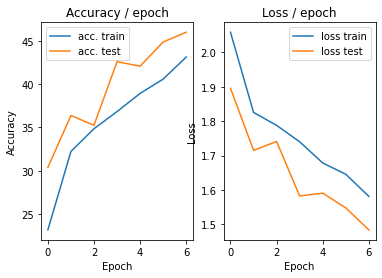

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 1.4426 (1.4426)	Prec@1  48.4 ( 48.4)	Prec@5  88.3 ( 88.3)


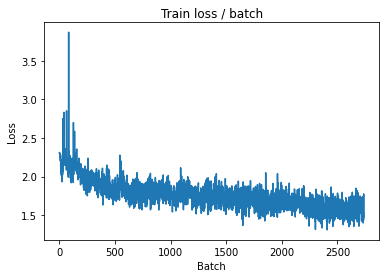

[TRAIN Batch 200/391]	Time 0.065s (0.055s)	Loss 1.3516 (1.5320)	Prec@1  45.3 ( 45.1)	Prec@5  93.8 ( 90.6)


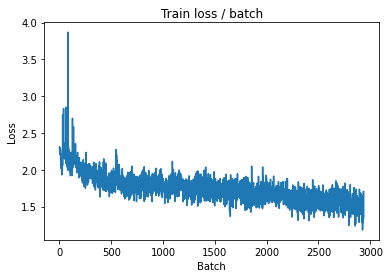


===============> Total time 21s	Avg loss 1.5162	Avg Prec@1 45.65 %	Avg Prec@5 90.77 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.4423 (1.4423)	Prec@1  50.0 ( 50.0)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.4968	Avg Prec@1 46.85 %	Avg Prec@5 91.08 %



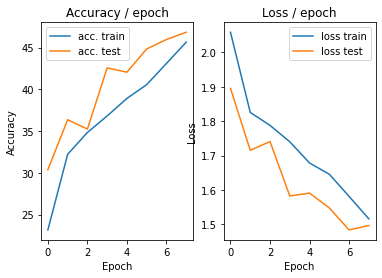

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 1.5768 (1.5768)	Prec@1  46.1 ( 46.1)	Prec@5  86.7 ( 86.7)


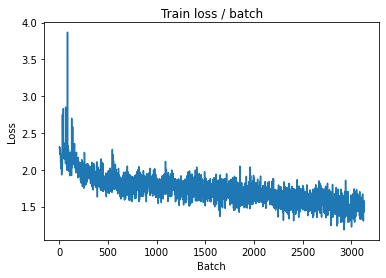

[TRAIN Batch 200/391]	Time 0.064s (0.056s)	Loss 1.3624 (1.4867)	Prec@1  55.5 ( 47.4)	Prec@5  93.0 ( 91.4)


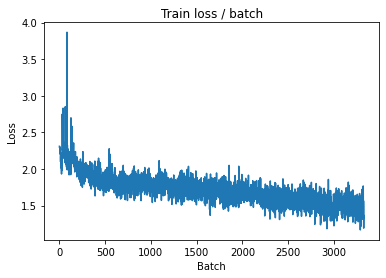


===============> Total time 21s	Avg loss 1.4818	Avg Prec@1 47.55 %	Avg Prec@5 91.42 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 1.3172 (1.3172)	Prec@1  55.5 ( 55.5)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.3756	Avg Prec@1 51.37 %	Avg Prec@5 92.66 %



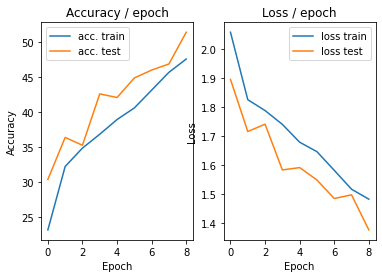

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 1.4484 (1.4484)	Prec@1  45.3 ( 45.3)	Prec@5  93.0 ( 93.0)


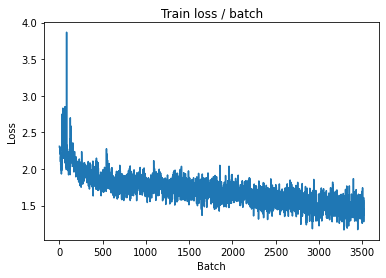

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 1.2198 (1.4236)	Prec@1  56.2 ( 49.8)	Prec@5  94.5 ( 92.0)


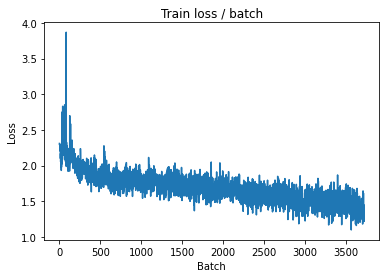


===============> Total time 21s	Avg loss 1.4307	Avg Prec@1 49.67 %	Avg Prec@5 91.74 %

[EVAL Batch 000/079]	Time 0.230s (0.230s)	Loss 1.3479 (1.3479)	Prec@1  59.4 ( 59.4)	Prec@5  88.3 ( 88.3)

===============> Total time 3s	Avg loss 1.4693	Avg Prec@1 49.20 %	Avg Prec@5 91.51 %



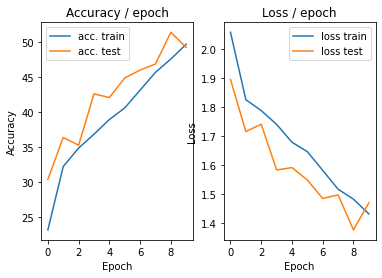

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 1.5494 (1.5494)	Prec@1  48.4 ( 48.4)	Prec@5  88.3 ( 88.3)


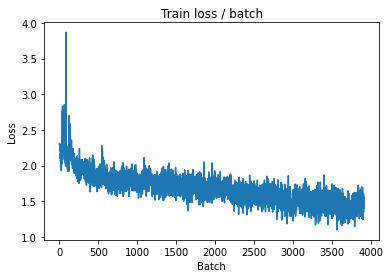

[TRAIN Batch 200/391]	Time 0.088s (0.054s)	Loss 1.2573 (1.4046)	Prec@1  53.1 ( 50.7)	Prec@5  93.0 ( 92.1)


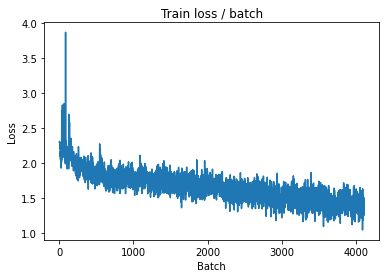


===============> Total time 21s	Avg loss 1.4000	Avg Prec@1 50.94 %	Avg Prec@5 92.21 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 1.3444 (1.3444)	Prec@1  58.6 ( 58.6)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.2711	Avg Prec@1 55.41 %	Avg Prec@5 93.65 %



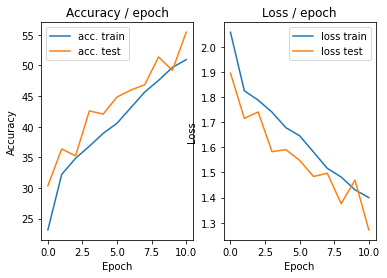

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 1.2807 (1.2807)	Prec@1  53.9 ( 53.9)	Prec@5  94.5 ( 94.5)


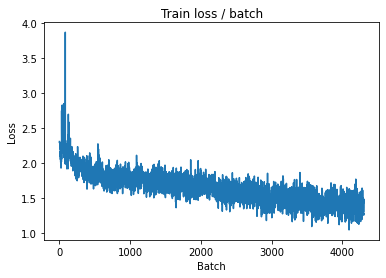

[TRAIN Batch 200/391]	Time 0.090s (0.055s)	Loss 1.3804 (1.3615)	Prec@1  54.7 ( 52.3)	Prec@5  95.3 ( 92.7)


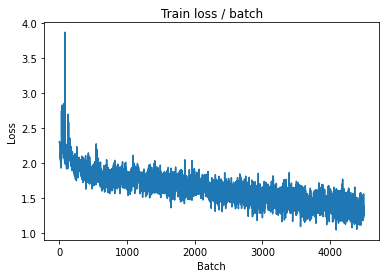


===============> Total time 21s	Avg loss 1.3721	Avg Prec@1 52.10 %	Avg Prec@5 92.36 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.1841 (1.1841)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.2615	Avg Prec@1 56.93 %	Avg Prec@5 93.34 %



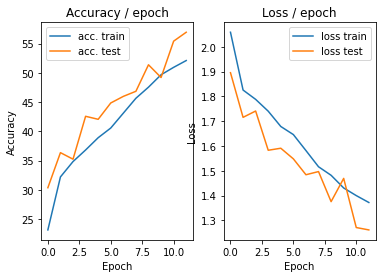

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 1.3118 (1.3118)	Prec@1  55.5 ( 55.5)	Prec@5  95.3 ( 95.3)


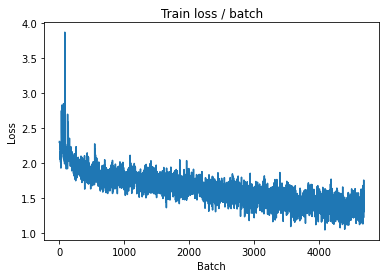

[TRAIN Batch 200/391]	Time 0.087s (0.055s)	Loss 1.4846 (1.3423)	Prec@1  50.0 ( 52.9)	Prec@5  93.8 ( 92.7)


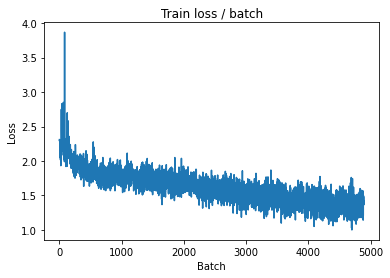


===============> Total time 21s	Avg loss 1.3381	Avg Prec@1 53.25 %	Avg Prec@5 92.80 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 1.2534 (1.2534)	Prec@1  57.0 ( 57.0)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.2462	Avg Prec@1 57.04 %	Avg Prec@5 94.07 %



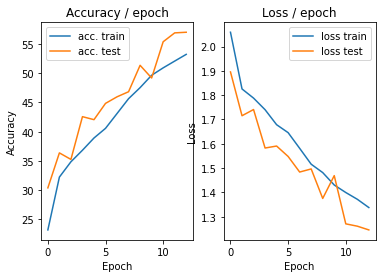

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 1.3442 (1.3442)	Prec@1  55.5 ( 55.5)	Prec@5  93.8 ( 93.8)


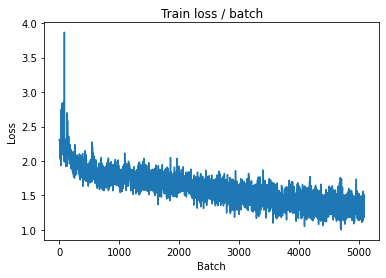

[TRAIN Batch 200/391]	Time 0.084s (0.055s)	Loss 1.4276 (1.2920)	Prec@1  52.3 ( 55.4)	Prec@5  94.5 ( 93.2)


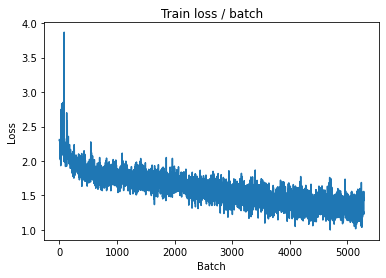


===============> Total time 21s	Avg loss 1.2820	Avg Prec@1 55.57 %	Avg Prec@5 93.32 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 1.2016 (1.2016)	Prec@1  58.6 ( 58.6)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.1781	Avg Prec@1 59.37 %	Avg Prec@5 94.73 %



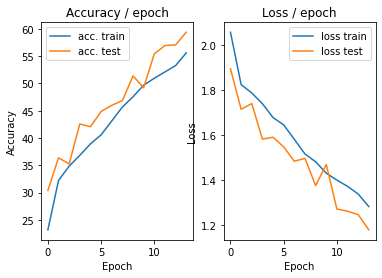

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 1.2955 (1.2955)	Prec@1  58.6 ( 58.6)	Prec@5  93.0 ( 93.0)


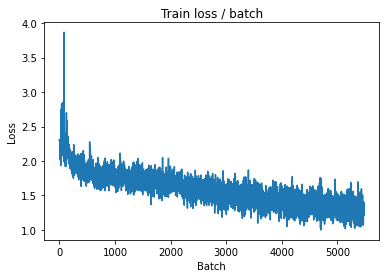

[TRAIN Batch 200/391]	Time 0.088s (0.055s)	Loss 1.2879 (1.2609)	Prec@1  58.6 ( 56.3)	Prec@5  95.3 ( 93.7)


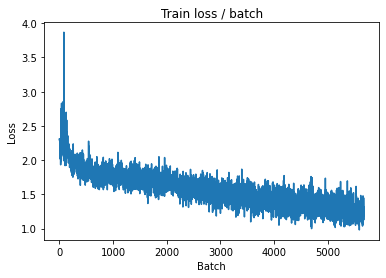


===============> Total time 21s	Avg loss 1.2597	Avg Prec@1 56.54 %	Avg Prec@5 93.73 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.1062 (1.1062)	Prec@1  61.7 ( 61.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2138	Avg Prec@1 58.32 %	Avg Prec@5 94.38 %



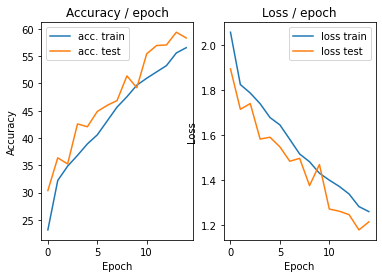

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 1.1383 (1.1383)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)


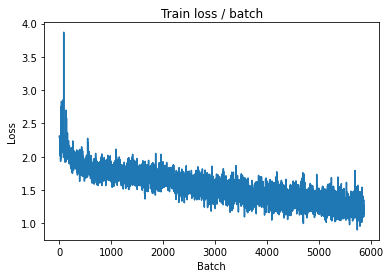

[TRAIN Batch 200/391]	Time 0.092s (0.055s)	Loss 0.9679 (1.2087)	Prec@1  64.8 ( 58.7)	Prec@5  96.9 ( 94.3)


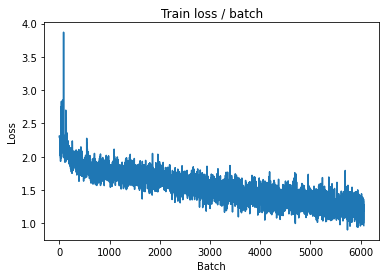


===============> Total time 21s	Avg loss 1.2184	Avg Prec@1 58.26 %	Avg Prec@5 94.17 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 1.1785 (1.1785)	Prec@1  61.7 ( 61.7)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.1219	Avg Prec@1 61.77 %	Avg Prec@5 95.15 %



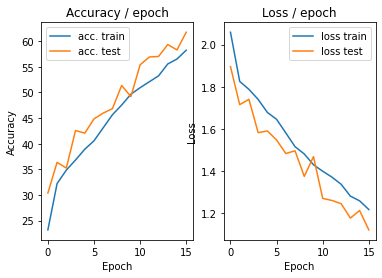

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 1.1289 (1.1289)	Prec@1  64.8 ( 64.8)	Prec@5  92.2 ( 92.2)


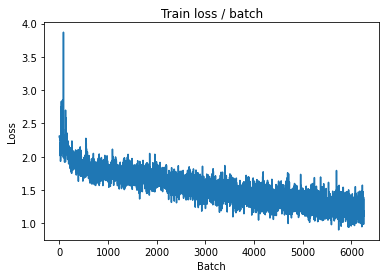

[TRAIN Batch 200/391]	Time 0.024s (0.054s)	Loss 1.2847 (1.1882)	Prec@1  60.9 ( 59.4)	Prec@5  92.2 ( 94.6)


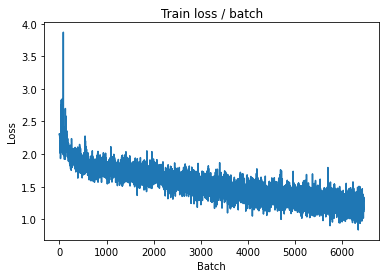


===============> Total time 21s	Avg loss 1.1888	Avg Prec@1 59.57 %	Avg Prec@5 94.51 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.0816 (1.0816)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.1209	Avg Prec@1 62.00 %	Avg Prec@5 95.73 %



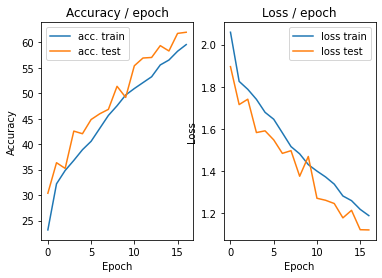

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 1.2226 (1.2226)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)


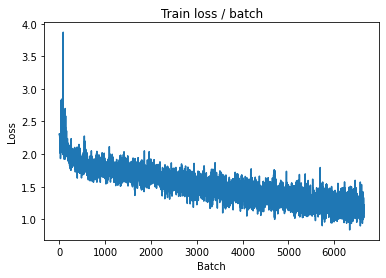

[TRAIN Batch 200/391]	Time 0.094s (0.055s)	Loss 1.1498 (1.1671)	Prec@1  58.6 ( 59.8)	Prec@5  96.1 ( 94.6)


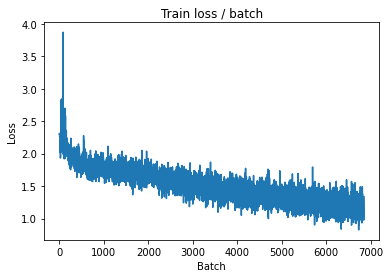


===============> Total time 21s	Avg loss 1.1545	Avg Prec@1 60.40 %	Avg Prec@5 94.72 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 1.0788 (1.0788)	Prec@1  63.3 ( 63.3)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.0751	Avg Prec@1 62.81 %	Avg Prec@5 95.47 %



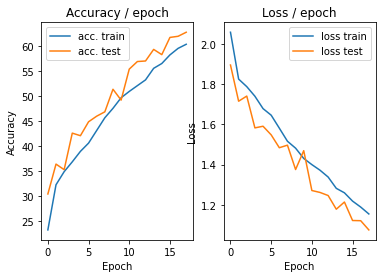

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 1.2882 (1.2882)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


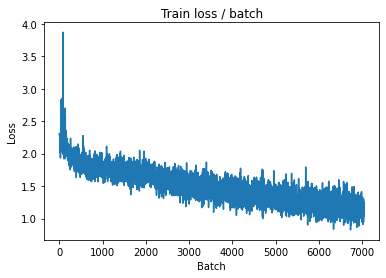

[TRAIN Batch 200/391]	Time 0.023s (0.055s)	Loss 1.1615 (1.1269)	Prec@1  60.9 ( 61.4)	Prec@5  94.5 ( 94.7)


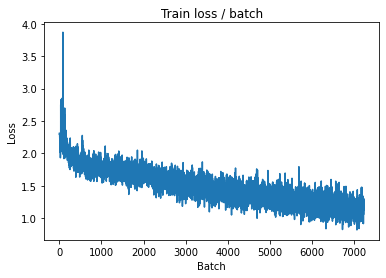


===============> Total time 21s	Avg loss 1.1243	Avg Prec@1 61.34 %	Avg Prec@5 94.90 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 1.1115 (1.1115)	Prec@1  67.2 ( 67.2)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.0385	Avg Prec@1 65.03 %	Avg Prec@5 95.81 %



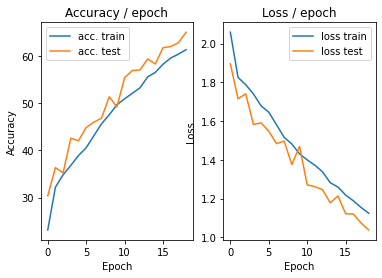

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 1.1495 (1.1495)	Prec@1  60.9 ( 60.9)	Prec@5  93.0 ( 93.0)


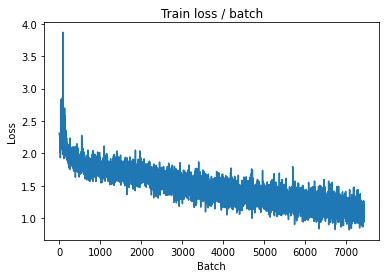

[TRAIN Batch 200/391]	Time 0.060s (0.056s)	Loss 1.0431 (1.1113)	Prec@1  61.7 ( 62.3)	Prec@5  95.3 ( 95.1)


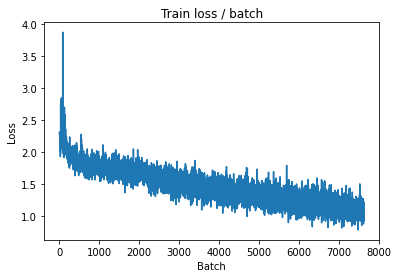


===============> Total time 21s	Avg loss 1.0974	Avg Prec@1 62.59 %	Avg Prec@5 95.26 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 1.0139 (1.0139)	Prec@1  71.9 ( 71.9)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.0017	Avg Prec@1 66.54 %	Avg Prec@5 96.05 %



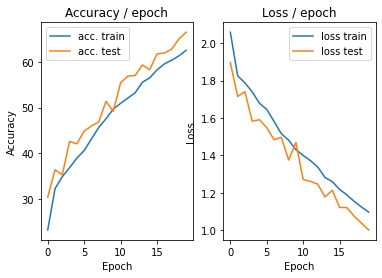

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.9098 (0.9098)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)


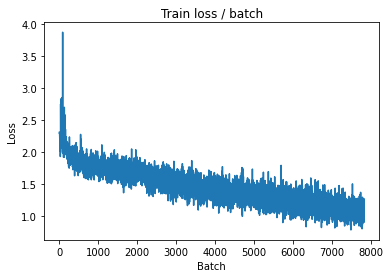

[TRAIN Batch 200/391]	Time 0.066s (0.056s)	Loss 0.8861 (1.0607)	Prec@1  69.5 ( 64.0)	Prec@5  98.4 ( 95.6)


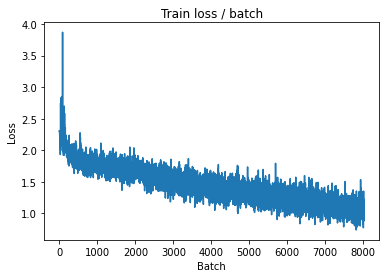


===============> Total time 21s	Avg loss 1.0644	Avg Prec@1 63.79 %	Avg Prec@5 95.48 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.9331 (0.9331)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9956	Avg Prec@1 65.99 %	Avg Prec@5 95.97 %



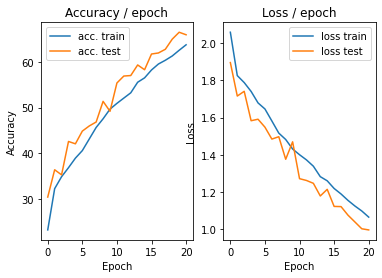

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.9576 (0.9576)	Prec@1  69.5 ( 69.5)	Prec@5  92.2 ( 92.2)


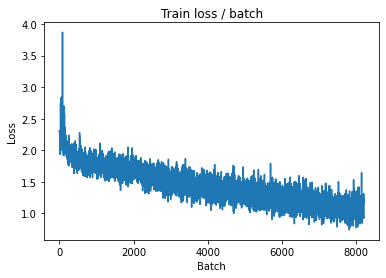

[TRAIN Batch 200/391]	Time 0.095s (0.056s)	Loss 1.0610 (1.0287)	Prec@1  66.4 ( 65.0)	Prec@5  96.1 ( 95.8)


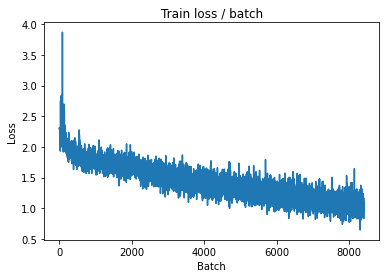


===============> Total time 21s	Avg loss 1.0292	Avg Prec@1 65.01 %	Avg Prec@5 95.85 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 1.0166 (1.0166)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.9846	Avg Prec@1 67.22 %	Avg Prec@5 96.43 %



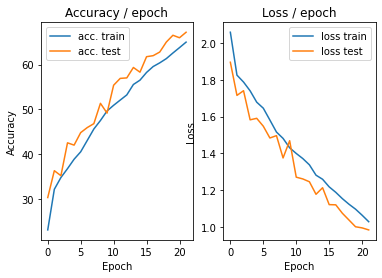

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 1.0755 (1.0755)	Prec@1  67.2 ( 67.2)	Prec@5  93.8 ( 93.8)


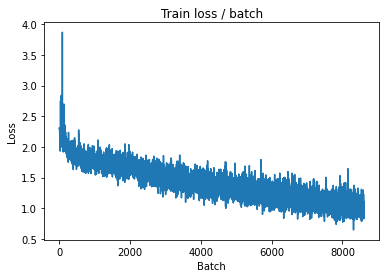

[TRAIN Batch 200/391]	Time 0.089s (0.055s)	Loss 0.9428 (1.0023)	Prec@1  66.4 ( 65.9)	Prec@5  96.1 ( 96.1)


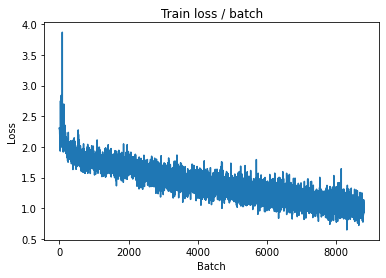


===============> Total time 21s	Avg loss 1.0072	Avg Prec@1 65.60 %	Avg Prec@5 96.03 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.9833 (0.9833)	Prec@1  70.3 ( 70.3)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 0.9446	Avg Prec@1 67.81 %	Avg Prec@5 96.64 %



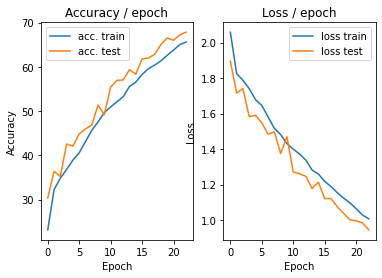

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 1.0117 (1.0117)	Prec@1  61.7 ( 61.7)	Prec@5  96.1 ( 96.1)


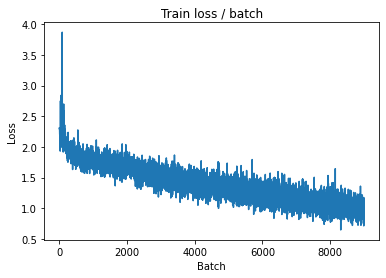

[TRAIN Batch 200/391]	Time 0.072s (0.055s)	Loss 0.9127 (0.9637)	Prec@1  66.4 ( 66.8)	Prec@5  96.1 ( 96.4)


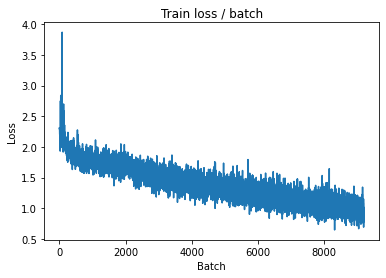


===============> Total time 21s	Avg loss 0.9696	Avg Prec@1 66.64 %	Avg Prec@5 96.22 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.9912 (0.9912)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9202	Avg Prec@1 68.97 %	Avg Prec@5 96.67 %



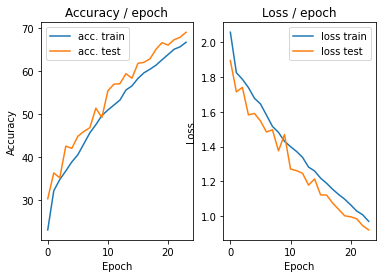

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 1.0410 (1.0410)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)


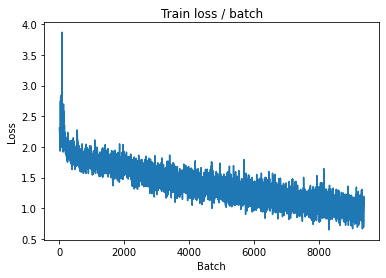

[TRAIN Batch 200/391]	Time 0.061s (0.055s)	Loss 0.9336 (0.9546)	Prec@1  64.8 ( 67.4)	Prec@5  98.4 ( 96.6)


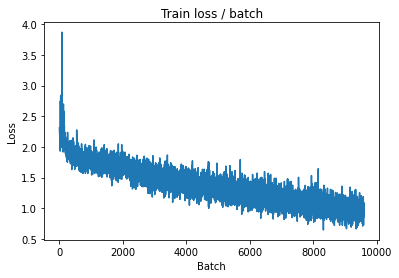


===============> Total time 21s	Avg loss 0.9534	Avg Prec@1 67.48 %	Avg Prec@5 96.56 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.8746 (0.8746)	Prec@1  71.9 ( 71.9)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 0.9062	Avg Prec@1 69.04 %	Avg Prec@5 96.98 %



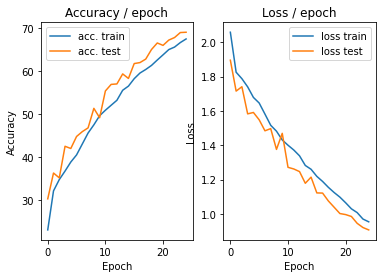

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.8476 (0.8476)	Prec@1  70.3 ( 70.3)	Prec@5  94.5 ( 94.5)


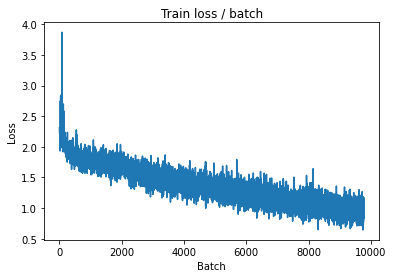

[TRAIN Batch 200/391]	Time 0.021s (0.055s)	Loss 0.9802 (0.9352)	Prec@1  67.2 ( 67.8)	Prec@5  96.1 ( 96.6)


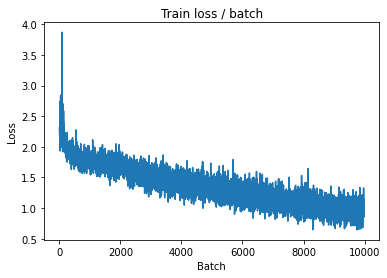


===============> Total time 21s	Avg loss 0.9365	Avg Prec@1 67.75 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.8638 (0.8638)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8900	Avg Prec@1 70.38 %	Avg Prec@5 96.86 %



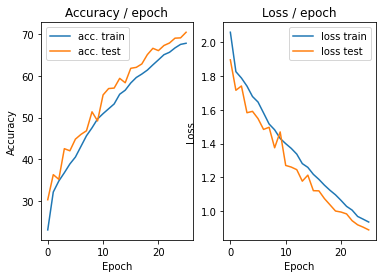

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.7556 (0.7556)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


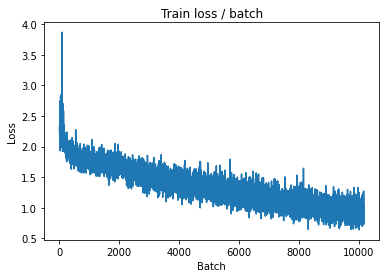

[TRAIN Batch 200/391]	Time 0.086s (0.055s)	Loss 0.8966 (0.9018)	Prec@1  72.7 ( 69.0)	Prec@5  96.1 ( 96.9)


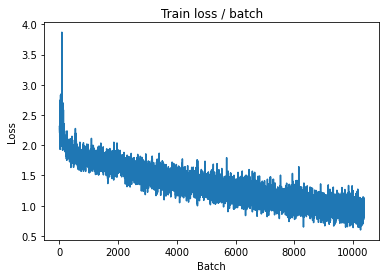


===============> Total time 21s	Avg loss 0.9058	Avg Prec@1 69.04 %	Avg Prec@5 96.87 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.8186 (0.8186)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8700	Avg Prec@1 71.09 %	Avg Prec@5 96.97 %



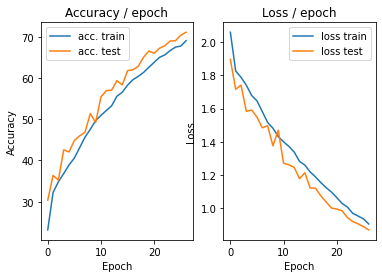

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.8649 (0.8649)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


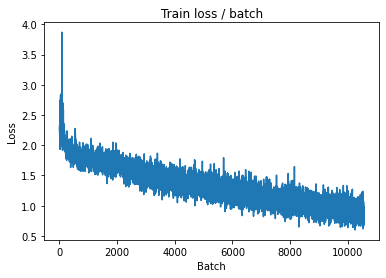

[TRAIN Batch 200/391]	Time 0.077s (0.055s)	Loss 0.9650 (0.8787)	Prec@1  68.0 ( 70.3)	Prec@5  96.1 ( 96.9)


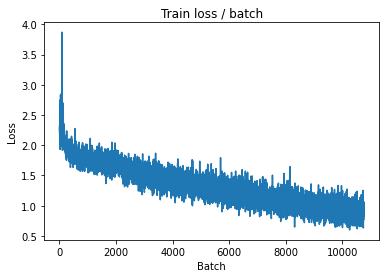


===============> Total time 21s	Avg loss 0.8878	Avg Prec@1 69.88 %	Avg Prec@5 96.85 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.8226 (0.8226)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8517	Avg Prec@1 71.55 %	Avg Prec@5 97.31 %



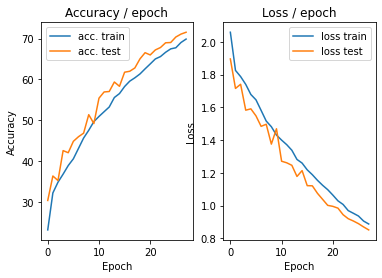

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.8971 (0.8971)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)


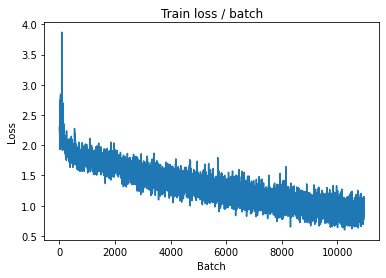

[TRAIN Batch 200/391]	Time 0.019s (0.054s)	Loss 0.6880 (0.8560)	Prec@1  78.1 ( 70.8)	Prec@5  99.2 ( 97.1)


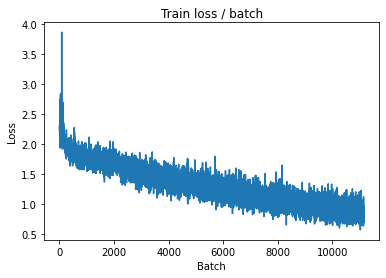


===============> Total time 21s	Avg loss 0.8596	Avg Prec@1 70.56 %	Avg Prec@5 97.12 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.8305 (0.8305)	Prec@1  77.3 ( 77.3)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 0.8451	Avg Prec@1 72.67 %	Avg Prec@5 97.49 %



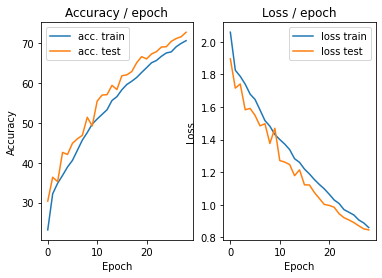

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.8218 (0.8218)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)


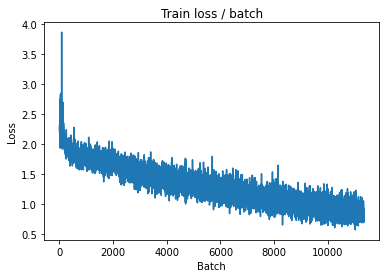

[TRAIN Batch 200/391]	Time 0.085s (0.055s)	Loss 0.7653 (0.8327)	Prec@1  73.4 ( 71.7)	Prec@5  97.7 ( 97.3)


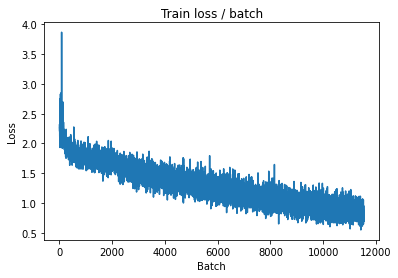


===============> Total time 21s	Avg loss 0.8428	Avg Prec@1 71.45 %	Avg Prec@5 97.28 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.7784 (0.7784)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8320	Avg Prec@1 72.55 %	Avg Prec@5 97.17 %



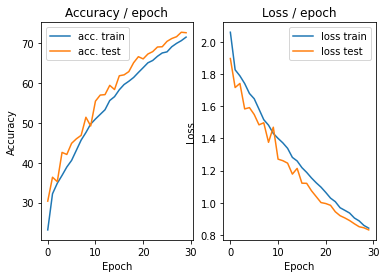

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.7919 (0.7919)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)


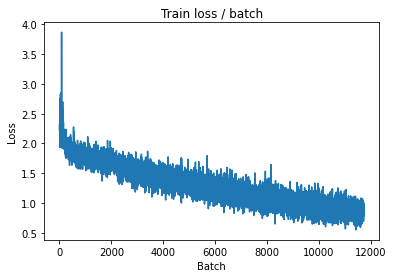

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.7814 (0.8084)	Prec@1  73.4 ( 72.3)	Prec@5  97.7 ( 97.4)


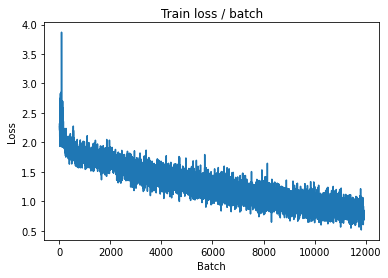


===============> Total time 21s	Avg loss 0.8200	Avg Prec@1 71.83 %	Avg Prec@5 97.36 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.6879 (0.6879)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8137	Avg Prec@1 73.60 %	Avg Prec@5 97.35 %



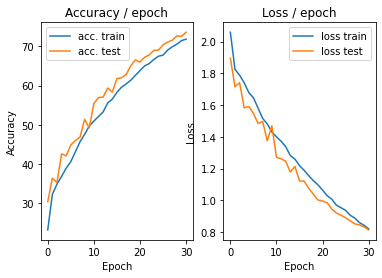

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.9331 (0.9331)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)


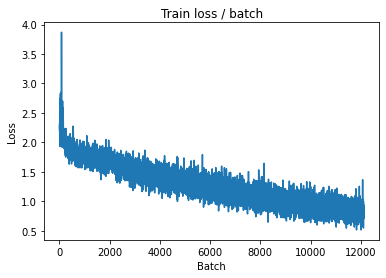

[TRAIN Batch 200/391]	Time 0.026s (0.055s)	Loss 0.8611 (0.8052)	Prec@1  70.3 ( 72.5)	Prec@5  97.7 ( 97.5)


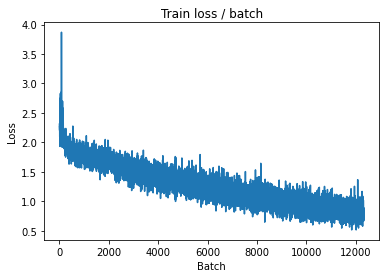


===============> Total time 21s	Avg loss 0.7975	Avg Prec@1 72.81 %	Avg Prec@5 97.53 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.6984 (0.6984)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8021	Avg Prec@1 73.46 %	Avg Prec@5 97.47 %



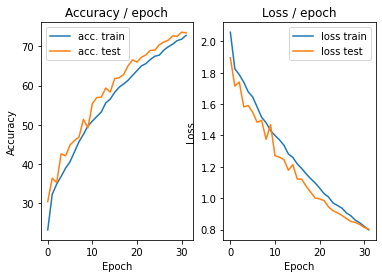

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.8598 (0.8598)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)


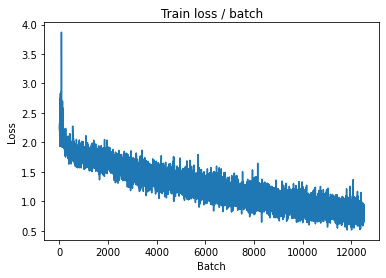

[TRAIN Batch 200/391]	Time 0.031s (0.055s)	Loss 0.6686 (0.7920)	Prec@1  74.2 ( 72.8)	Prec@5  98.4 ( 97.4)


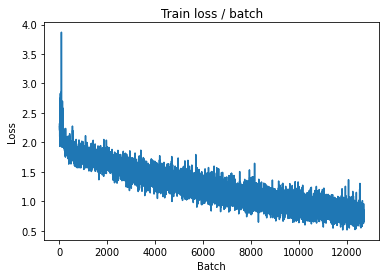


===============> Total time 21s	Avg loss 0.7892	Avg Prec@1 72.82 %	Avg Prec@5 97.53 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7056 (0.7056)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7833	Avg Prec@1 74.15 %	Avg Prec@5 97.75 %



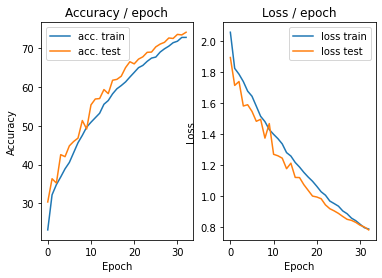

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.9348 (0.9348)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)


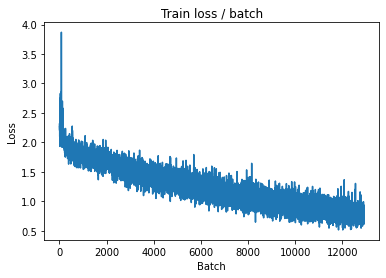

[TRAIN Batch 200/391]	Time 0.025s (0.055s)	Loss 0.6106 (0.7725)	Prec@1  78.9 ( 73.1)	Prec@5  98.4 ( 97.7)


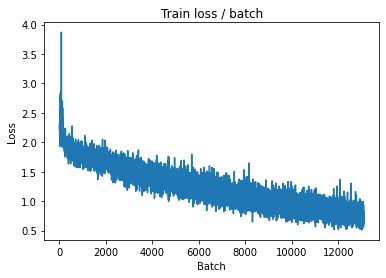


===============> Total time 21s	Avg loss 0.7744	Avg Prec@1 73.32 %	Avg Prec@5 97.66 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7412 (0.7412)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7779	Avg Prec@1 74.59 %	Avg Prec@5 97.84 %



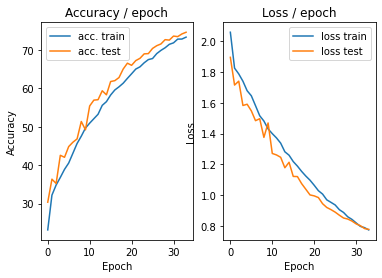

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.7684 (0.7684)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


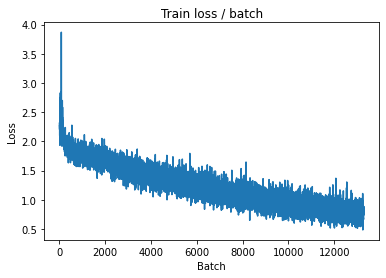

[TRAIN Batch 200/391]	Time 0.062s (0.055s)	Loss 0.6487 (0.7426)	Prec@1  77.3 ( 74.5)	Prec@5  96.9 ( 97.6)


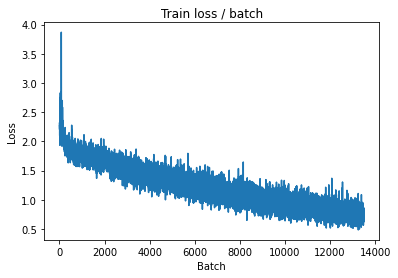


===============> Total time 21s	Avg loss 0.7536	Avg Prec@1 74.21 %	Avg Prec@5 97.71 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.6764 (0.6764)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7700	Avg Prec@1 74.40 %	Avg Prec@5 97.68 %



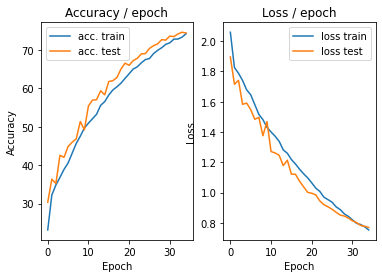

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.7498 (0.7498)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


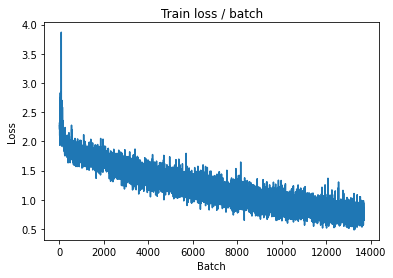

[TRAIN Batch 200/391]	Time 0.061s (0.055s)	Loss 0.8180 (0.7301)	Prec@1  79.7 ( 74.8)	Prec@5  96.9 ( 98.0)


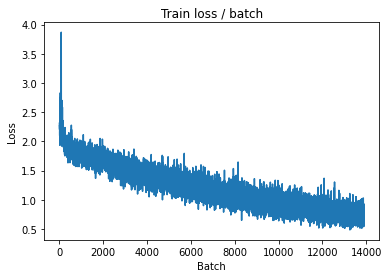


===============> Total time 21s	Avg loss 0.7326	Avg Prec@1 74.83 %	Avg Prec@5 97.92 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.6918 (0.6918)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7577	Avg Prec@1 75.48 %	Avg Prec@5 97.96 %



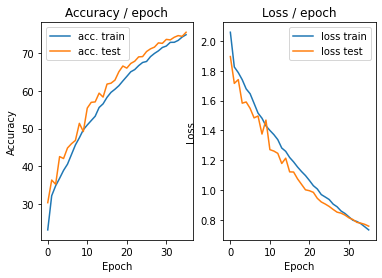

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.6432 (0.6432)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)


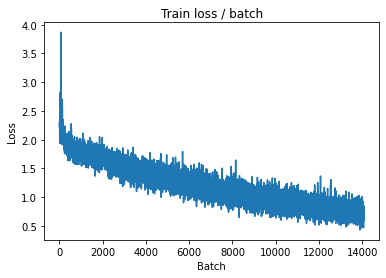

[TRAIN Batch 200/391]	Time 0.024s (0.055s)	Loss 0.9622 (0.7137)	Prec@1  68.0 ( 75.2)	Prec@5  94.5 ( 98.0)


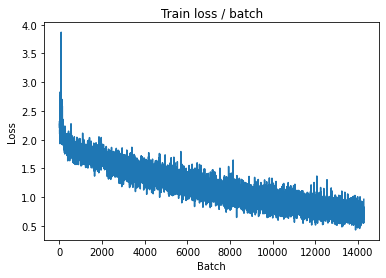


===============> Total time 21s	Avg loss 0.7127	Avg Prec@1 75.33 %	Avg Prec@5 98.01 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.6272 (0.6272)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7465	Avg Prec@1 75.19 %	Avg Prec@5 98.02 %



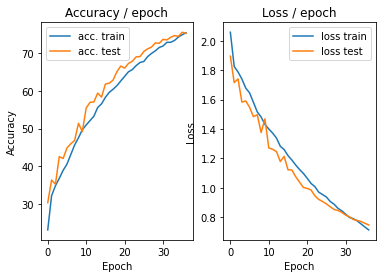

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.7817 (0.7817)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


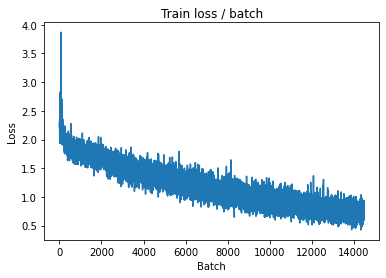

[TRAIN Batch 200/391]	Time 0.090s (0.055s)	Loss 0.6287 (0.6964)	Prec@1  74.2 ( 75.8)	Prec@5  98.4 ( 98.1)


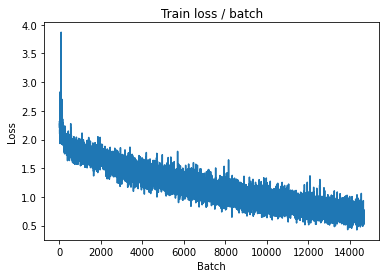


===============> Total time 21s	Avg loss 0.7011	Avg Prec@1 75.72 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.7032 (0.7032)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7512	Avg Prec@1 75.22 %	Avg Prec@5 97.83 %



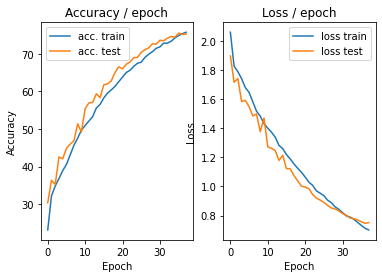

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.5696 (0.5696)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)


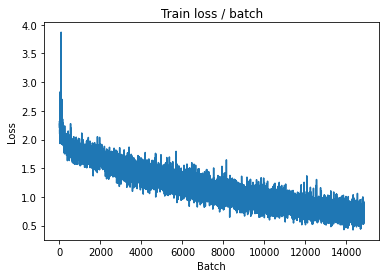

[TRAIN Batch 200/391]	Time 0.030s (0.055s)	Loss 0.7632 (0.6825)	Prec@1  72.7 ( 76.5)	Prec@5  98.4 ( 98.3)


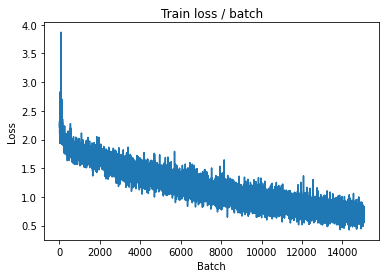


===============> Total time 21s	Avg loss 0.6855	Avg Prec@1 76.30 %	Avg Prec@5 98.35 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.6114 (0.6114)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7333	Avg Prec@1 75.65 %	Avg Prec@5 97.98 %



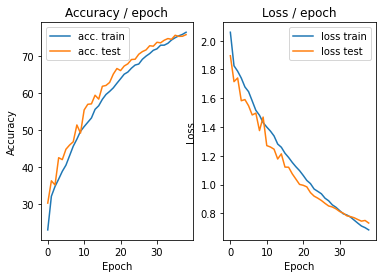

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.6942 (0.6942)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


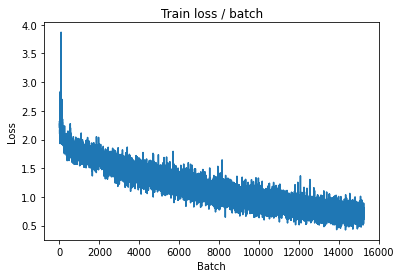

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 0.7196 (0.6757)	Prec@1  75.0 ( 76.8)	Prec@5  99.2 ( 98.3)


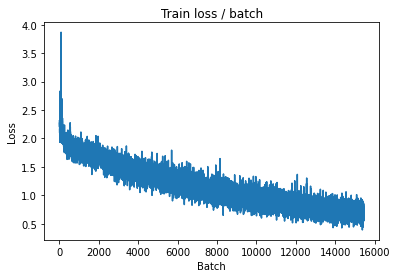


===============> Total time 21s	Avg loss 0.6760	Avg Prec@1 76.74 %	Avg Prec@5 98.32 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.6842 (0.6842)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7427	Avg Prec@1 76.25 %	Avg Prec@5 97.97 %



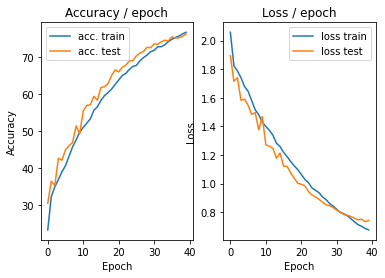

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.9534 (0.9534)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)


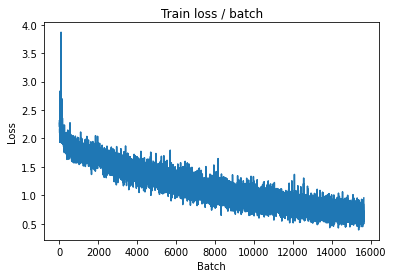

[TRAIN Batch 200/391]	Time 0.062s (0.056s)	Loss 0.5001 (0.6593)	Prec@1  82.8 ( 77.2)	Prec@5  98.4 ( 98.6)


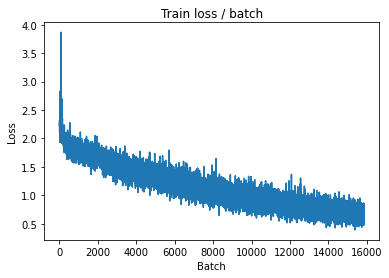


===============> Total time 21s	Avg loss 0.6648	Avg Prec@1 76.95 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 0.7025 (0.7025)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7212	Avg Prec@1 76.54 %	Avg Prec@5 97.99 %



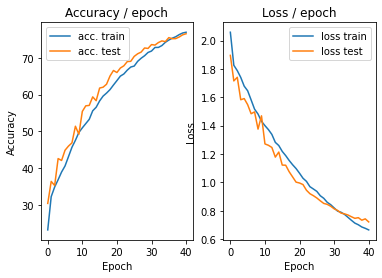

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.6530 (0.6530)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


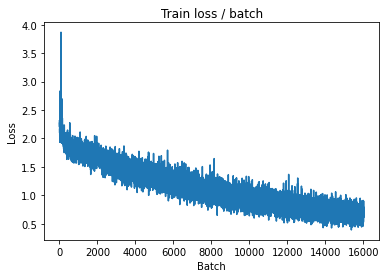

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.8210 (0.6501)	Prec@1  70.3 ( 77.8)	Prec@5  99.2 ( 98.5)


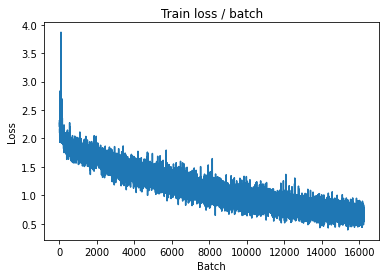


===============> Total time 21s	Avg loss 0.6541	Avg Prec@1 77.56 %	Avg Prec@5 98.36 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.7248 (0.7248)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7103	Avg Prec@1 76.46 %	Avg Prec@5 98.07 %



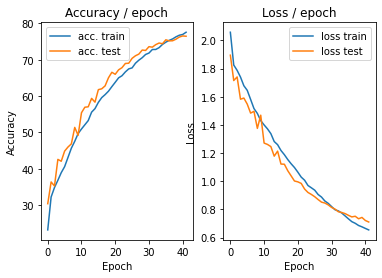

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.5836 (0.5836)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


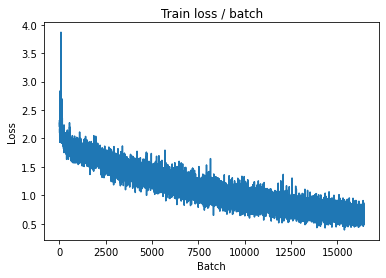

[TRAIN Batch 200/391]	Time 0.026s (0.055s)	Loss 0.5841 (0.6281)	Prec@1  81.2 ( 78.2)	Prec@5  98.4 ( 98.5)


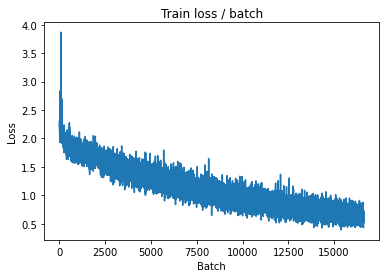


===============> Total time 21s	Avg loss 0.6348	Avg Prec@1 78.06 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.6491 (0.6491)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7020	Avg Prec@1 76.91 %	Avg Prec@5 98.24 %



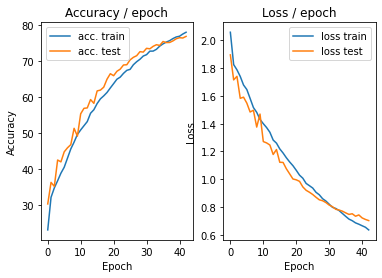

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.6473 (0.6473)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


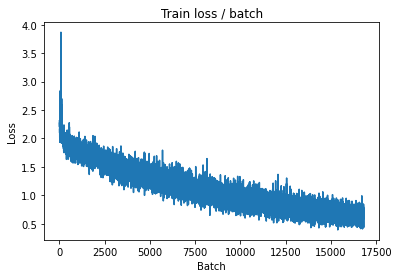

[TRAIN Batch 200/391]	Time 0.091s (0.055s)	Loss 0.4535 (0.6271)	Prec@1  84.4 ( 78.2)	Prec@5  99.2 ( 98.5)


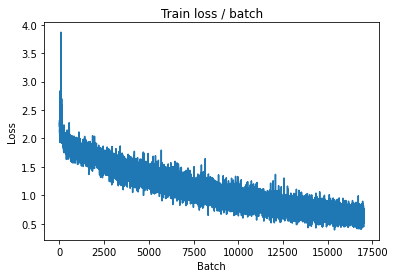


===============> Total time 21s	Avg loss 0.6304	Avg Prec@1 78.21 %	Avg Prec@5 98.55 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.6638 (0.6638)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7005	Avg Prec@1 77.05 %	Avg Prec@5 98.15 %



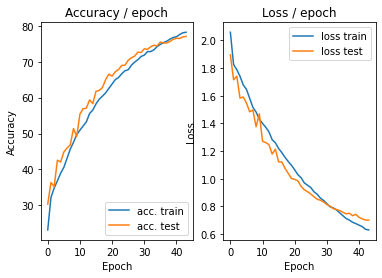

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.7127 (0.7127)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


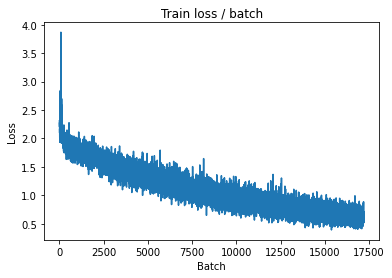

[TRAIN Batch 200/391]	Time 0.027s (0.055s)	Loss 0.5780 (0.6141)	Prec@1  83.6 ( 78.8)	Prec@5  97.7 ( 98.6)


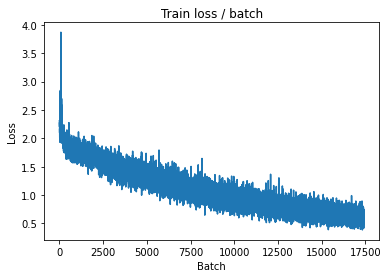


===============> Total time 21s	Avg loss 0.6183	Avg Prec@1 78.58 %	Avg Prec@5 98.56 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.6014 (0.6014)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6915	Avg Prec@1 77.38 %	Avg Prec@5 98.14 %



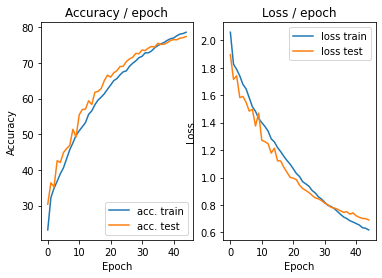

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.6207 (0.6207)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


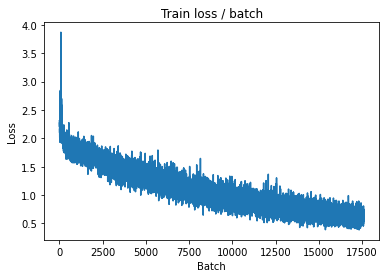

[TRAIN Batch 200/391]	Time 0.081s (0.055s)	Loss 0.7463 (0.5918)	Prec@1  74.2 ( 79.3)	Prec@5  97.7 ( 98.7)


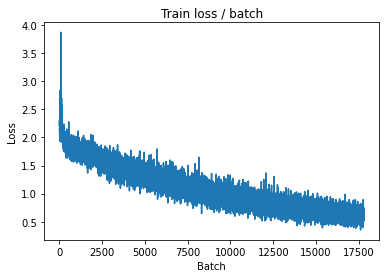


===============> Total time 21s	Avg loss 0.5991	Avg Prec@1 79.04 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.5767 (0.5767)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6846	Avg Prec@1 77.70 %	Avg Prec@5 98.36 %



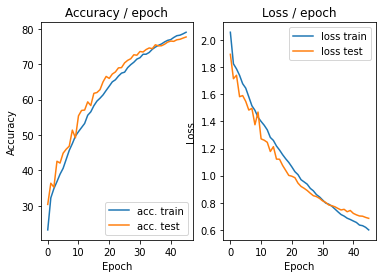

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.5836 (0.5836)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)


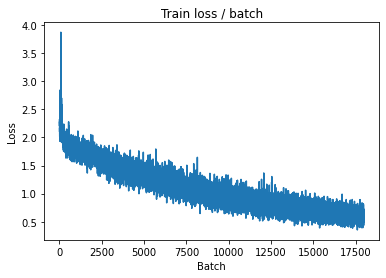

[TRAIN Batch 200/391]	Time 0.097s (0.056s)	Loss 0.6474 (0.5972)	Prec@1  78.9 ( 79.4)	Prec@5 100.0 ( 98.7)


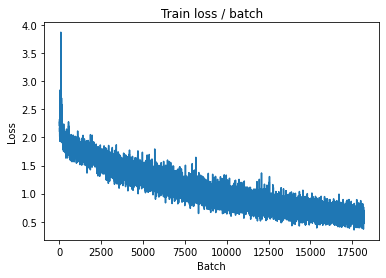


===============> Total time 21s	Avg loss 0.5966	Avg Prec@1 79.30 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.6294 (0.6294)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6810	Avg Prec@1 77.96 %	Avg Prec@5 98.10 %



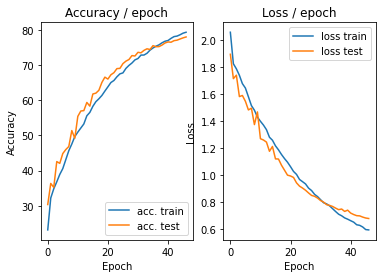

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.3665 (0.3665)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


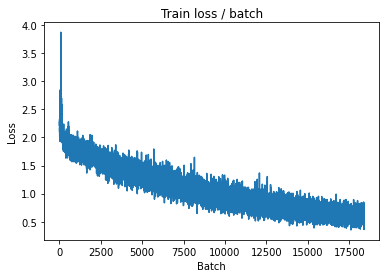

[TRAIN Batch 200/391]	Time 0.044s (0.055s)	Loss 0.4625 (0.5769)	Prec@1  83.6 ( 79.9)	Prec@5 100.0 ( 98.8)


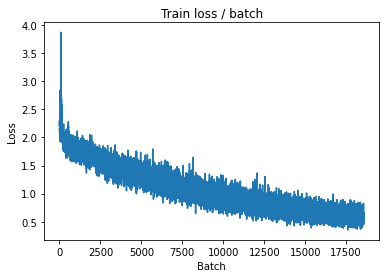


===============> Total time 21s	Avg loss 0.5837	Avg Prec@1 79.61 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.6126 (0.6126)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6970	Avg Prec@1 77.23 %	Avg Prec@5 97.99 %



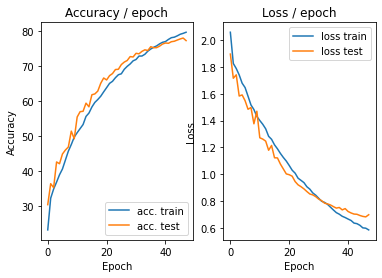

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.5459 (0.5459)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


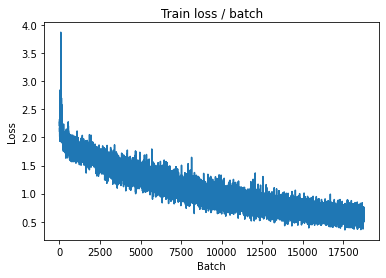

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.5328 (0.5868)	Prec@1  81.2 ( 79.5)	Prec@5  97.7 ( 98.7)


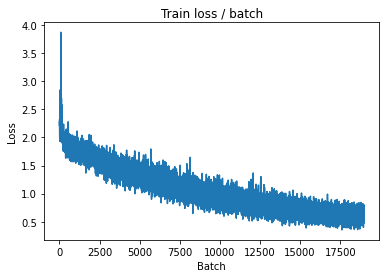


===============> Total time 21s	Avg loss 0.5774	Avg Prec@1 79.84 %	Avg Prec@5 98.72 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.6429 (0.6429)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6867	Avg Prec@1 78.07 %	Avg Prec@5 98.22 %



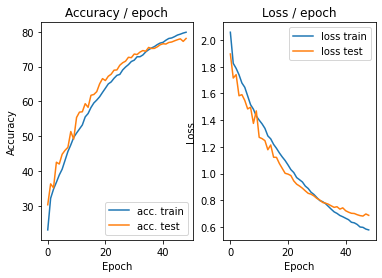

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.4460 (0.4460)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


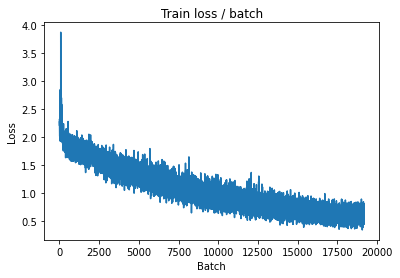

[TRAIN Batch 200/391]	Time 0.064s (0.056s)	Loss 0.5268 (0.5721)	Prec@1  81.2 ( 80.1)	Prec@5  99.2 ( 98.9)


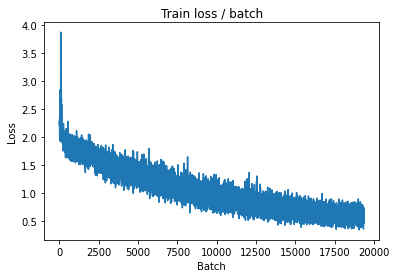


===============> Total time 21s	Avg loss 0.5700	Avg Prec@1 80.15 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.220s (0.220s)	Loss 0.6546 (0.6546)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6811	Avg Prec@1 78.02 %	Avg Prec@5 98.21 %



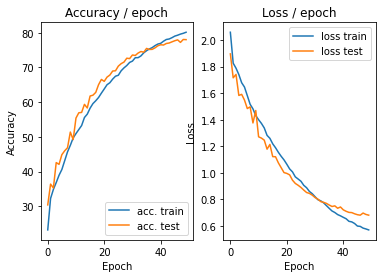

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.6031 (0.6031)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


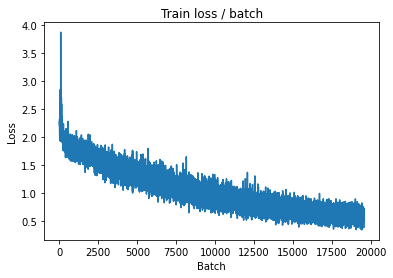

[TRAIN Batch 200/391]	Time 0.065s (0.055s)	Loss 0.5540 (0.5531)	Prec@1  79.7 ( 80.6)	Prec@5  98.4 ( 98.8)


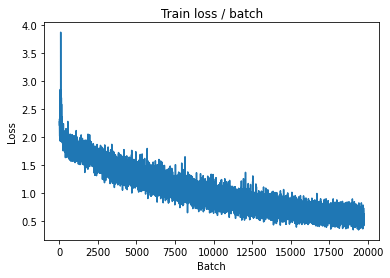


===============> Total time 21s	Avg loss 0.5611	Avg Prec@1 80.31 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.6206 (0.6206)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6642	Avg Prec@1 78.64 %	Avg Prec@5 98.40 %



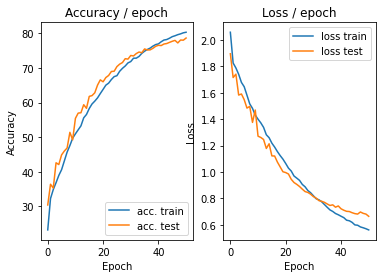

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.5987 (0.5987)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


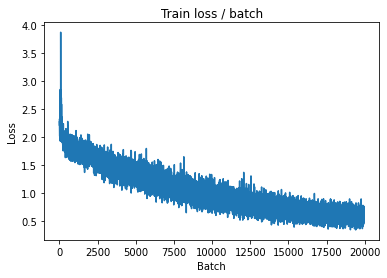

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.4625 (0.5525)	Prec@1  84.4 ( 80.9)	Prec@5 100.0 ( 98.9)


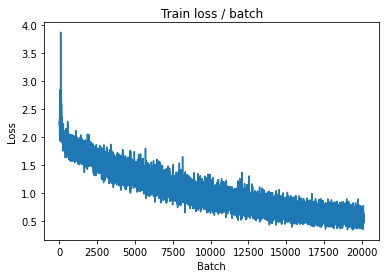


===============> Total time 21s	Avg loss 0.5535	Avg Prec@1 80.69 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.5905 (0.5905)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6606	Avg Prec@1 78.50 %	Avg Prec@5 98.39 %



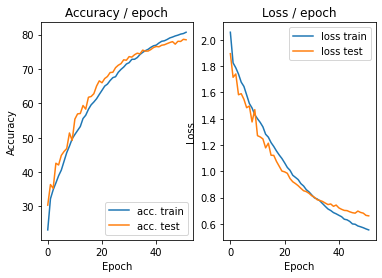

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.5702 (0.5702)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)


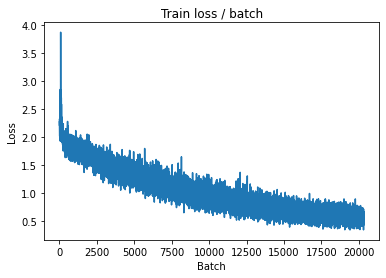

[TRAIN Batch 200/391]	Time 0.031s (0.056s)	Loss 0.5823 (0.5474)	Prec@1  80.5 ( 81.0)	Prec@5  97.7 ( 98.9)


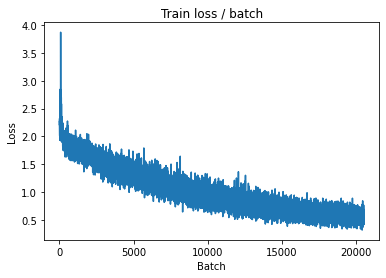


===============> Total time 21s	Avg loss 0.5479	Avg Prec@1 80.77 %	Avg Prec@5 98.90 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.5886 (0.5886)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6795	Avg Prec@1 77.87 %	Avg Prec@5 98.39 %



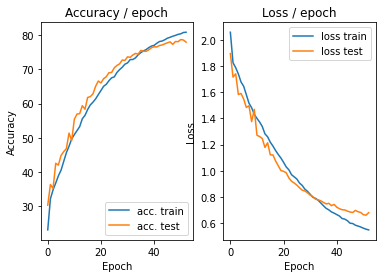

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.4218 (0.4218)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


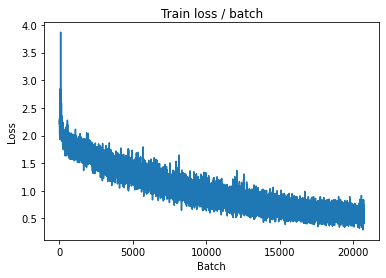

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.4726 (0.5365)	Prec@1  82.0 ( 81.2)	Prec@5 100.0 ( 99.0)


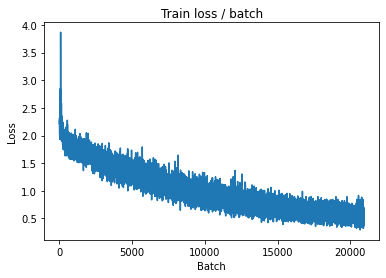


===============> Total time 21s	Avg loss 0.5378	Avg Prec@1 81.13 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.5500 (0.5500)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6618	Avg Prec@1 78.35 %	Avg Prec@5 98.33 %



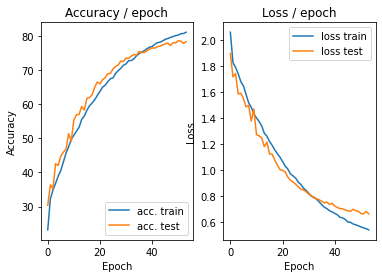

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.5398 (0.5398)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


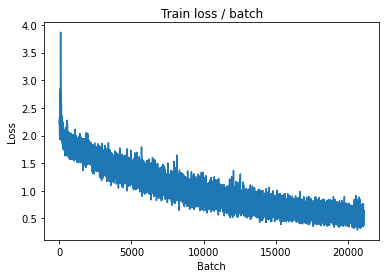

[TRAIN Batch 200/391]	Time 0.082s (0.056s)	Loss 0.4425 (0.5224)	Prec@1  84.4 ( 81.7)	Prec@5 100.0 ( 99.0)


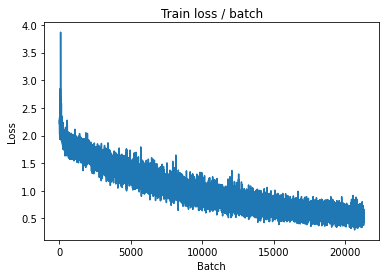


===============> Total time 21s	Avg loss 0.5300	Avg Prec@1 81.36 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.5900 (0.5900)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6590	Avg Prec@1 78.59 %	Avg Prec@5 98.47 %



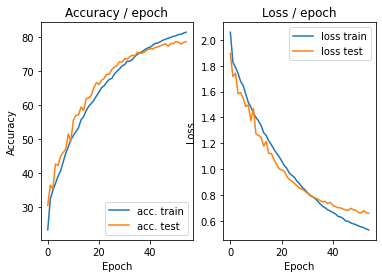

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.5993 (0.5993)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


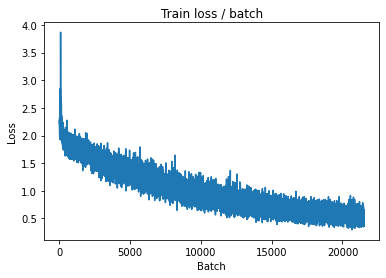

[TRAIN Batch 200/391]	Time 0.085s (0.055s)	Loss 0.5217 (0.5242)	Prec@1  78.1 ( 81.5)	Prec@5 100.0 ( 99.0)


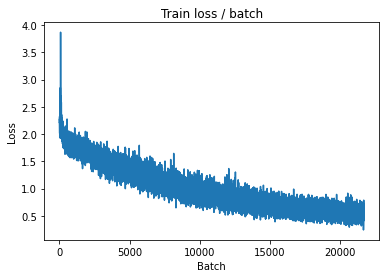


===============> Total time 21s	Avg loss 0.5264	Avg Prec@1 81.51 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.5781 (0.5781)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6619	Avg Prec@1 78.58 %	Avg Prec@5 98.31 %



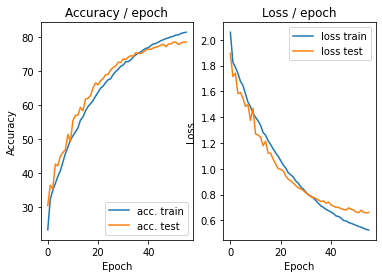

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.4123 (0.4123)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


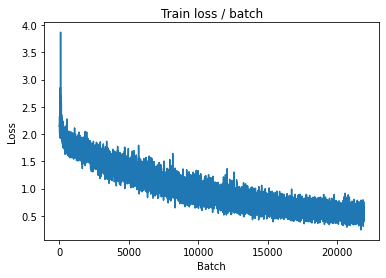

[TRAIN Batch 200/391]	Time 0.022s (0.056s)	Loss 0.5291 (0.5133)	Prec@1  80.5 ( 82.0)	Prec@5  99.2 ( 99.1)


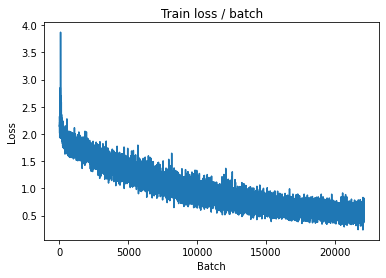


===============> Total time 21s	Avg loss 0.5198	Avg Prec@1 81.74 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 0.5772 (0.5772)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6575	Avg Prec@1 79.02 %	Avg Prec@5 98.48 %



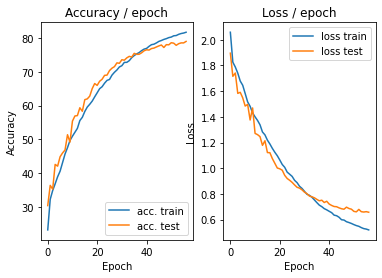

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.5592 (0.5592)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


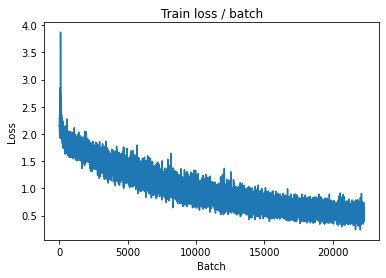

[TRAIN Batch 200/391]	Time 0.075s (0.056s)	Loss 0.5408 (0.5109)	Prec@1  78.9 ( 82.0)	Prec@5  99.2 ( 99.1)


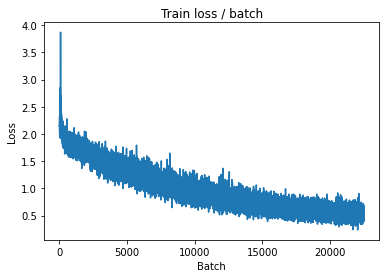


===============> Total time 21s	Avg loss 0.5121	Avg Prec@1 81.90 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.5506 (0.5506)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6572	Avg Prec@1 78.96 %	Avg Prec@5 98.49 %



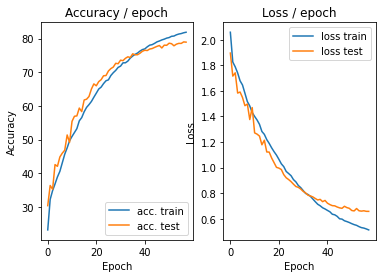

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.5991 (0.5991)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


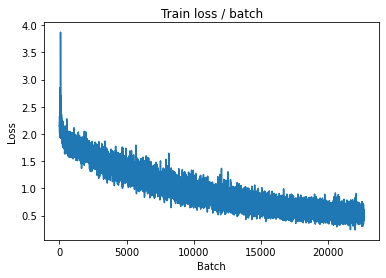

[TRAIN Batch 200/391]	Time 0.025s (0.055s)	Loss 0.5689 (0.5015)	Prec@1  79.7 ( 82.4)	Prec@5  98.4 ( 99.1)


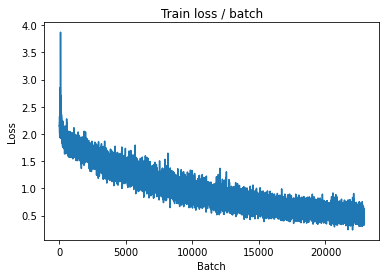


===============> Total time 21s	Avg loss 0.5055	Avg Prec@1 82.31 %	Avg Prec@5 99.09 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.5340 (0.5340)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6532	Avg Prec@1 79.17 %	Avg Prec@5 98.45 %



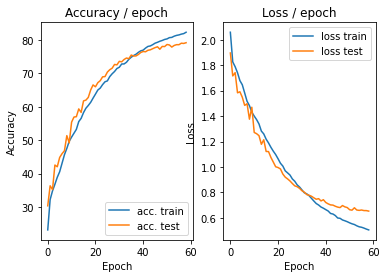

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.4923 (0.4923)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


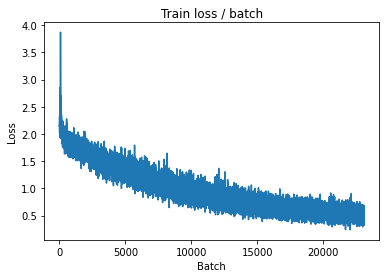

[TRAIN Batch 200/391]	Time 0.021s (0.055s)	Loss 0.5839 (0.5027)	Prec@1  77.3 ( 82.5)	Prec@5  98.4 ( 99.1)


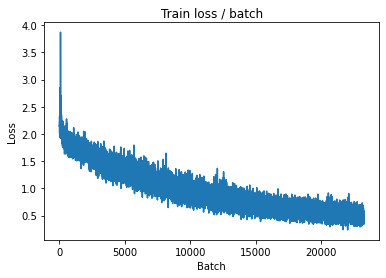


===============> Total time 21s	Avg loss 0.5004	Avg Prec@1 82.51 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 0.5620 (0.5620)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6508	Avg Prec@1 79.12 %	Avg Prec@5 98.49 %



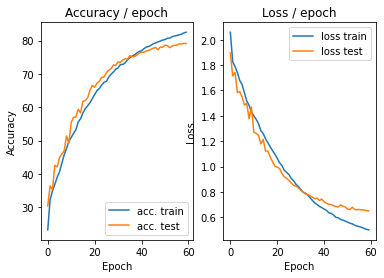

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.5994 (0.5994)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)


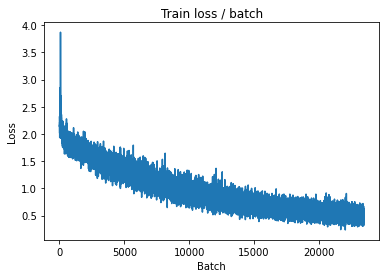

[TRAIN Batch 200/391]	Time 0.088s (0.056s)	Loss 0.4912 (0.4891)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 99.0)


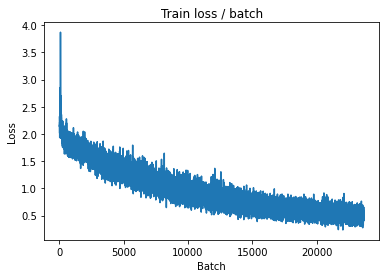


===============> Total time 21s	Avg loss 0.4959	Avg Prec@1 82.50 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.5186 (0.5186)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6514	Avg Prec@1 79.43 %	Avg Prec@5 98.40 %



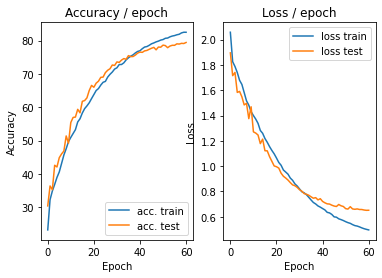

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.4725 (0.4725)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


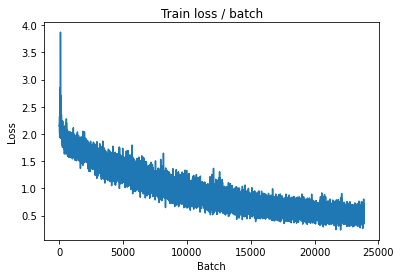

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 0.5058 (0.4891)	Prec@1  81.2 ( 82.7)	Prec@5 100.0 ( 99.2)


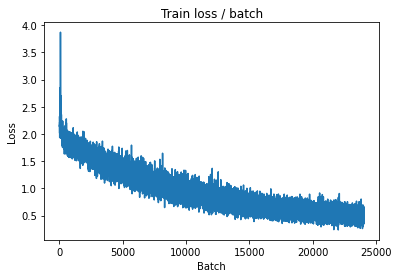


===============> Total time 21s	Avg loss 0.4925	Avg Prec@1 82.72 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.5612 (0.5612)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6515	Avg Prec@1 78.93 %	Avg Prec@5 98.45 %



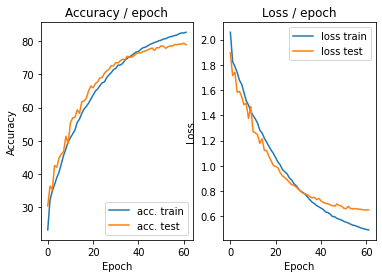

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.5114 (0.5114)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


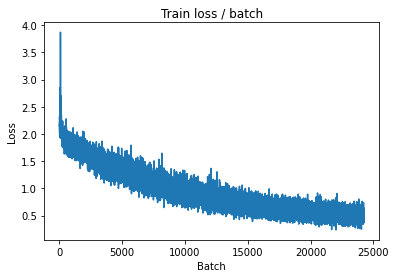

[TRAIN Batch 200/391]	Time 0.065s (0.055s)	Loss 0.3378 (0.4850)	Prec@1  85.9 ( 82.8)	Prec@5 100.0 ( 99.2)


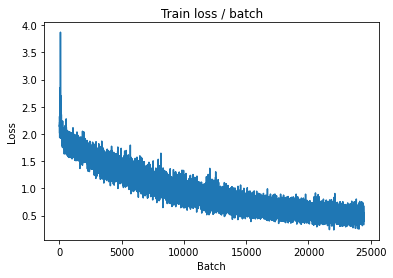


===============> Total time 21s	Avg loss 0.4808	Avg Prec@1 83.07 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.5723 (0.5723)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6521	Avg Prec@1 79.24 %	Avg Prec@5 98.56 %



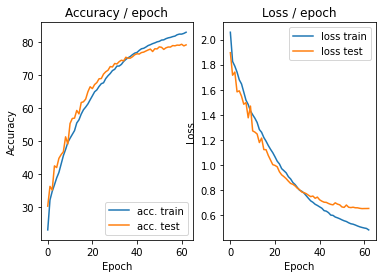

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.6199 (0.6199)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)


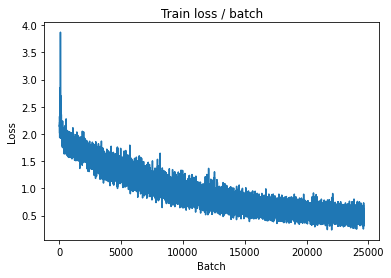

[TRAIN Batch 200/391]	Time 0.027s (0.055s)	Loss 0.4295 (0.4845)	Prec@1  88.3 ( 83.0)	Prec@5  99.2 ( 99.1)


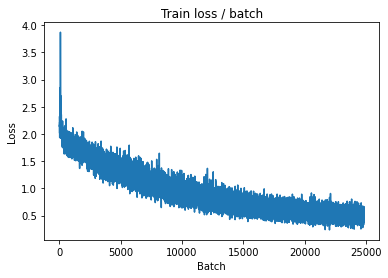


===============> Total time 21s	Avg loss 0.4792	Avg Prec@1 82.99 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.5531 (0.5531)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6506	Avg Prec@1 79.28 %	Avg Prec@5 98.49 %



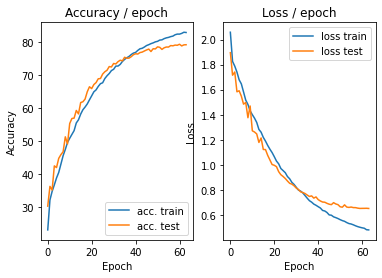

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.4758 (0.4758)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


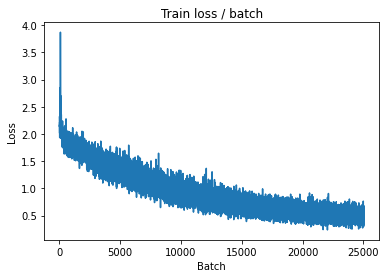

[TRAIN Batch 200/391]	Time 0.026s (0.056s)	Loss 0.5198 (0.4834)	Prec@1  80.5 ( 82.7)	Prec@5 100.0 ( 99.2)


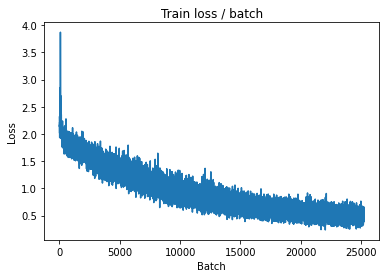


===============> Total time 21s	Avg loss 0.4829	Avg Prec@1 82.84 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.5397 (0.5397)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6466	Avg Prec@1 79.61 %	Avg Prec@5 98.49 %



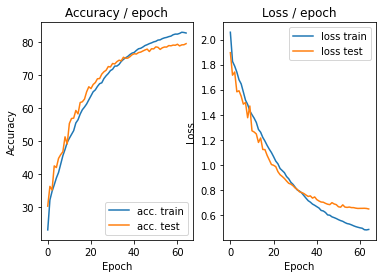

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.5271 (0.5271)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


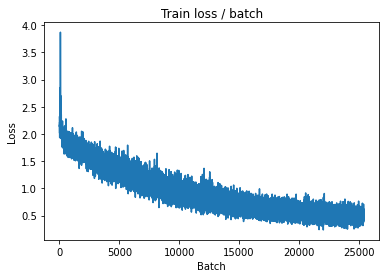

[TRAIN Batch 200/391]	Time 0.034s (0.055s)	Loss 0.3721 (0.4708)	Prec@1  86.7 ( 83.3)	Prec@5  99.2 ( 99.3)


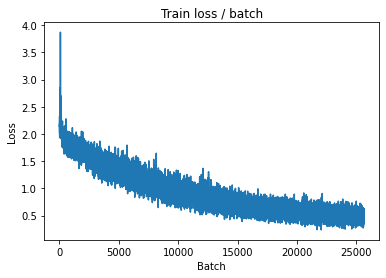


===============> Total time 21s	Avg loss 0.4763	Avg Prec@1 83.25 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.6185 (0.6185)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6482	Avg Prec@1 79.62 %	Avg Prec@5 98.51 %



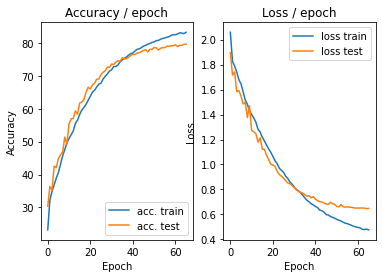

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.4240 (0.4240)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


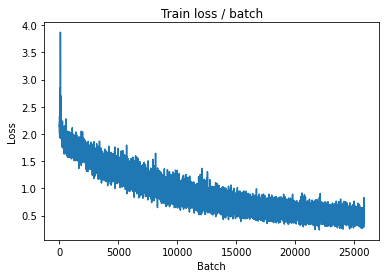

[TRAIN Batch 200/391]	Time 0.077s (0.055s)	Loss 0.4729 (0.4737)	Prec@1  82.0 ( 83.5)	Prec@5  98.4 ( 99.1)


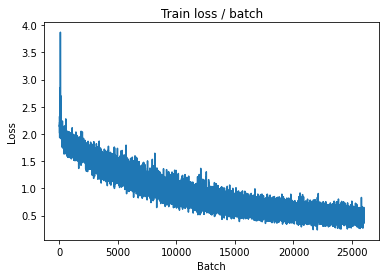


===============> Total time 21s	Avg loss 0.4755	Avg Prec@1 83.29 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.5362 (0.5362)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6442	Avg Prec@1 79.85 %	Avg Prec@5 98.55 %



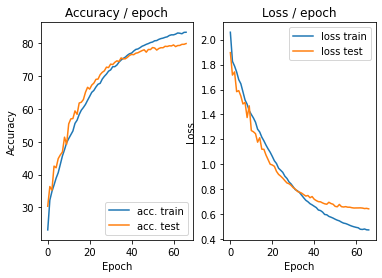

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.3732 (0.3732)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


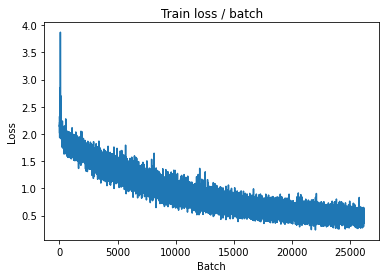

[TRAIN Batch 200/391]	Time 0.028s (0.055s)	Loss 0.5363 (0.4748)	Prec@1  82.8 ( 83.2)	Prec@5  98.4 ( 99.1)


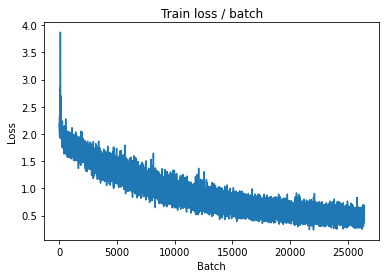


===============> Total time 21s	Avg loss 0.4672	Avg Prec@1 83.42 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.228s (0.228s)	Loss 0.5305 (0.5305)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6413	Avg Prec@1 79.61 %	Avg Prec@5 98.44 %



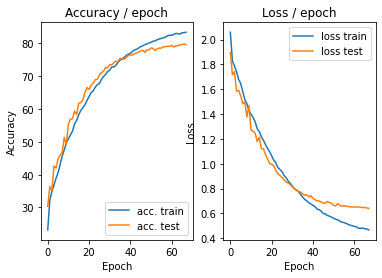

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.4172 (0.4172)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


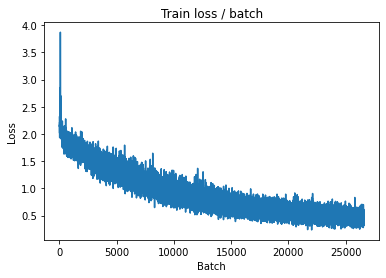

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.4480 (0.4573)	Prec@1  86.7 ( 83.9)	Prec@5  99.2 ( 99.2)


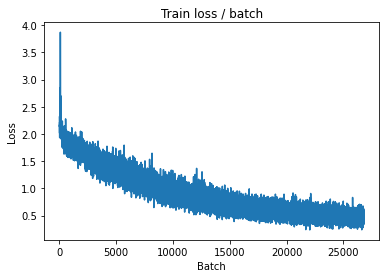


===============> Total time 21s	Avg loss 0.4639	Avg Prec@1 83.78 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.5506 (0.5506)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6315	Avg Prec@1 79.59 %	Avg Prec@5 98.62 %



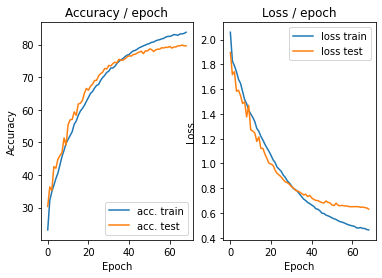

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.5964 (0.5964)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


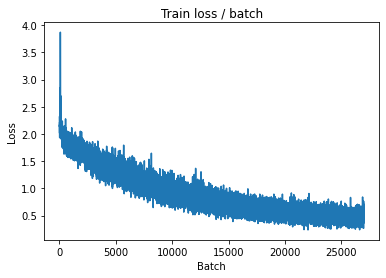

[TRAIN Batch 200/391]	Time 0.063s (0.055s)	Loss 0.4142 (0.4607)	Prec@1  85.9 ( 83.7)	Prec@5 100.0 ( 99.3)


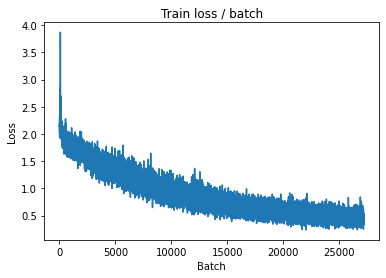


===============> Total time 21s	Avg loss 0.4586	Avg Prec@1 83.81 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 0.5681 (0.5681)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6456	Avg Prec@1 79.79 %	Avg Prec@5 98.52 %



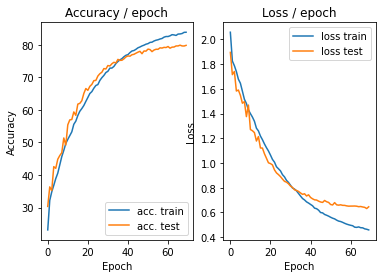

=== EPOCH 71 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.4410 (0.4410)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


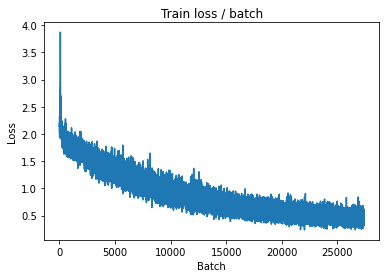

[TRAIN Batch 200/391]	Time 0.032s (0.055s)	Loss 0.3771 (0.4560)	Prec@1  86.7 ( 83.8)	Prec@5  99.2 ( 99.3)


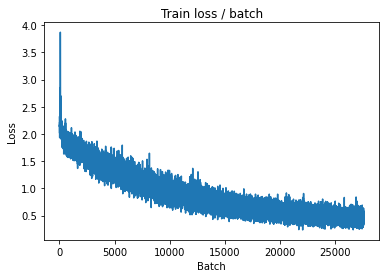


===============> Total time 21s	Avg loss 0.4568	Avg Prec@1 83.84 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.5955 (0.5955)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6374	Avg Prec@1 79.88 %	Avg Prec@5 98.44 %



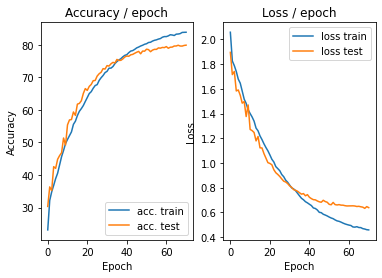

=== EPOCH 72 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 0.3374 (0.3374)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


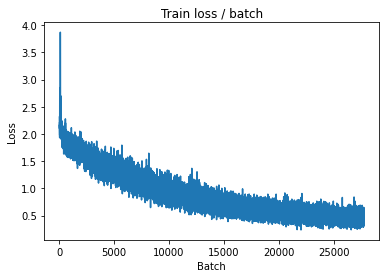

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.4278 (0.4612)	Prec@1  85.2 ( 83.5)	Prec@5  99.2 ( 99.2)


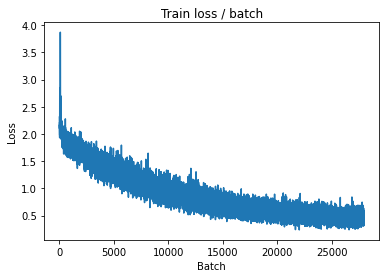


===============> Total time 21s	Avg loss 0.4551	Avg Prec@1 83.81 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.5832 (0.5832)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6401	Avg Prec@1 79.77 %	Avg Prec@5 98.55 %



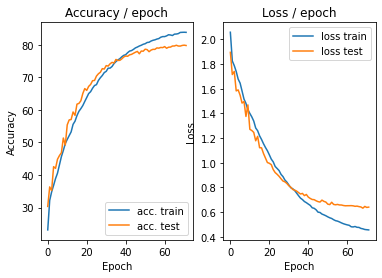

=== EPOCH 73 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 0.4330 (0.4330)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


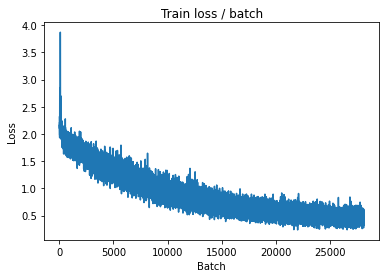

[TRAIN Batch 200/391]	Time 0.094s (0.056s)	Loss 0.5999 (0.4579)	Prec@1  79.7 ( 83.9)	Prec@5  98.4 ( 99.3)


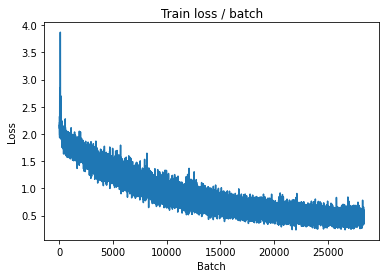


===============> Total time 21s	Avg loss 0.4508	Avg Prec@1 84.00 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.236s (0.236s)	Loss 0.5905 (0.5905)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6351	Avg Prec@1 79.68 %	Avg Prec@5 98.59 %



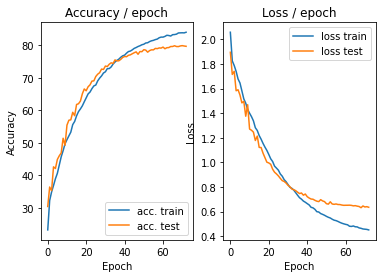

=== EPOCH 74 =====

[TRAIN Batch 000/391]	Time 0.312s (0.312s)	Loss 0.4927 (0.4927)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


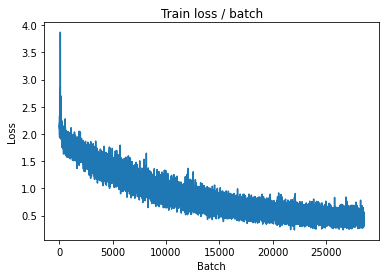

[TRAIN Batch 200/391]	Time 0.075s (0.056s)	Loss 0.5576 (0.4452)	Prec@1  81.2 ( 83.9)	Prec@5  97.7 ( 99.3)


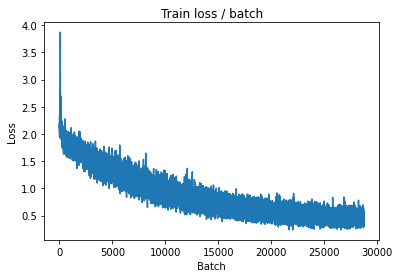


===============> Total time 21s	Avg loss 0.4496	Avg Prec@1 83.92 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.5689 (0.5689)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6351	Avg Prec@1 79.86 %	Avg Prec@5 98.54 %



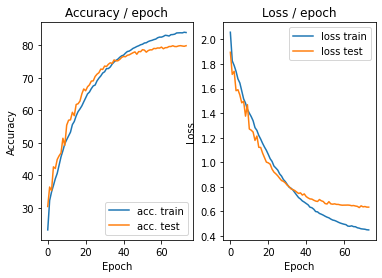

=== EPOCH 75 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.3719 (0.3719)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


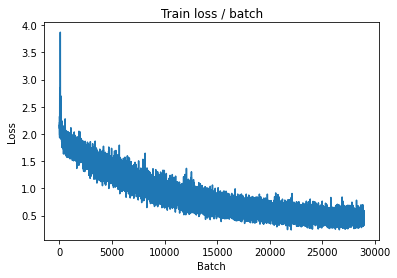

[TRAIN Batch 200/391]	Time 0.021s (0.055s)	Loss 0.3806 (0.4517)	Prec@1  89.1 ( 84.1)	Prec@5  99.2 ( 99.3)


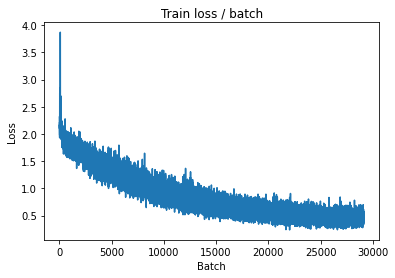


===============> Total time 21s	Avg loss 0.4489	Avg Prec@1 84.17 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.241s (0.241s)	Loss 0.5264 (0.5264)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6276	Avg Prec@1 79.98 %	Avg Prec@5 98.52 %



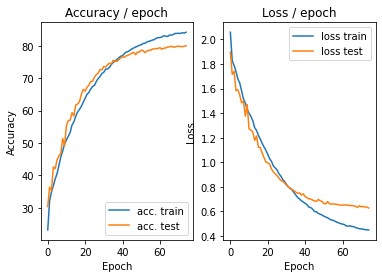

=== EPOCH 76 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.6830 (0.6830)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


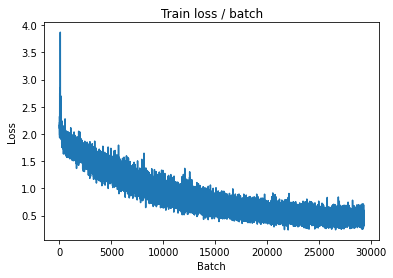

[TRAIN Batch 200/391]	Time 0.096s (0.056s)	Loss 0.5121 (0.4469)	Prec@1  79.7 ( 83.9)	Prec@5 100.0 ( 99.2)


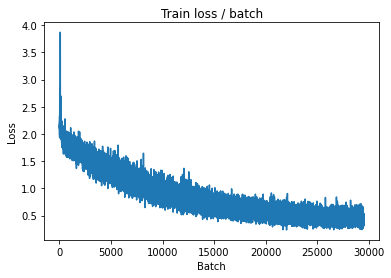


===============> Total time 21s	Avg loss 0.4478	Avg Prec@1 84.00 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.236s (0.236s)	Loss 0.5599 (0.5599)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6280	Avg Prec@1 80.05 %	Avg Prec@5 98.42 %



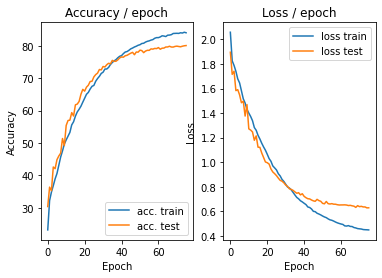

=== EPOCH 77 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.4344 (0.4344)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


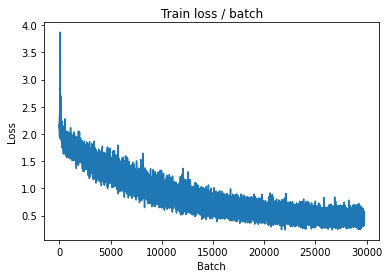

[TRAIN Batch 200/391]	Time 0.085s (0.054s)	Loss 0.4908 (0.4404)	Prec@1  82.0 ( 84.0)	Prec@5 100.0 ( 99.3)


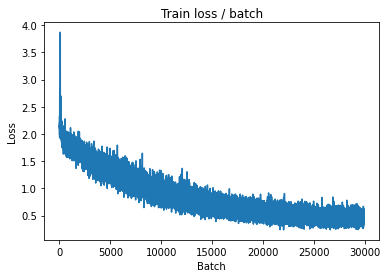


===============> Total time 21s	Avg loss 0.4413	Avg Prec@1 84.17 %	Avg Prec@5 99.32 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.5646 (0.5646)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6246	Avg Prec@1 80.24 %	Avg Prec@5 98.52 %



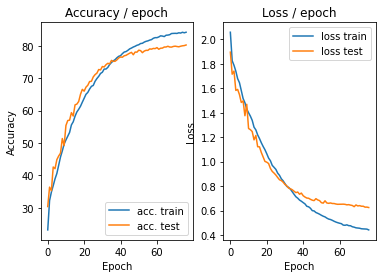

=== EPOCH 78 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.3581 (0.3581)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


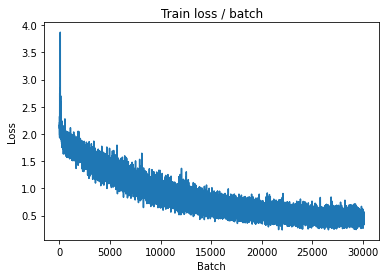

[TRAIN Batch 200/391]	Time 0.024s (0.055s)	Loss 0.4178 (0.4364)	Prec@1  86.7 ( 84.2)	Prec@5  99.2 ( 99.4)


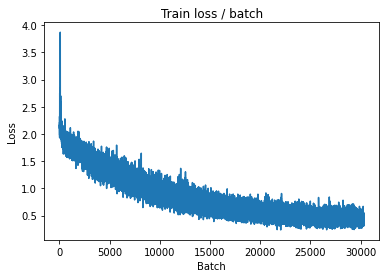


===============> Total time 21s	Avg loss 0.4397	Avg Prec@1 84.21 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.5761 (0.5761)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6300	Avg Prec@1 80.13 %	Avg Prec@5 98.57 %



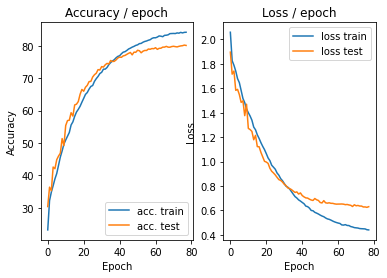

=== EPOCH 79 =====

[TRAIN Batch 000/391]	Time 0.300s (0.300s)	Loss 0.5246 (0.5246)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)


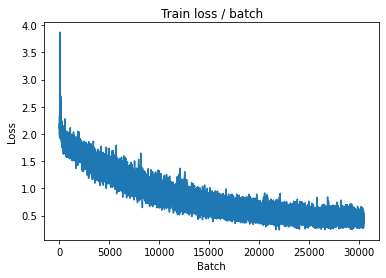

[TRAIN Batch 200/391]	Time 0.022s (0.056s)	Loss 0.3504 (0.4389)	Prec@1  86.7 ( 84.5)	Prec@5 100.0 ( 99.4)


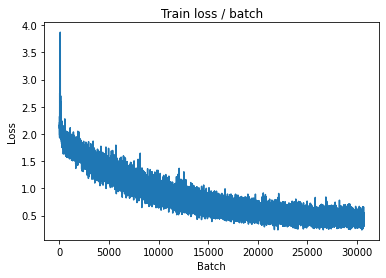


===============> Total time 21s	Avg loss 0.4346	Avg Prec@1 84.56 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.230s (0.230s)	Loss 0.5745 (0.5745)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6296	Avg Prec@1 80.28 %	Avg Prec@5 98.55 %



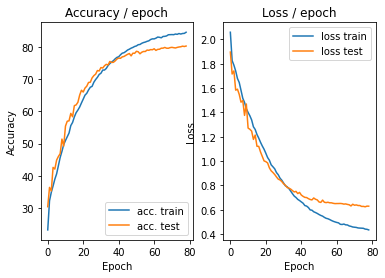

=== EPOCH 80 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.5363 (0.5363)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


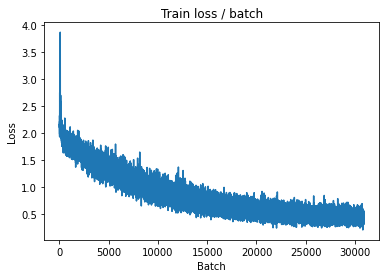

[TRAIN Batch 200/391]	Time 0.090s (0.056s)	Loss 0.3305 (0.4277)	Prec@1  89.8 ( 84.6)	Prec@5 100.0 ( 99.4)


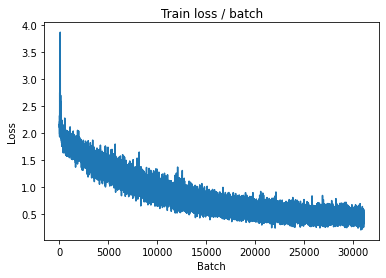


===============> Total time 21s	Avg loss 0.4289	Avg Prec@1 84.71 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.5413 (0.5413)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6249	Avg Prec@1 80.30 %	Avg Prec@5 98.63 %



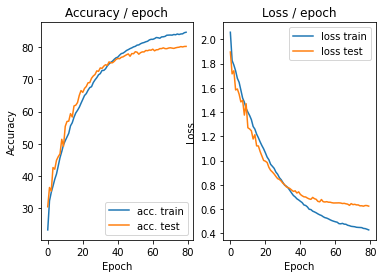

=== EPOCH 81 =====

[TRAIN Batch 000/391]	Time 0.302s (0.302s)	Loss 0.3355 (0.3355)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


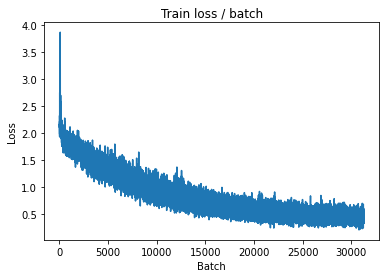

[TRAIN Batch 200/391]	Time 0.086s (0.055s)	Loss 0.4423 (0.4321)	Prec@1  82.8 ( 84.6)	Prec@5 100.0 ( 99.3)


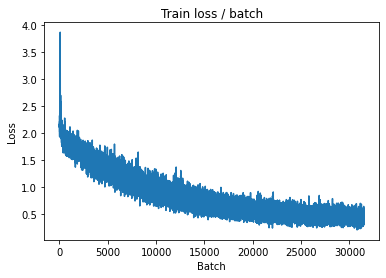


===============> Total time 21s	Avg loss 0.4282	Avg Prec@1 84.75 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.5637 (0.5637)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6295	Avg Prec@1 80.27 %	Avg Prec@5 98.65 %



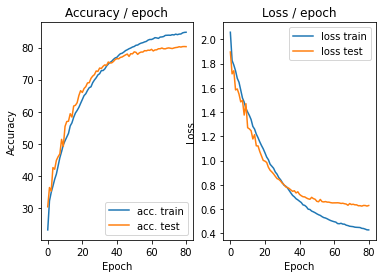

=== EPOCH 82 =====

[TRAIN Batch 000/391]	Time 0.300s (0.300s)	Loss 0.4392 (0.4392)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


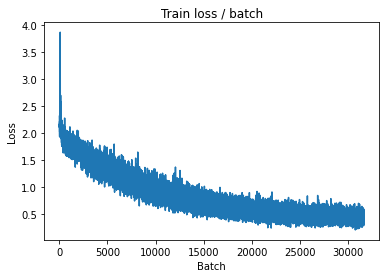

[TRAIN Batch 200/391]	Time 0.019s (0.054s)	Loss 0.4291 (0.4286)	Prec@1  83.6 ( 84.7)	Prec@5  99.2 ( 99.4)


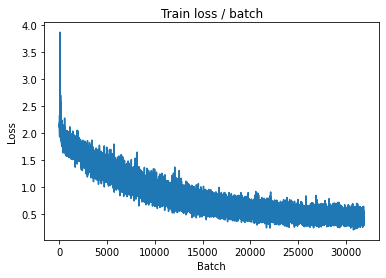


===============> Total time 21s	Avg loss 0.4322	Avg Prec@1 84.63 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.5495 (0.5495)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6250	Avg Prec@1 80.37 %	Avg Prec@5 98.58 %



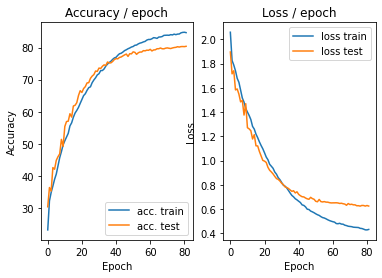

=== EPOCH 83 =====

[TRAIN Batch 000/391]	Time 0.309s (0.309s)	Loss 0.4208 (0.4208)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


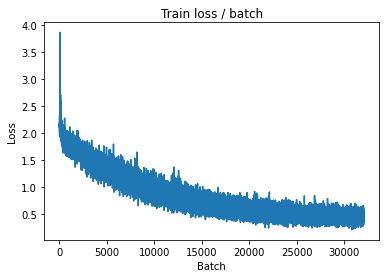

[TRAIN Batch 200/391]	Time 0.073s (0.055s)	Loss 0.4278 (0.4240)	Prec@1  85.2 ( 84.9)	Prec@5  98.4 ( 99.4)


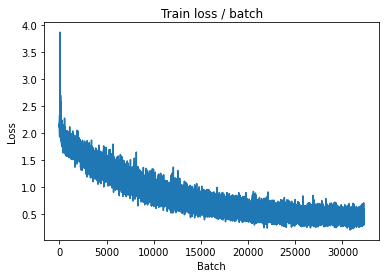


===============> Total time 21s	Avg loss 0.4249	Avg Prec@1 84.89 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.5562 (0.5562)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6283	Avg Prec@1 80.49 %	Avg Prec@5 98.53 %



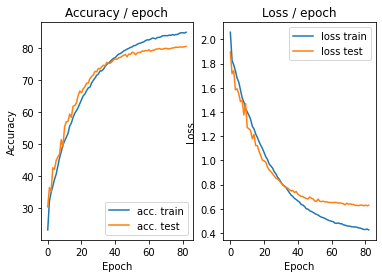

=== EPOCH 84 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.4814 (0.4814)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


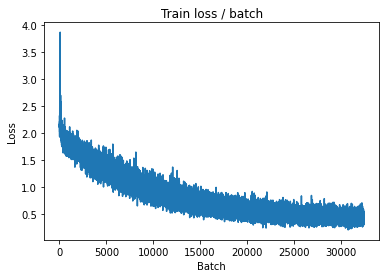

[TRAIN Batch 200/391]	Time 0.018s (0.056s)	Loss 0.4454 (0.4256)	Prec@1  80.5 ( 85.0)	Prec@5  99.2 ( 99.4)


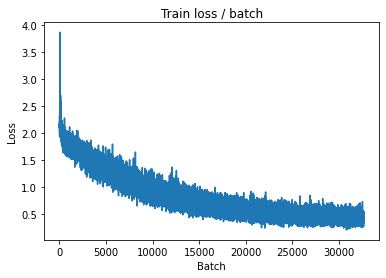


===============> Total time 21s	Avg loss 0.4280	Avg Prec@1 84.84 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 0.5381 (0.5381)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6248	Avg Prec@1 80.53 %	Avg Prec@5 98.62 %



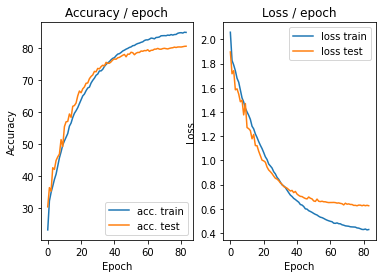

=== EPOCH 85 =====

[TRAIN Batch 000/391]	Time 0.320s (0.320s)	Loss 0.4086 (0.4086)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


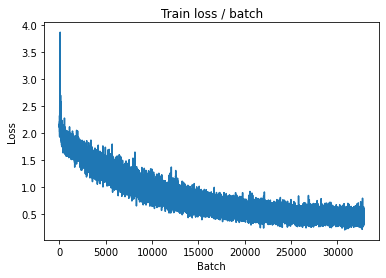

[TRAIN Batch 200/391]	Time 0.038s (0.055s)	Loss 0.4238 (0.4291)	Prec@1  86.7 ( 84.6)	Prec@5  99.2 ( 99.4)


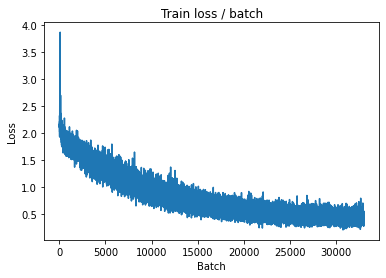


===============> Total time 21s	Avg loss 0.4273	Avg Prec@1 84.71 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.236s (0.236s)	Loss 0.5497 (0.5497)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6264	Avg Prec@1 80.26 %	Avg Prec@5 98.59 %



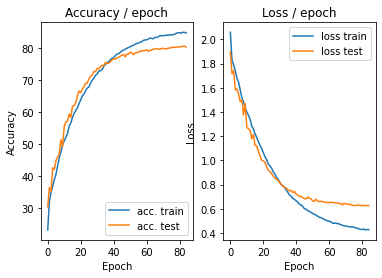

=== EPOCH 86 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.2707 (0.2707)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


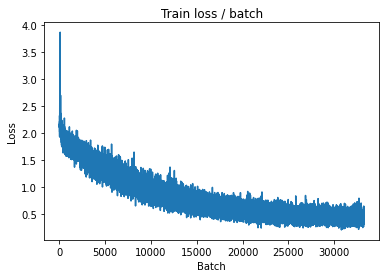

[TRAIN Batch 200/391]	Time 0.063s (0.055s)	Loss 0.2803 (0.4188)	Prec@1  91.4 ( 85.0)	Prec@5 100.0 ( 99.4)


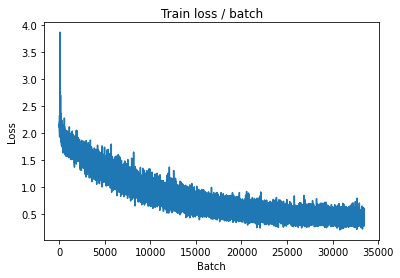


===============> Total time 21s	Avg loss 0.4199	Avg Prec@1 84.99 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.232s (0.232s)	Loss 0.5422 (0.5422)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6249	Avg Prec@1 80.41 %	Avg Prec@5 98.63 %



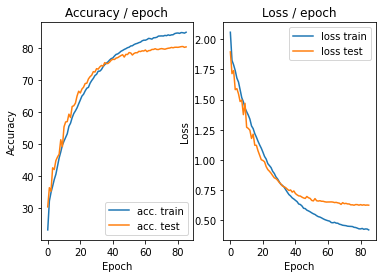

=== EPOCH 87 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.3592 (0.3592)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)


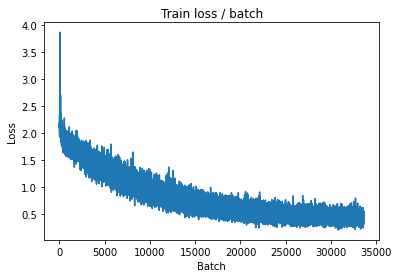

[TRAIN Batch 200/391]	Time 0.090s (0.056s)	Loss 0.4486 (0.4220)	Prec@1  82.0 ( 85.0)	Prec@5 100.0 ( 99.4)


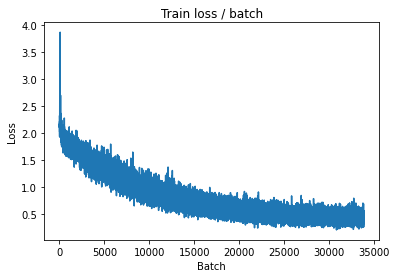


===============> Total time 21s	Avg loss 0.4208	Avg Prec@1 85.11 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.5571 (0.5571)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6244	Avg Prec@1 80.46 %	Avg Prec@5 98.59 %



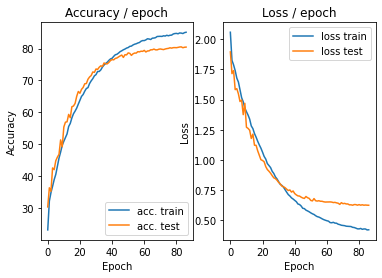

=== EPOCH 88 =====

[TRAIN Batch 000/391]	Time 0.315s (0.315s)	Loss 0.4398 (0.4398)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


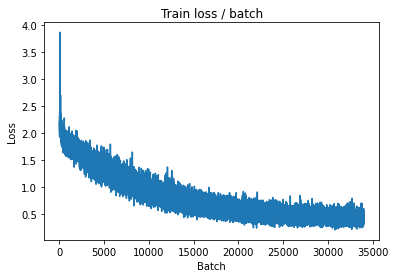

[TRAIN Batch 200/391]	Time 0.059s (0.055s)	Loss 0.4660 (0.4134)	Prec@1  85.9 ( 85.4)	Prec@5  98.4 ( 99.4)


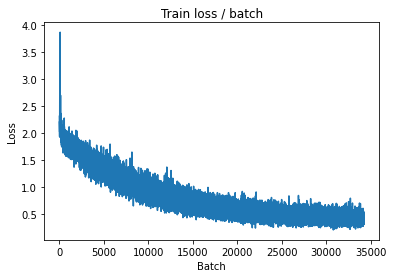


===============> Total time 21s	Avg loss 0.4188	Avg Prec@1 85.10 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.232s (0.232s)	Loss 0.5445 (0.5445)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6236	Avg Prec@1 80.45 %	Avg Prec@5 98.56 %



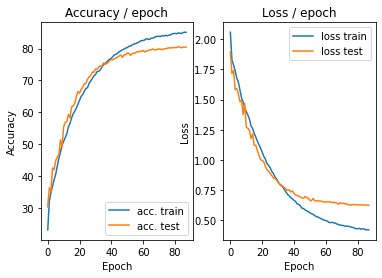

=== EPOCH 89 =====

[TRAIN Batch 000/391]	Time 0.310s (0.310s)	Loss 0.2900 (0.2900)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


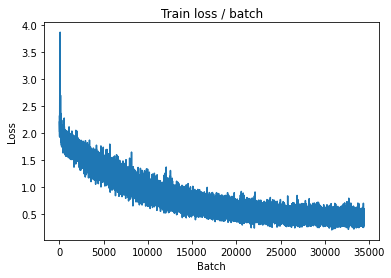

[TRAIN Batch 200/391]	Time 0.061s (0.055s)	Loss 0.3220 (0.4196)	Prec@1  90.6 ( 85.3)	Prec@5  99.2 ( 99.4)


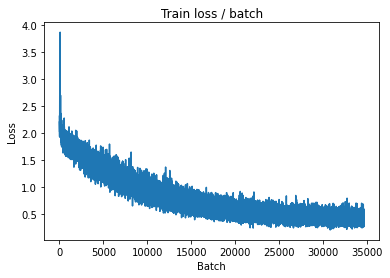


===============> Total time 21s	Avg loss 0.4214	Avg Prec@1 85.07 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.5297 (0.5297)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6230	Avg Prec@1 80.69 %	Avg Prec@5 98.62 %



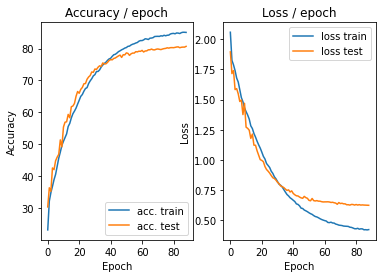

=== EPOCH 90 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 0.3652 (0.3652)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


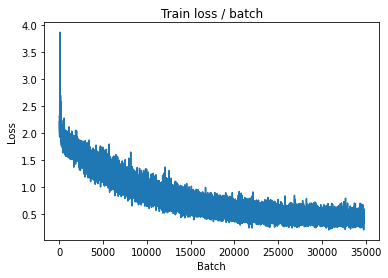

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.3872 (0.4158)	Prec@1  85.9 ( 85.3)	Prec@5  99.2 ( 99.4)


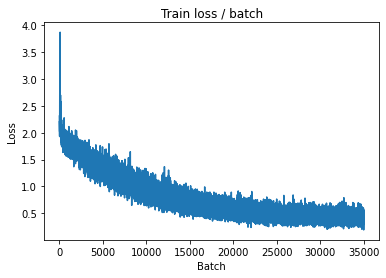


===============> Total time 21s	Avg loss 0.4167	Avg Prec@1 85.19 %	Avg Prec@5 99.45 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 0.5263 (0.5263)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6250	Avg Prec@1 80.54 %	Avg Prec@5 98.61 %



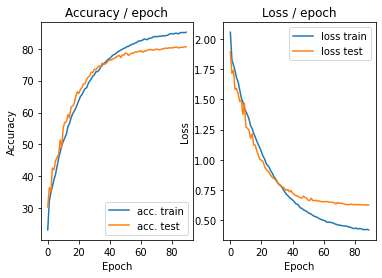

=== EPOCH 91 =====

[TRAIN Batch 000/391]	Time 0.308s (0.308s)	Loss 0.5269 (0.5269)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)


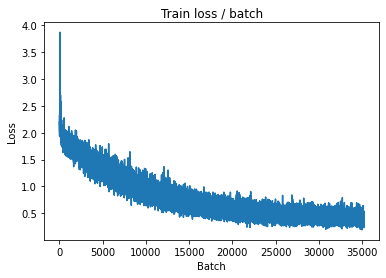

[TRAIN Batch 200/391]	Time 0.065s (0.055s)	Loss 0.4550 (0.4214)	Prec@1  84.4 ( 85.1)	Prec@5  99.2 ( 99.3)


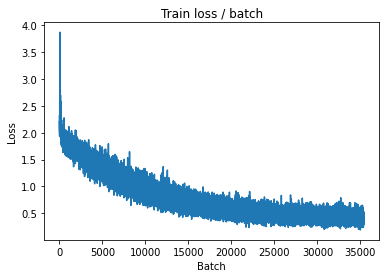


===============> Total time 21s	Avg loss 0.4182	Avg Prec@1 85.10 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.267s (0.267s)	Loss 0.5354 (0.5354)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6225	Avg Prec@1 80.63 %	Avg Prec@5 98.71 %



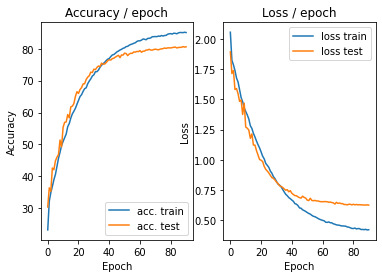

=== EPOCH 92 =====

[TRAIN Batch 000/391]	Time 0.324s (0.324s)	Loss 0.3306 (0.3306)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


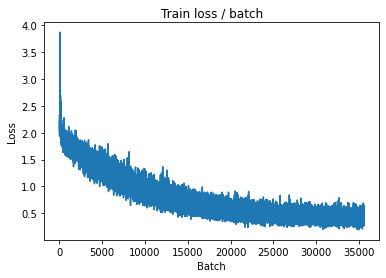

[TRAIN Batch 200/391]	Time 0.060s (0.056s)	Loss 0.4414 (0.4102)	Prec@1  87.5 ( 85.4)	Prec@5  98.4 ( 99.4)


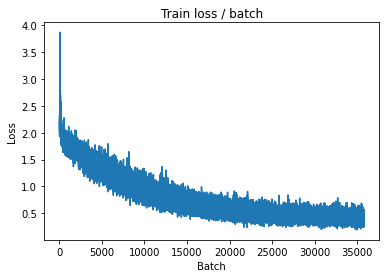


===============> Total time 21s	Avg loss 0.4134	Avg Prec@1 85.26 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.234s (0.234s)	Loss 0.5259 (0.5259)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6222	Avg Prec@1 80.63 %	Avg Prec@5 98.69 %



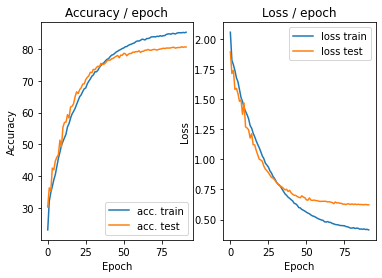

=== EPOCH 93 =====

[TRAIN Batch 000/391]	Time 0.304s (0.304s)	Loss 0.4759 (0.4759)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


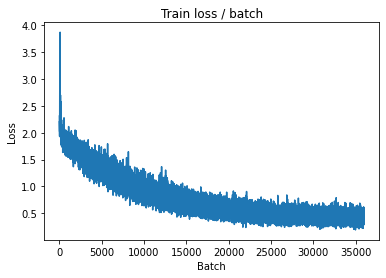

[TRAIN Batch 200/391]	Time 0.064s (0.055s)	Loss 0.5064 (0.4156)	Prec@1  84.4 ( 85.1)	Prec@5  99.2 ( 99.5)


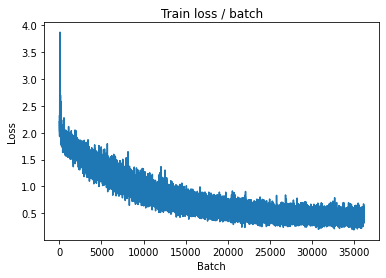


===============> Total time 21s	Avg loss 0.4143	Avg Prec@1 85.22 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.241s (0.241s)	Loss 0.5266 (0.5266)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6229	Avg Prec@1 80.57 %	Avg Prec@5 98.58 %



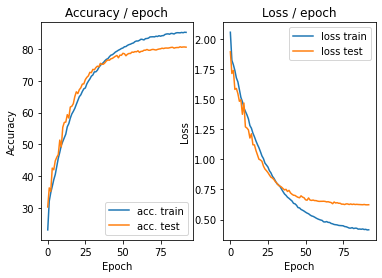

=== EPOCH 94 =====

[TRAIN Batch 000/391]	Time 0.344s (0.344s)	Loss 0.3586 (0.3586)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


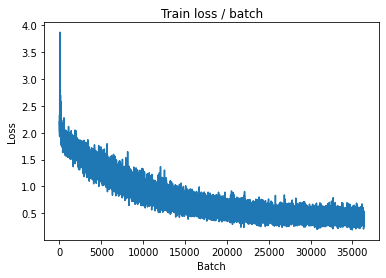

[TRAIN Batch 200/391]	Time 0.018s (0.055s)	Loss 0.3763 (0.4187)	Prec@1  85.9 ( 85.0)	Prec@5  99.2 ( 99.4)


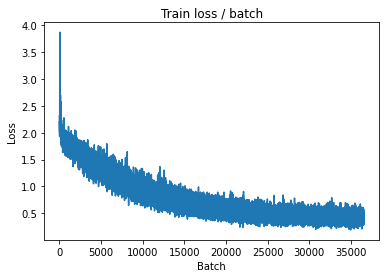


===============> Total time 21s	Avg loss 0.4159	Avg Prec@1 85.12 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.240s (0.240s)	Loss 0.5256 (0.5256)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6224	Avg Prec@1 80.64 %	Avg Prec@5 98.64 %



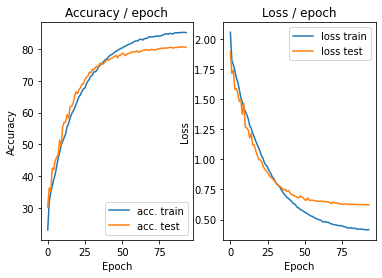

=== EPOCH 95 =====

[TRAIN Batch 000/391]	Time 0.312s (0.312s)	Loss 0.4325 (0.4325)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


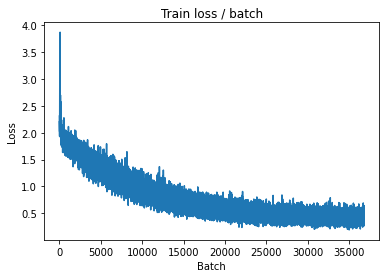

[TRAIN Batch 200/391]	Time 0.023s (0.055s)	Loss 0.4560 (0.4155)	Prec@1  82.8 ( 85.1)	Prec@5  98.4 ( 99.5)


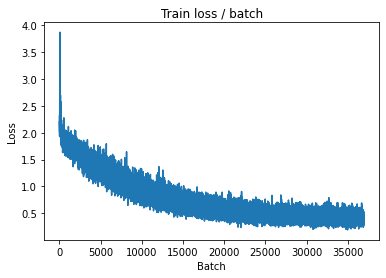


===============> Total time 21s	Avg loss 0.4148	Avg Prec@1 85.06 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.245s (0.245s)	Loss 0.5350 (0.5350)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6236	Avg Prec@1 80.52 %	Avg Prec@5 98.57 %



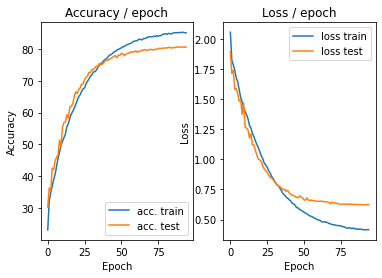

=== EPOCH 96 =====

[TRAIN Batch 000/391]	Time 0.326s (0.326s)	Loss 0.3626 (0.3626)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


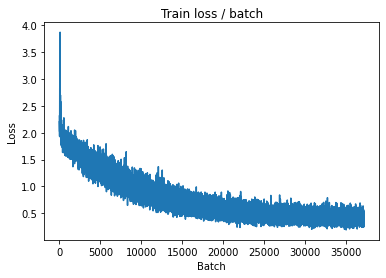

[TRAIN Batch 200/391]	Time 0.028s (0.056s)	Loss 0.4866 (0.4120)	Prec@1  80.5 ( 85.2)	Prec@5  99.2 ( 99.5)


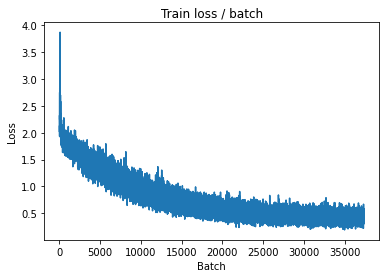


===============> Total time 21s	Avg loss 0.4116	Avg Prec@1 85.40 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.258s (0.258s)	Loss 0.5326 (0.5326)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6243	Avg Prec@1 80.54 %	Avg Prec@5 98.58 %



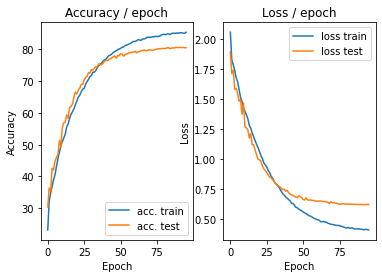

=== EPOCH 97 =====

[TRAIN Batch 000/391]	Time 0.288s (0.288s)	Loss 0.3570 (0.3570)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


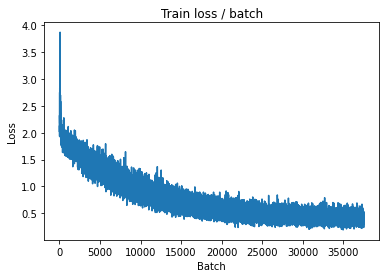

[TRAIN Batch 200/391]	Time 0.059s (0.055s)	Loss 0.4612 (0.4080)	Prec@1  82.0 ( 85.7)	Prec@5  99.2 ( 99.4)


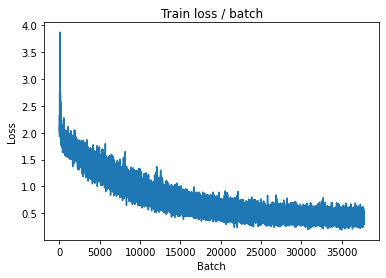


===============> Total time 21s	Avg loss 0.4107	Avg Prec@1 85.54 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.5287 (0.5287)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6224	Avg Prec@1 80.68 %	Avg Prec@5 98.69 %



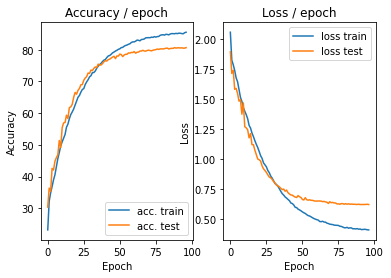

=== EPOCH 98 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.3279 (0.3279)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


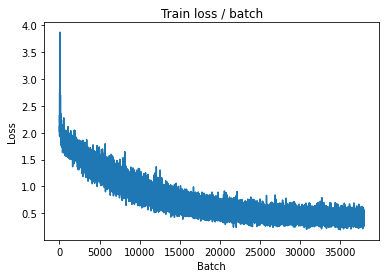

[TRAIN Batch 200/391]	Time 0.069s (0.055s)	Loss 0.3824 (0.4026)	Prec@1  85.2 ( 85.7)	Prec@5 100.0 ( 99.5)


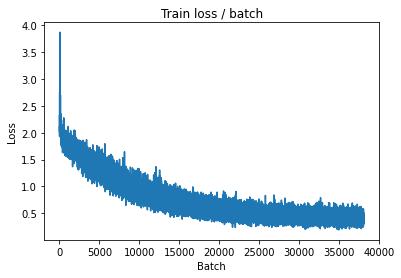


===============> Total time 21s	Avg loss 0.4075	Avg Prec@1 85.52 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.242s (0.242s)	Loss 0.5420 (0.5420)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6207	Avg Prec@1 80.66 %	Avg Prec@5 98.68 %



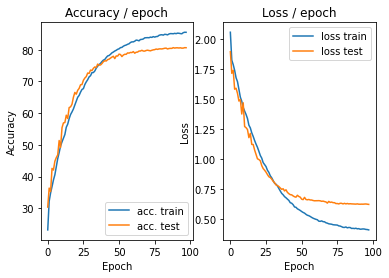

=== EPOCH 99 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 0.5352 (0.5352)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


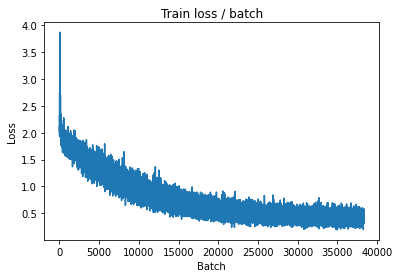

[TRAIN Batch 200/391]	Time 0.095s (0.056s)	Loss 0.3556 (0.4155)	Prec@1  86.7 ( 85.2)	Prec@5 100.0 ( 99.4)


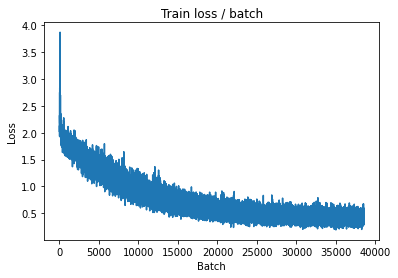


===============> Total time 21s	Avg loss 0.4092	Avg Prec@1 85.42 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.237s (0.237s)	Loss 0.5432 (0.5432)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6227	Avg Prec@1 80.69 %	Avg Prec@5 98.65 %



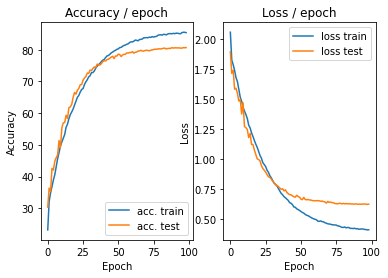

=== EPOCH 100 =====

[TRAIN Batch 000/391]	Time 0.328s (0.328s)	Loss 0.5192 (0.5192)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


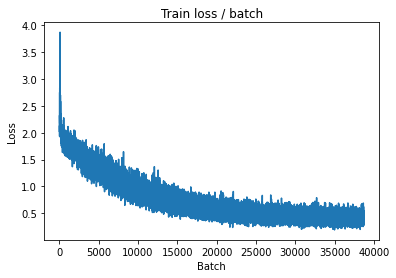

[TRAIN Batch 200/391]	Time 0.026s (0.056s)	Loss 0.3344 (0.4085)	Prec@1  85.2 ( 85.4)	Prec@5 100.0 ( 99.5)


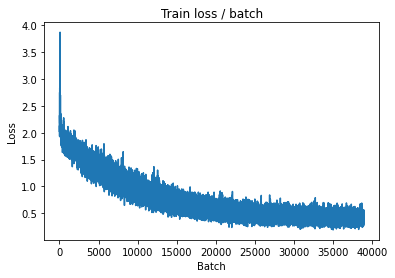


===============> Total time 21s	Avg loss 0.4101	Avg Prec@1 85.46 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 0.5400 (0.5400)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6209	Avg Prec@1 80.64 %	Avg Prec@5 98.66 %



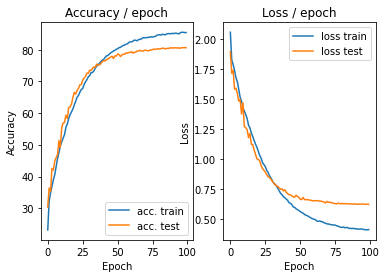

In [ ]:
main(128, 0.1, 100, cuda=True)

Partie 3.5 Utilisation de batch normalization

In [ ]:
class ConvNetBatchNorm(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNetBatchNorm, self).__init__()
        # On défini d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2), #conv1
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool1
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), #conv2
            nn.BatchNorm2d(64),
            nn.ReLU(), 
            nn.MaxPool2d((2, 2), stride=2, padding=0), #pool2
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2), #conv3
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), #pool3
        )
        # On défini les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000), #fc4
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10), #fc5
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )   

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on applati les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaqu
    image (listées dans `transform=...`).
    """
    normalize = transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.RandomCrop(28), transforms.RandomHorizontalFlip()               
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(), normalize, transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Fait une passe (appelée epoch en anglais) sur les données `data` avec le
    modèle `model`. Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, effectue une epoch d'évaluation (pas de backward)
    du modèle.
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex de params :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNetBatchNorm()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
    
    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Apres chaque epoch, modifier le learning rate
        lr_sched.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.757s (0.757s)	Loss 2.3400 (2.3400)	Prec@1  13.3 ( 13.3)	Prec@5  50.0 ( 50.0)


<Figure size 432x288 with 0 Axes>

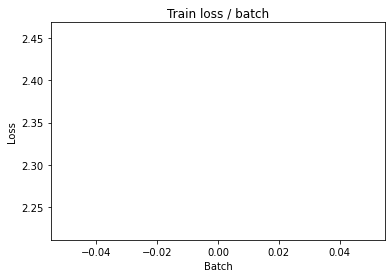

[TRAIN Batch 200/391]	Time 0.026s (0.058s)	Loss 1.4659 (1.7441)	Prec@1  45.3 ( 36.1)	Prec@5  89.8 ( 86.8)


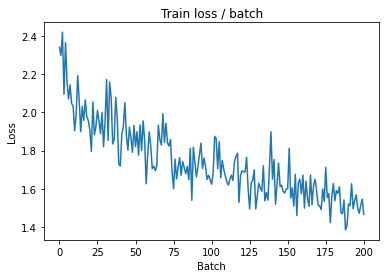


===============> Total time 21s	Avg loss 1.5836	Avg Prec@1 42.50 %	Avg Prec@5 89.70 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.2300 (1.2300)	Prec@1  56.2 ( 56.2)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.2800	Avg Prec@1 55.77 %	Avg Prec@5 93.87 %



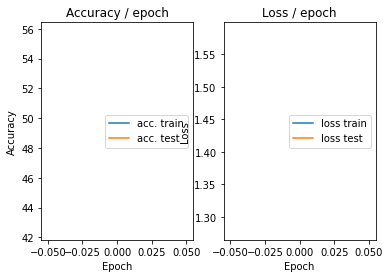

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 1.2094 (1.2094)	Prec@1  57.8 ( 57.8)	Prec@5  96.9 ( 96.9)


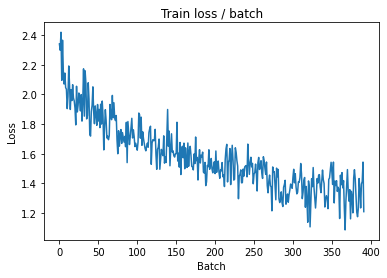

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 1.0790 (1.2040)	Prec@1  62.5 ( 57.6)	Prec@5  96.9 ( 95.1)


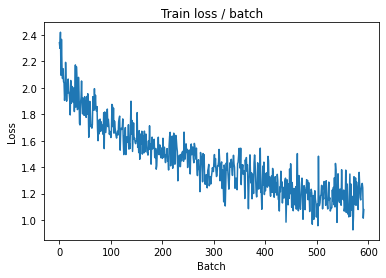


===============> Total time 21s	Avg loss 1.1483	Avg Prec@1 59.54 %	Avg Prec@5 95.44 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.2872 (1.2872)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.3002	Avg Prec@1 58.10 %	Avg Prec@5 94.97 %



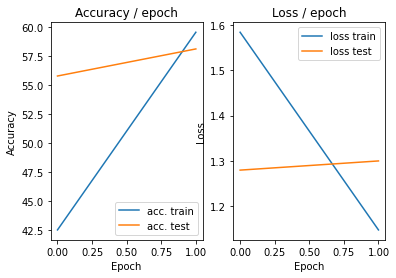

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 1.0174 (1.0174)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)


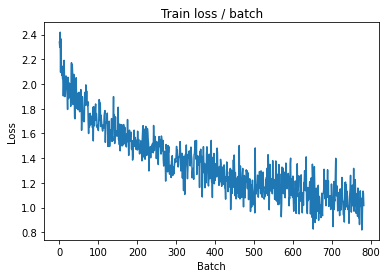

[TRAIN Batch 200/391]	Time 0.022s (0.055s)	Loss 0.7794 (1.0098)	Prec@1  71.1 ( 64.5)	Prec@5  99.2 ( 96.4)


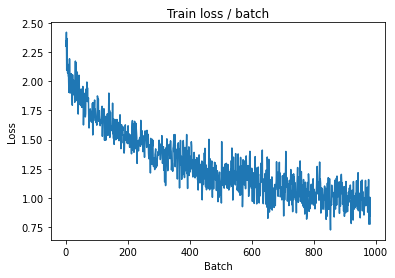


===============> Total time 21s	Avg loss 0.9866	Avg Prec@1 65.60 %	Avg Prec@5 96.56 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.6934 (0.6934)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.8487	Avg Prec@1 70.71 %	Avg Prec@5 97.62 %



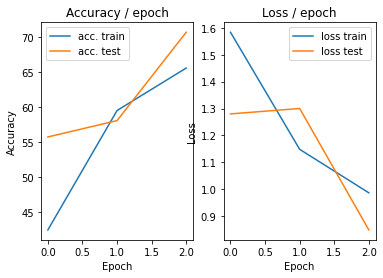

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.8179 (0.8179)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)


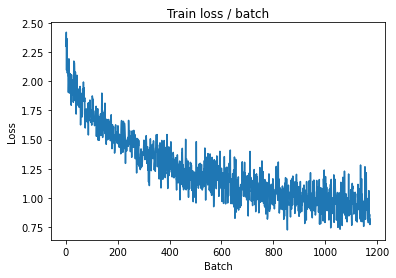

[TRAIN Batch 200/391]	Time 0.030s (0.056s)	Loss 0.7092 (0.8840)	Prec@1  75.0 ( 69.2)	Prec@5  99.2 ( 97.2)


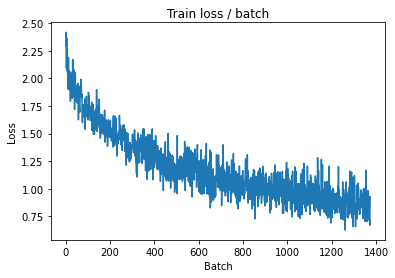


===============> Total time 21s	Avg loss 0.8759	Avg Prec@1 69.49 %	Avg Prec@5 97.26 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.9102 (0.9102)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8740	Avg Prec@1 70.01 %	Avg Prec@5 97.20 %



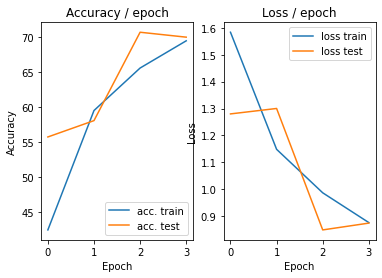

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 1.0416 (1.0416)	Prec@1  68.0 ( 68.0)	Prec@5  94.5 ( 94.5)


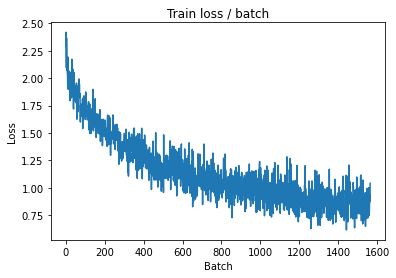

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.5964 (0.8140)	Prec@1  81.2 ( 71.9)	Prec@5 100.0 ( 97.9)


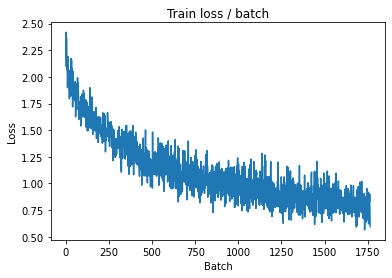


===============> Total time 21s	Avg loss 0.8011	Avg Prec@1 72.48 %	Avg Prec@5 97.78 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.8206 (0.8206)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8309	Avg Prec@1 72.13 %	Avg Prec@5 97.73 %



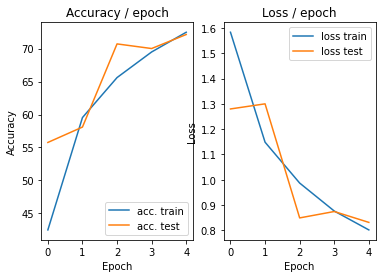

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.7983 (0.7983)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)


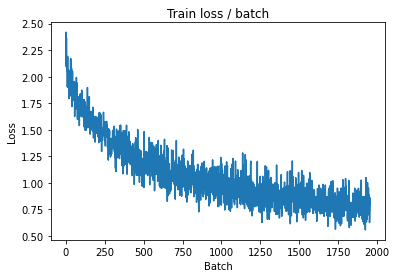

[TRAIN Batch 200/391]	Time 0.094s (0.057s)	Loss 0.8338 (0.7471)	Prec@1  69.5 ( 74.1)	Prec@5  99.2 ( 98.0)


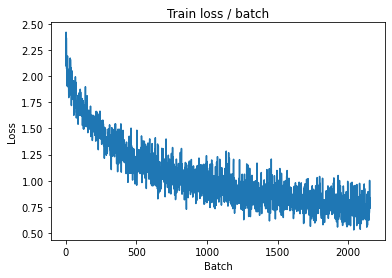


===============> Total time 21s	Avg loss 0.7468	Avg Prec@1 74.24 %	Avg Prec@5 98.06 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.7394 (0.7394)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7615	Avg Prec@1 74.13 %	Avg Prec@5 98.09 %



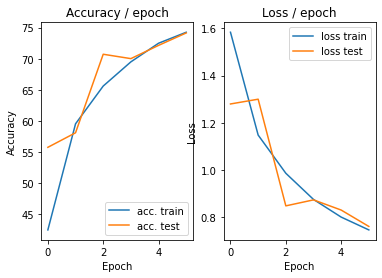

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.5478 (0.5478)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


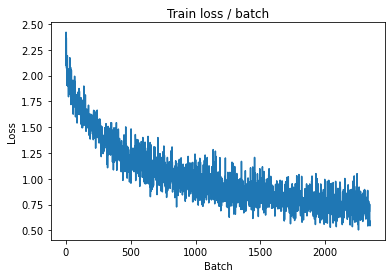

[TRAIN Batch 200/391]	Time 0.080s (0.057s)	Loss 0.7733 (0.6891)	Prec@1  73.4 ( 76.0)	Prec@5  97.7 ( 98.3)


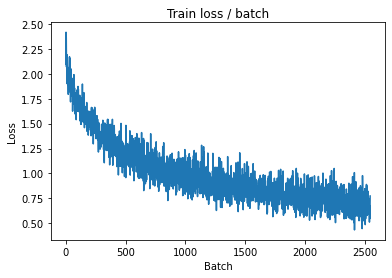


===============> Total time 21s	Avg loss 0.6989	Avg Prec@1 75.79 %	Avg Prec@5 98.32 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.5971 (0.5971)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7147	Avg Prec@1 75.69 %	Avg Prec@5 98.31 %



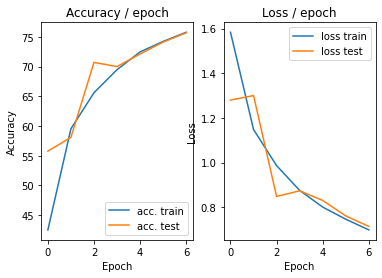

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.6340 (0.6340)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


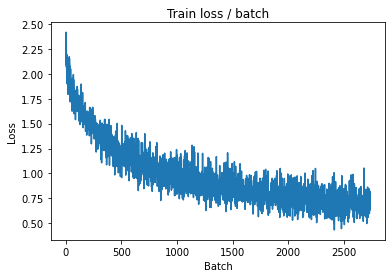

[TRAIN Batch 200/391]	Time 0.092s (0.057s)	Loss 0.5447 (0.6513)	Prec@1  82.8 ( 77.5)	Prec@5  98.4 ( 98.5)


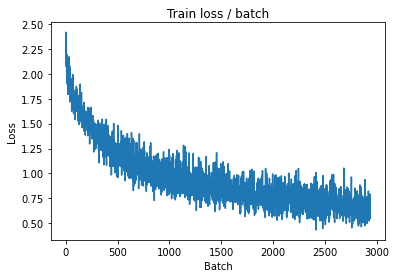


===============> Total time 22s	Avg loss 0.6542	Avg Prec@1 77.42 %	Avg Prec@5 98.48 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.5327 (0.5327)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6832	Avg Prec@1 76.75 %	Avg Prec@5 98.38 %



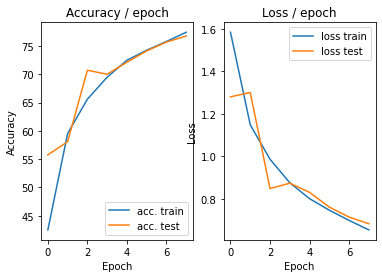

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4397 (0.4397)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


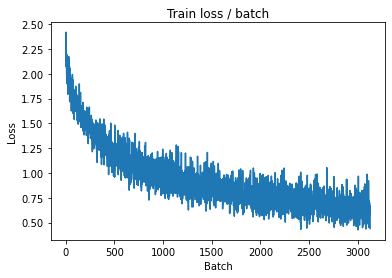

[TRAIN Batch 200/391]	Time 0.025s (0.058s)	Loss 0.5318 (0.6204)	Prec@1  82.8 ( 78.6)	Prec@5 100.0 ( 98.7)


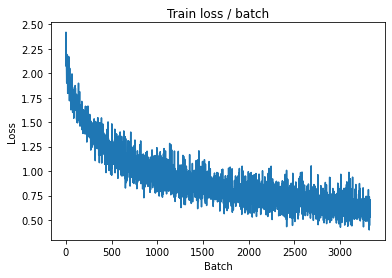


===============> Total time 22s	Avg loss 0.6229	Avg Prec@1 78.54 %	Avg Prec@5 98.68 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.6208 (0.6208)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6433	Avg Prec@1 78.75 %	Avg Prec@5 98.46 %



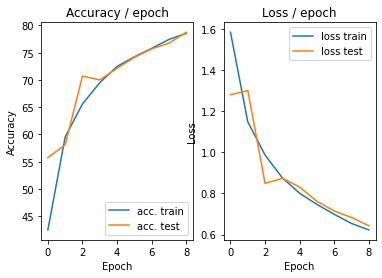

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.6516 (0.6516)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


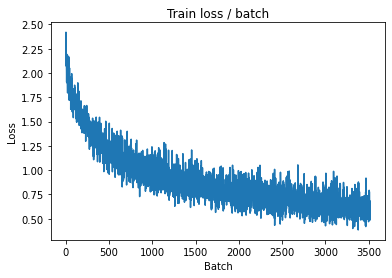

[TRAIN Batch 200/391]	Time 0.092s (0.056s)	Loss 0.5327 (0.5832)	Prec@1  82.8 ( 79.7)	Prec@5  99.2 ( 98.9)


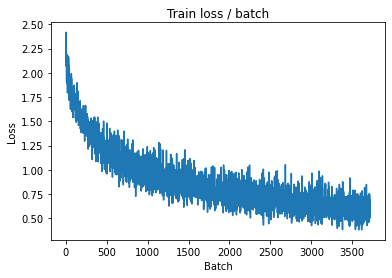


===============> Total time 21s	Avg loss 0.5933	Avg Prec@1 79.48 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.5794 (0.5794)	Prec@1  85.2 ( 85.2)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6072	Avg Prec@1 79.56 %	Avg Prec@5 98.61 %



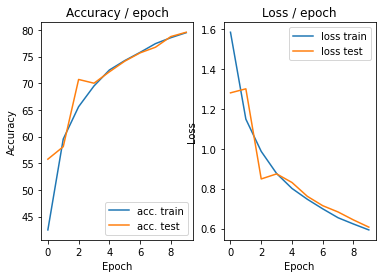

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.6053 (0.6053)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)


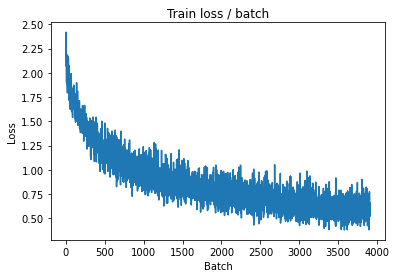

[TRAIN Batch 200/391]	Time 0.077s (0.057s)	Loss 0.6031 (0.5657)	Prec@1  76.6 ( 80.5)	Prec@5  98.4 ( 98.8)


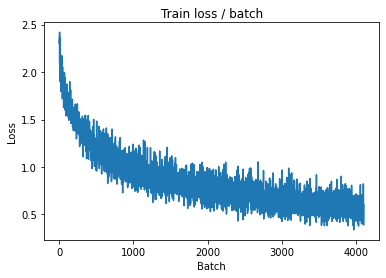


===============> Total time 21s	Avg loss 0.5619	Avg Prec@1 80.59 %	Avg Prec@5 98.86 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.5115 (0.5115)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6519	Avg Prec@1 78.38 %	Avg Prec@5 98.50 %



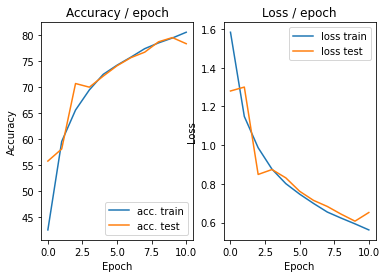

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.5003 (0.5003)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


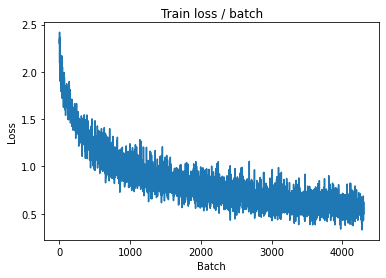

[TRAIN Batch 200/391]	Time 0.021s (0.057s)	Loss 0.4765 (0.5381)	Prec@1  82.8 ( 81.4)	Prec@5 100.0 ( 99.0)


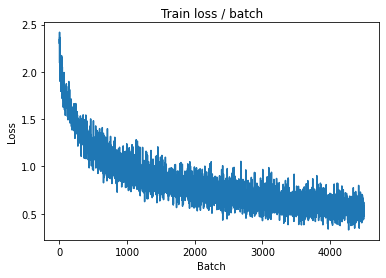


===============> Total time 21s	Avg loss 0.5463	Avg Prec@1 81.02 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.5694 (0.5694)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6780	Avg Prec@1 78.28 %	Avg Prec@5 98.48 %



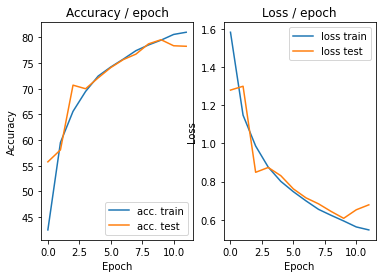

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.5893 (0.5893)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


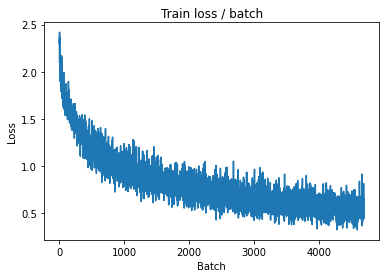

[TRAIN Batch 200/391]	Time 0.017s (0.057s)	Loss 0.5816 (0.5261)	Prec@1  78.1 ( 81.6)	Prec@5  99.2 ( 99.1)


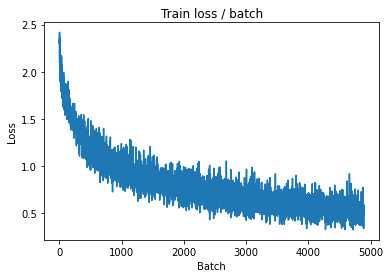


===============> Total time 21s	Avg loss 0.5232	Avg Prec@1 81.73 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.4324 (0.4324)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5944	Avg Prec@1 80.00 %	Avg Prec@5 98.73 %



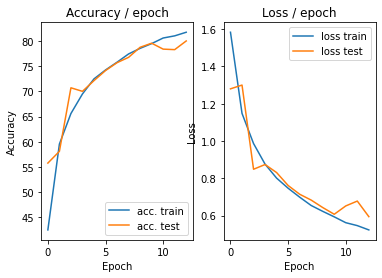

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.5136 (0.5136)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)


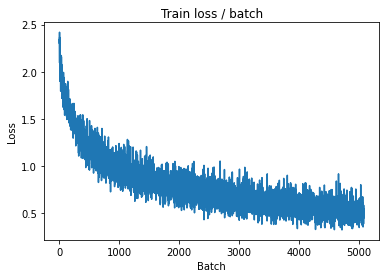

[TRAIN Batch 200/391]	Time 0.100s (0.057s)	Loss 0.4820 (0.5026)	Prec@1  79.7 ( 82.5)	Prec@5  98.4 ( 99.2)


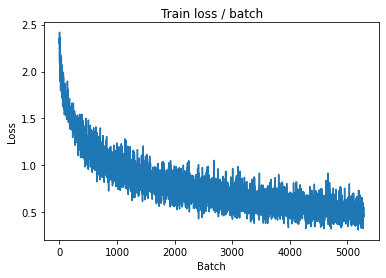


===============> Total time 22s	Avg loss 0.5031	Avg Prec@1 82.52 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.5433 (0.5433)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.5815	Avg Prec@1 81.11 %	Avg Prec@5 98.78 %



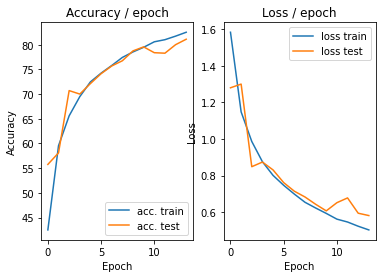

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.6271 (0.6271)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


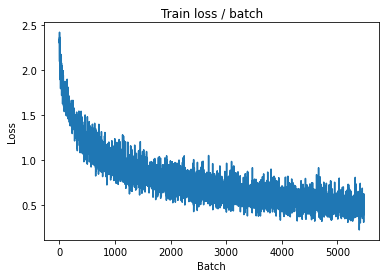

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.6900 (0.4850)	Prec@1  80.5 ( 83.1)	Prec@5  96.9 ( 99.3)


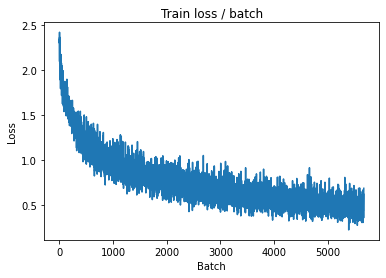


===============> Total time 21s	Avg loss 0.4872	Avg Prec@1 83.07 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.5307 (0.5307)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6271	Avg Prec@1 79.33 %	Avg Prec@5 98.79 %



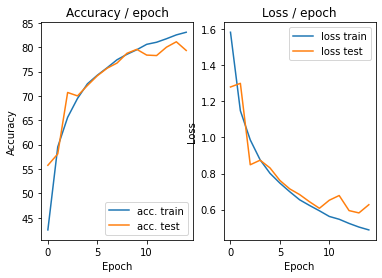

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.5809 (0.5809)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


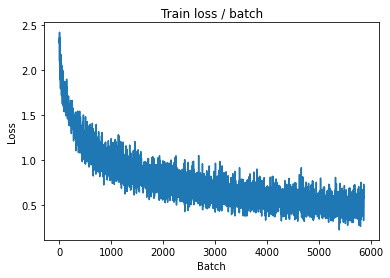

[TRAIN Batch 200/391]	Time 0.098s (0.056s)	Loss 0.4394 (0.4594)	Prec@1  82.8 ( 83.9)	Prec@5  99.2 ( 99.3)


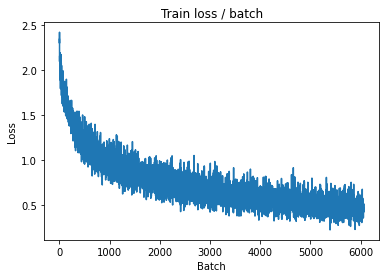


===============> Total time 21s	Avg loss 0.4645	Avg Prec@1 83.69 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.4951 (0.4951)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5547	Avg Prec@1 81.80 %	Avg Prec@5 98.80 %



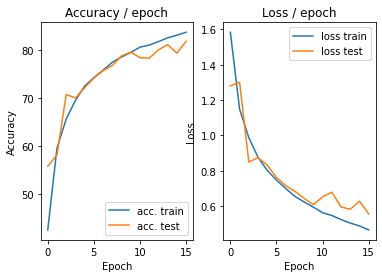

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.5284 (0.5284)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


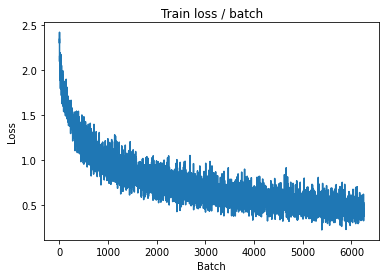

[TRAIN Batch 200/391]	Time 0.098s (0.057s)	Loss 0.4778 (0.4446)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 ( 99.4)


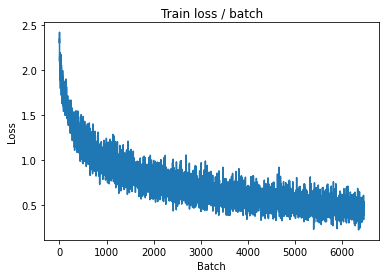


===============> Total time 21s	Avg loss 0.4472	Avg Prec@1 84.33 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.5349 (0.5349)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5683	Avg Prec@1 81.31 %	Avg Prec@5 98.89 %



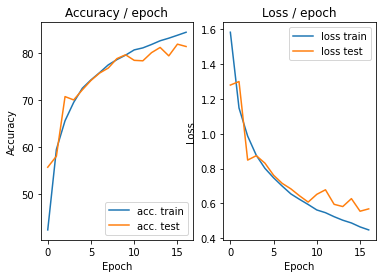

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.5603 (0.5603)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


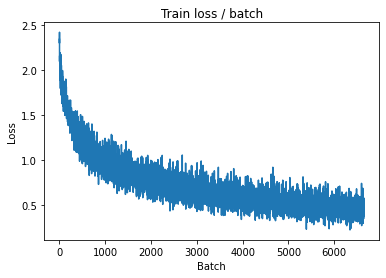

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.5623 (0.4365)	Prec@1  81.2 ( 84.6)	Prec@5  99.2 ( 99.4)


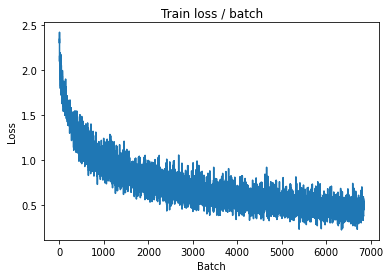


===============> Total time 21s	Avg loss 0.4365	Avg Prec@1 84.72 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.4732 (0.4732)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5456	Avg Prec@1 82.17 %	Avg Prec@5 99.03 %



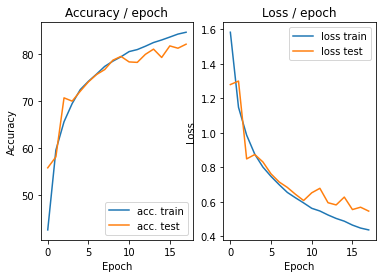

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.3195 (0.3195)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


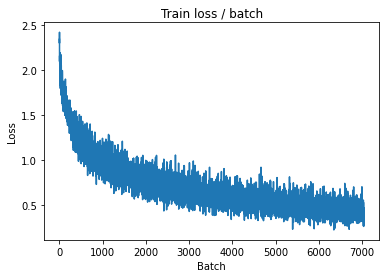

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.3723 (0.4271)	Prec@1  85.9 ( 84.8)	Prec@5  98.4 ( 99.4)


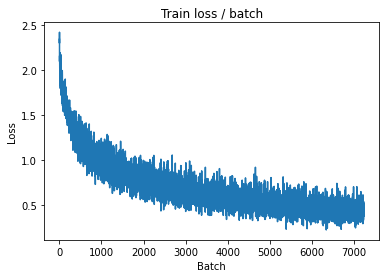


===============> Total time 21s	Avg loss 0.4252	Avg Prec@1 85.09 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.4620 (0.4620)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5474	Avg Prec@1 81.88 %	Avg Prec@5 98.87 %



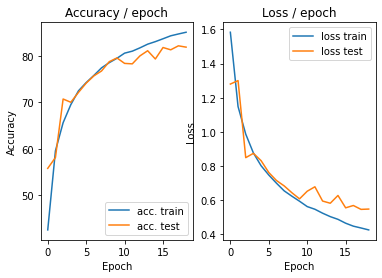

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.3683 (0.3683)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


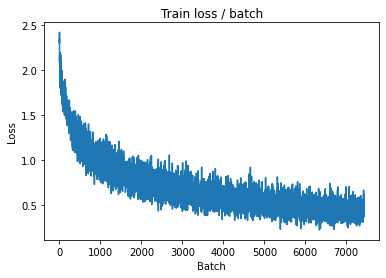

[TRAIN Batch 200/391]	Time 0.070s (0.058s)	Loss 0.2811 (0.3991)	Prec@1  91.4 ( 86.1)	Prec@5 100.0 ( 99.6)


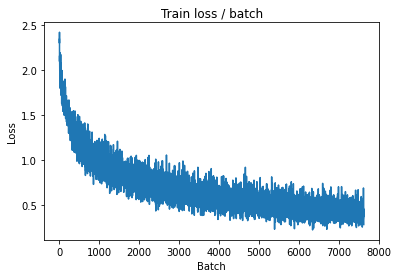


===============> Total time 22s	Avg loss 0.4091	Avg Prec@1 85.71 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.4463 (0.4463)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5405	Avg Prec@1 82.15 %	Avg Prec@5 98.97 %



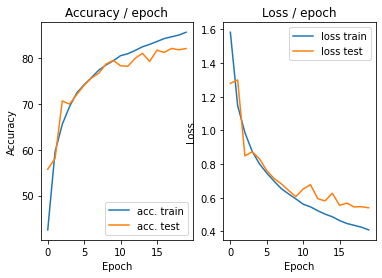

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.3627 (0.3627)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


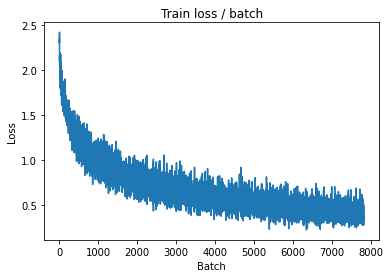

[TRAIN Batch 200/391]	Time 0.076s (0.057s)	Loss 0.3445 (0.3893)	Prec@1  85.2 ( 86.4)	Prec@5  99.2 ( 99.5)


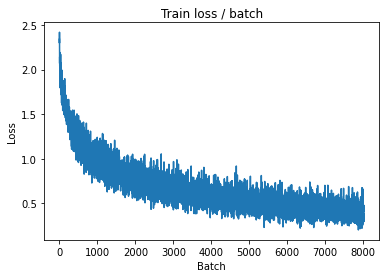


===============> Total time 21s	Avg loss 0.3913	Avg Prec@1 86.38 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.4933 (0.4933)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5447	Avg Prec@1 82.57 %	Avg Prec@5 99.02 %



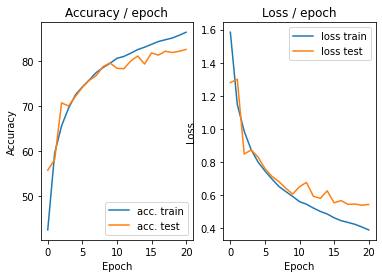

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.4402 (0.4402)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


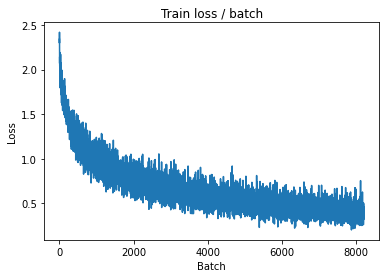

[TRAIN Batch 200/391]	Time 0.080s (0.056s)	Loss 0.3643 (0.3841)	Prec@1  89.1 ( 86.6)	Prec@5 100.0 ( 99.5)


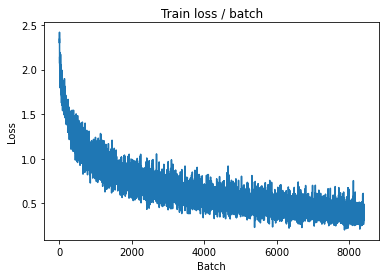


===============> Total time 21s	Avg loss 0.3840	Avg Prec@1 86.61 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.4369 (0.4369)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5061	Avg Prec@1 83.33 %	Avg Prec@5 99.09 %



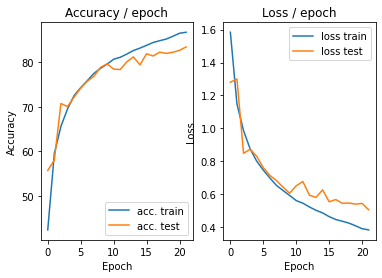

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.3328 (0.3328)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


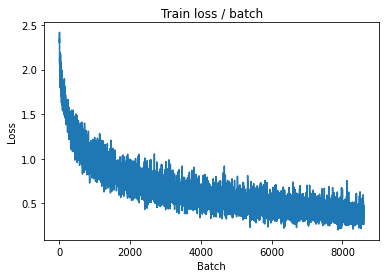

[TRAIN Batch 200/391]	Time 0.027s (0.057s)	Loss 0.2300 (0.3601)	Prec@1  91.4 ( 87.5)	Prec@5 100.0 ( 99.6)


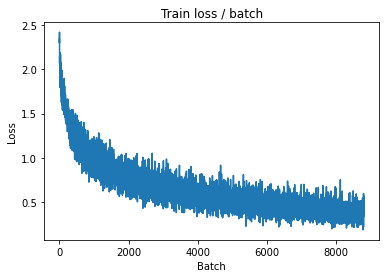


===============> Total time 21s	Avg loss 0.3724	Avg Prec@1 87.12 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.4336 (0.4336)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5227	Avg Prec@1 82.80 %	Avg Prec@5 99.08 %



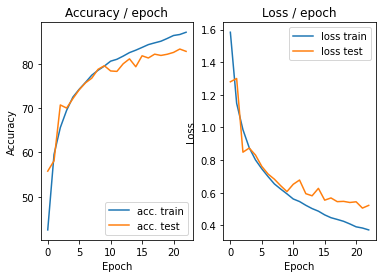

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.4202 (0.4202)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


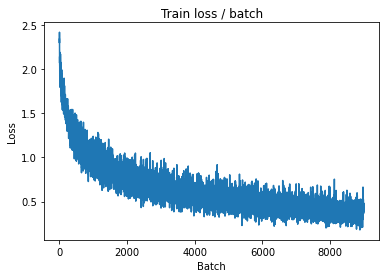

[TRAIN Batch 200/391]	Time 0.056s (0.058s)	Loss 0.2789 (0.3552)	Prec@1  91.4 ( 87.5)	Prec@5  99.2 ( 99.6)


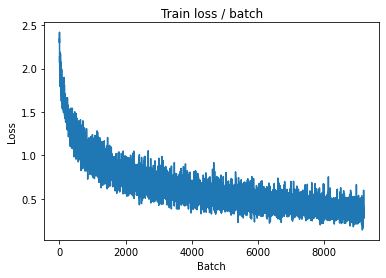


===============> Total time 22s	Avg loss 0.3553	Avg Prec@1 87.42 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.4709 (0.4709)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5230	Avg Prec@1 82.98 %	Avg Prec@5 99.17 %



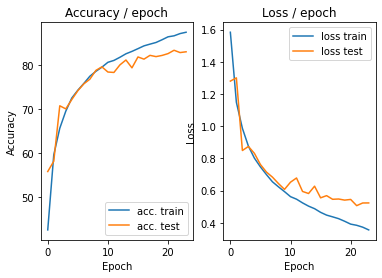

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.4570 (0.4570)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


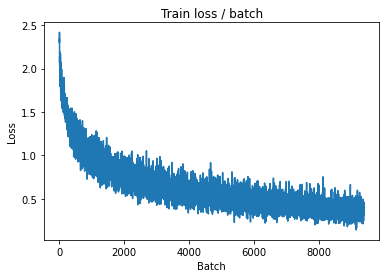

[TRAIN Batch 200/391]	Time 0.072s (0.056s)	Loss 0.3936 (0.3478)	Prec@1  82.8 ( 87.7)	Prec@5  99.2 ( 99.6)


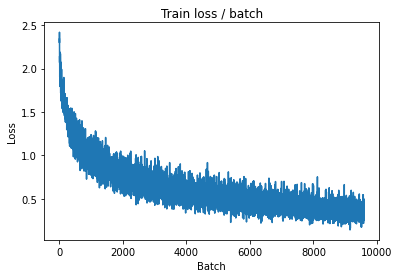


===============> Total time 21s	Avg loss 0.3489	Avg Prec@1 87.69 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.4878 (0.4878)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5262	Avg Prec@1 82.75 %	Avg Prec@5 99.20 %



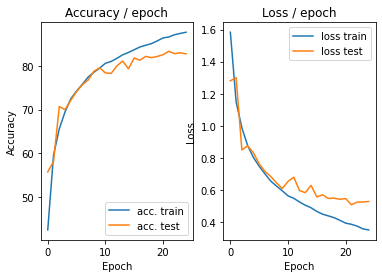

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.4380 (0.4380)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


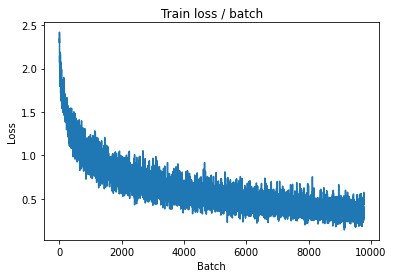

[TRAIN Batch 200/391]	Time 0.035s (0.056s)	Loss 0.3264 (0.3386)	Prec@1  87.5 ( 88.0)	Prec@5 100.0 ( 99.7)


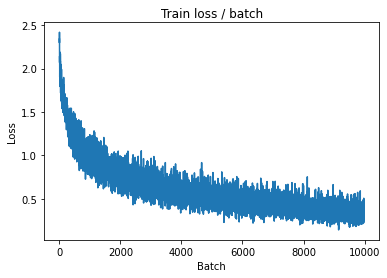


===============> Total time 21s	Avg loss 0.3429	Avg Prec@1 87.86 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.4357 (0.4357)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5062	Avg Prec@1 83.43 %	Avg Prec@5 99.15 %



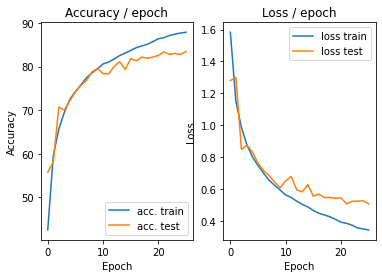

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.2991 (0.2991)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


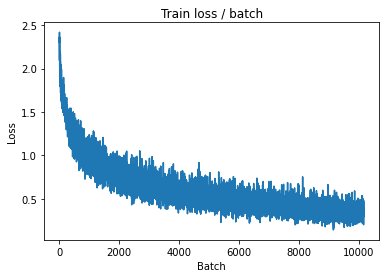

[TRAIN Batch 200/391]	Time 0.022s (0.057s)	Loss 0.2812 (0.3342)	Prec@1  92.2 ( 88.1)	Prec@5 100.0 ( 99.6)


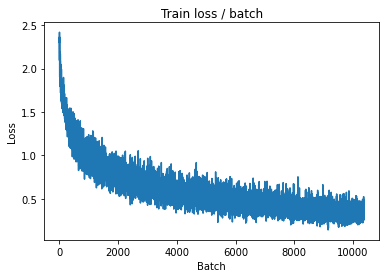


===============> Total time 21s	Avg loss 0.3306	Avg Prec@1 88.31 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.4290 (0.4290)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5204	Avg Prec@1 83.58 %	Avg Prec@5 99.20 %



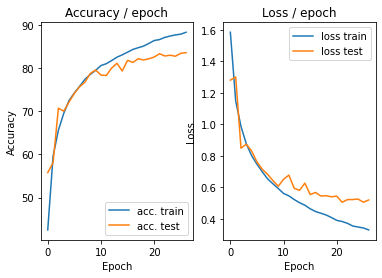

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.2762 (0.2762)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


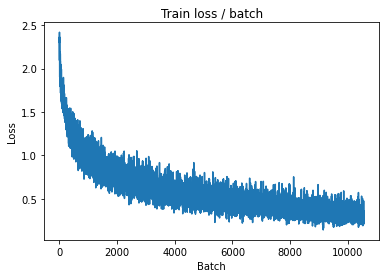

[TRAIN Batch 200/391]	Time 0.021s (0.058s)	Loss 0.3260 (0.3174)	Prec@1  92.2 ( 88.8)	Prec@5  99.2 ( 99.7)


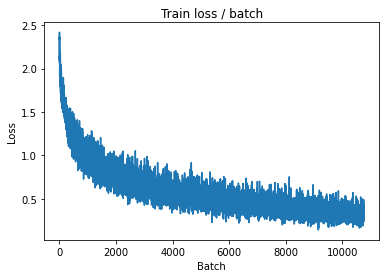


===============> Total time 21s	Avg loss 0.3210	Avg Prec@1 88.66 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.4608 (0.4608)	Prec@1  86.7 ( 86.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5081	Avg Prec@1 83.97 %	Avg Prec@5 99.16 %



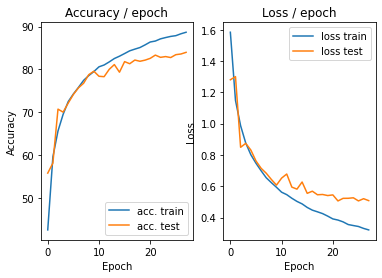

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.3837 (0.3837)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


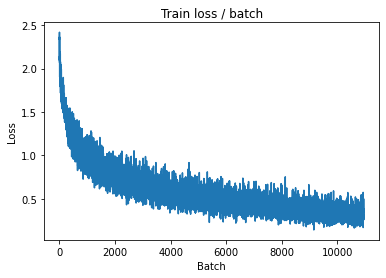

[TRAIN Batch 200/391]	Time 0.071s (0.056s)	Loss 0.4360 (0.3105)	Prec@1  85.9 ( 89.2)	Prec@5 100.0 ( 99.7)


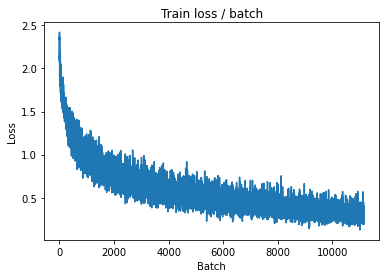


===============> Total time 21s	Avg loss 0.3111	Avg Prec@1 89.12 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.4161 (0.4161)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4916	Avg Prec@1 84.47 %	Avg Prec@5 99.24 %



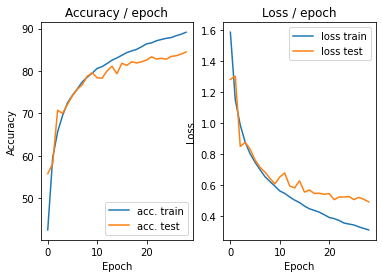

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.2657 (0.2657)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


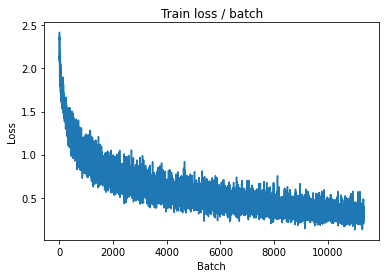

[TRAIN Batch 200/391]	Time 0.077s (0.057s)	Loss 0.2872 (0.3017)	Prec@1  90.6 ( 89.5)	Prec@5 100.0 ( 99.7)


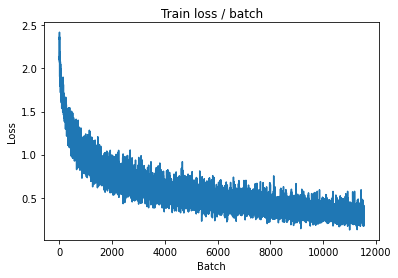


===============> Total time 21s	Avg loss 0.3028	Avg Prec@1 89.39 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.4331 (0.4331)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4984	Avg Prec@1 84.07 %	Avg Prec@5 99.22 %



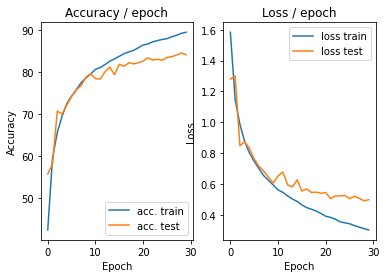

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.2450 (0.2450)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


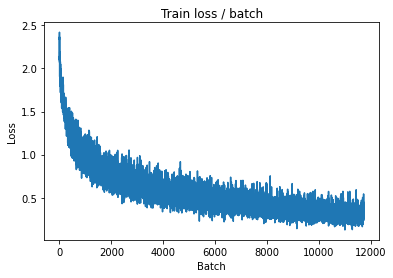

[TRAIN Batch 200/391]	Time 0.073s (0.056s)	Loss 0.2630 (0.3020)	Prec@1  90.6 ( 89.3)	Prec@5 100.0 ( 99.8)


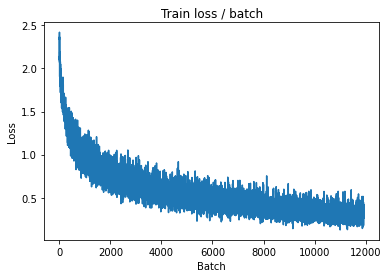


===============> Total time 21s	Avg loss 0.2975	Avg Prec@1 89.41 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.3990 (0.3990)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5106	Avg Prec@1 84.02 %	Avg Prec@5 99.23 %



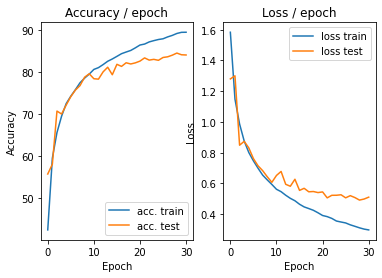

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2589 (0.2589)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


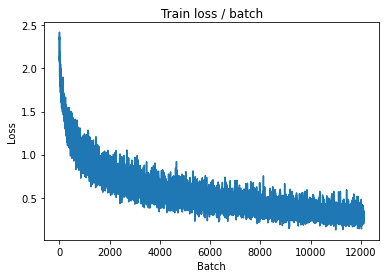

[TRAIN Batch 200/391]	Time 0.089s (0.057s)	Loss 0.2969 (0.2956)	Prec@1  89.1 ( 89.3)	Prec@5 100.0 ( 99.7)


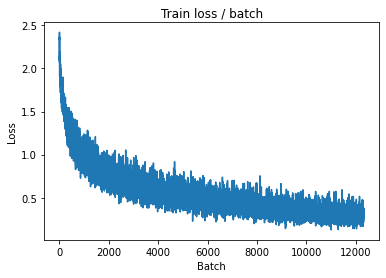


===============> Total time 21s	Avg loss 0.2938	Avg Prec@1 89.66 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.4411 (0.4411)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5108	Avg Prec@1 83.93 %	Avg Prec@5 99.23 %



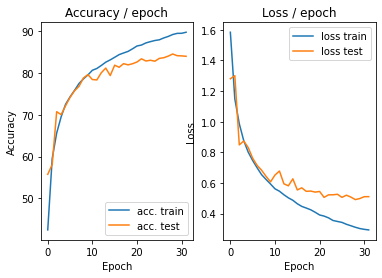

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.2849 (0.2849)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


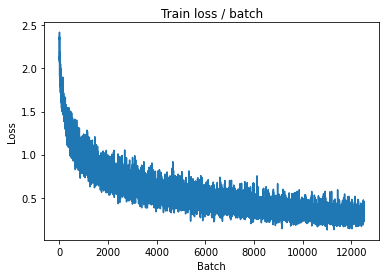

[TRAIN Batch 200/391]	Time 0.043s (0.056s)	Loss 0.2776 (0.2831)	Prec@1  90.6 ( 90.1)	Prec@5 100.0 ( 99.7)


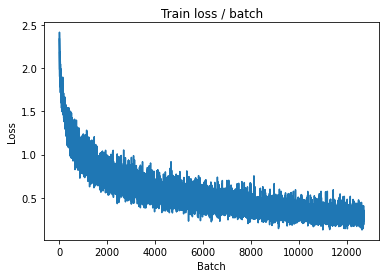


===============> Total time 21s	Avg loss 0.2831	Avg Prec@1 90.00 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.3991 (0.3991)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5038	Avg Prec@1 84.23 %	Avg Prec@5 99.22 %



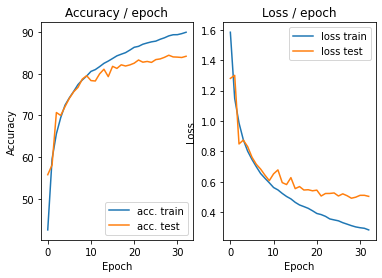

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.3693 (0.3693)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


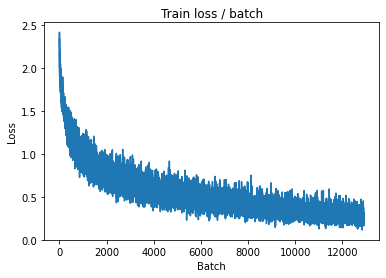

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.3071 (0.2759)	Prec@1  86.7 ( 90.2)	Prec@5 100.0 ( 99.8)


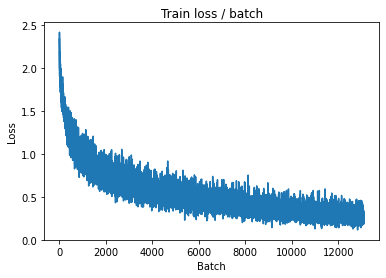


===============> Total time 21s	Avg loss 0.2778	Avg Prec@1 90.22 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.4302 (0.4302)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5059	Avg Prec@1 84.14 %	Avg Prec@5 99.15 %



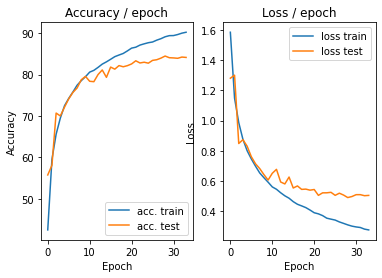

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.2618 (0.2618)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


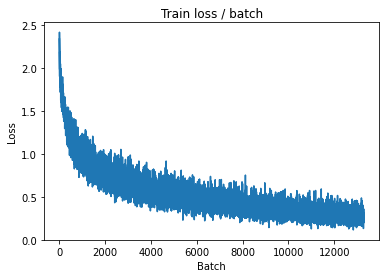

[TRAIN Batch 200/391]	Time 0.067s (0.058s)	Loss 0.2707 (0.2658)	Prec@1  91.4 ( 90.6)	Prec@5 100.0 ( 99.8)


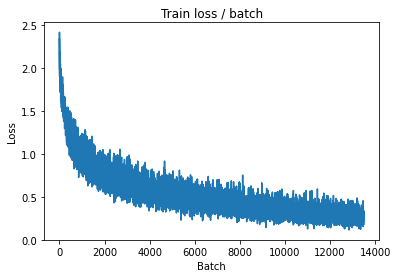


===============> Total time 22s	Avg loss 0.2697	Avg Prec@1 90.48 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.4388 (0.4388)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5051	Avg Prec@1 84.46 %	Avg Prec@5 99.23 %



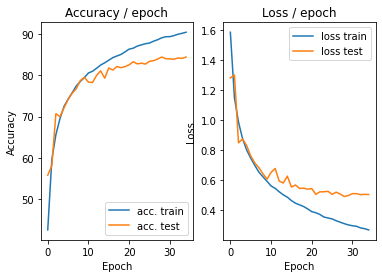

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.1879 (0.1879)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


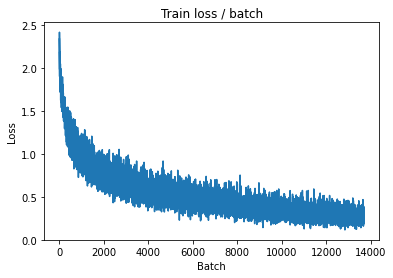

[TRAIN Batch 200/391]	Time 0.021s (0.057s)	Loss 0.2844 (0.2644)	Prec@1  89.1 ( 90.7)	Prec@5 100.0 ( 99.8)


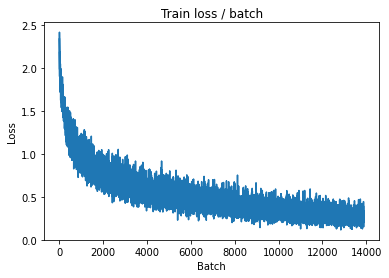


===============> Total time 21s	Avg loss 0.2641	Avg Prec@1 90.57 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.4459 (0.4459)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5112	Avg Prec@1 84.43 %	Avg Prec@5 99.24 %



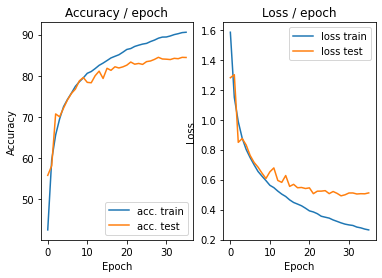

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2264 (0.2264)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


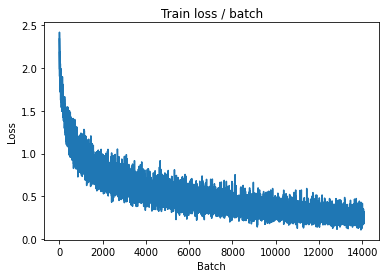

[TRAIN Batch 200/391]	Time 0.067s (0.056s)	Loss 0.2665 (0.2569)	Prec@1  91.4 ( 90.9)	Prec@5 100.0 ( 99.8)


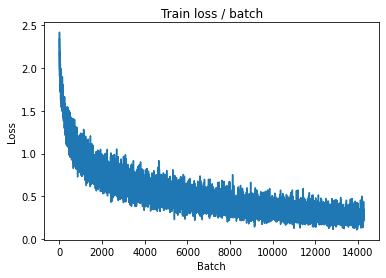


===============> Total time 21s	Avg loss 0.2578	Avg Prec@1 90.95 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.4259 (0.4259)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5042	Avg Prec@1 84.41 %	Avg Prec@5 99.28 %



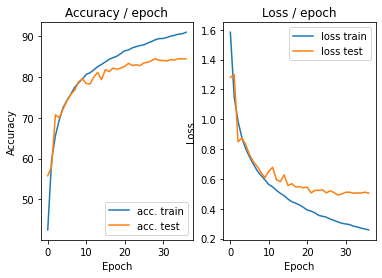

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.2725 (0.2725)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


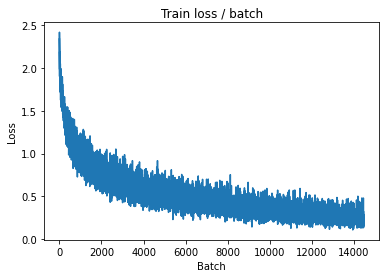

[TRAIN Batch 200/391]	Time 0.030s (0.056s)	Loss 0.2930 (0.2494)	Prec@1  91.4 ( 91.1)	Prec@5 100.0 ( 99.8)


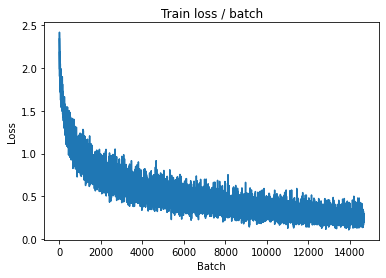


===============> Total time 21s	Avg loss 0.2568	Avg Prec@1 90.85 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.4356 (0.4356)	Prec@1  88.3 ( 88.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.4966	Avg Prec@1 84.41 %	Avg Prec@5 99.25 %



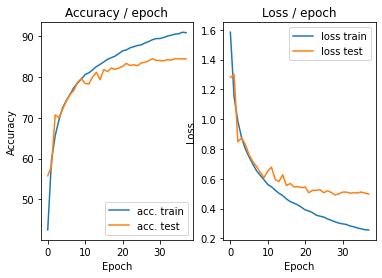

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.2687 (0.2687)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


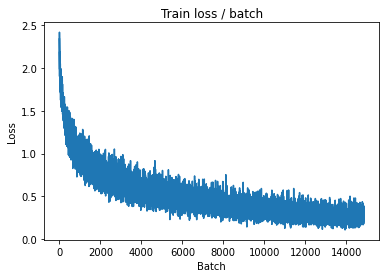

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 0.2085 (0.2449)	Prec@1  95.3 ( 91.4)	Prec@5 100.0 ( 99.8)


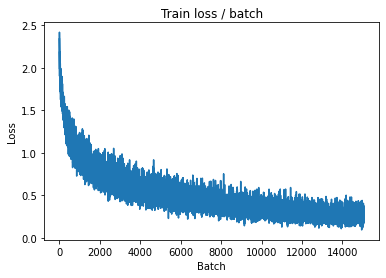


===============> Total time 21s	Avg loss 0.2442	Avg Prec@1 91.39 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.3821 (0.3821)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5007	Avg Prec@1 84.71 %	Avg Prec@5 99.28 %



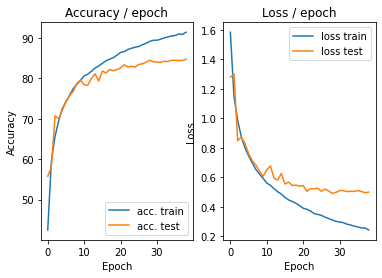

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.2319 (0.2319)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


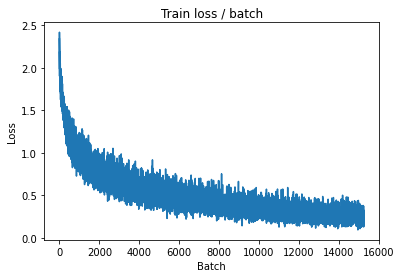

[TRAIN Batch 200/391]	Time 0.073s (0.056s)	Loss 0.1908 (0.2426)	Prec@1  91.4 ( 91.3)	Prec@5 100.0 ( 99.8)


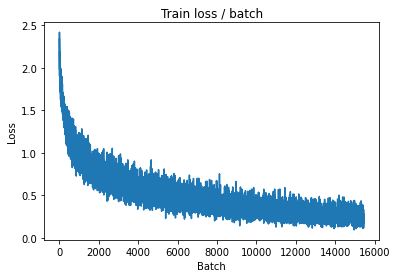


===============> Total time 21s	Avg loss 0.2449	Avg Prec@1 91.37 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.4487 (0.4487)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5074	Avg Prec@1 84.67 %	Avg Prec@5 99.23 %



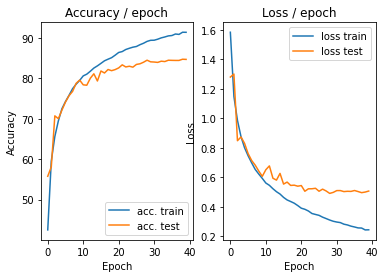

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.2345 (0.2345)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


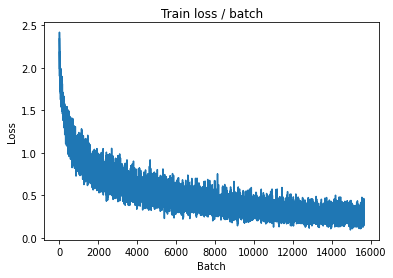

[TRAIN Batch 200/391]	Time 0.039s (0.056s)	Loss 0.1960 (0.2353)	Prec@1  93.8 ( 91.6)	Prec@5 100.0 ( 99.9)


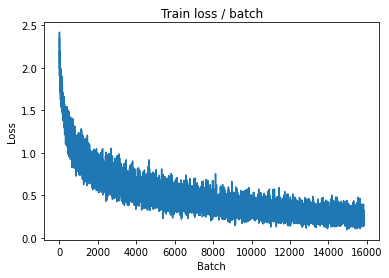


===============> Total time 21s	Avg loss 0.2377	Avg Prec@1 91.59 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.3875 (0.3875)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5091	Avg Prec@1 84.40 %	Avg Prec@5 99.27 %



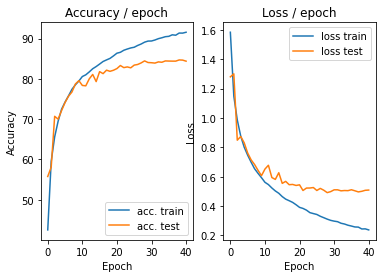

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.1452 (0.1452)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


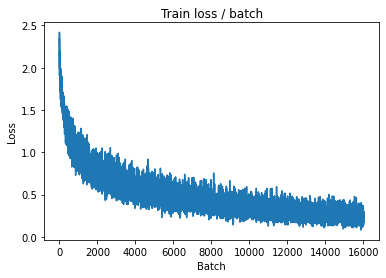

[TRAIN Batch 200/391]	Time 0.029s (0.056s)	Loss 0.1730 (0.2348)	Prec@1  94.5 ( 91.7)	Prec@5 100.0 ( 99.8)


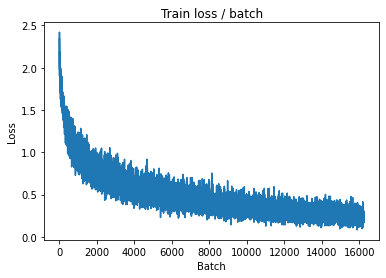


===============> Total time 21s	Avg loss 0.2374	Avg Prec@1 91.63 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.3851 (0.3851)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5027	Avg Prec@1 84.72 %	Avg Prec@5 99.28 %



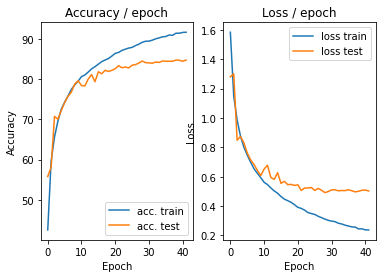

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.1896 (0.1896)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


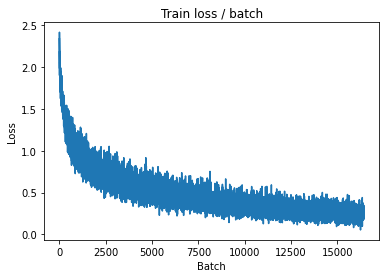

[TRAIN Batch 200/391]	Time 0.021s (0.057s)	Loss 0.2257 (0.2289)	Prec@1  91.4 ( 91.7)	Prec@5 100.0 ( 99.9)


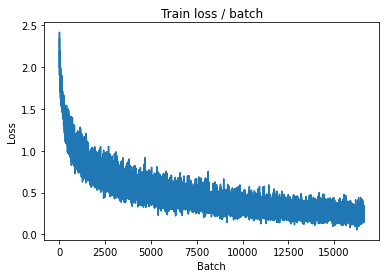


===============> Total time 21s	Avg loss 0.2302	Avg Prec@1 91.72 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.4032 (0.4032)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4991	Avg Prec@1 84.73 %	Avg Prec@5 99.32 %



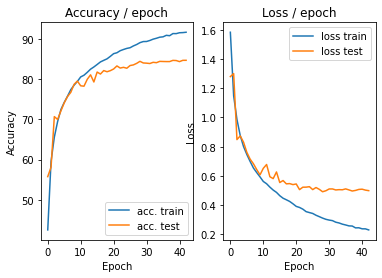

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.2284 (0.2284)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


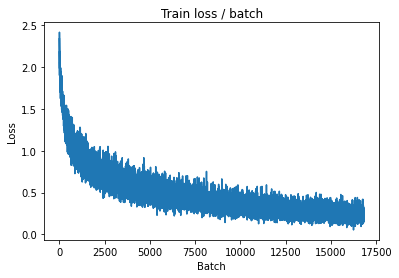

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.1755 (0.2234)	Prec@1  93.0 ( 92.1)	Prec@5 100.0 ( 99.9)


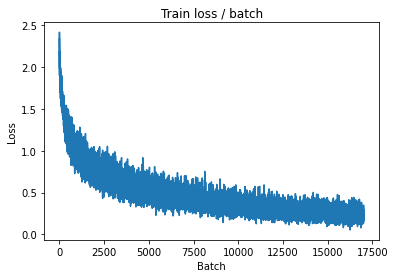


===============> Total time 21s	Avg loss 0.2259	Avg Prec@1 92.02 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.4054 (0.4054)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5000	Avg Prec@1 84.97 %	Avg Prec@5 99.34 %



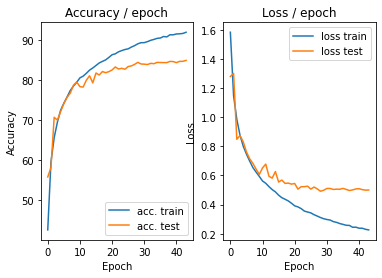

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.1806 (0.1806)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


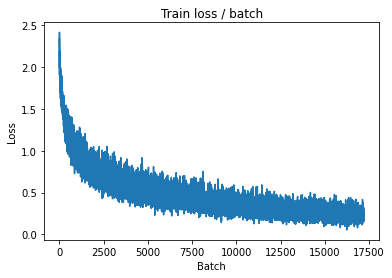

[TRAIN Batch 200/391]	Time 0.031s (0.056s)	Loss 0.1571 (0.2241)	Prec@1  94.5 ( 92.1)	Prec@5 100.0 ( 99.9)


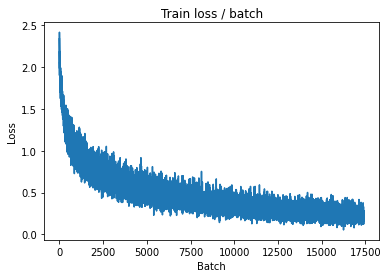


===============> Total time 21s	Avg loss 0.2245	Avg Prec@1 91.99 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.4320 (0.4320)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5056	Avg Prec@1 84.74 %	Avg Prec@5 99.26 %



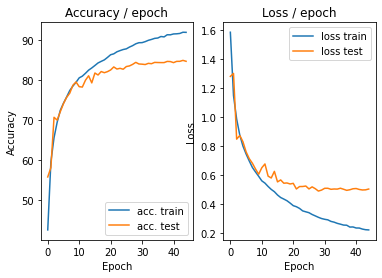

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.3267 (0.3267)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


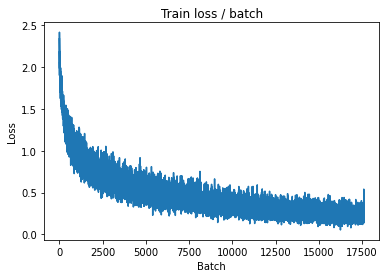

[TRAIN Batch 200/391]	Time 0.094s (0.056s)	Loss 0.1621 (0.2152)	Prec@1  94.5 ( 92.4)	Prec@5 100.0 ( 99.9)


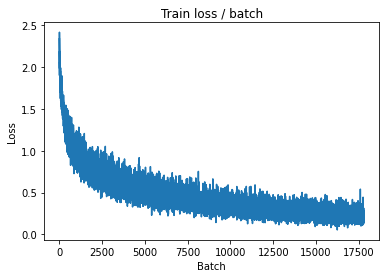


===============> Total time 21s	Avg loss 0.2187	Avg Prec@1 92.20 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.4311 (0.4311)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5076	Avg Prec@1 84.91 %	Avg Prec@5 99.35 %



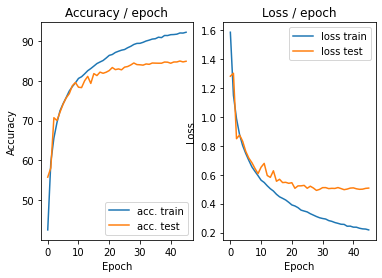

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.2681 (0.2681)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


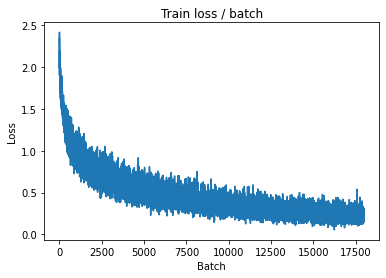

[TRAIN Batch 200/391]	Time 0.060s (0.055s)	Loss 0.2223 (0.2107)	Prec@1  92.2 ( 92.4)	Prec@5 100.0 ( 99.9)


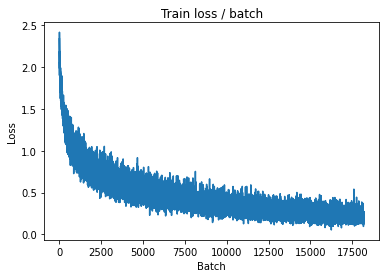


===============> Total time 21s	Avg loss 0.2120	Avg Prec@1 92.45 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.4224 (0.4224)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5043	Avg Prec@1 85.33 %	Avg Prec@5 99.37 %



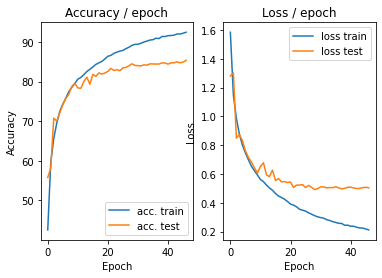

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.3451 (0.3451)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


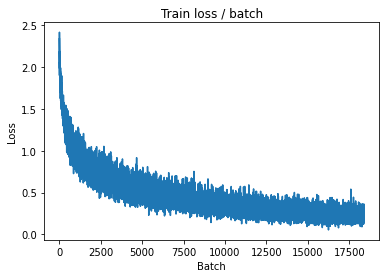

[TRAIN Batch 200/391]	Time 0.078s (0.056s)	Loss 0.2891 (0.2066)	Prec@1  89.8 ( 92.5)	Prec@5 100.0 ( 99.9)


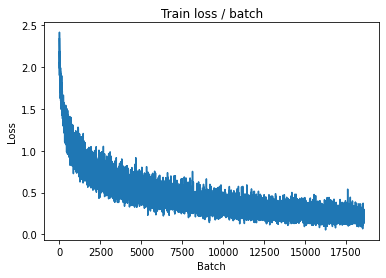


===============> Total time 21s	Avg loss 0.2106	Avg Prec@1 92.43 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.4259 (0.4259)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4965	Avg Prec@1 85.02 %	Avg Prec@5 99.39 %



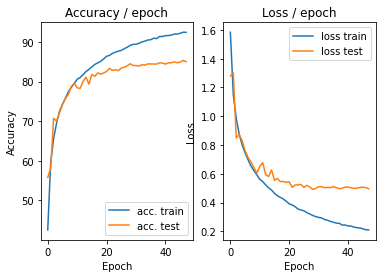

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.1022 (0.1022)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


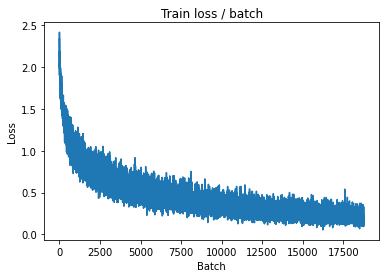

[TRAIN Batch 200/391]	Time 0.071s (0.057s)	Loss 0.1963 (0.2079)	Prec@1  93.8 ( 92.6)	Prec@5 100.0 ( 99.9)


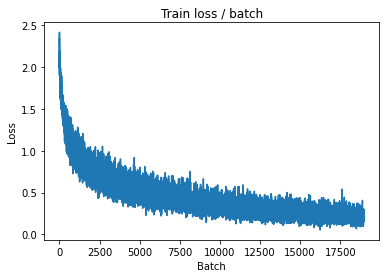


===============> Total time 21s	Avg loss 0.2113	Avg Prec@1 92.45 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.3852 (0.3852)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5042	Avg Prec@1 85.25 %	Avg Prec@5 99.35 %



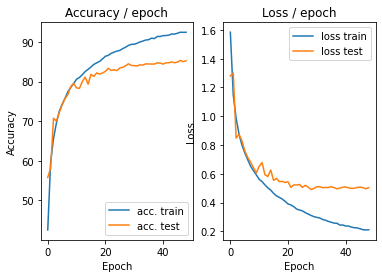

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.1626 (0.1626)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


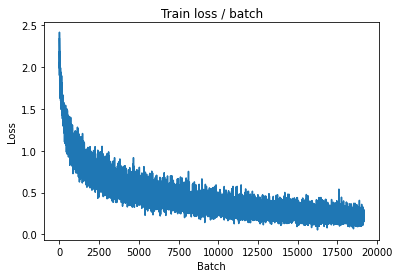

[TRAIN Batch 200/391]	Time 0.083s (0.056s)	Loss 0.1868 (0.2053)	Prec@1  93.8 ( 92.6)	Prec@5 100.0 ( 99.9)


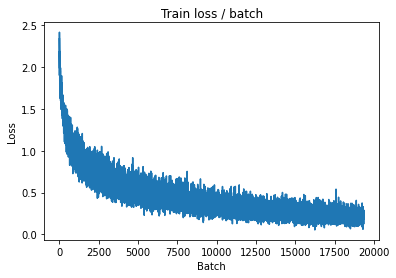


===============> Total time 21s	Avg loss 0.2070	Avg Prec@1 92.64 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 0.4204 (0.4204)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5080	Avg Prec@1 85.28 %	Avg Prec@5 99.26 %



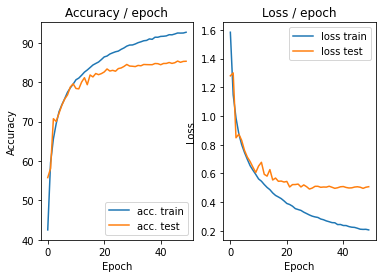

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.1790 (0.1790)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


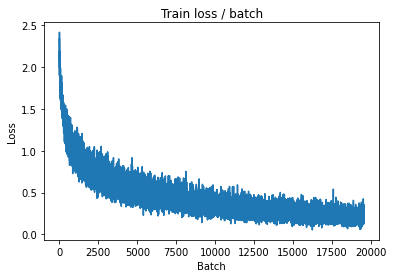

[TRAIN Batch 200/391]	Time 0.032s (0.056s)	Loss 0.2379 (0.2059)	Prec@1  89.1 ( 92.8)	Prec@5 100.0 ( 99.9)


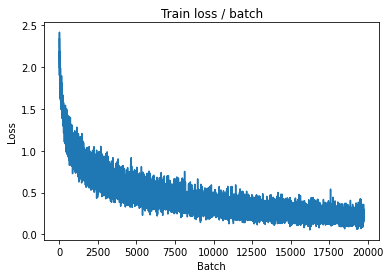


===============> Total time 21s	Avg loss 0.2053	Avg Prec@1 92.70 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.3889 (0.3889)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5123	Avg Prec@1 85.12 %	Avg Prec@5 99.32 %



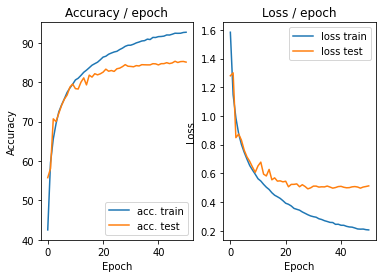

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.2849 (0.2849)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


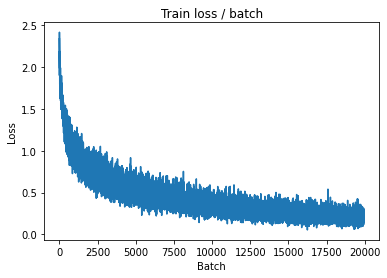

[TRAIN Batch 200/391]	Time 0.029s (0.056s)	Loss 0.1443 (0.1949)	Prec@1  94.5 ( 93.0)	Prec@5 100.0 ( 99.9)


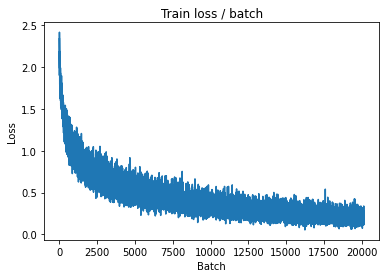


===============> Total time 21s	Avg loss 0.1968	Avg Prec@1 92.98 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 0.3780 (0.3780)	Prec@1  88.3 ( 88.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5071	Avg Prec@1 85.43 %	Avg Prec@5 99.35 %



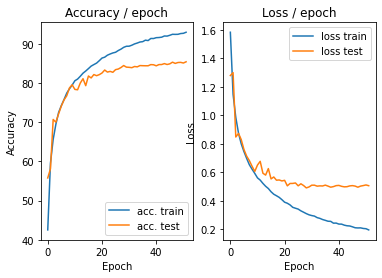

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.2811 (0.2811)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


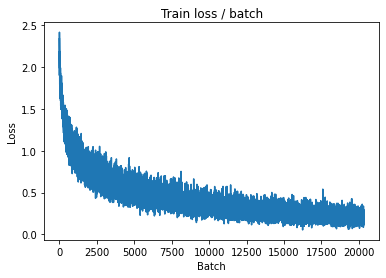

[TRAIN Batch 200/391]	Time 0.026s (0.056s)	Loss 0.1106 (0.2001)	Prec@1  97.7 ( 92.9)	Prec@5 100.0 ( 99.9)


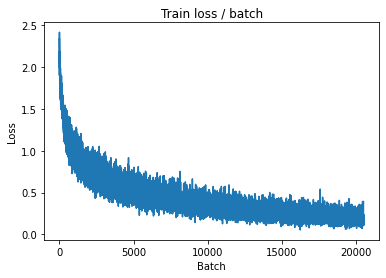


===============> Total time 21s	Avg loss 0.2019	Avg Prec@1 92.85 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.4069 (0.4069)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5097	Avg Prec@1 85.19 %	Avg Prec@5 99.30 %



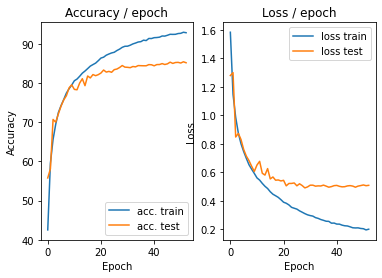

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.2610 (0.2610)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


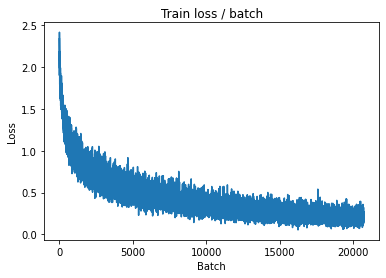

[TRAIN Batch 200/391]	Time 0.098s (0.058s)	Loss 0.1530 (0.1939)	Prec@1  95.3 ( 93.1)	Prec@5 100.0 ( 99.9)


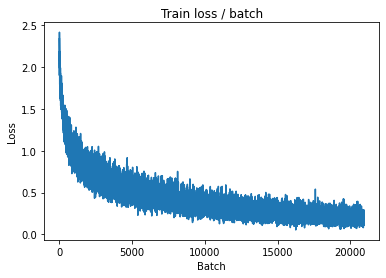


===============> Total time 22s	Avg loss 0.1926	Avg Prec@1 93.21 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.285s (0.285s)	Loss 0.3884 (0.3884)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5101	Avg Prec@1 85.52 %	Avg Prec@5 99.32 %



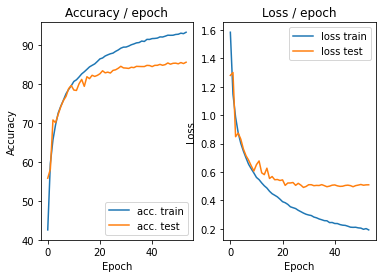

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.1769 (0.1769)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


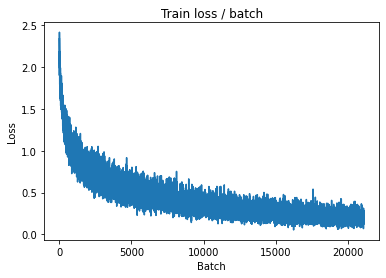

[TRAIN Batch 200/391]	Time 0.069s (0.056s)	Loss 0.1764 (0.1940)	Prec@1  93.8 ( 93.1)	Prec@5 100.0 ( 99.9)


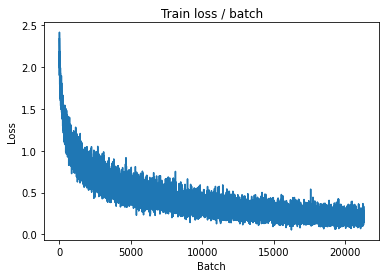


===============> Total time 21s	Avg loss 0.1922	Avg Prec@1 93.17 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.4057 (0.4057)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5087	Avg Prec@1 85.38 %	Avg Prec@5 99.36 %



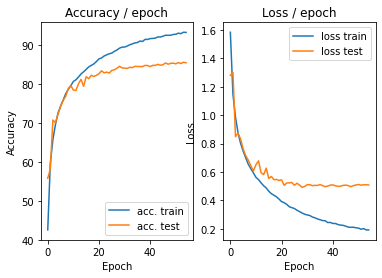

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.1265 (0.1265)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


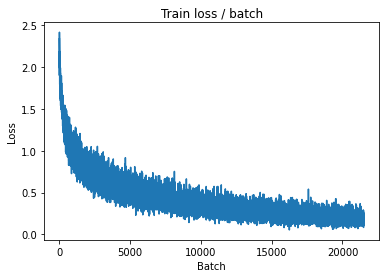

[TRAIN Batch 200/391]	Time 0.075s (0.056s)	Loss 0.1959 (0.1922)	Prec@1  93.0 ( 93.2)	Prec@5  99.2 ( 99.9)


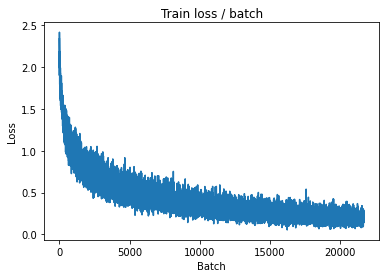


===============> Total time 21s	Avg loss 0.1899	Avg Prec@1 93.21 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.3934 (0.3934)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5063	Avg Prec@1 85.42 %	Avg Prec@5 99.26 %



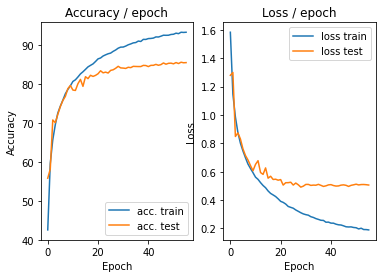

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.2700 (0.2700)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


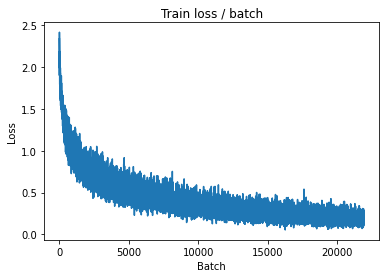

[TRAIN Batch 200/391]	Time 0.093s (0.057s)	Loss 0.1715 (0.1905)	Prec@1  93.8 ( 93.3)	Prec@5 100.0 ( 99.9)


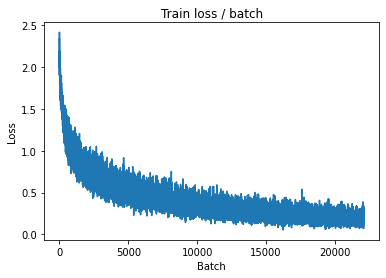


===============> Total time 21s	Avg loss 0.1882	Avg Prec@1 93.40 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.3735 (0.3735)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5030	Avg Prec@1 85.28 %	Avg Prec@5 99.34 %



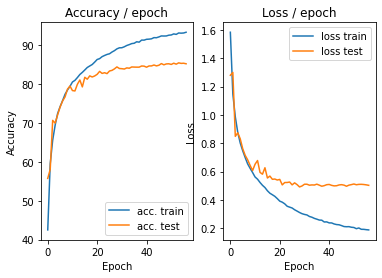

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.2252 (0.2252)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


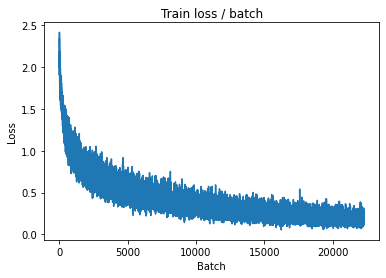

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.1926 (0.1863)	Prec@1  92.2 ( 93.5)	Prec@5 100.0 ( 99.9)


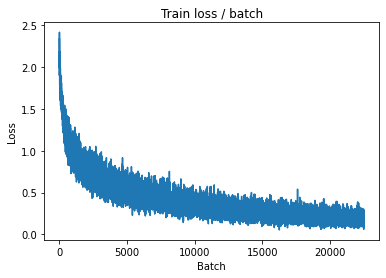


===============> Total time 21s	Avg loss 0.1854	Avg Prec@1 93.54 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.3785 (0.3785)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5061	Avg Prec@1 85.65 %	Avg Prec@5 99.32 %



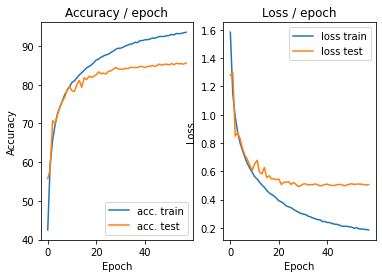

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.1800 (0.1800)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


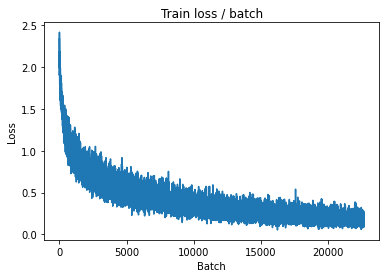

[TRAIN Batch 200/391]	Time 0.099s (0.057s)	Loss 0.2483 (0.1867)	Prec@1  92.2 ( 93.5)	Prec@5 100.0 ( 99.9)


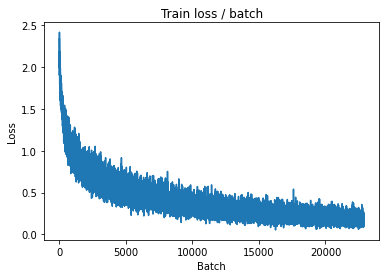


===============> Total time 21s	Avg loss 0.1832	Avg Prec@1 93.55 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.3816 (0.3816)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5149	Avg Prec@1 85.46 %	Avg Prec@5 99.32 %



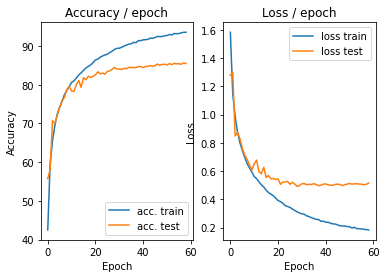

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.2090 (0.2090)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


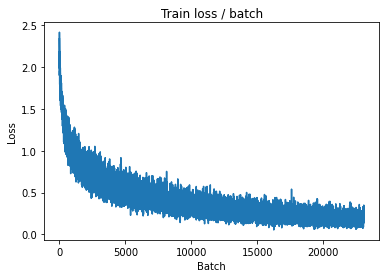

[TRAIN Batch 200/391]	Time 0.063s (0.057s)	Loss 0.1914 (0.1811)	Prec@1  93.0 ( 93.6)	Prec@5 100.0 ( 99.9)


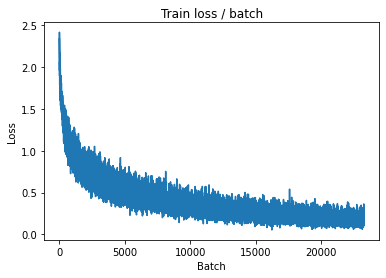


===============> Total time 21s	Avg loss 0.1831	Avg Prec@1 93.52 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.3997 (0.3997)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5146	Avg Prec@1 85.21 %	Avg Prec@5 99.32 %



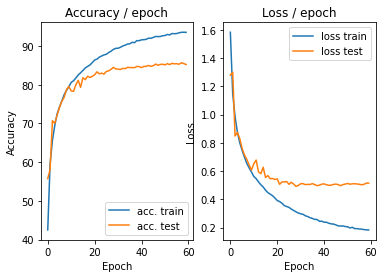

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 0.0917 (0.0917)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


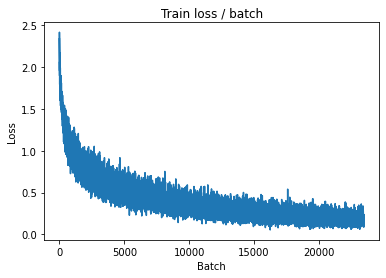

[TRAIN Batch 200/391]	Time 0.020s (0.055s)	Loss 0.1263 (0.1801)	Prec@1  96.1 ( 93.8)	Prec@5 100.0 ( 99.9)


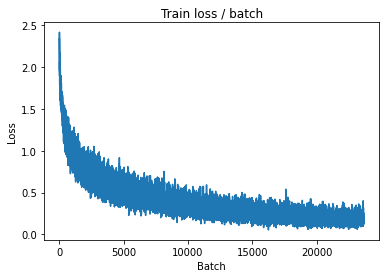


===============> Total time 21s	Avg loss 0.1824	Avg Prec@1 93.62 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.4066 (0.4066)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5106	Avg Prec@1 85.50 %	Avg Prec@5 99.26 %



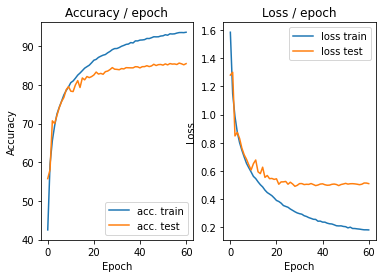

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.1273 (0.1273)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


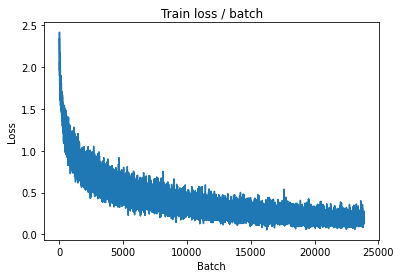

[TRAIN Batch 200/391]	Time 0.028s (0.057s)	Loss 0.1329 (0.1755)	Prec@1  96.1 ( 94.0)	Prec@5 100.0 ( 99.9)


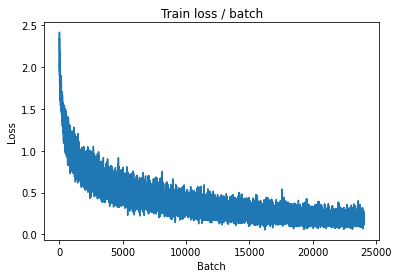


===============> Total time 21s	Avg loss 0.1791	Avg Prec@1 93.80 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.3793 (0.3793)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5103	Avg Prec@1 85.43 %	Avg Prec@5 99.45 %



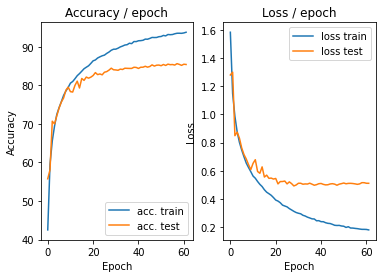

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.1902 (0.1902)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


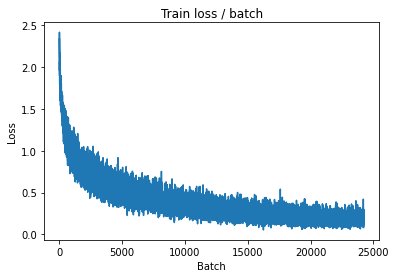

[TRAIN Batch 200/391]	Time 0.095s (0.056s)	Loss 0.1975 (0.1764)	Prec@1  91.4 ( 93.7)	Prec@5  99.2 ( 99.9)


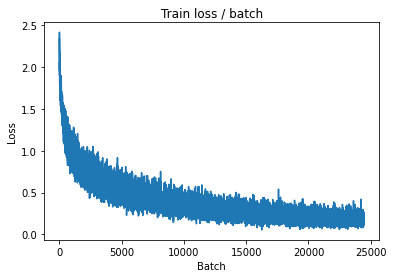


===============> Total time 21s	Avg loss 0.1790	Avg Prec@1 93.59 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.3942 (0.3942)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5152	Avg Prec@1 85.33 %	Avg Prec@5 99.30 %



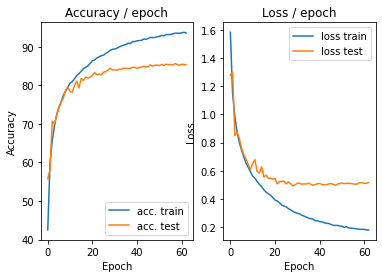

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.1421 (0.1421)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


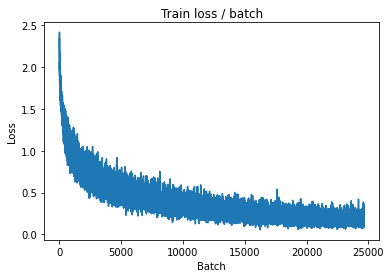

[TRAIN Batch 200/391]	Time 0.042s (0.055s)	Loss 0.1970 (0.1744)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


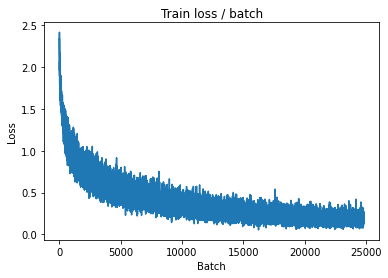


===============> Total time 21s	Avg loss 0.1754	Avg Prec@1 93.86 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.3871 (0.3871)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5112	Avg Prec@1 85.45 %	Avg Prec@5 99.31 %



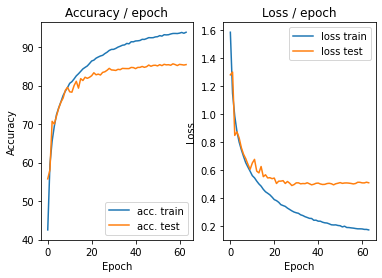

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.309s (0.309s)	Loss 0.2356 (0.2356)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


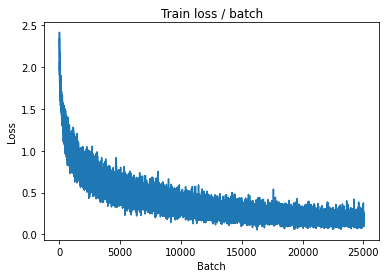

[TRAIN Batch 200/391]	Time 0.080s (0.056s)	Loss 0.1831 (0.1701)	Prec@1  92.2 ( 93.9)	Prec@5 100.0 ( 99.9)


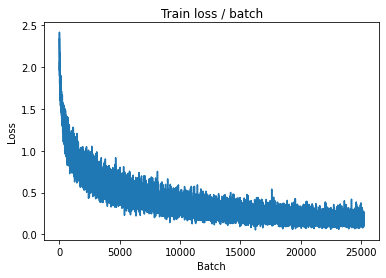


===============> Total time 21s	Avg loss 0.1704	Avg Prec@1 93.97 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.3947 (0.3947)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5128	Avg Prec@1 85.52 %	Avg Prec@5 99.33 %



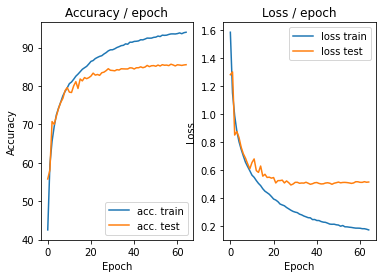

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.0985 (0.0985)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


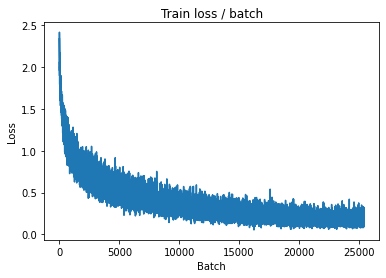

[TRAIN Batch 200/391]	Time 0.074s (0.057s)	Loss 0.2290 (0.1698)	Prec@1  93.8 ( 93.9)	Prec@5 100.0 ( 99.9)


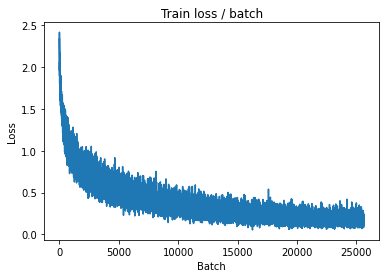


===============> Total time 21s	Avg loss 0.1711	Avg Prec@1 93.87 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 0.3942 (0.3942)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5193	Avg Prec@1 85.47 %	Avg Prec@5 99.28 %



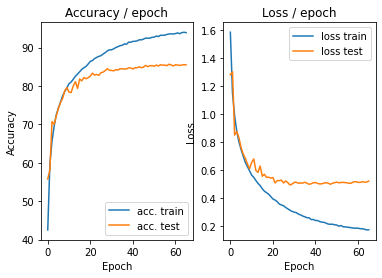

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.286s (0.286s)	Loss 0.1913 (0.1913)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


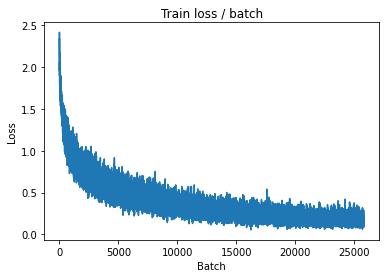

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 0.2734 (0.1721)	Prec@1  89.8 ( 93.8)	Prec@5  99.2 ( 99.9)


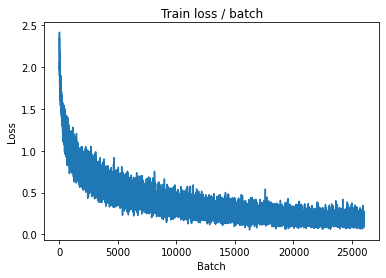


===============> Total time 21s	Avg loss 0.1733	Avg Prec@1 93.81 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.3917 (0.3917)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5180	Avg Prec@1 85.30 %	Avg Prec@5 99.28 %



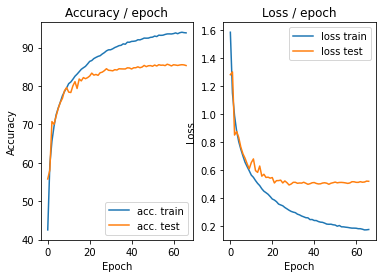

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.1224 (0.1224)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


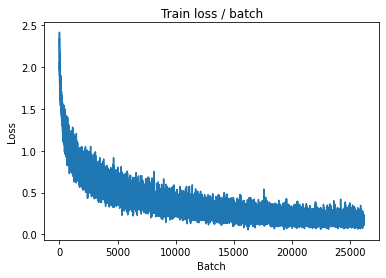

[TRAIN Batch 200/391]	Time 0.093s (0.056s)	Loss 0.1664 (0.1716)	Prec@1  94.5 ( 94.0)	Prec@5 100.0 ( 99.9)


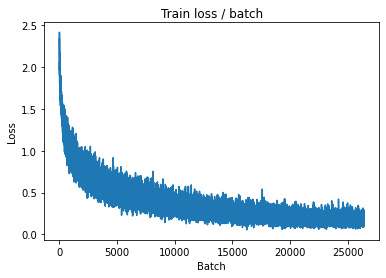


===============> Total time 21s	Avg loss 0.1694	Avg Prec@1 94.01 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.3874 (0.3874)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5154	Avg Prec@1 85.34 %	Avg Prec@5 99.30 %



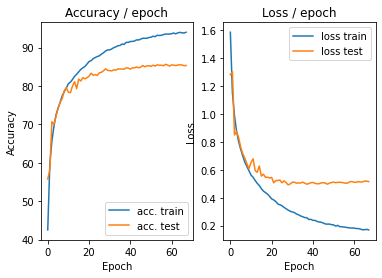

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.1118 (0.1118)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


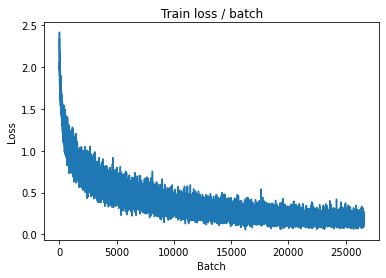

[TRAIN Batch 200/391]	Time 0.108s (0.056s)	Loss 0.1697 (0.1667)	Prec@1  93.8 ( 94.2)	Prec@5 100.0 ( 99.9)


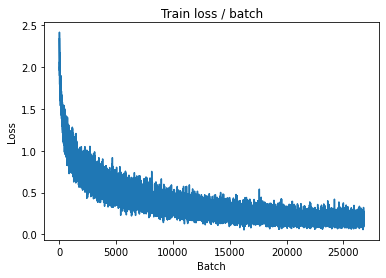


===============> Total time 21s	Avg loss 0.1692	Avg Prec@1 94.06 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.3799 (0.3799)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5137	Avg Prec@1 85.56 %	Avg Prec@5 99.29 %



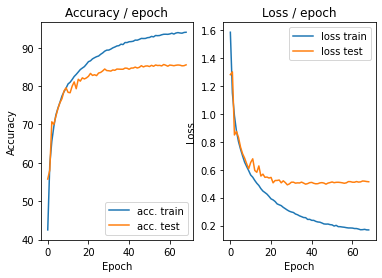

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.1614 (0.1614)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


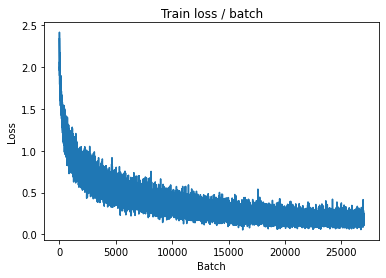

[TRAIN Batch 200/391]	Time 0.024s (0.057s)	Loss 0.1572 (0.1676)	Prec@1  93.8 ( 94.2)	Prec@5 100.0 ( 99.9)


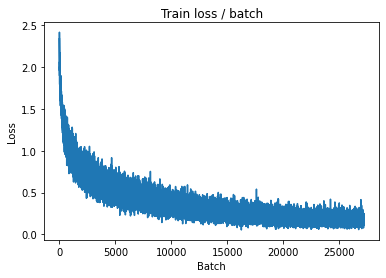


===============> Total time 21s	Avg loss 0.1709	Avg Prec@1 94.08 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.4002 (0.4002)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5164	Avg Prec@1 85.45 %	Avg Prec@5 99.27 %



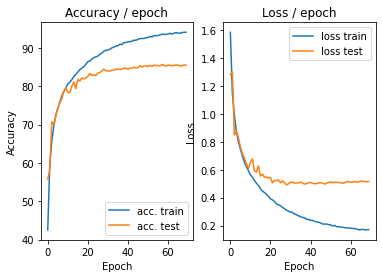

=== EPOCH 71 =====

[TRAIN Batch 000/391]	Time 0.298s (0.298s)	Loss 0.1166 (0.1166)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


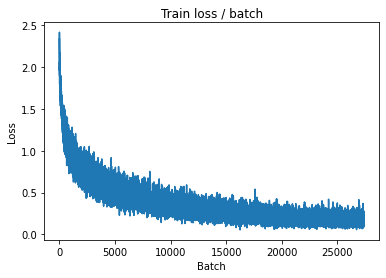

[TRAIN Batch 200/391]	Time 0.033s (0.056s)	Loss 0.2127 (0.1648)	Prec@1  92.2 ( 94.1)	Prec@5 100.0 (100.0)


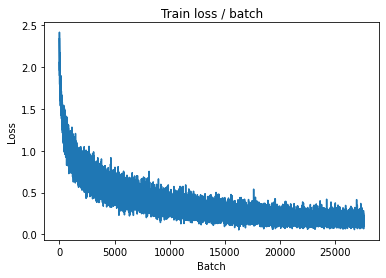


===============> Total time 21s	Avg loss 0.1680	Avg Prec@1 94.00 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.235s (0.235s)	Loss 0.3901 (0.3901)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5124	Avg Prec@1 85.49 %	Avg Prec@5 99.25 %



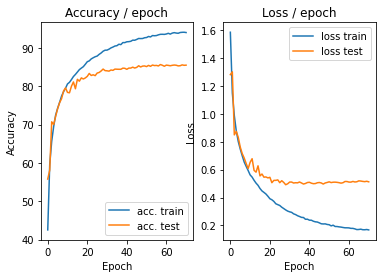

=== EPOCH 72 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.1678 (0.1678)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


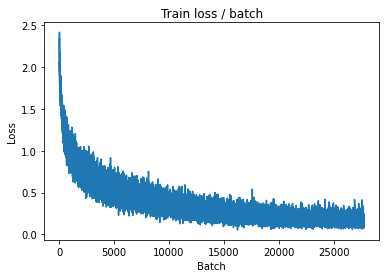

[TRAIN Batch 200/391]	Time 0.070s (0.056s)	Loss 0.1942 (0.1681)	Prec@1  92.2 ( 94.1)	Prec@5 100.0 (100.0)


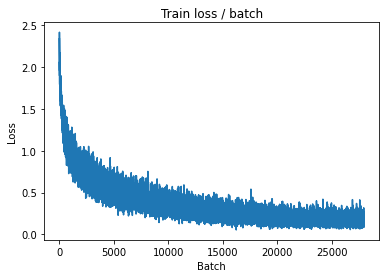


===============> Total time 21s	Avg loss 0.1686	Avg Prec@1 94.06 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.3895 (0.3895)	Prec@1  89.8 ( 89.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5165	Avg Prec@1 85.50 %	Avg Prec@5 99.31 %



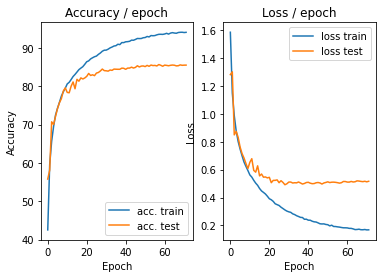

=== EPOCH 73 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.1002 (0.1002)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


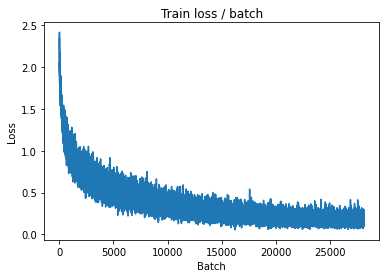

[TRAIN Batch 200/391]	Time 0.026s (0.055s)	Loss 0.1479 (0.1641)	Prec@1  96.1 ( 94.2)	Prec@5 100.0 ( 99.9)


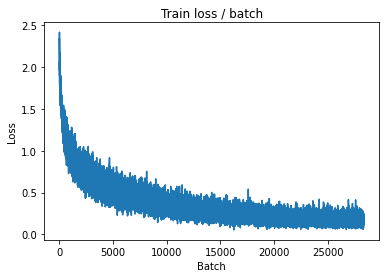


===============> Total time 21s	Avg loss 0.1657	Avg Prec@1 94.13 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.3818 (0.3818)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5177	Avg Prec@1 85.60 %	Avg Prec@5 99.29 %



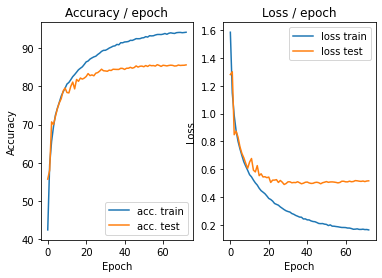

=== EPOCH 74 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.1794 (0.1794)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


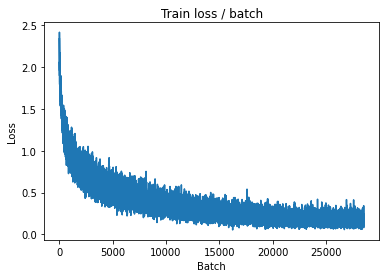

[TRAIN Batch 200/391]	Time 0.089s (0.056s)	Loss 0.2367 (0.1650)	Prec@1  91.4 ( 94.1)	Prec@5 100.0 ( 99.9)


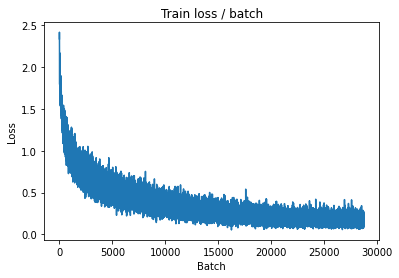


===============> Total time 21s	Avg loss 0.1689	Avg Prec@1 94.00 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.3881 (0.3881)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5191	Avg Prec@1 85.52 %	Avg Prec@5 99.35 %



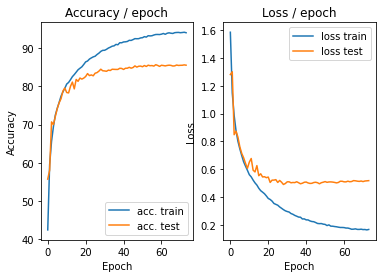

=== EPOCH 75 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.1261 (0.1261)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


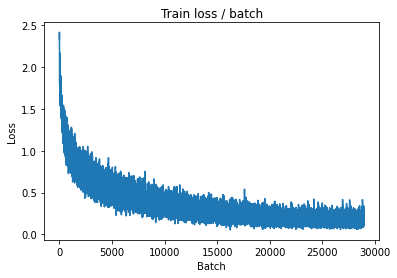

[TRAIN Batch 200/391]	Time 0.028s (0.056s)	Loss 0.2272 (0.1568)	Prec@1  91.4 ( 94.2)	Prec@5 100.0 ( 99.9)


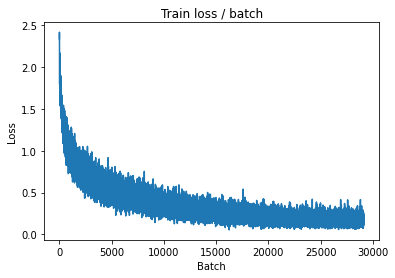


===============> Total time 21s	Avg loss 0.1629	Avg Prec@1 94.11 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.3679 (0.3679)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5154	Avg Prec@1 85.60 %	Avg Prec@5 99.27 %



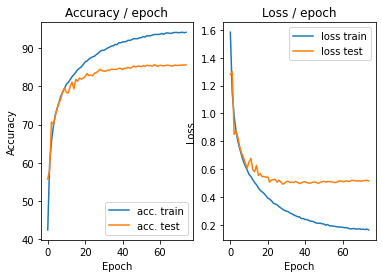

=== EPOCH 76 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.1900 (0.1900)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


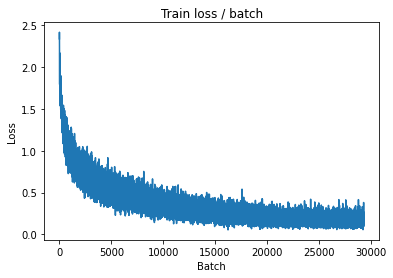

[TRAIN Batch 200/391]	Time 0.104s (0.057s)	Loss 0.2073 (0.1675)	Prec@1  93.0 ( 94.2)	Prec@5 100.0 ( 99.9)


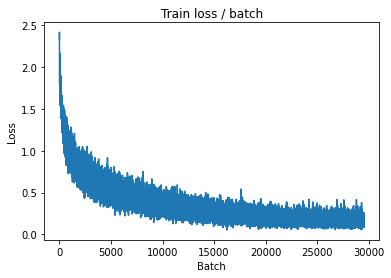


===============> Total time 21s	Avg loss 0.1672	Avg Prec@1 94.08 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.3691 (0.3691)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5195	Avg Prec@1 85.49 %	Avg Prec@5 99.29 %



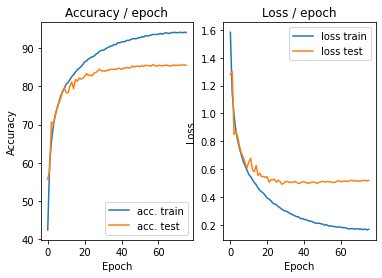

=== EPOCH 77 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.1354 (0.1354)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


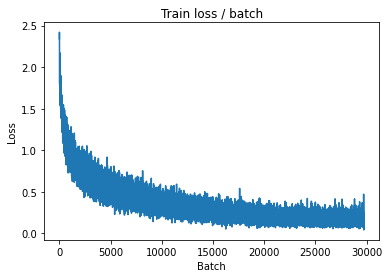

[TRAIN Batch 200/391]	Time 0.089s (0.056s)	Loss 0.1621 (0.1611)	Prec@1  95.3 ( 94.3)	Prec@5 100.0 ( 99.9)


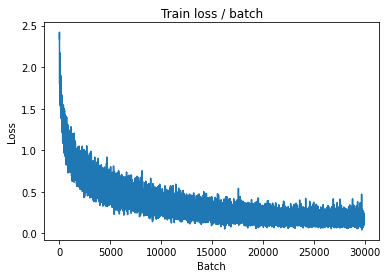


===============> Total time 21s	Avg loss 0.1602	Avg Prec@1 94.26 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.3809 (0.3809)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5198	Avg Prec@1 85.58 %	Avg Prec@5 99.29 %



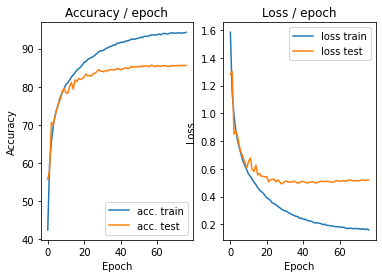

=== EPOCH 78 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.1051 (0.1051)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


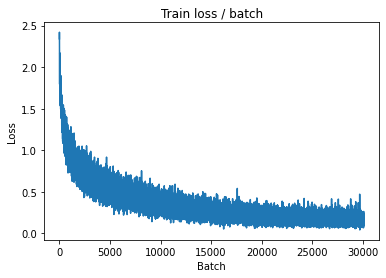

[TRAIN Batch 200/391]	Time 0.025s (0.057s)	Loss 0.1394 (0.1599)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


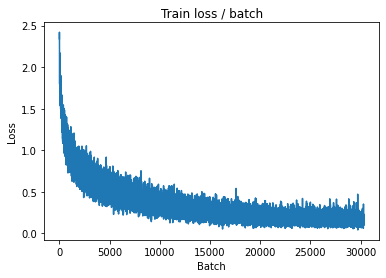


===============> Total time 21s	Avg loss 0.1605	Avg Prec@1 94.38 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 0.3864 (0.3864)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5206	Avg Prec@1 85.35 %	Avg Prec@5 99.28 %



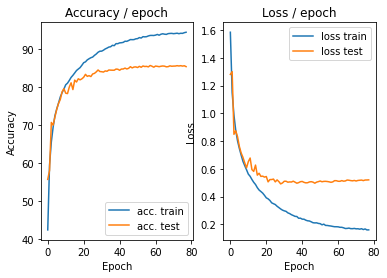

=== EPOCH 79 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.1719 (0.1719)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


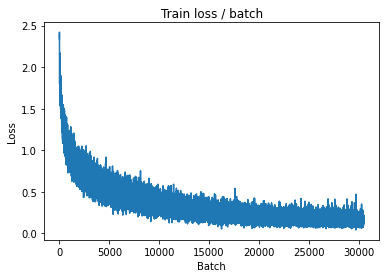

[TRAIN Batch 200/391]	Time 0.089s (0.056s)	Loss 0.1868 (0.1549)	Prec@1  95.3 ( 94.7)	Prec@5 100.0 (100.0)


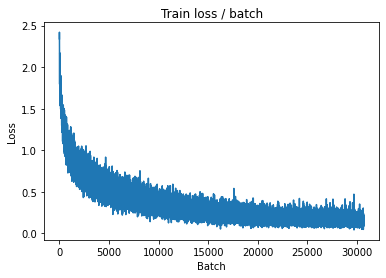


===============> Total time 21s	Avg loss 0.1590	Avg Prec@1 94.41 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.3864 (0.3864)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5174	Avg Prec@1 85.66 %	Avg Prec@5 99.28 %



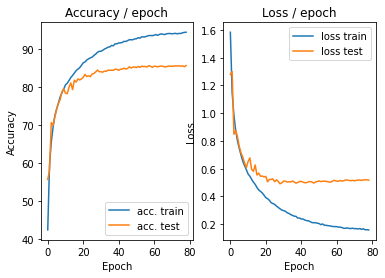

=== EPOCH 80 =====

[TRAIN Batch 000/391]	Time 0.301s (0.301s)	Loss 0.1179 (0.1179)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


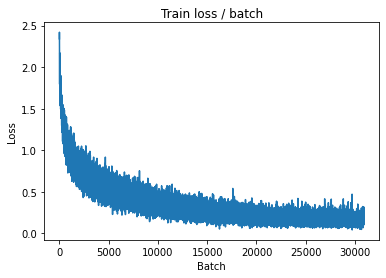

[TRAIN Batch 200/391]	Time 0.051s (0.057s)	Loss 0.1409 (0.1560)	Prec@1  96.1 ( 94.5)	Prec@5 100.0 (100.0)


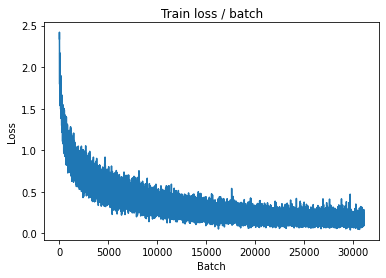


===============> Total time 21s	Avg loss 0.1588	Avg Prec@1 94.37 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.3849 (0.3849)	Prec@1  93.0 ( 93.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5199	Avg Prec@1 85.52 %	Avg Prec@5 99.31 %



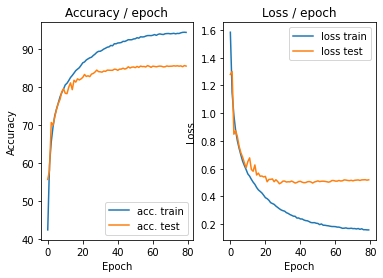

=== EPOCH 81 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.1898 (0.1898)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


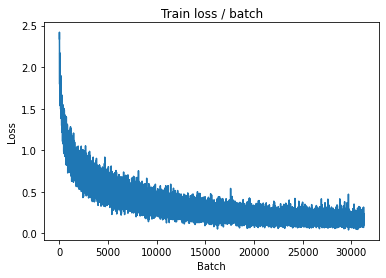

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 0.1315 (0.1570)	Prec@1  94.5 ( 94.4)	Prec@5 100.0 (100.0)


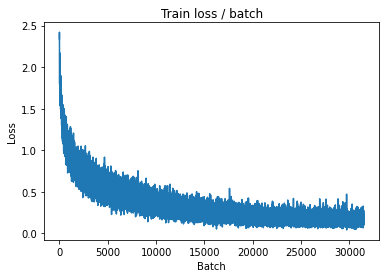


===============> Total time 21s	Avg loss 0.1585	Avg Prec@1 94.41 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.3714 (0.3714)	Prec@1  92.2 ( 92.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5183	Avg Prec@1 85.50 %	Avg Prec@5 99.32 %



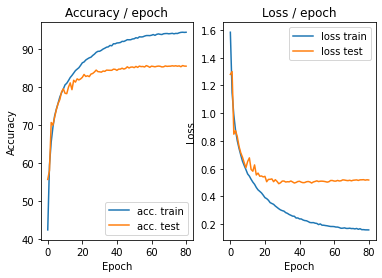

=== EPOCH 82 =====

[TRAIN Batch 000/391]	Time 0.301s (0.301s)	Loss 0.2211 (0.2211)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


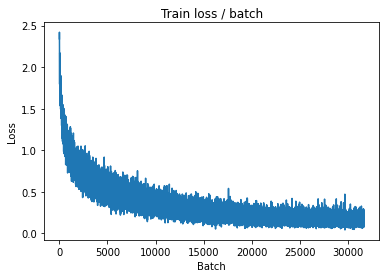

[TRAIN Batch 200/391]	Time 0.058s (0.057s)	Loss 0.1212 (0.1578)	Prec@1  93.8 ( 94.4)	Prec@5 100.0 (100.0)


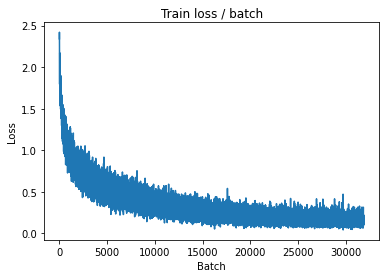


===============> Total time 21s	Avg loss 0.1588	Avg Prec@1 94.44 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.4002 (0.4002)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5243	Avg Prec@1 85.57 %	Avg Prec@5 99.28 %



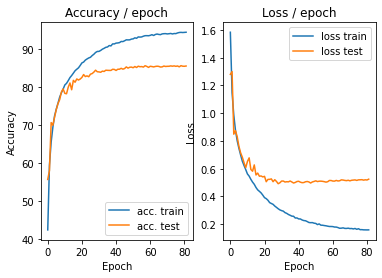

=== EPOCH 83 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.1249 (0.1249)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


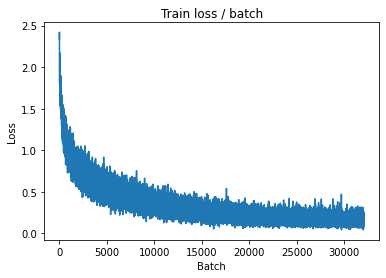

[TRAIN Batch 200/391]	Time 0.072s (0.056s)	Loss 0.2675 (0.1633)	Prec@1  89.8 ( 94.2)	Prec@5 100.0 ( 99.9)


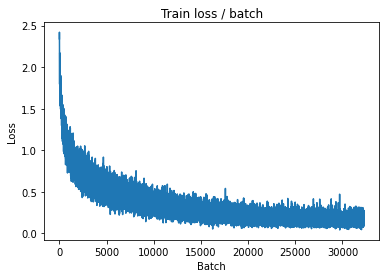


===============> Total time 21s	Avg loss 0.1606	Avg Prec@1 94.25 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.3952 (0.3952)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5225	Avg Prec@1 85.60 %	Avg Prec@5 99.32 %



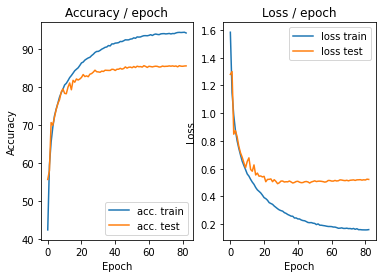

=== EPOCH 84 =====

[TRAIN Batch 000/391]	Time 0.300s (0.300s)	Loss 0.1734 (0.1734)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


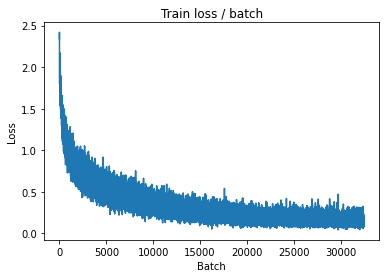

[TRAIN Batch 200/391]	Time 0.058s (0.056s)	Loss 0.1326 (0.1588)	Prec@1  96.9 ( 94.3)	Prec@5 100.0 ( 99.9)


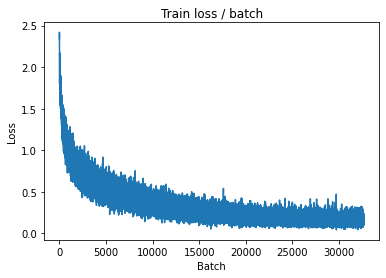


===============> Total time 21s	Avg loss 0.1581	Avg Prec@1 94.32 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.4062 (0.4062)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5210	Avg Prec@1 85.65 %	Avg Prec@5 99.26 %



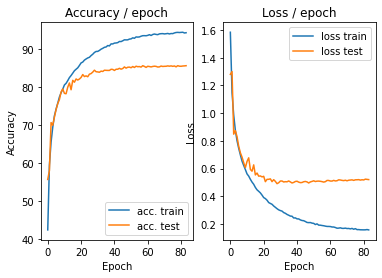

=== EPOCH 85 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.1577 (0.1577)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


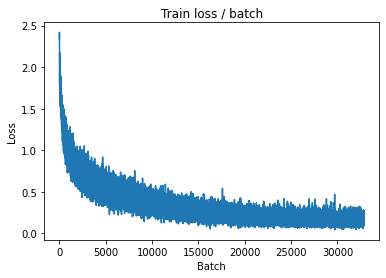

[TRAIN Batch 200/391]	Time 0.098s (0.057s)	Loss 0.2175 (0.1565)	Prec@1  92.2 ( 94.5)	Prec@5 100.0 ( 99.9)


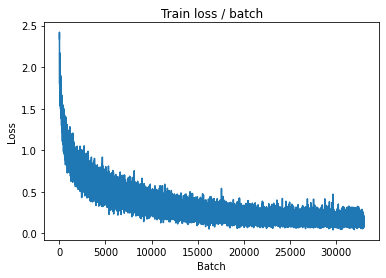


===============> Total time 21s	Avg loss 0.1584	Avg Prec@1 94.38 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.3921 (0.3921)	Prec@1  92.2 ( 92.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5231	Avg Prec@1 85.56 %	Avg Prec@5 99.27 %



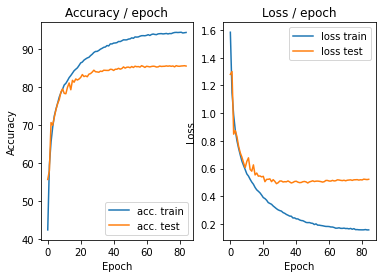

=== EPOCH 86 =====

[TRAIN Batch 000/391]	Time 0.286s (0.286s)	Loss 0.2760 (0.2760)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


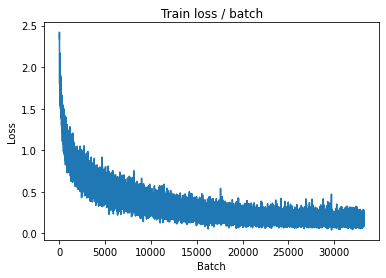

[TRAIN Batch 200/391]	Time 0.026s (0.057s)	Loss 0.0778 (0.1571)	Prec@1  97.7 ( 94.4)	Prec@5 100.0 (100.0)


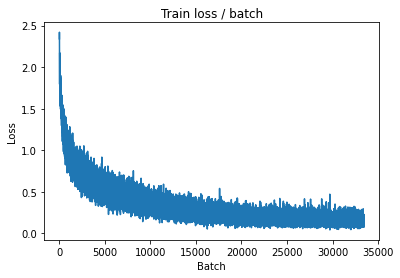


===============> Total time 21s	Avg loss 0.1577	Avg Prec@1 94.49 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.3854 (0.3854)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5208	Avg Prec@1 85.68 %	Avg Prec@5 99.26 %



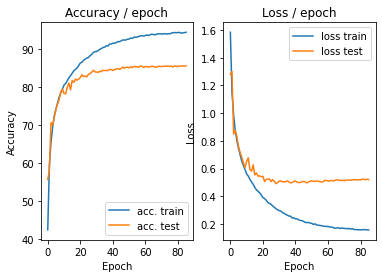

=== EPOCH 87 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 0.1183 (0.1183)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


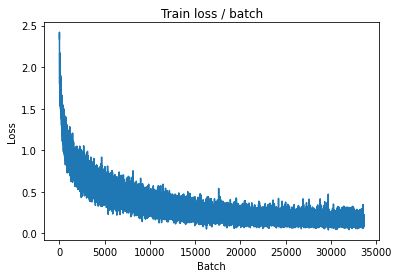

[TRAIN Batch 200/391]	Time 0.071s (0.056s)	Loss 0.2161 (0.1491)	Prec@1  93.8 ( 94.8)	Prec@5 100.0 (100.0)


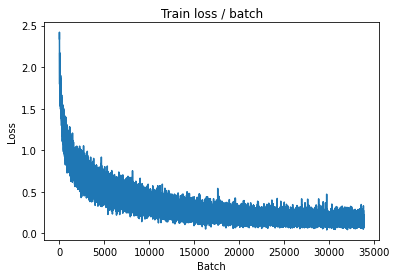


===============> Total time 21s	Avg loss 0.1531	Avg Prec@1 94.67 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.3802 (0.3802)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5190	Avg Prec@1 85.68 %	Avg Prec@5 99.28 %



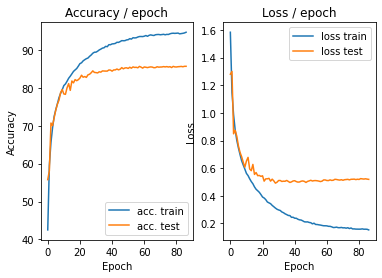

=== EPOCH 88 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.2769 (0.2769)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


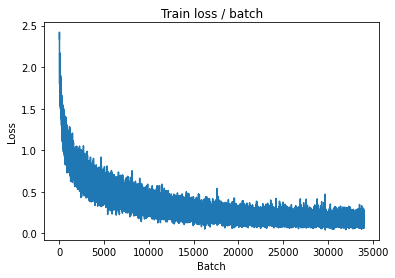

[TRAIN Batch 200/391]	Time 0.026s (0.057s)	Loss 0.1744 (0.1553)	Prec@1  93.0 ( 94.4)	Prec@5 100.0 (100.0)


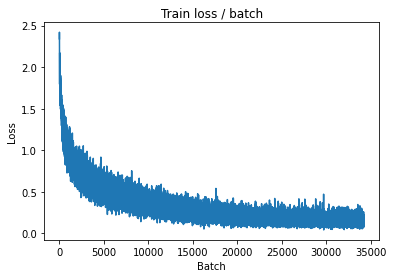


===============> Total time 21s	Avg loss 0.1548	Avg Prec@1 94.48 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.3831 (0.3831)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5180	Avg Prec@1 85.50 %	Avg Prec@5 99.29 %



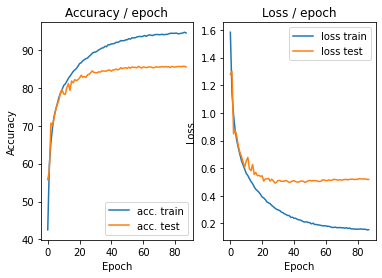

=== EPOCH 89 =====

[TRAIN Batch 000/391]	Time 0.316s (0.316s)	Loss 0.0873 (0.0873)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


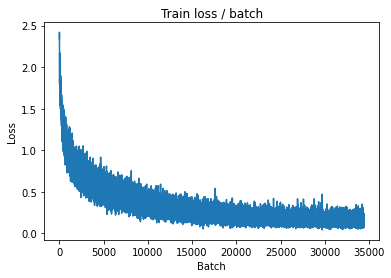

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.1156 (0.1518)	Prec@1  97.7 ( 94.6)	Prec@5 100.0 ( 99.9)


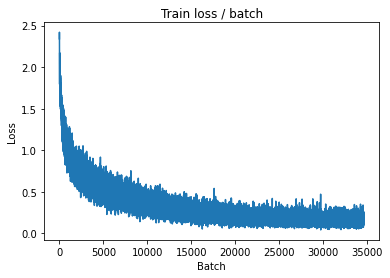


===============> Total time 21s	Avg loss 0.1541	Avg Prec@1 94.48 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.242s (0.242s)	Loss 0.3776 (0.3776)	Prec@1  92.2 ( 92.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5225	Avg Prec@1 85.70 %	Avg Prec@5 99.29 %



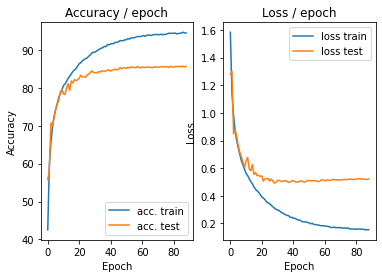

=== EPOCH 90 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.1504 (0.1504)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


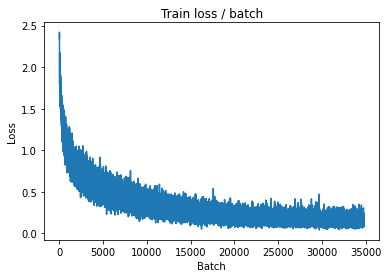

[TRAIN Batch 200/391]	Time 0.065s (0.057s)	Loss 0.1216 (0.1519)	Prec@1  96.9 ( 94.5)	Prec@5 100.0 (100.0)


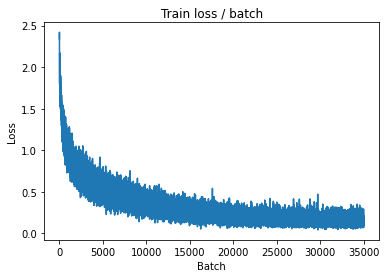


===============> Total time 21s	Avg loss 0.1505	Avg Prec@1 94.59 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.228s (0.228s)	Loss 0.3803 (0.3803)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5204	Avg Prec@1 85.65 %	Avg Prec@5 99.33 %



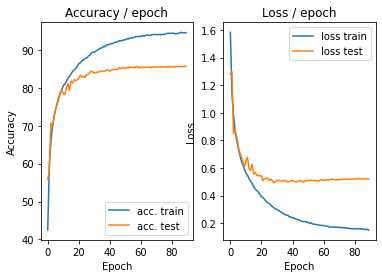

=== EPOCH 91 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.1197 (0.1197)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


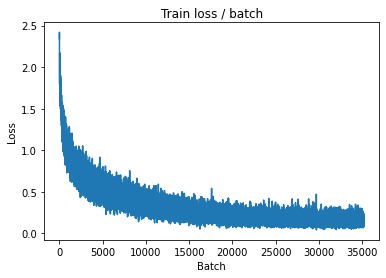

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.1915 (0.1528)	Prec@1  91.4 ( 94.8)	Prec@5 100.0 ( 99.9)


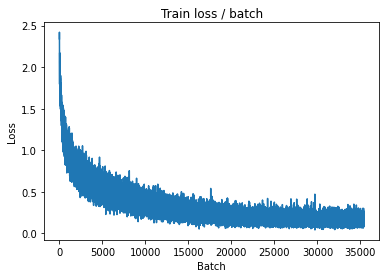


===============> Total time 21s	Avg loss 0.1542	Avg Prec@1 94.62 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.3871 (0.3871)	Prec@1  92.2 ( 92.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5235	Avg Prec@1 85.70 %	Avg Prec@5 99.31 %



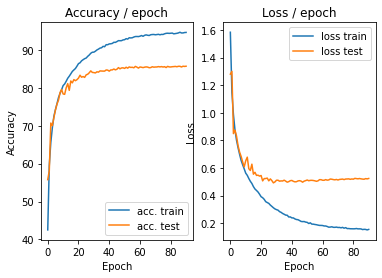

=== EPOCH 92 =====

[TRAIN Batch 000/391]	Time 0.323s (0.323s)	Loss 0.2057 (0.2057)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


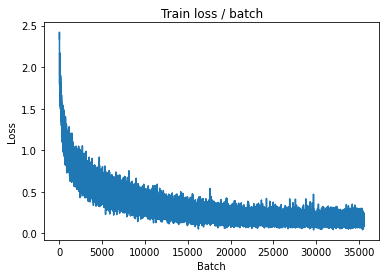

[TRAIN Batch 200/391]	Time 0.037s (0.057s)	Loss 0.2519 (0.1539)	Prec@1  90.6 ( 94.6)	Prec@5 100.0 ( 99.9)


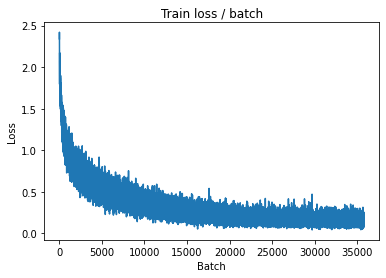


===============> Total time 22s	Avg loss 0.1522	Avg Prec@1 94.63 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.232s (0.232s)	Loss 0.3911 (0.3911)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5247	Avg Prec@1 85.62 %	Avg Prec@5 99.26 %



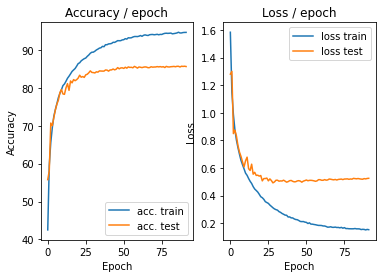

=== EPOCH 93 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 0.1862 (0.1862)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


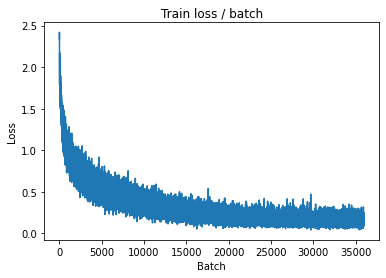

[TRAIN Batch 200/391]	Time 0.076s (0.056s)	Loss 0.1591 (0.1517)	Prec@1  94.5 ( 94.6)	Prec@5 100.0 (100.0)


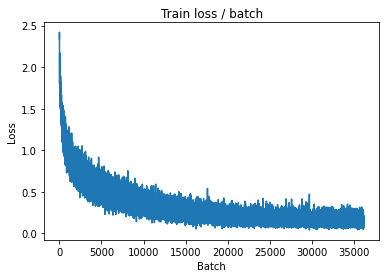


===============> Total time 21s	Avg loss 0.1532	Avg Prec@1 94.59 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.3850 (0.3850)	Prec@1  93.0 ( 93.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5240	Avg Prec@1 85.75 %	Avg Prec@5 99.28 %



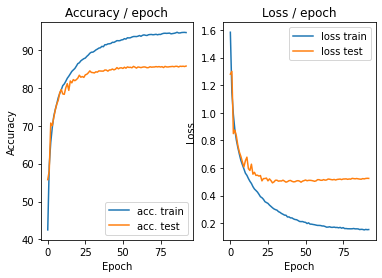

=== EPOCH 94 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.1642 (0.1642)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


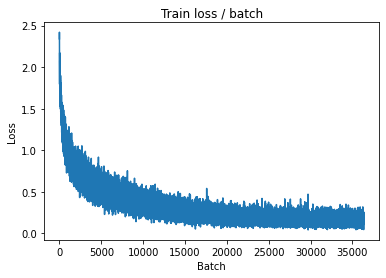

[TRAIN Batch 200/391]	Time 0.031s (0.057s)	Loss 0.0840 (0.1545)	Prec@1  96.9 ( 94.5)	Prec@5 100.0 ( 99.9)


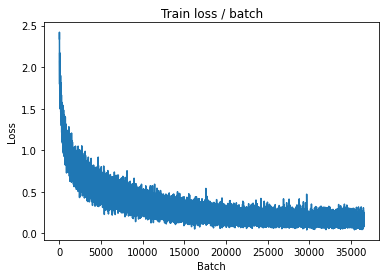


===============> Total time 21s	Avg loss 0.1531	Avg Prec@1 94.62 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.3865 (0.3865)	Prec@1  91.4 ( 91.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5255	Avg Prec@1 85.79 %	Avg Prec@5 99.31 %



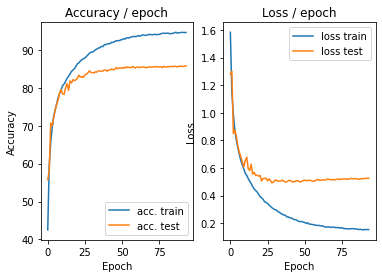

=== EPOCH 95 =====

[TRAIN Batch 000/391]	Time 0.308s (0.308s)	Loss 0.1848 (0.1848)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


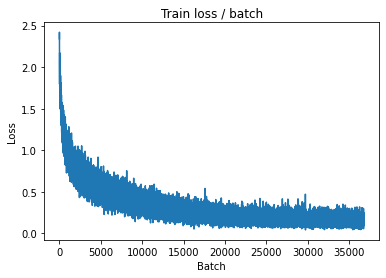

[TRAIN Batch 200/391]	Time 0.026s (0.056s)	Loss 0.1101 (0.1526)	Prec@1  96.9 ( 94.6)	Prec@5 100.0 ( 99.9)


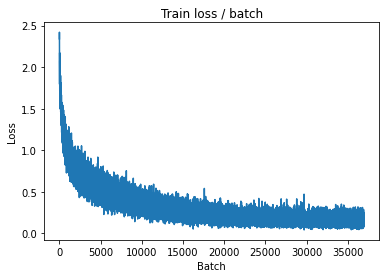


===============> Total time 21s	Avg loss 0.1521	Avg Prec@1 94.53 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.3897 (0.3897)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5233	Avg Prec@1 85.68 %	Avg Prec@5 99.30 %



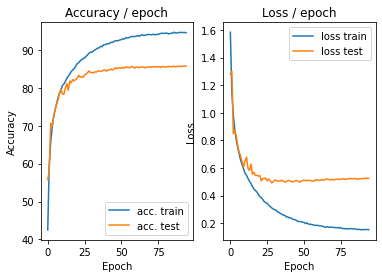

=== EPOCH 96 =====

[TRAIN Batch 000/391]	Time 0.332s (0.332s)	Loss 0.0801 (0.0801)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


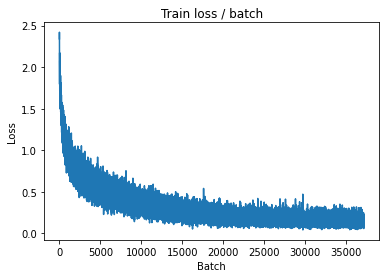

[TRAIN Batch 200/391]	Time 0.025s (0.055s)	Loss 0.1567 (0.1491)	Prec@1  93.8 ( 94.6)	Prec@5 100.0 ( 99.9)


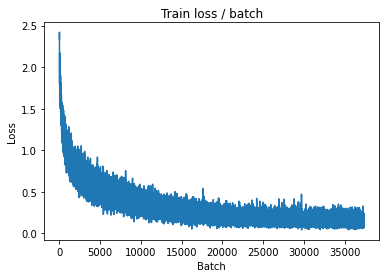


===============> Total time 21s	Avg loss 0.1492	Avg Prec@1 94.64 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.235s (0.235s)	Loss 0.4026 (0.4026)	Prec@1  90.6 ( 90.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5235	Avg Prec@1 85.75 %	Avg Prec@5 99.26 %



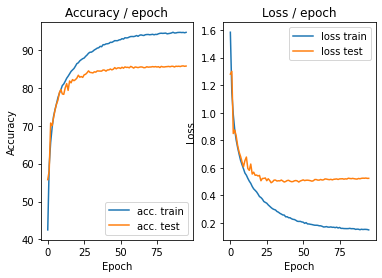

=== EPOCH 97 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.1057 (0.1057)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


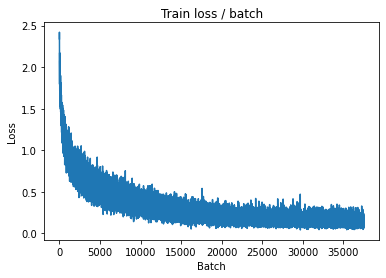

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.0923 (0.1522)	Prec@1  96.1 ( 94.7)	Prec@5 100.0 (100.0)


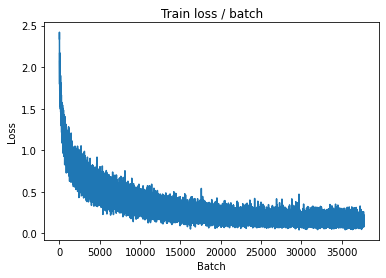


===============> Total time 21s	Avg loss 0.1521	Avg Prec@1 94.68 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.225s (0.225s)	Loss 0.3884 (0.3884)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5241	Avg Prec@1 85.81 %	Avg Prec@5 99.28 %



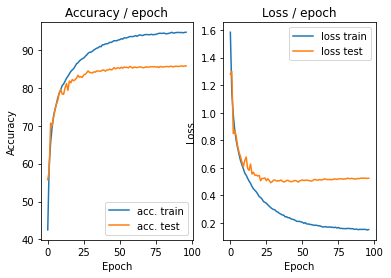

=== EPOCH 98 =====

[TRAIN Batch 000/391]	Time 0.332s (0.332s)	Loss 0.1746 (0.1746)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


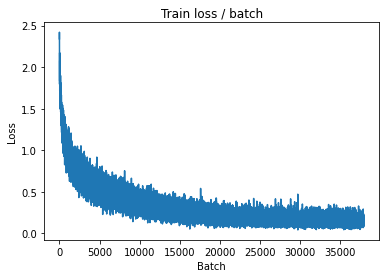

[TRAIN Batch 200/391]	Time 0.024s (0.059s)	Loss 0.1100 (0.1495)	Prec@1  98.4 ( 94.7)	Prec@5 100.0 (100.0)


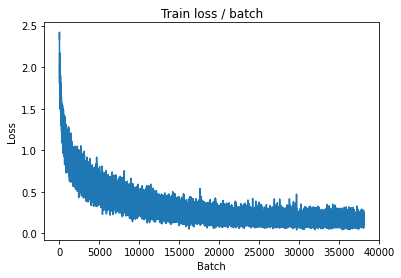


===============> Total time 22s	Avg loss 0.1535	Avg Prec@1 94.53 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.243s (0.243s)	Loss 0.3880 (0.3880)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5240	Avg Prec@1 85.71 %	Avg Prec@5 99.30 %



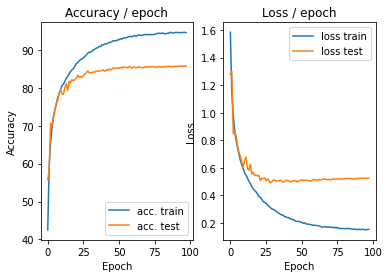

=== EPOCH 99 =====

[TRAIN Batch 000/391]	Time 0.311s (0.311s)	Loss 0.1557 (0.1557)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


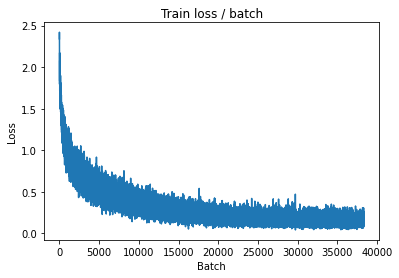

[TRAIN Batch 200/391]	Time 0.076s (0.057s)	Loss 0.1166 (0.1519)	Prec@1  95.3 ( 94.7)	Prec@5 100.0 ( 99.9)


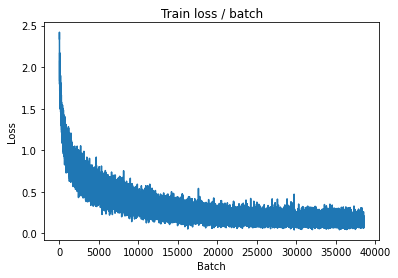


===============> Total time 21s	Avg loss 0.1520	Avg Prec@1 94.67 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 0.3930 (0.3930)	Prec@1  91.4 ( 91.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5241	Avg Prec@1 85.76 %	Avg Prec@5 99.30 %



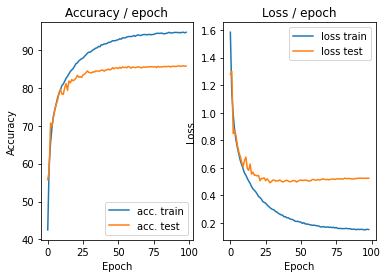

=== EPOCH 100 =====

[TRAIN Batch 000/391]	Time 0.320s (0.320s)	Loss 0.1034 (0.1034)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


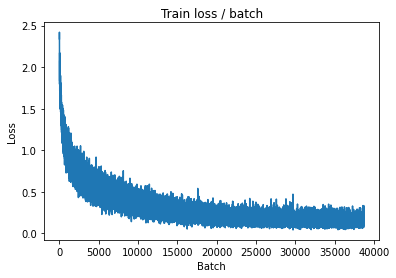

[TRAIN Batch 200/391]	Time 0.028s (0.056s)	Loss 0.1849 (0.1550)	Prec@1  93.8 ( 94.4)	Prec@5 100.0 ( 99.9)


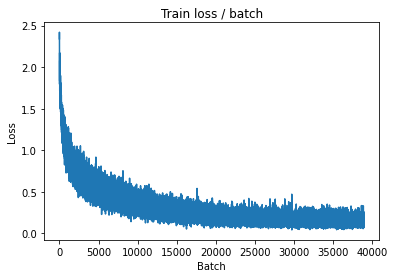


===============> Total time 21s	Avg loss 0.1533	Avg Prec@1 94.55 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.244s (0.244s)	Loss 0.3823 (0.3823)	Prec@1  92.2 ( 92.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5225	Avg Prec@1 85.77 %	Avg Prec@5 99.30 %



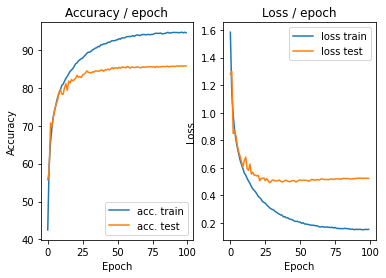

In [ ]:
main(128, 0.1, 100, cuda=True)